# Inhibition  of proteasome substrate turnover during replicative aging varies with targeting mechanism 

## Import libraries

In [61]:
from importlib import reload

import os
import re

import numpy as np
# I tend to write inefficient pandas when subselecting, filtering, and summarizing
# data so I'm turning off performance warning
import pandas as pd
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import skimage as sk
import os
import re
import shutil
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.lines import Line2D
import seaborn as sns
from statannotations.Annotator import Annotator

from lifelines import KaplanMeierFitter
from lifelines import WeibullFitter

wbf = WeibullFitter()
kmf = KaplanMeierFitter()

from byc import constants, files, database, segmentation
from byc import standard_analysis as sa
from byc import plotting
from byc import fitting_tools as ft

from byc import constants, plotting, files, database, utilities, trace_tools, fitting_tools, segmentation
from byc import standard_analysis as sa
from byc.trace_tools import median_filter
for pac in [constants,
            plotting,
            files,
            sa,
            database,
            utilities,
            trace_tools,
            fitting_tools,
            segmentation]:
    reload(pac)
    
plotting.set_styles(plt, matplotlib)

strains_color_dict =  plotting.strains_color_dict
other_colors = plotting.other_colors

# Generate a palette to use for signifying number of 
# buds that will be produced before the last bud
pre_post_SEP_palette = plotting.get_pre_post_sep_palette()

## Generate fits, trace, and buds dataframes *de novo*

Do this after analyzing new experiments in `constants.byc_data_dir` and adding them to the compartments_index.csv at `constants.compartment_index_path`

In [2]:
# %%capture refresh_database_printout

# scriptpath = os.path.join(constants.source_path, 'bin/refresh_database.py')
# %run $scriptpath

## Read in databases

In [62]:
%%capture database_readin

traces_df, fits_df, buds_df = database.read_in_trace_fits_buds_dfs()
fits_df = fits_df[fits_df.end_event_type!='escape']

In [63]:
%%capture database_readin

traces_df, fits_df, buds_df = database.read_in_trace_fits_buds_dfs()
# clean_escape_annotation happens on refresh database
# gets rid of a lot of important annotation like cycle number etc.
# but gives a clean dataframe with exactly one event for each unique
# cell's unique bud. buds_df read in above will give a buds_df where
# multi-measured cells show up twice but can be distinguished by
# their compartment_bud_id
buds_df = database.get_clean_buds_df(buds_df, clean_escape_annotation=False)
survivaldf, table, rls_tables_df = database.generate_survivaldf(fits_df, buds_df)
survivaldf_pooled, table_pooled, all_rls_table_pooled = database.generate_survivaldf_pooled_compartments(fits_df, buds_df)

### Read in SEP detection results here and annotate on the `buds_df` and `fits_df` read in above

In [73]:
for samplename, compartments in constants.compartments_dict.items():
    for df in [fits_df, traces_df, buds_df]:
        df.loc[df.compartment_name.isin(compartments), 'samplename'] = samplename
        
        
sepdfs = []
datadir = os.path.abspath(os.path.join(constants.byc_data_dir, 'meta'))
for samplename in fits_df.samplename.unique():
    filepath = os.path.join(datadir, '{}_sep_fits.csv'.format(samplename))
    if os.path.exists(filepath):
        sepdf = pd.read_csv(filepath)
        sepdf.loc[:, 'samplename'] = samplename
        sepdfs.append(sepdf)
    else:
        print(f'No sepdf for sample {samplename}')
sepdf = pd.concat(sepdfs)
reload(database)
database.label_sepdf_and_buds_df(sepdf, buds_df)
sepdf.loc[:, 'background'] = sepdf.samplename.apply(lambda x: x.split('_')[0])
sepdf.loc[:, 'substrate'] = sepdf.samplename.apply(lambda x: x.split('_')[1])
sepdf.loc[:, 'date'] = sepdf.compartment_bud_id.apply(lambda x: str(x)[0:8])
sepdf.loc[:, 'date_sample'] = sepdf.date.astype(str).str.cat(sepdf.samplename, sep='_')
# Annotate fits_df etc. with SEP as detected by piecewise fit
compartment_bud_ids = sepdf.compartment_bud_id.unique()[:]
for i, compartment_bud_id in enumerate(compartment_bud_ids):
    print(f"Annotating sepdf features for cell {i+1} of {len(compartment_bud_ids)} on fits_df and buds_df", end='\r')
    if compartment_bud_id in fits_df.compartment_bud_id.unique():
        for col in list(sepdf.columns):
            val = sepdf[sepdf.compartment_bud_id==compartment_bud_id][col].iloc[0]
            fits_df.loc[fits_df.compartment_bud_id==compartment_bud_id, col] = val
            buds_df.loc[buds_df.compartment_bud_id==compartment_bud_id, col] = val
# Need to label cells with their RLS so we can calculate
# buds produced before the SEP
database.label_sepdf_and_buds_df(sepdf, buds_df)
# Label fits_df with distance from SEP at chase
# and buds_df with distance from SEP at bud event
fits_df.loc[:, 'buds_before_SEP'] = fits_df.dist_from_sen*-1 - fits_df.x0.round(0)
buds_df.loc[:, 'buds_before_SEP'] = buds_df.buds_after_death - buds_df.SEP.round(0)
fits_df.loc[fits_df.buds_before_SEP<0, 'pre_SEP'] = True
fits_df.loc[fits_df.buds_before_SEP>0, 'pre_SEP'] = False

No sepdf for sample nan


(-10.0, 1.0)

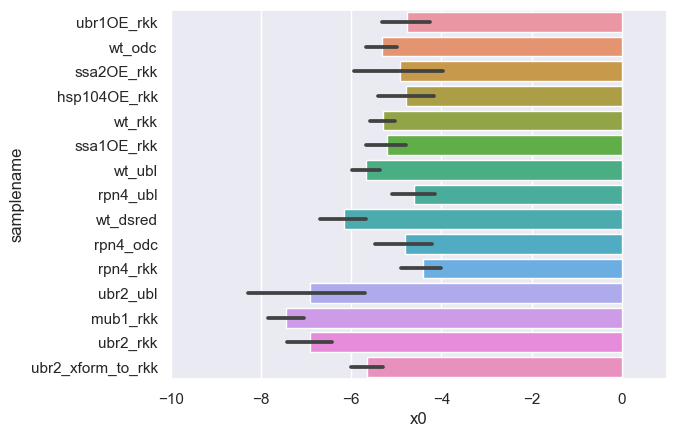

In [77]:
kwargs = {
    'y': 'samplename',
    'x': 'x0',
    'data': sepdf
}

ax = sns.barplot(**kwargs)

ax.set_xlim(-10, 1)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_after_SEP_rounded_y=cycle_duration_hrs_hue=SEP_bin.svg


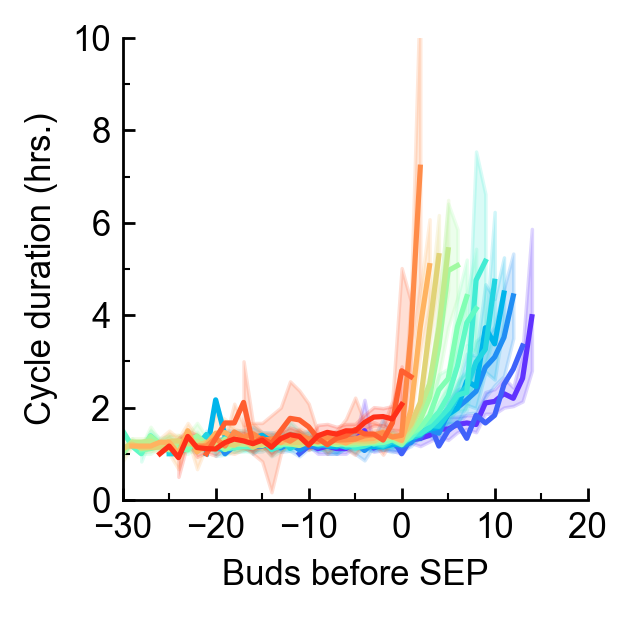

In [13]:
all_wt_comps = constants.compartments_dict['wt_rkk'] + constants.compartments_dict['wt_ubl'] + constants.compartments_dict['wt_odc']
bins = np.arange(-15, 0.1, 1)
buds_df.loc[:, 'SEP_bin'] = pd.cut(buds_df.x0, bins)
fig, ax = plotting.figure_ax(width_scale=3/2.5, height_scale=3/2.5)
buds_df.loc[:, 'buds_after_SEP'] = buds_df.buds_after_death - buds_df.SEP
buds_df.loc[:, 'buds_after_SEP_rounded'] = np.round(buds_df.buds_after_SEP)
kwargs = {
    'x': 'buds_after_SEP_rounded',
    'y': 'cycle_duration_hrs',
    'hue': 'SEP_bin',
    'data': buds_df[(buds_df.SEP_stderr_frac<0.3)&(buds_df.compartment_name.isin(all_wt_comps))],
    'ax': ax,
    'palette': 'rainbow'
}

sns.lineplot(**kwargs)
ax.set_xlim(-30, 20)
ax.set_xticks(np.arange(np.min(ax.get_xlim()), np.max(ax.get_xlim())+1, 10))
ax.set_ylim(0, 10)
plotting.format_ticks(ax)
ax.set_ylabel('Cycle duration (hrs.)')
ax.set_xlabel('Buds before SEP')
ax.legend_.set_visible(False)
plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\notebooks\plots\gen_from_death_color_palette_max_dist_from_sen=15.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\name=SEP_color_code_legend.svg


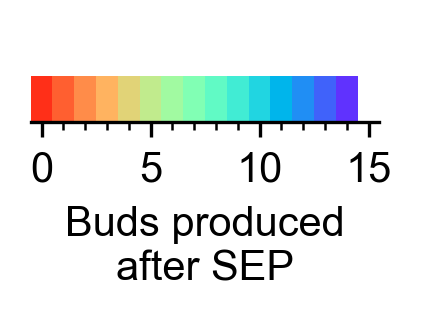

In [16]:
reload(plotting)
handles, labels = ax.get_legend_handles_labels()[0], ax.get_legend_handles_labels()[1]
colors = [line.get_color() for line in handles]
colors.reverse()
plotting.plot_dist_from_sen_palette_key(
    max_dist_from_sen=15,
    min_dist_from_sen=0,
    colors=colors,
    direction='descending',
    xlabel='Buds produced\nafter SEP')

plotting.save_figure(fig, {'name': 'SEP_color_code_legend'}, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\title=rep_cell_sep_fits.svg


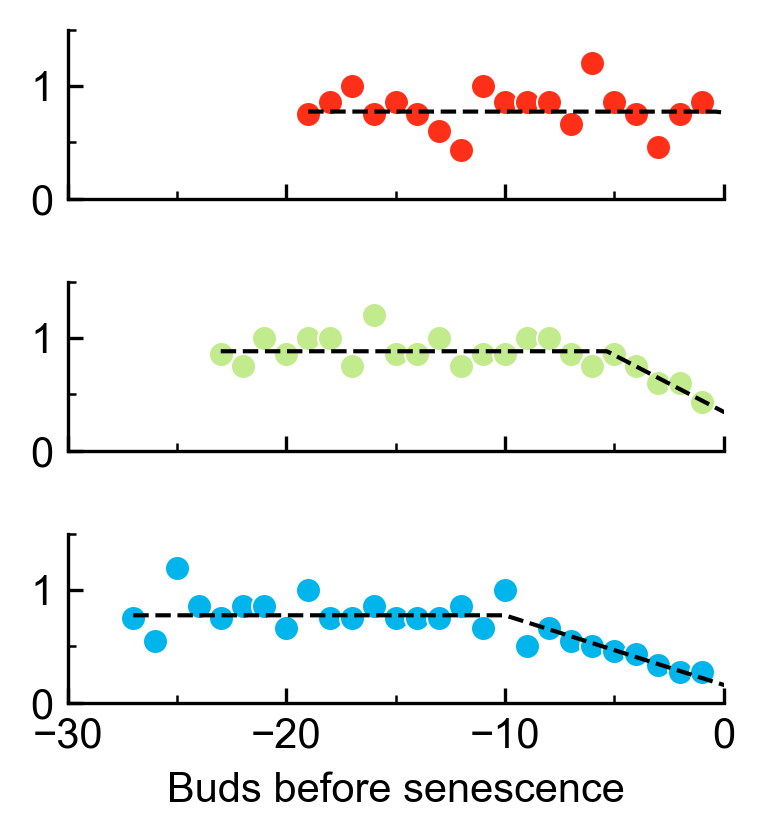

In [11]:
rep_cells = [
    '20221201_byc_JPC122_YFP-ODC-32-40-47-53-61-68-76-86-100-106-113-120-127-136-141-148-156-169-177-184-316',
    '20221028_byc_JPC228_DsRed-P2A-UBL-YFP-Su9_3x-int-7-14-22-28-35-41-47-55-60-67-74-80-88-95-102-108-114-121-129-136-144-154-164-178-242',
    '20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741-4-12-23-28-35-43-50-57-66-72-80-88-95-103-111-119-126-135-141-153-162-173-185-198-212-230-252-274-304'
]


def plot_fit(compartment_bud_id, **kwargs):
    # Plot fit using sepdf information
    buddex = np.unique(compartment_bud_id)[0]
    params = [sepdf.loc[sepdf.compartment_bud_id==buddex, var].iloc[0] for var in ['x0', 'y0', 'k1']]
    x = buds_df.loc[buds_df.compartment_bud_id==buddex, 'buds_after_death']
    xsmooth = np.arange(np.min(x), np.max(x)+0.1, 0.05)
    ypred = fitting_tools.piecewise_linear(xsmooth, *params)
    plt.plot(xsmooth, ypred, linestyle='--', color='black', linewidth=1)

selectbool = buds_df.compartment_bud_id.isin(rep_cells)
grid = sns.FacetGrid(
    buds_df[selectbool],
    row='compartment_bud_id',
    hue='compartment_bud_id',
    sharey=True,
    row_order=rep_cells,
    hue_order=rep_cells,
    palette=[colors[i] for i in [0, 5, 11]]
)


# Plot data
grid.map(sns.scatterplot, 'buds_after_death', 'bud_frequency_per_hr')
grid.set_titles(row_template='')
grid.map(plot_fit, 'compartment_bud_id')
grid.fig.set_figwidth(3)
grid.fig.set_figheight(3)
grid.fig.set_dpi(300)
grid.set(ylim=(0, 1.5), xlim=(-30, 0), xlabel='Buds before senescence', ylabel='Bud freq. (1/hrs.)')
plt.tight_layout()
for ax in grid.axes.flat:
    plotting.format_ticks(ax)
    ax.set_ylabel('')
plotting.save_figure(grid.fig, {'title': 'rep_cell_sep_fits'}, ext='.svg')

### Fit SEP piecewise linear model to cells from new experiments
Run this cell to do SEP detection on new experiments from constants.compartments_dict 

In [72]:
allsepdfs = []
for condition in constants.compartments_dict.keys():
    comps = constants.compartments_dict[condition]
    booldex = (buds_df.compartment_name.isin(comps))&(~buds_df.bud_frequency_per_hr.isna())&(~buds_df.buds_after_death.isna())&(buds_df.cycle_duration_hrs>=1)
    bounds_dict = {
        'x0': (-np.inf, 0),
        'y0': (-np.inf, np.inf),
        'k1': (-np.inf, np.inf)
    }
    # fig = plt.figure()
    i = 0
    dfs = []
    for buddex in buds_df[booldex].compartment_bud_id.unique():
        print(f'Fitting SEP for cell {i+1} of {len(buds_df[booldex].compartment_bud_id.unique())}', end='\r')
        # try:
        if len(buds_df[(buds_df.compartment_bud_id==buddex)&booldex]) > 2:
            result, df = fitting_tools.fit_model_to_df(
                buds_df,
                (buds_df.compartment_bud_id==buddex)&booldex,
                fitting_tools.model_guesses.piecewise_linear[0],
                fitting_tools.model_guesses.piecewise_linear[1],
                yvar='bud_frequency_per_hr',
                xvar='buds_after_death',
                bounds_dict=bounds_dict
            )
            df.loc[:, 'compartment_bud_id'] = buddex
            dfs.append(df)
            sns.set()
            fig, ax = plotting.figure_ax(width_scale=2, height_scale=1.5)
            result.plot_fit(ax=ax)
            # ax.annotate(f'x0={np.round(df.x0.iloc[0], 2)}', xy=(0.3, 0.3), xycoords='figure fraction')
            # ax.annotate(f'x0_stderr={np.round(df.x0_stderr.iloc[0], 2)}', xy=(0.3, 0.25), xycoords='figure fraction')
            ax.set_ylim(0, 1.5)
            plt.tight_layout()
            try:
                plotting.save_figure(fig, {'cell': buddex, 'fit': 'sep_detect'}, ext='.png')
            except Exception as e:
                print(f'Fit failed for buddex {buddex}\nException{e}', end='\r')
            plt.close(fig)
        i += 1
    allsepdf = pd.concat(dfs)
    filepath = os.path.join(constants.byc_data_dir, f'meta/{condition}_sep_fits.csv')
    allsepdf.to_csv(filepath, index=False)
    allsepdfs.append(allsepdf)

Saved figure at cell 1 of 403
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\cell=20221019_byc_JPC228_UBL-YFP-Su9_full-0-10-17-25-33-40-46-55-63-69-75-82-89-99-113-135-149-170-197_fit=sep_detect.png
Saved figure at cell 2 of 403
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\cell=20221019_byc_JPC228_UBL-YFP-Su9_full-0-10-19-25-30-38-46-53-62-73-102-199-213-315_fit=sep_detect.png
Saved figure at cell 3 of 403
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\cell=20221019_byc_JPC228_UBL-YFP-Su9_full-0-14-21-33-37-48-54-60-70-77-84-93-109-132-203_fit=sep_detect.png
Saved figure at cell 5 of 403
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\cell=20221019_byc_JPC228_UBL-YFP-Su9_full-0-8-13-19-27-34-43-49-57-66-74-80-92-96-107-113-120-135-175-197-203_fit=sep_detect.png
Saved figure at cell 6 of 403
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\cell=20221019_byc_JPC228_UBL-YFP-Su9_full-0-8-15-21-29-37-45-52-87_fit=sep_detect.png
Saved figure at cell 8 of 403
C:\Users\

## Summary plots of individual replicate raw data

In [173]:
# For 20230609_byc, I forgot to turn on objective heater, so strain is called
# JPC274_26C because there's a temperature difference. I initially attributed
# the slow degradation in this experiment to lower temperature. But then 20230628
# from Aniruddha looked the same. So I said fuck it I'm running one myself
fits_df.loc[:, 'buds_before_death'] = np.nan
fits_df.loc[fits_df.dist_from_sen>5, 'buds_before_death'] = '>5'
fits_df.loc[fits_df.dist_from_sen<5, 'buds_before_death'] = '<5'
fits_df.loc[:, 'date_deletion'] = fits_df.date.astype(str) + '_' + fits_df.background_genotype
fits_df.loc[:, 'date_strain'] = fits_df.date.astype(str) + '_' + fits_df.strain_name
traces_df.loc[:, 'date_deletion'] = traces_df.date.astype(str) + '_' + traces_df.background_genotype
traces_df.loc[:, 'date_strain'] = traces_df.date.astype(str) + '_' + traces_df.strain_name
survivaldf.loc[:, 'date_strain'] = survivaldf.date.astype(str) + '_' + survivaldf.strain_name.astype(str)
survivaldf.loc[:, 'date_deletion'] = survivaldf.date.astype(str) + '_' + survivaldf.background_genotype.astype(str)

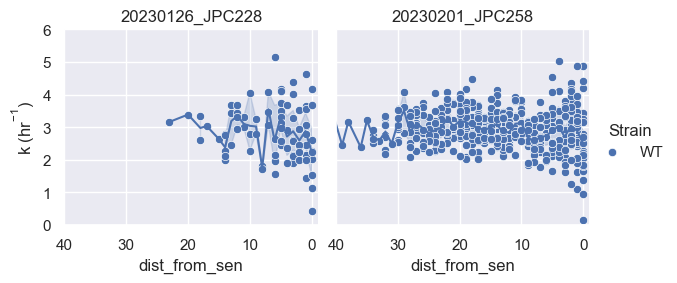

In [175]:
strains = [
    'JPC262',
    'JPC279'
]

strains = [
    'JPC259',
    'JPC282'
]

strains = [
    'JPC228',
    'JPC258',
]

sns.set()
grid = sns.FacetGrid(fits_df.loc[fits_df.strain_name.isin(strains), :],
                     col='date_strain',
                     hue='background_genotype')

grid.map(sns.lineplot, 'dist_from_sen', 'b')
grid.map(sns.scatterplot, 'dist_from_sen', 'b')
grid.set(xlim=(40, -1), ylim=(0, 6), ylabel=plotting.annoying_strings().k_inverse_hrs)
grid.set_titles(col_template="{col_name}")
grid.add_legend(title='Strain')

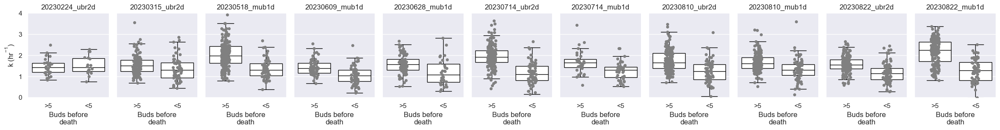

In [28]:
strains = [
    'JPC262',
    'JPC274',
    'JPC274_26C'
]

sns.set()
grid = sns.FacetGrid(fits_df.loc[fits_df.strain_name.isin(strains), :],
                     col='date_deletion',
                     aspect=0.7)

grid.map(sns.boxplot, 'buds_before_death', 'b', dodge=True, showfliers=False, order=['>5', '<5'], color='gray', **plotting.transparent_boxes_prop_dict)
grid.map(sns.stripplot, 'buds_before_death', 'b', dodge=True, order=['>5', '<5'], color='gray')
grid.set(ylim=(0, 4), xlabel='Buds before\ndeath', ylabel=plotting.annoying_strings().k_inverse_hrs)
grid.set_titles(col_template="{col_name}")
# grid.add_legend(title='Deletion')

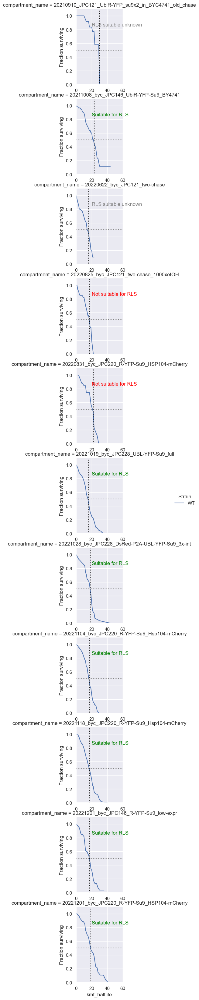

In [261]:
def annotate_rls_suitable(data, **kwargs):
    rls_suitable = data.iloc[0]
    if rls_suitable == False:
        text = "Not suitable for RLS"
        color = 'red'
    elif rls_suitable == True:
        text = "Suitable for RLS"
        color = 'green'
    elif np.isnan(rls_suitable):
        text = "RLS suitable unknown"
        color= 'gray'
    else:
        text = ''
        color = 'black'
    plt.annotate(text, xy=(20, 0.85), color=color)
    
def annotate_rls(data, **kwargs):
    rls = data.iloc[0]
    plt.axvline(rls, ls=':', c='black')


strains = [
    'JPC121',
    'JPC146',
    'JPC220'
]

# strains = [
#     'JPC262',
#     'JPC274',
#     'JPC274_26C',
#     'JPC279',
#     'JPC282'
# ]

# # strains = [
# #     'JPC122'
# # ]

# strains = [
#     'JPC228',
#     'JPC258'
# ]

# strains = [
#     'JPC230',
#     'JPC259',
#     'JPC282'
# ]

# strains = [
#     'JPC199',
# ]

# strains = [
#     'JPC136'
# ]

# strains = [
#     'JPC193'
# ]

sns.set()
grid = sns.FacetGrid(survivaldf.loc[survivaldf.strain_name.isin(strains), :],
                     row='compartment_name',
                     hue='background_genotype')

grid.map(sns.lineplot, 'x_kmf', 'y_kmf')
grid.add_legend(title='Strain')
grid.set(xlim=(0, 60), ylim=(0, 1.1), ylabel='Fraction surviving', xlabel='Generations')
grid.set_titles(col_template="{col_name}")
grid.map(plt.axhline, y=0.5, ls=":", c=".5")
grid.map(annotate_rls_suitable, 'rls_suitable')
grid.map(annotate_rls, 'kmf_halflife')
for ax in grid.axes.flatten():
    ax.tick_params(labelbottom=True)

In [38]:
grid.data.compartment_name.unique()

array(['20221104_byc_JPC199_R-YFP-Su9_SSA1-OE'], dtype=object)

In [7]:
grid.data.groupby(by='date_deletion').cell_index.nunique()

date_deletion
20230224_ubr2d     48
20230315_ubr2d    193
20230518_mub1d    266
20230609_mub1d    125
20230628_mub1d    115
20230714_mub1d     80
20230714_ubr2d    278
20230810_mub1d    257
20230810_ubr2d    237
20230822_mub1d    234
20230822_ubr2d    284
Name: cell_index, dtype: int64

### What was YFP signal at t0 in the above replicates? 
Could it be I actually swapped the strains around multiple times?

<Axes: xlabel='y_input_raw', ylabel='date_strain'>

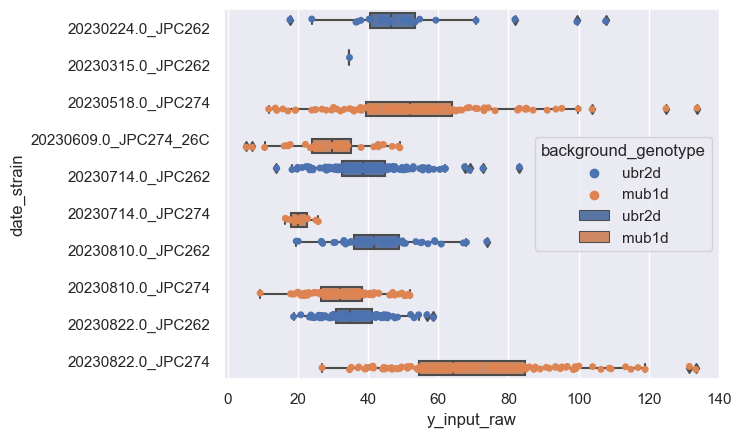

In [31]:
strains = [
    'JPC262',
    'JPC274',
    'JPC274_26C'
]
tdf = traces_df.loc[traces_df.strain_name.isin(strains), :]

aggdex = [
    'date_deletion'
]

kwargs = {
    'y': 'date_strain',
    'x': 'y_input_raw',
    'hue': 'background_genotype',
    'data': tdf[(tdf.x_input==0)&(tdf.abs_chase_frame<40)]
}

sns.stripplot(**kwargs, dodge=True)
sns.boxplot(**kwargs, dodge=True)

In [11]:
tdf[(tdf.x_input==0)&(tdf.abs_chase_frame<40)].groupby(by='date_strain', as_index=False).y_input_raw.median()

,date_strain,y_input_raw
0,20230224.0_JPC262,46.525219
1,20230315.0_JPC262,34.433357
2,20230518.0_JPC274,51.831297
3,20230609.0_JPC274_26C,29.683853
4,20230714.0_JPC262,38.432515
5,20230714.0_JPC274,20.154572
6,20230810.0_JPC262,41.542435
7,20230810.0_JPC274,31.970060
8,20230822.0_JPC262,34.819178
9,20230822.0_JPC274,64.295918


Does signal level of the strain predict degradation rate?

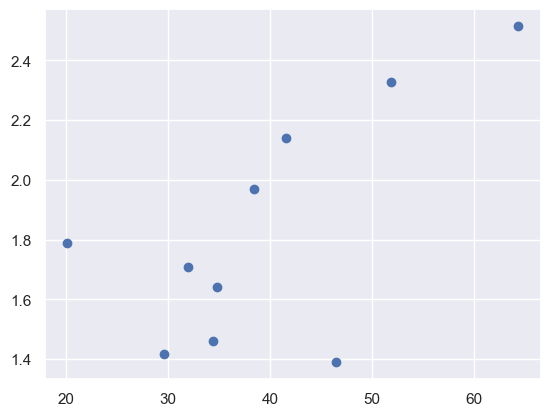

In [12]:
aggdict = {
    'b': ['mean', 'std', np.median],
    'y_input_raw': ['mean', 'std', np.median]
}
sub_select_bool = (tdf.x_input==0)&(tdf.abs_chase_frame<40)
table = tdf[sub_select_bool].groupby(by=aggdex, as_index=False).agg(aggdict)


plt.scatter(table.loc[:, 'y_input_raw']['median'],
           table.loc[:, 'b']['median'])

### Plot lifespans across all ubr2&Delta; and mub1&Delta; replicates etc

In [ ]:
survivaldf.date.astype(str) + '_' + survivaldf.strain_name

0     20190726_JPC000
1     20190726_JPC000
2     20190726_JPC000
3     20190726_JPC000
4     20190726_JPC000
           ...       
31    20230822_JPC274
32    20230822_JPC274
33    20230822_JPC274
34    20230822_JPC274
35    20230822_JPC274
Length: 1603, dtype: object

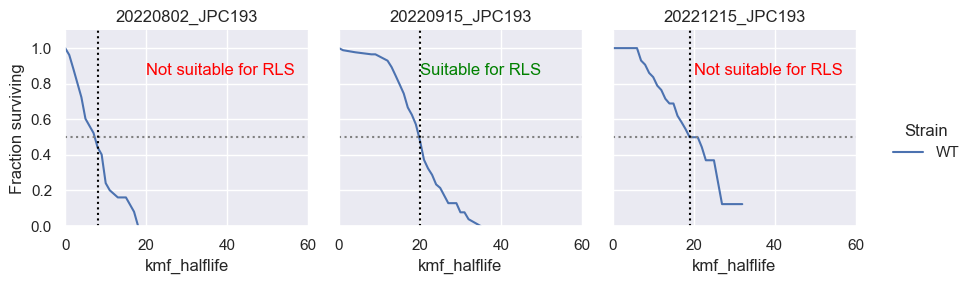

In [22]:
def annotate_rls_suitable(data, **kwargs):
    rls_suitable = data.iloc[0]
    if rls_suitable == False:
        text = "Not suitable for RLS"
        color = 'red'
    elif rls_suitable == True:
        text = "Suitable for RLS"
        color = 'green'
    elif np.isnan(rls_suitable):
        text = "RLS suitable unknown"
        color= 'gray'
    else:
        text = ''
        color = 'black'
    plt.annotate(text, xy=(20, 0.85), color=color)
    
def annotate_rls(data, **kwargs):
    rls = data.iloc[0]
    plt.axvline(rls, ls=':', c='black')


strains = [
    'JPC121',
    'JPC146',
    'JPC220'
]

strains = [
    'JPC122'
]

strains = [
    'JPC228',
    'JPC258'
]

strains = [
    'JPC193',
]

sns.set()
grid = sns.FacetGrid(survivaldf.loc[survivaldf.strain_name.isin(strains), :],
                     col='date_strain',
                     hue='background_genotype')

grid.map(sns.lineplot, 'x_kmf', 'y_kmf')
grid.add_legend(title='Strain')
grid.set(xlim=(0, 60), ylim=(0, 1.1), ylabel='Fraction surviving', xlabel='Generations')
grid.set_titles(col_template="{col_name}")
grid.map(plt.axhline, y=0.5, ls=":", c=".5")
grid.map(annotate_rls_suitable, 'rls_suitable')
grid.map(annotate_rls, 'kmf_halflife')

<Axes: xlabel='buds_after_death', ylabel='b'>

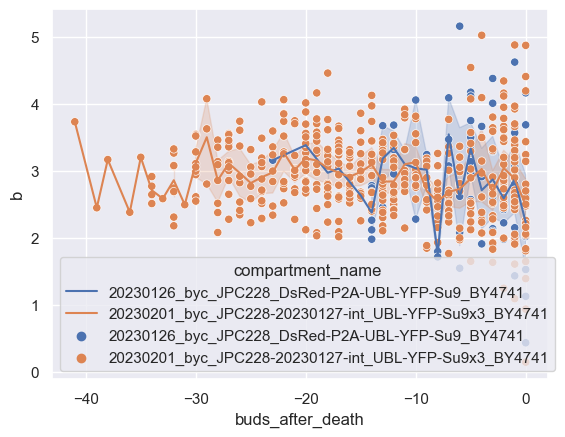

In [16]:
kwargs = {
    'x': 'buds_after_death',
    'y': 'b',
    'data': fits_df.loc[fits_df.compartment_name.isin(constants.compartments_dict['wt_ubl']), :],
    'hue': 'compartment_name'
}

sns.lineplot(**kwargs)
sns.scatterplot(**kwargs)

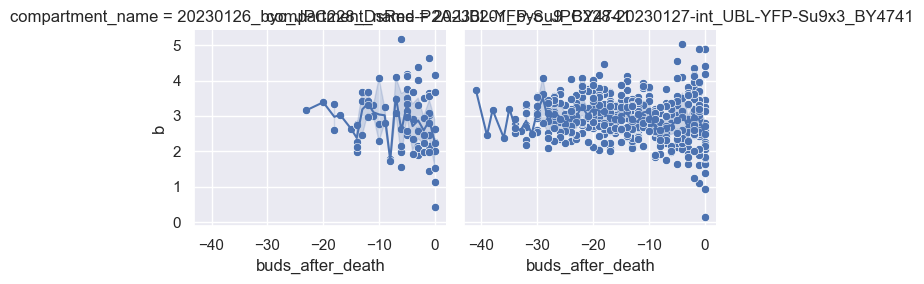

In [20]:
kwargs = {
    'x': 'buds_after_death',
    'y': 'b',
    'data': fits_df.loc[fits_df.compartment_name.isin(constants.compartments_dict['wt_ubl']), :],
    'hue': 'compartment_name'
}

grid = sns.FacetGrid(
    kwargs['data'],
    col='compartment_name',
)

grid.map(sns.scatterplot, kwargs['x'], kwargs['y'])
grid.map(sns.lineplot, kwargs['x'], kwargs['y'])

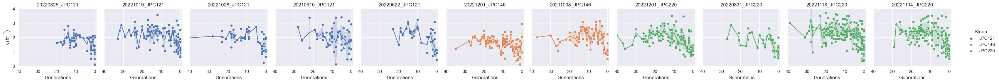

In [11]:
strains = [
    'JPC121',
    'JPC146',
    'JPC220'
]

# strains = [
#     'JPC122'
# ]
fits_df.loc[:, 'date_strain'] = fits_df.date.astype(str).str.cat(fits_df.strain_name, sep='_')
fits_df.sort_values(by='strain_name', inplace=True)
sns.set()
grid = sns.FacetGrid(fits_df.loc[(fits_df.strain_name.isin(strains))&(fits_df.compartment_name.isin(fits_df.compartment_name.unique())), :],
                     col='date_strain',
                     hue='strain_name')

grid.map(sns.lineplot, 'dist_from_sen', 'b')
grid.map(sns.scatterplot, 'dist_from_sen', 'b')
grid.add_legend(title='Strain')
grid.set(xlim=(40, -1), ylim=(0, 4), ylabel=plotting.annoying_strings().k_inverse_hrs, xlabel='Generations')
grid.set_titles(col_template="{col_name}")
grid.map(plt.axhline, y=0.5, ls=":", c=".5")

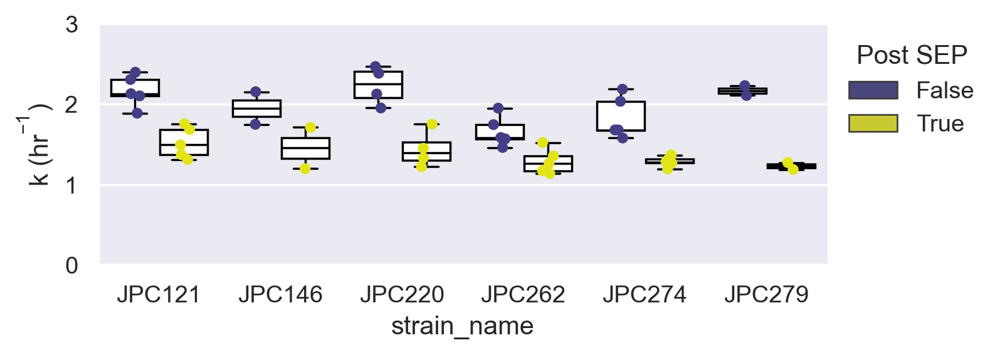

In [9]:
strains = [
    'JPC121',
    'JPC146',
    'JPC220',
    'JPC262',
    'JPC274',
    'JPC279'
]

# strains = [
#     'JPC122'
# ]
fig, ax = plotting.figure_ax(width_scale=3)
fits_df.loc[:, 'date_strain'] = fits_df.date.astype(str).str.cat(fits_df.strain_name, sep='_')
fits_df.sort_values(by='strain_name', inplace=True)
table = fits_df.groupby(['date_strain', 'post_sep', 'strain_name'], as_index=False).b.mean()
sns.set()
kwargs = {
    'x' : 'strain_name',
    'y': 'b',
    'hue': 'post_sep',
    'data': table[table.strain_name.isin(strains)],
    'hue_order': [False, True],
    'ax': ax,
    'dodge': True,
    'palette': plotting.get_pre_post_sep_palette()
}
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict)
sns.stripplot(**kwargs)
ax.set_ylim(0, 3)
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend(ax.get_legend_handles_labels()[0][0:2],
          ax.get_legend_handles_labels()[1][0:2],
          title='Post SEP',
          frameon=False,
          bbox_to_anchor=(1, 1))

### Correlation between RLS and young rate constant?

In [371]:
table.loc[table., ['compartment_name', 'strain_name', 'kmf_halflife', 'rls_suitable']].sort_values(by='strain_name')

,compartment_name,strain_name,kmf_halflife,rls_suitable
6,20220825_byc_JPC121_two-chase_1000xetOH,JPC121,17.0,False
9,20221019_byc_JPC228_UBL-YFP-Su9_full,JPC121,16.0,True
11,20221028_byc_JPC228_DsRed-P2A-UBL-YFP-Su9_3x-int,JPC121,18.0,True
7,20220825_byc_JPC122_two-chase_1000xetOH,JPC122,23.0,False
10,20221028_byc_JPC122_YFP-ODC_x3-int,JPC122,18.0,True
14,20221201_byc_JPC122_YFP-ODC,JPC122,16.0,True
1,20211008_byc_JPC146_UbiR-YFP-Su9_BY4741,JPC146,23.0,True
15,20221201_byc_JPC146_R-YFP-Su9_low-expr,JPC146,17.0,True
8,20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry,JPC220,22.0,False
12,20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,JPC220,17.0,True


In [372]:
for comp in table.compartment_name.unique():
    young_rate = fits_df.loc[(fits_df.compartment_name==comp)&(fits_df.dist_from_sen>10), 'b'].mean()
    old_rate = fits_df.loc[(fits_df.compartment_name==comp)&(fits_df.dist_from_sen<5), 'b'].mean()
    table.loc[table.compartment_name==comp, 'young_rate'] = young_rate
    table.loc[table.compartment_name==comp, 'old_rate'] = old_rate

In [373]:
table[table.strain_name=='JPC274'].loc[:, ['compartment_name', 'kmf_halflife', 'rls_suitable']]

,compartment_name,kmf_halflife,rls_suitable
21,20230518_byc_JPC274_R-YFP-Su9_mub1d,30.0,True
23,20230628_byc_JPC274_R-YFP-Su9_mub1d,26.0,False
25,20230714_byc_JPC274_R-YFP-Su9_mub1d,27.0,False
27,20230810_byc_JPC274_R-YFP-Su9_mub1d,28.0,True
29,20230822_byc_JPC274_R-YFP-Su9_in_mub1d,21.0,True


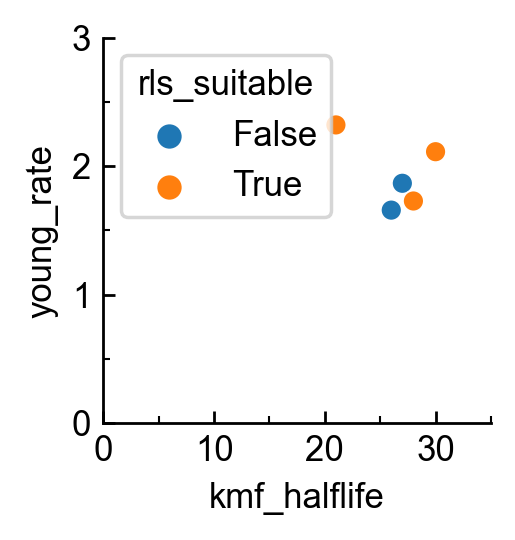

In [379]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'kmf_halflife',
    'y': 'young_rate',
    'hue': 'rls_suitable',
    'data': table[table.strain_name=='JPC274'],
    'ax': ax,
}

sns.scatterplot(**kwargs)
ax.set_xlim(0, 35)
ax.set_xticks(np.arange(0, 36, 10))
ax.set_ylim(0, 3)

plotting.format_ticks(ax)

### Checking average time of last bud to inform chase two timing

C:\Users\johnp\AppData\Local\Temp\ipykernel_14352\1237861435.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subbudsdf.loc[:, 'bud_hour'] = subbudsdf.bud_frame*10/60


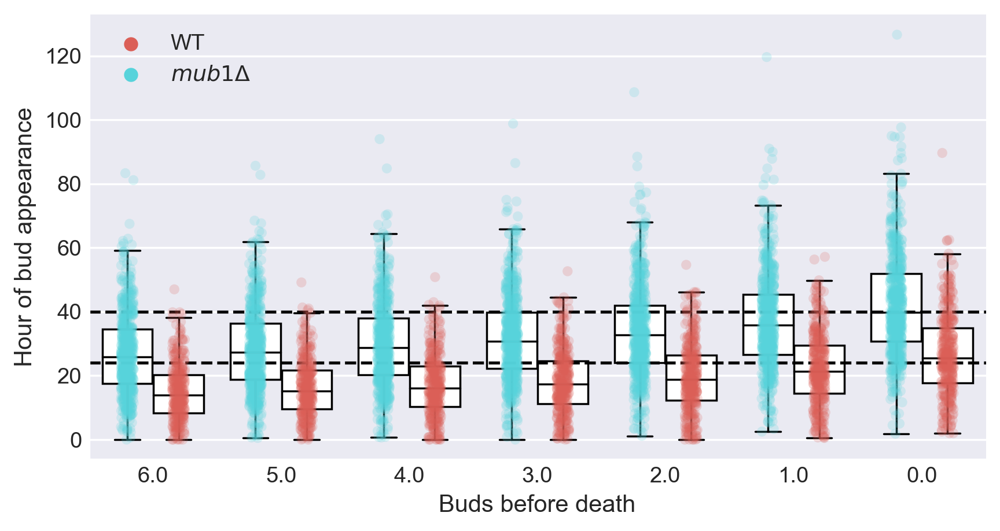

In [23]:
strains = [
    'JPC274',
    'JPC220'
]

subbudsdf = buds_df.loc[buds_df.strain_name.isin(strains), :]
fig, ax = plotting.figure_ax(width_scale=4, height_scale=2)
subbudsdf.loc[:, 'bud_hour'] = subbudsdf.bud_frame*10/60
kwargs = {
    'y': 'bud_hour',
    'x': 'dist_from_sen',
    'hue': 'strain_name',
    'ax': ax,
    'data': subbudsdf,
    'palette': 'hls',
    'dodge': True
}

sns.stripplot(**kwargs, alpha=0.2)
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
ax.legend(ax.get_legend_handles_labels()[0], ['WT', plotting.get_gene_deletion_string('mub1')], title='', frameon=False)
ax.set_xlim(6.5, -0.5)
ax.set_xlabel('Buds before death')
ax.set_ylabel('Hour of bud appearance')
ax.axhline(24, color='black', linestyle='--', linewidth=1.5)
ax.axhline(40, color='black', linestyle='--', linewidth=1.5)
plotting.format_ticks(ax, add_minor_x=False)

C:\Users\johnp\AppData\Local\Temp\ipykernel_14352\85067609.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subbudsdf.loc[:, 'bud_hour'] = subbudsdf.bud_frame*10/60


Saved figure at


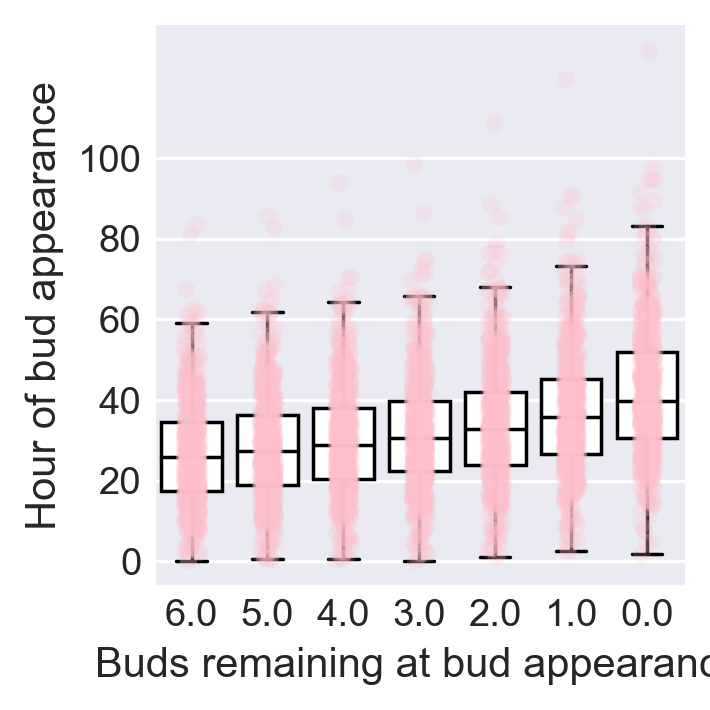

In [24]:
sns.set()

strains = [
    'JPC274',
]

subbudsdf = buds_df.loc[buds_df.strain_name.isin(strains), :]
fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)
subbudsdf.loc[:, 'bud_hour'] = subbudsdf.bud_frame*10/60
kwargs = {
    'y': 'bud_hour',
    'x': 'dist_from_sen',
    'ax': ax,
    'data': subbudsdf,
    'dodge': True,
    'color': 'pink'
}

sns.stripplot(**kwargs, alpha=0.2)
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)

ax.set_xlim(6.5, -0.5)
ax.set_yticks(np.arange(0, 101, 20))
plotting.format_ticks(ax, add_minor_x=False)

ax.set_xlabel('Buds remaining at bud appearance')
ax.set_ylabel('Hour of bud appearance')
fig.tight_layout()
plotting.save_figure(fig, kwargs, ext='.pdf')

In [25]:
aggdex = [
    'strain_name',
    'dist_from_sen',
]

cols = [
    'cycle_duration_hrs',
    'bud_frame',
    'bud_hour'
]

table = subbudsdf.loc[:, cols + aggdex].pivot_table(index=aggdex, aggfunc=np.median).reset_index()
table.loc[table.dist_from_sen<6, :]

,strain_name,dist_from_sen,bud_frame,bud_hour,cycle_duration_hrs
0,JPC274,0.0,239.0,39.833333,NaN
1,JPC274,1.0,215.0,35.833333,3.666667
2,JPC274,2.0,197.0,32.833333,2.500000
3,JPC274,3.0,184.0,30.666667,2.000000
4,JPC274,4.0,173.0,28.833333,1.666667
5,JPC274,5.0,164.0,27.333333,1.500000


## Figure 1: Ubiquitylated substrate degradation slows rapidly during the senescence entry point

### BYC device and chase system

In [5]:
compartmentname = "20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry_full-traces"
exptname = utilities.exptname_from_compartment(compartmentname)
compartmentdir = files.get_byc_compartmentdir(exptname, compartmentname)
filename = f'{exptname}_alldf.csv'
savepath = os.path.join(compartmentdir, filename)
table = pd.read_csv(savepath)
tracedfs = [table[table.cell_index==i] for i in table.cell_index.unique()]

# Read in bud ROIs
relpaths = table.bud_roi_set_relpath.unique()
budpaths = [os.path.abspath(os.path.join(constants.byc_data_dir, str(path))) for path in relpaths if str(path) != 'nan']
budroidfs = [files.read_rectangular_rois_as_df(path) for path in budpaths]

for buddf in budroidfs:

    buddf.loc[:, 'frame'] = buddf.position - 1
    buddf.loc[:, 'bud_hour'] = (buddf.frame*10)/60
    # The last ROI in the bud roi df is the death
    # frame so it's not an actual budding event
    buddf.loc[buddf.index.max(), 'bud_hour'] = np.nan

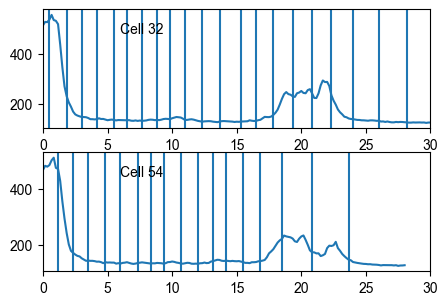

In [6]:
wanted_cells = [23, 28, 32, 54, 57, 87]
wanted_cells = [32, 54]
subtracedfs = [tracedfs[i] for i in wanted_cells]
subbudroidfs = [budroidfs[i] for i in wanted_cells]
fig, axes = plt.subplots(len(subtracedfs), 1)
fig.set_figwidth(5)
fig.set_figheight(len(subtracedfs)*1.7)


for i, df in enumerate(subtracedfs):
    buddf = subbudroidfs[i]
    ax = axes[i]
    ax.set_xlim(0, 30)
    cell_index = df.cell_index.iloc[0]
    ax.plot(df.hours, df.yfp_mean)
    ax.annotate(f'Cell {cell_index}', xy=(0.2, 0.8), xycoords='axes fraction')
    for bud in buddf.bud_hour:
        ax.axvline(bud)

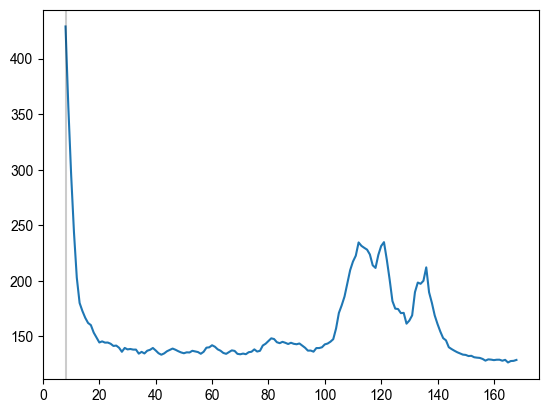

In [7]:
chase_frame2 = 8
plt.plot(df.frame[chase_frame2:], df.yfp_mean[chase_frame2:])
plt.axvline(chase_frame2, color='black', alpha=0.2)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=hours_y=yfp_mean_title=full_trace.svg


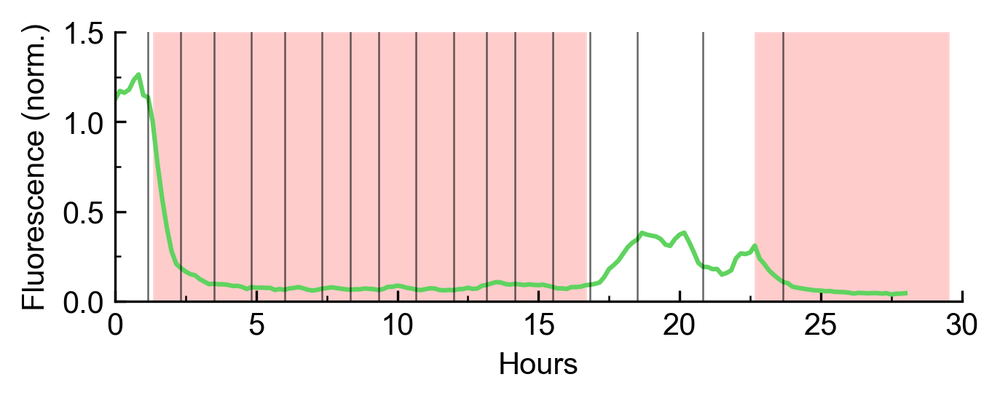

In [8]:
fig, ax = plotting.figure_ax(width_scale=2.5, height_scale=0.8)
fig.set_dpi(300)
chase_frame = 8
chase_frame2 = 136
df = tracedfs[54].copy()
buddf = budroidfs[54].copy()
if 'level_0' in df.columns:
    df.drop(columns=['level_0'], inplace=True)
df.sort_values(by='frame', ascending=True, inplace=True)
df.reset_index(inplace=True)
x = df.hours

y1 = df.yfp_mean - 115
y1 = y1/y1[chase_frame]
y2 = df.rfp_mean- df.rfp_mean.min()
y2 = y2/y2[chase_frame]
red  = (255/255, 0/255, 0/255)
green = (95/255, 211/255, 95/255)
ax.plot(x, y1, color=green, alpha=1)

ax.set_ylim(0, 1.5)
# ax.set_yticks([0, 0.5, 1])
ax.set_xlim(0, 30)
ax.set_ylabel('Fluorescence (norm.)')
ax.set_xlabel('Hours')

x1 = np.arange((chase_frame*10)/60, (chase_frame*10)/60+15.5, 0.1)
x2 = np.arange((chase_frame2*10)/60, (chase_frame2*10)/60+7, 0.1)
y = np.full(len(x1), 1.5)
y2  = np.full(len(x2), 1.5)
ax.fill_between(x1, y, color=red, alpha=0.2, edgecolor='white')
ax.fill_between(x2, y2, color=red, alpha=0.2, edgecolor='white')
for bud_hour in buddf.bud_hour:
    ax.axvline(bud_hour, color='black', alpha=0.6, lw=0.6)

plotting.format_ticks(ax)   

# Annotate chase periods
# rect = patches.Rectangle(((chase_frame*10)/60, 0), 3, 1, color='white', edgecolor='black')
# ax.add_patch(rect)

kwargs = {
    'x': 'hours',
    'y': 'yfp_mean',
    'title': 'full_trace'
}

plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\title=same_cell_young_old_x=hours_after_chase_y=yfp_mean_norm_to_chase.svg


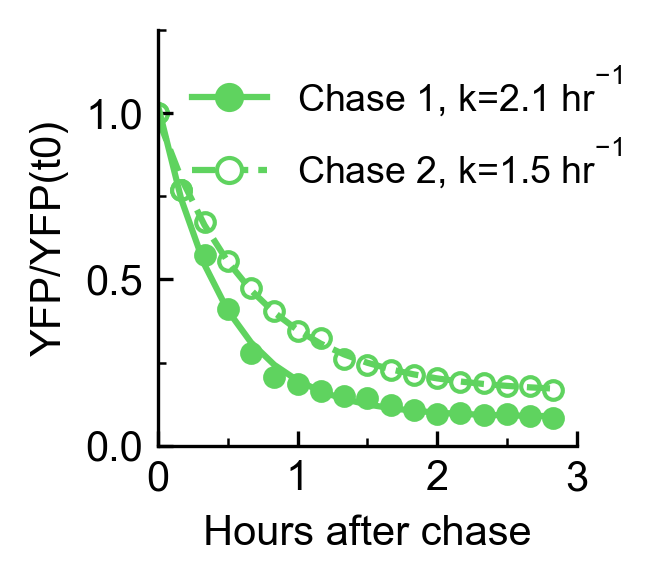

In [9]:
fig, ax = plotting.figure_ax(width_scale=0.9, height_scale=0.9)
fig.set_dpi(300)
window = 18

y = df.yfp_mean - 115
y1 = y/y[chase_frame]
y1 = y1[chase_frame:chase_frame+window]
y2 = y/y[chase_frame2]
y2 = y2[chase_frame2:chase_frame2+window]

x = df.hours[0: window]
size=20
ax.scatter(x, y1, color=green, s=size)
ax.scatter(x, y2, color='white', s=size, edgecolor=green)

ax.set_xlim(0, 3)
ax.set_xticks([0, 1, 2, 3])
ax.set_ylim(0, 1.25)
ax.set_yticks([0, 0.5, 1])

popt1, pcov = fitting_tools.curve_fit(fitting_tools.single_exp, x, y1)
popt2, pcov = fitting_tools.curve_fit(fitting_tools.single_exp, x, y2)
y_pred1 = fitting_tools.single_exp(x, *popt1)
y_pred2 = fitting_tools.single_exp(x, *popt2)

ax.plot(x, y_pred1, color=green)
ax.plot(x, y_pred2, color=green, linestyle='--')
ax.set_xlabel('Hours after chase')
ax.set_ylabel('YFP/YFP(t0)')

custom_lines = [Line2D([0], [0], color=green, linestyle='-', lw=1.5, marker='o'),
                Line2D([0], [0], color=green, linestyle='--', lw=1.5, marker='o', markerfacecolor='white')]
labels = [
    f'Chase 1, k={np.round(popt1[1], 1)} {plotting.annoying_strings().k_inverse_hrs[3:-1]}',
    f'Chase 2, k={np.round(popt2[1], 1)} {plotting.annoying_strings().k_inverse_hrs[3:-1]}'
]

ax.legend(custom_lines, labels, frameon=False, fontsize=9)

plotting.format_ticks(ax)

kwargs = {
    'title': 'same_cell_young_old',
    'x': 'hours_after_chase',
    'y': 'yfp_mean_norm_to_chase'
}

plotting.save_figure(fig, kwargs, ext='.svg')

### Senescence entry point detection and dynamics

#### Histogram of SEP across all cells

Text(0.1, 0.7, 'mean=-6.07')

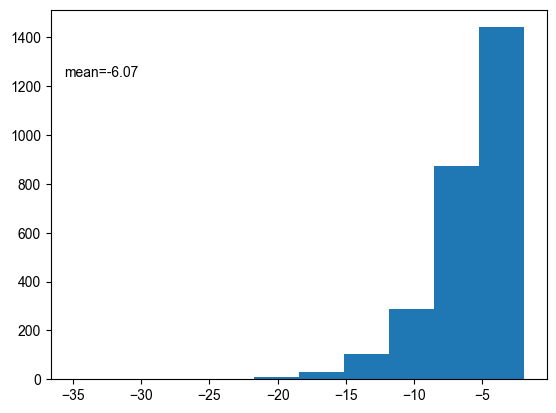

In [22]:
ax = plt.axes()

ax.hist(sepdf[sepdf.x0_stderr<10].x0)
ax.annotate(f'mean={np.round(sepdf[sepdf.x0_stderr<10].x0.mean(), 2)}', xy=(0.1, 0.7), xycoords='figure fraction')

#### Median and distribution of SEP found from piecewise fit for each samplename

<Axes: xlabel='x0', ylabel='samplename'>

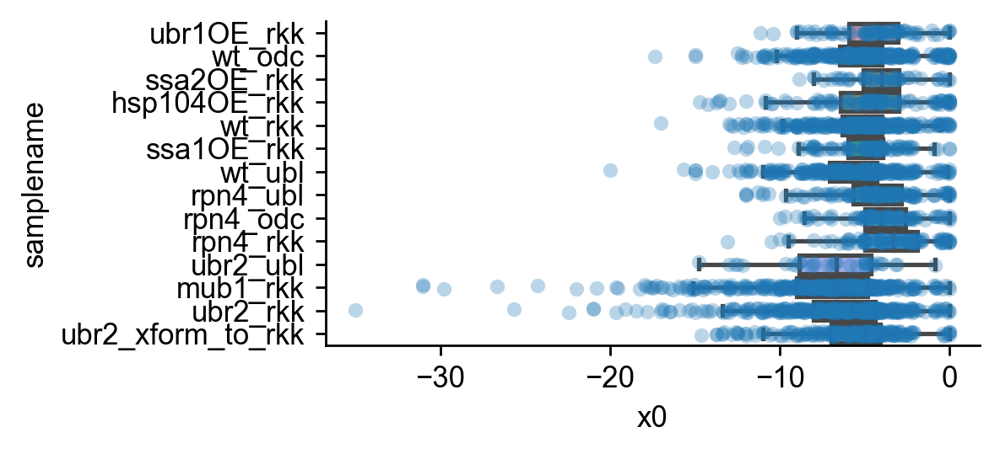

In [28]:
fig, ax = plotting.figure_ax(width_scale=2)

kwargs = {
    'y': 'samplename',
    'x': 'x0',
    'data': sepdf[np.abs(sepdf.x0_stderr_fraction)<0.5],
    'ax': ax
}

sns.boxplot(**kwargs, showfliers=False)
sns.stripplot(**kwargs, alpha=0.3)

# ax.set_ylim(-10, 5)

#### Post-SEP survival distributions

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\y=samplename_x=x0.svg


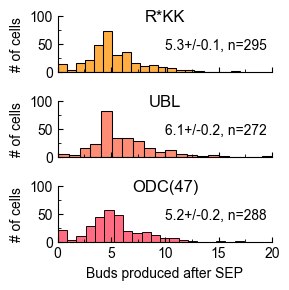

In [29]:
def annotate_mean(data, **kwargs):
    mean = np.round(data.mean(), 1)
    stderr = np.round(data.sem(), 1)
    plt.annotate(f'{mean}+/-{stderr}, n={len(data)}', xy=(0.5, 0.4), xycoords='axes fraction')
    
sepdf.loc[:, 'buds_after_sep'] = sepdf.x0*-1
x_order = [
    'wt_rkk',
    'wt_ubl',
    'wt_odc'
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC258'],
    strains_color_dict['JPC122']
]

titles = [
    'R*KK',
    'UBL',
    'ODC(47)'
]
databools = (sepdf.samplename.isin(x_order))&(np.abs(sepdf.x0_stderr_fraction)<0.5)&(sepdf.end_event_type=='death')&(sepdf.first_bud_frame<18)
grid = sns.FacetGrid(
    sepdf[databools],
    row='samplename',
    hue='samplename',
    hue_order=x_order,
    row_order=x_order,
    palette=palette
)
grid.map(sns.histplot, 'buds_after_sep', bins=20)
# grid.add_legend(title='Substrate')
grid.set_titles(row_template="{row_name}")
grid.map(annotate_mean, 'buds_after_sep')
grid.fig.set_figheight(3)
grid.fig.set_figwidth(3)

grid.set(xlim=(0, 20), ylim=(0, 100), ylabel='# of cells', xlabel='Buds produced after SEP')
for i, ax in enumerate(grid.axes.flat):
    ax.set_xticks(np.arange(0, 21, 5))
    ax.set_title(titles[i], y=0.75)
    plotting.format_ticks(ax)
plt.tight_layout()
plotting.save_figure(grid.fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\y=samplename_x=x0.svg


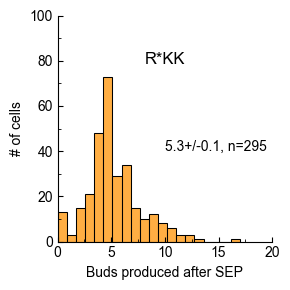

In [67]:
def annotate_mean(data, **kwargs):
    mean = np.round(data.mean(), 1)
    stderr = np.round(data.sem(), 1)
    plt.annotate(f'{mean}+/-{stderr}, n={len(data)}', xy=(0.5, 0.4), xycoords='axes fraction')
    
sepdf.loc[:, 'buds_after_sep'] = sepdf.x0*-1
x_order = [
    'wt_rkk',
]

palette = [
    strains_color_dict['JPC121'],
]

titles = [
    'R*KK',
]
databools = (sepdf.samplename.isin(x_order))&(np.abs(sepdf.x0_stderr_fraction)<0.5)&(sepdf.end_event_type=='death')&(sepdf.first_bud_frame<18)
grid = sns.FacetGrid(
    sepdf[databools],
    row='samplename',
    hue='samplename',
    hue_order=x_order,
    row_order=x_order,
    palette=palette
)
grid.map(sns.histplot, 'buds_after_sep', bins=20)
# grid.add_legend(title='Substrate')
grid.set_titles(row_template="{row_name}")
grid.map(annotate_mean, 'buds_after_sep')
grid.fig.set_figheight(3)
grid.fig.set_figwidth(3)

grid.set(xlim=(0, 20), ylim=(0, 100), ylabel='# of cells', xlabel='Buds produced after SEP')
for i, ax in enumerate(grid.axes.flat):
    ax.set_xticks(np.arange(0, 21, 5))
    ax.set_title(titles[i], y=0.75)
    plotting.format_ticks(ax)
plt.tight_layout()
plotting.save_figure(grid.fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\y=samplename_x=x0.svg


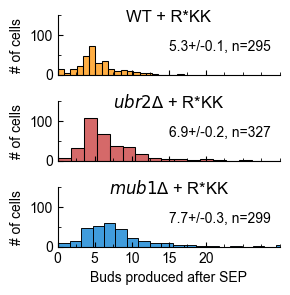

In [68]:
def annotate_mean(data, **kwargs):
    mean = np.round(data.mean(), 1)
    stderr = np.round(data.sem(), 1)
    plt.annotate(f'{mean}+/-{stderr}, n={len(data)}', xy=(0.5, 0.4), xycoords='axes fraction')
    
sepdf.loc[:, 'buds_after_sep'] = sepdf.x0*-1
x_order = [
    'wt_rkk',
    'ubr2_rkk',
    'mub1_rkk',
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC262'],
    strains_color_dict['JPC274']
]

titles = [
    'WT + R*KK',
    plotting.get_gene_deletion_string('ubr2') + ' + R*KK',
    plotting.get_gene_deletion_string('mub1') + ' + R*KK'
]
databools = (sepdf.samplename.isin(x_order))&(np.abs(sepdf.x0_stderr_fraction)<0.5)&(sepdf.end_event_type=='death')&(sepdf.first_bud_frame<18)
grid = sns.FacetGrid(
    sepdf[databools],
    row='samplename',
    hue='samplename',
    hue_order=x_order,
    row_order=x_order,
    palette=palette
)
grid.map(sns.histplot, 'buds_after_sep', bins=20)
# grid.add_legend(title='Substrate')
grid.set_titles(row_template="{row_name}")
grid.map(annotate_mean, 'buds_after_sep')
grid.fig.set_figheight(3)
grid.fig.set_figwidth(3)

grid.set(xlim=(0, 30), ylim=(0, 150), ylabel='# of cells', xlabel='Buds produced after SEP')
for i, ax in enumerate(grid.axes.flat):
    ax.set_xticks(np.arange(0, 21, 5))
    ax.set_title(titles[i], y=0.75)
    plotting.format_ticks(ax)
plt.tight_layout()
plotting.save_figure(grid.fig, kwargs, ext='.svg')

#### Pre-SEP survival distributions

In [69]:
# Need to label cells with their RLS so we can calculate
# buds produced before the SEP
database.label_sepdf_and_buds_df(sepdf, buds_df)

No buds_df data for cell5 of 2996
20230518_byc_JPC274_R-YFP-Su9_mub1d-0-6-13-20-27-33-40-47-55-62-71-81-96-117-129


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\y=samplename_x=x0.svg


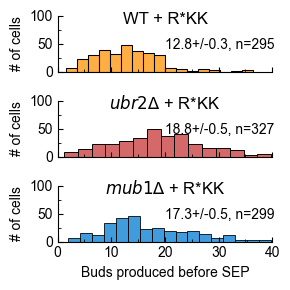

In [70]:
xlim = (0, 40)
grid = sns.FacetGrid(
    sepdf[databools],
    row='samplename',
    hue='samplename',
    hue_order=x_order,
    row_order=x_order,
    palette=palette
)
grid.map(sns.histplot, 'buds_before_sep', bins=20)
# grid.add_legend(title='Substrate')
grid.set_titles(row_template="{row_name}")
grid.map(annotate_mean, 'buds_before_sep')
grid.fig.set_figheight(3)
grid.fig.set_figwidth(3)

grid.set(xlim=xlim, ylim=(0, 100), ylabel='# of cells', xlabel='Buds produced before SEP')
for i, ax in enumerate(grid.axes.flat):
    ax.set_xticks(np.arange(0, np.max(xlim)+1, 10))
    ax.set_title(titles[i], y=0.7)
    plotting.format_ticks(ax)
plt.tight_layout()
plotting.save_figure(grid.fig, kwargs, ext='.svg')

#### Validation of SEP fitting: cycle duration vs. dist from SEP with hue for different SEP classifications

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_after_SEP_rounded_y=cycle_duration_hrs_hue=SEP_bin.svg


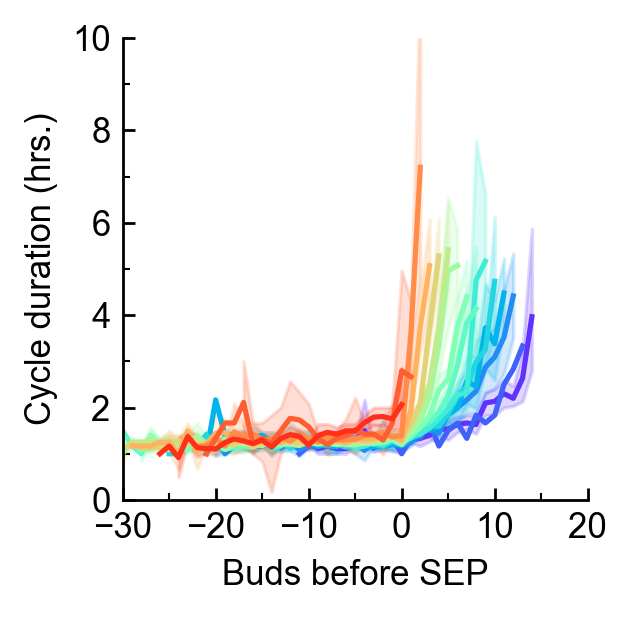

In [71]:
all_wt_comps = constants.compartments_dict['wt_rkk'] + constants.compartments_dict['wt_ubl'] + constants.compartments_dict['wt_odc']
bins = np.arange(-15, 0.1, 1)
buds_df.loc[:, 'SEP_bin'] = pd.cut(buds_df.SEP, bins)
fig, ax = plotting.figure_ax(width_scale=3/2.5, height_scale=3/2.5)
buds_df.loc[:, 'buds_after_SEP'] = buds_df.buds_after_death - buds_df.SEP
buds_df.loc[:, 'buds_after_SEP_rounded'] = np.round(buds_df.buds_after_SEP)
kwargs = {
    'x': 'buds_after_SEP_rounded',
    'y': 'cycle_duration_hrs',
    'hue': 'SEP_bin',
    'data': buds_df[(buds_df.SEP_stderr_frac<0.3)&(buds_df.compartment_name.isin(all_wt_comps))],
    'ax': ax,
    'palette': 'rainbow'
}

sns.lineplot(**kwargs)
ax.set_xlim(-30, 20)
ax.set_xticks(np.arange(np.min(ax.get_xlim()), np.max(ax.get_xlim())+1, 10))
ax.set_ylim(0, 10)
plotting.format_ticks(ax)
ax.set_ylabel('Cycle duration (hrs.)')
ax.set_xlabel('Buds before SEP')
ax.legend_.set_visible(False)
plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\notebooks\plots\gen_from_death_color_palette_max_dist_from_sen=-1.svg


C:\Users\johnp\Dropbox\Projects\byc\byc\plotting.py:1098: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


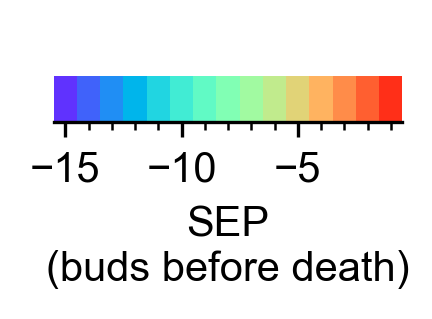

In [124]:
reload(plotting)
handles, labels = ax.get_legend_handles_labels()[0], ax.get_legend_handles_labels()[1]
colors = [line.get_color() for line in handles]

plotting.plot_dist_from_sen_palette_key(
    max_dist_from_sen=-1,
    min_dist_from_sen=-15,
    colors=colors,
    direction='ascending',
    xlabel='SEP\n(buds before death)')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\notebooks\plots\gen_from_death_color_palette_max_dist_from_sen=15.svg


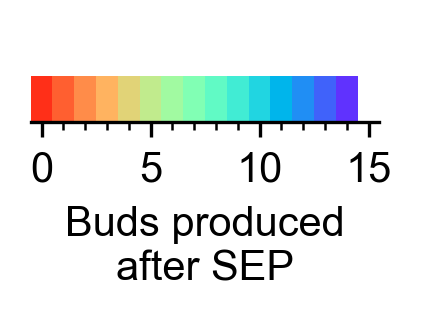

In [79]:
reload(plotting)
handles, labels = ax.get_legend_handles_labels()[0], ax.get_legend_handles_labels()[1]
colors = [line.get_color() for line in handles]
colors.reverse()
plotting.plot_dist_from_sen_palette_key(
    max_dist_from_sen=15,
    min_dist_from_sen=0,
    colors=colors,
    direction='descending',
    xlabel='Buds produced\nafter')

#### Plotting representative piecewise fits

Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-37-52-58-68-74-81-90-99-106-114-120-128-137-150-167-182-201-220-250-277-314_SEP_fit.png
Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-7-21-29-40-49-60-79-91-99-106-114-121-128-137-143-152-162-171-180-191-201-214-226-239-258-270-298-440_SEP_fit.png
Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\20221019_byc_JPC228_UBL-YFP-Su9_full-11-17-26-34-40-48-55-66-83-96-102-111-119-126-133-138-145-153-159-167-176-188-197-210-224-243-258-282-313-418_SEP_fit.png
Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\20221019_byc_JPC228_UBL-YFP-Su9_full-3-10-19-29-35-42-51-60-69-79-90-103-114-151-175-196-305_SEP_fit.png
Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\20221019_byc_JPC228_UBL-YFP-Su9_full-6-14-22-32-36-43-51-62-70-78-85-94-100-109-115-124-130-138-146-153-165-174-190-210-227-241-273-330_SEP_fit.

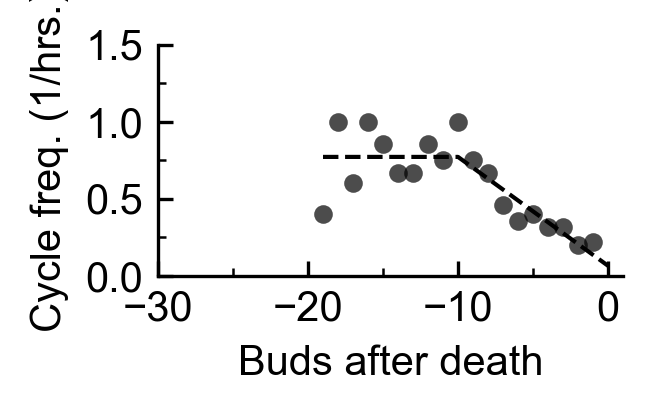

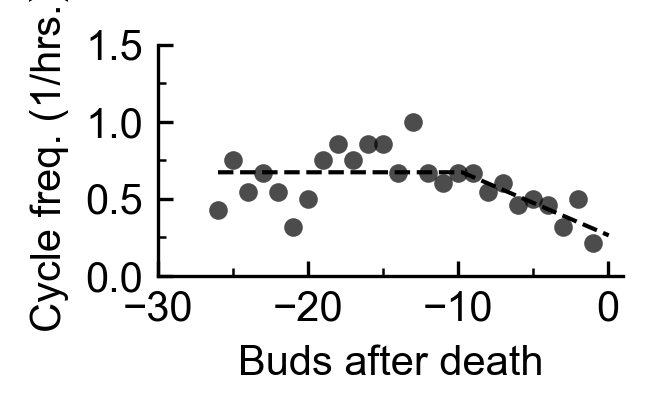

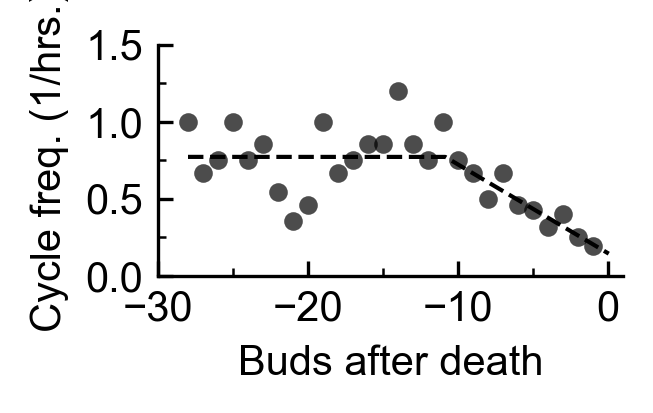

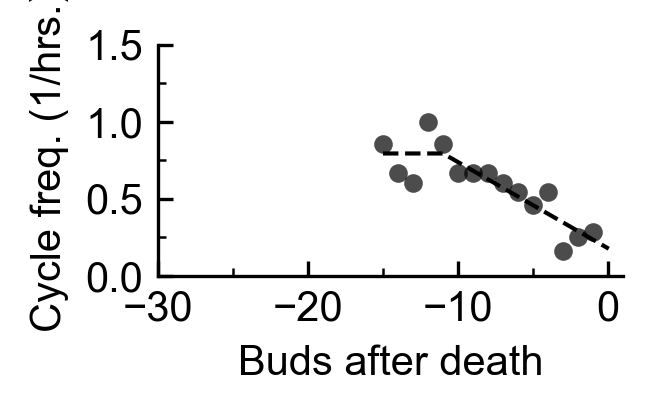

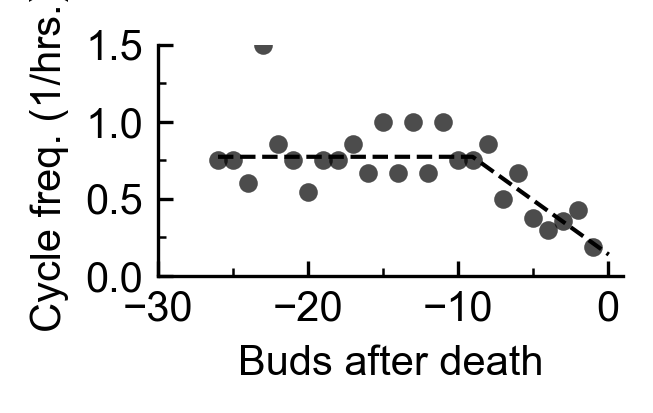

...

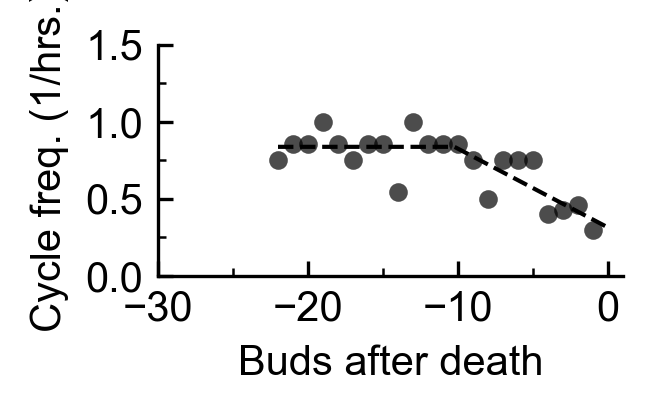

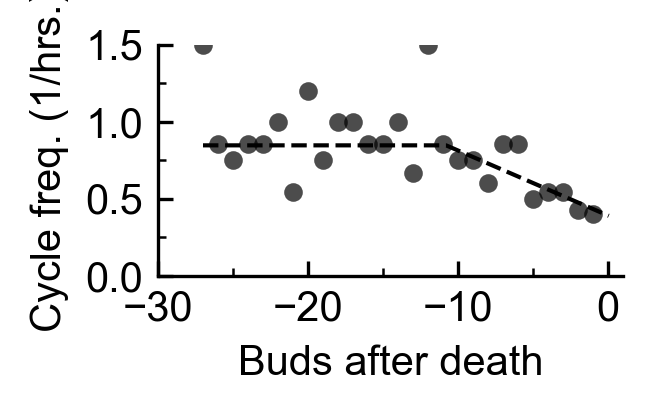

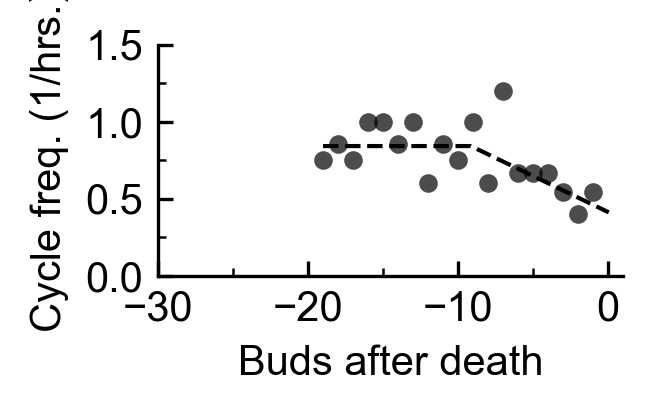

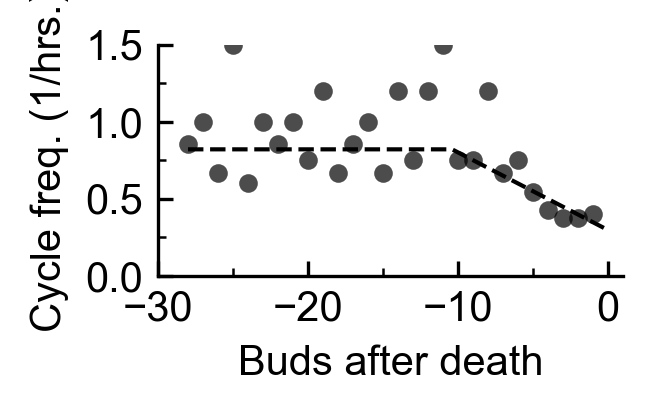

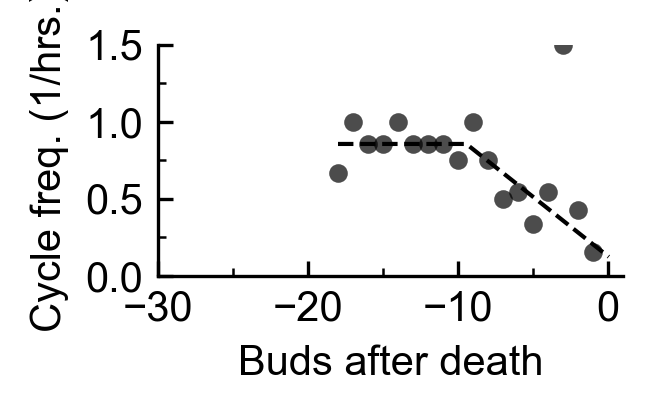

In [963]:
subbool = (sepdf.samplename.isin(['wt_rkk', 'wt_ubl', 'wt_odc']))
errbool = (np.abs(sepdf.x0_stderr_fraction)<0.3)
sepbool = (sepdf.x0.between(-11, -9, inclusive='both'))
rlsbool = (sepdf.rls>15)

for buddex in sepdf.loc[subbool&errbool&sepbool&rlsbool, 'compartment_bud_id']:
    fig, ax = plotting.figure_ax(height_scale=0.5, width_scale=1)
    x = buds_df.loc[buds_df.compartment_bud_id==buddex, 'buds_after_death']
    y = buds_df.loc[buds_df.compartment_bud_id==buddex, 'bud_frequency_per_hr']
    # Plot fit
    params = [sepdf.loc[sepdf.compartment_bud_id==buddex, var].iloc[0] for var in ['x0', 'y0', 'k1']]
    xsmooth = np.arange(np.min(x), np.max(x)+0.1, 0.05)
    ypred = fitting_tools.piecewise_linear(xsmooth, *params)
    ax.plot(xsmooth, ypred, linestyle='--', color='black', linewidth=1)
    # Plot data
    ax.scatter(x, y, color='black', s=20, alpha=0.7, linewidth=0)
    ax.set_ylim(0, 1.5)
    ax.set_xlim(-30, 1)
    ax.set_xticks(np.arange(np.min(ax.get_xlim()), np.max(ax.get_xlim()), 10))
    ax.set_yticks([0, 0.5, 1, 1.5])
    plotting.format_ticks(ax)
    ax.set_xlabel('Buds after death')
    ax.set_ylabel('Cycle freq. (1/hrs.)')
    fig.set_dpi(300)
    path = os.path.abspath(os.path.join(constants.byc_data_dir, f'meta/{buddex}_SEP_fit.png'))
    fig.savefig(path)
    fig.savefig(path.replace('.png', '.svg'))
    print(f'Figure saved at\n{path}')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\title=rep_cell_sep_fits.svg


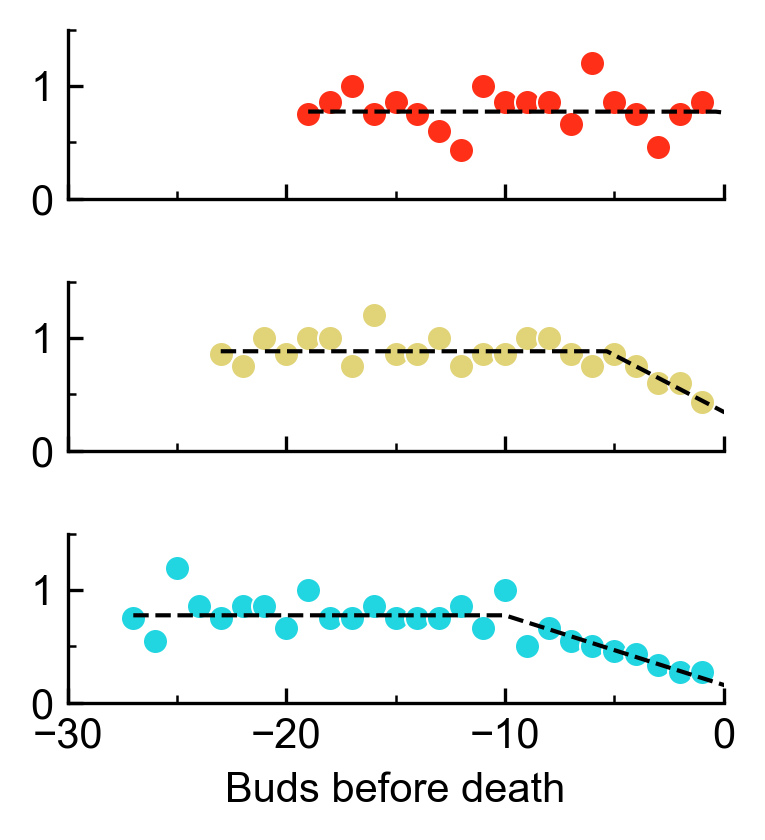

In [135]:
rep_cells = [
    '20221201_byc_JPC122_YFP-ODC-32-40-47-53-61-68-76-86-100-106-113-120-127-136-141-148-156-169-177-184-316',
    '20221028_byc_JPC228_DsRed-P2A-UBL-YFP-Su9_3x-int-7-14-22-28-35-41-47-55-60-67-74-80-88-95-102-108-114-121-129-136-144-154-164-178-242',
    '20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741-4-12-23-28-35-43-50-57-66-72-80-88-95-103-111-119-126-135-141-153-162-173-185-198-212-230-252-274-304'
]


def plot_fit(compartment_bud_id, **kwargs):
    # Plot fit using sepdf information
    buddex = np.unique(compartment_bud_id)[0]
    params = [sepdf.loc[sepdf.compartment_bud_id==buddex, var].iloc[0] for var in ['x0', 'y0', 'k1']]
    x = buds_df.loc[buds_df.compartment_bud_id==buddex, 'buds_after_death']
    xsmooth = np.arange(np.min(x), np.max(x)+0.1, 0.05)
    ypred = fitting_tools.piecewise_linear(xsmooth, *params)
    plt.plot(xsmooth, ypred, linestyle='--', color='black', linewidth=1)

selectbool = buds_df.compartment_bud_id.isin(rep_cells)
grid = sns.FacetGrid(
    buds_df[selectbool],
    row='compartment_bud_id',
    hue='compartment_bud_id',
    sharey=True,
    row_order=rep_cells,
    hue_order=rep_cells,
    palette=[colors[i] for i in [-1, -5, -11]]
)


# Plot data
grid.map(sns.scatterplot, 'buds_after_death', 'bud_frequency_per_hr')
grid.set_titles(row_template='')
grid.map(plot_fit, 'compartment_bud_id')
grid.fig.set_figwidth(3)
grid.fig.set_figheight(3)
grid.fig.set_dpi(300)
grid.set(ylim=(0, 1.5), xlim=(-30, 0), xlabel='Buds before death', ylabel='Bud freq. (1/hrs.)')
plt.tight_layout()
for ax in grid.axes.flat:
    plotting.format_ticks(ax)
    ax.set_ylabel('')
plotting.save_figure(grid.fig, {'title': 'rep_cell_sep_fits'}, ext='.svg')

### Relationship between degradation rate and distance from last bud

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC262.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC262.png
Buds before SEP max of 18.0 and min of -55.0


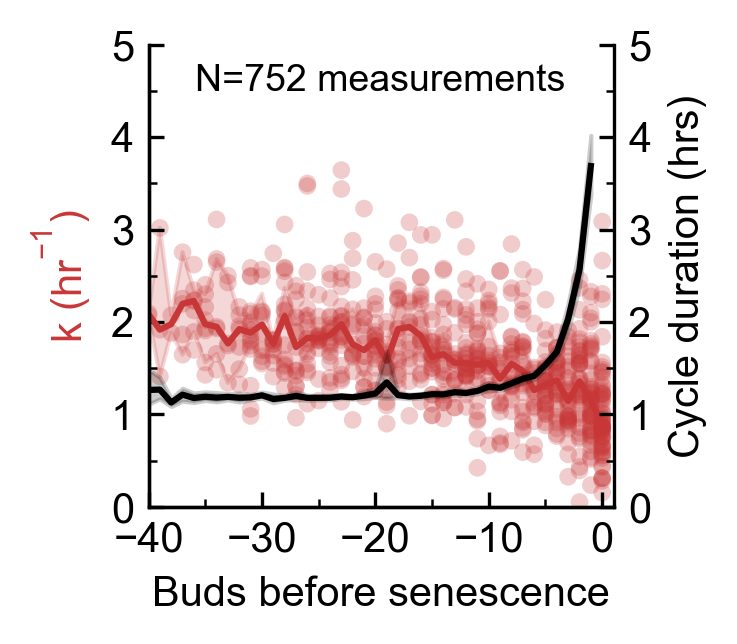

In [226]:
strain = 'ubr2_rkk'
compartments = constants.compartments_dict[strain]
sub_fits_df = fits_df[
    (fits_df.compartment_name.isin(compartments)) &
    (~fits_df.buds_before_SEP.isna()) &
    (fits_df.x0_stderr_fraction.abs()<1)]
sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
    sub_fits_df,
    sub_buds_df,
    yvar1='b',
    yvar2='cycle_duration_hrs',
    xvar='buds_after_death',
    fit_type='median', 
    xlabel='Buds before senescence',
    xlim=(-40, 1),
    ylim_k=(0, 5),
    ylim_cycle=(0, 5),
    shade_stderr=False,
    fillalpha=0.25,
    fillsep=False,
    width_scale=1,
)

print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')

### Relationship between degradation rate and distance from SEP

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC262.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC262.png
Buds before SEP max of 18.0 and min of -55.0


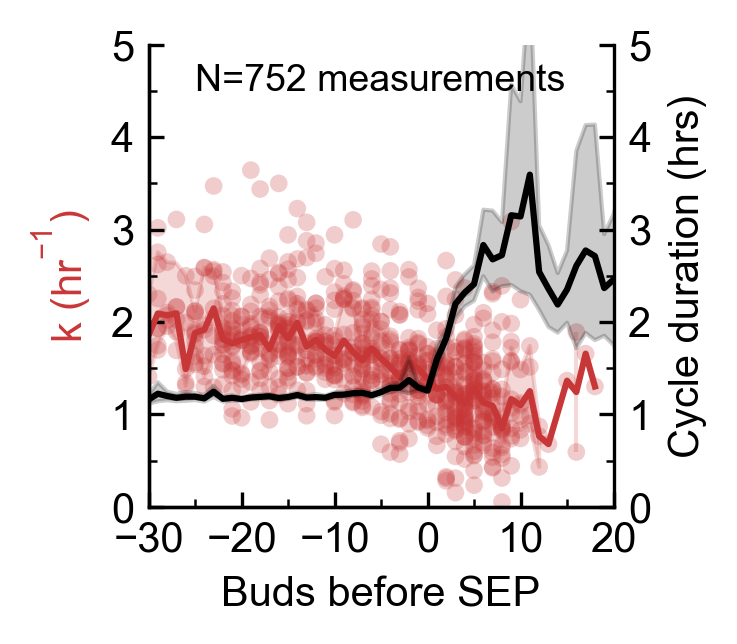

In [224]:
strain = 'ubr2_rkk'
compartments = constants.compartments_dict[strain]
sub_fits_df = fits_df[
    (fits_df.compartment_name.isin(compartments)) &
    (~fits_df.buds_before_SEP.isna()) &
    (fits_df.x0_stderr_fraction.abs()<1)]
sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
    sub_fits_df,
    sub_buds_df,
    yvar1='b',
    yvar2='cycle_duration_hrs',
    xvar='buds_before_SEP',
    fit_type='median',
    xlabel='Buds before SEP',
    xlim=(-30, 20),
    ylim_k=(0, 5),
    ylim_cycle=(0, 5),
    shade_stderr=False,
    fillalpha=0.25,
    fillsep=False,
    width_scale=1,
)

print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')

#### Change in rate constant from cells measured before vs. after measured SEP

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=pre_SEP_y=b.svg


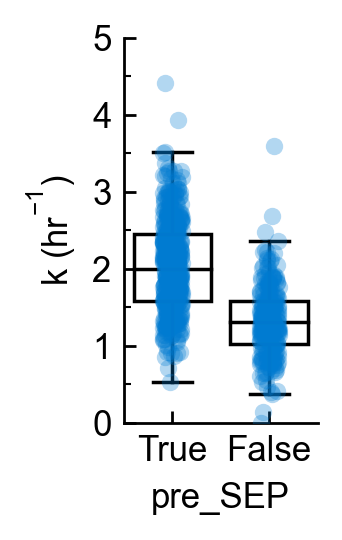

In [19]:
strain = 'mub1_rkk'
compartments = constants.compartments_dict[strain]
sub_fits_df = fits_df[
    (fits_df.compartment_name.isin(compartments)) &
    (~fits_df.buds_before_SEP.isna()) &
    (fits_df.x0_stderr_fraction.abs()<1)]

fig, ax = plotting.figure_ax(width_scale=0.5)
kwargs = {
    'x': 'pre_SEP',
    'y': 'b',
    'data': sub_fits_df,
    'ax': ax,
    'order': [True, False]
}

sns.stripplot(**kwargs, alpha=0.3, color=plotting.strains_color_dict[sub_fits_df.strain_name.iloc[0]])
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)

ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_ylim(0, 5)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

#### Looking for SEP border that gives maximium difference between pre and post SEP

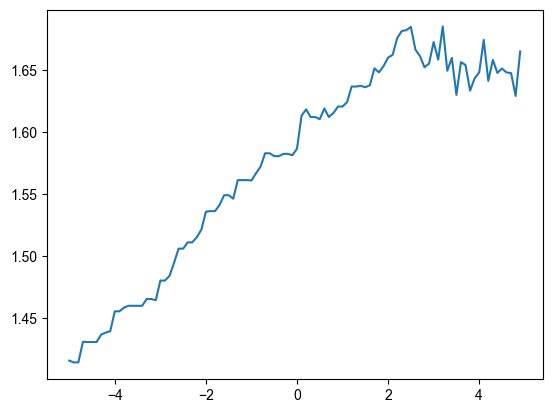

In [198]:
thresholds = np.arange(-5, 5, 0.1)
diffs = []
for threshold in thresholds:
    pre_sep_rate = sub_fits_df[sub_fits_df.buds_before_SEP<threshold].b.mean()
    post_sep_rate = sub_fits_df[sub_fits_df.buds_before_SEP>threshold].b.mean()
    diff = pre_sep_rate/post_sep_rate
    diffs.append(diff)
    
plt.plot(thresholds, diffs)

### Relationship between degradation rate and hours from last bud

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC274.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC274.png
Buds before SEP max of 17.0 and min of -45.0


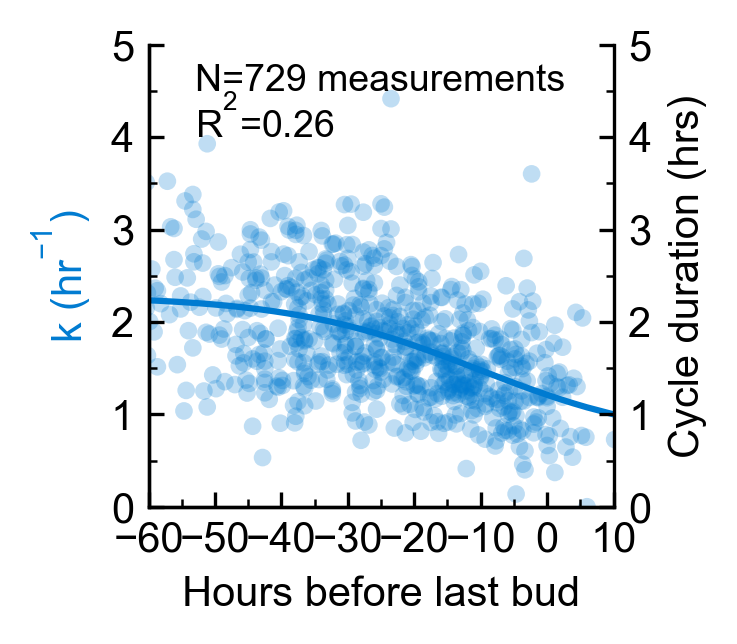

In [35]:
strain = 'mub1_rkk'
compartments = constants.compartments_dict[strain]
sub_fits_df = fits_df[
    (fits_df.compartment_name.isin(compartments)) &
    (~fits_df.buds_before_SEP.isna()) &
    (fits_df.x0_stderr_fraction.abs()<1)]
sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
    sub_fits_df,
    sub_buds_df,
    yvar1='b',
    yvar2=None,
    xvar='hours_before_last_bud',
    fit_type='logistic',
    xlabel='Hours before last bud',
    xlim=(-60, 10),
    ylim_k=(0, 5),
    ylim_cycle=(0, 5),
    shade_stderr=False,
    fillalpha=0.25,
    fillsep=False,
    width_scale=1,
)

print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')

### Plot YFP vs. time after chase traces for individual strains

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_input_y=y_input_norm_hue=buds_after_death_strain=JPC122.svg


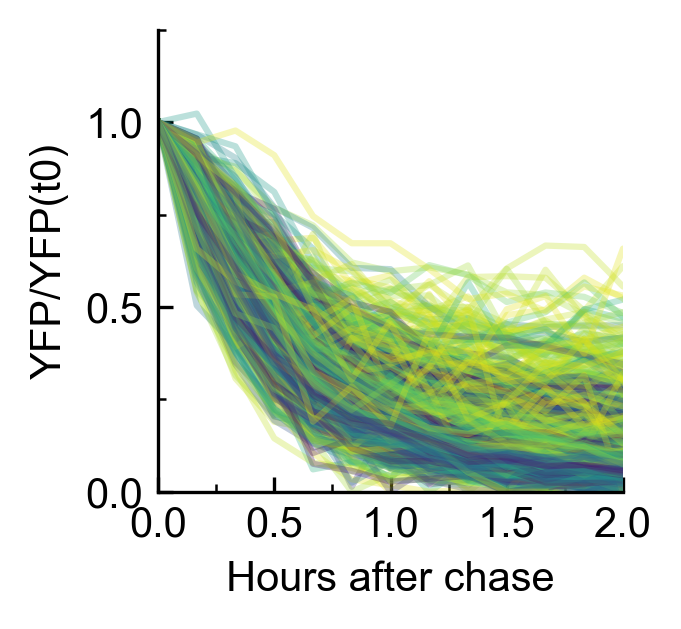

In [25]:
plot_means = False
plotting.set_styles(matplotlib, plt)
sub_traces_df = traces_df[traces_df.compartment_name.isin(constants.compartments_dict['wt_odc'])]
strains = sub_traces_df.strain_name.unique()
sub_traces_df = sub_traces_df[sub_traces_df.dist_from_sen>-1]
sub_traces_df.loc[:, 'measdex'] = sub_traces_df.measdex.str.cat(sub_traces_df.dist_from_sen.astype(str), sep='-')
sub_traces_df.loc[:, 'dist_from_sen_bin'] = '>7'
sub_traces_df.loc[sub_traces_df.dist_from_sen<=7, 'dist_from_sen_bin'] = '<=7'
sub_traces_df.dropna(subset=['dist_from_sen_bin'], inplace=True)
name= '-'.join(strains)
filename = f'{name}'
# sub_traces_df = sub_traces_df[~sub_traces_df.compartment_name.isin(skip_comps)]
# Define plotting variables
yvar = 'y_input_norm'
xvar = 'x_input'
huevar = 'buds_after_death'
alpha = 0.3
size =14
fontsize=10
linewidth = 1
xlim = (0, 2)
ylim = (0, 1.25)
ylabel = 'YFP/YFP(t0)'
xlabel = 'Hours after chase'
# Make palette
min_dist_from_sen = int(np.min(sub_traces_df[huevar]))
min_dist_from_sen = -20
max_dist_from_sen = 0
colors = sns.color_palette('viridis_r', max_dist_from_sen - min_dist_from_sen +1)
colors_list = [c for c in colors]
colors_list.reverse()
keys = list(range(min_dist_from_sen, max_dist_from_sen + 1))
palette_dict = dict(zip(keys, colors_list))

wanted = [
    2,
    20
    ]
median_colors = [colors_list[i] for i in wanted]
fig, ax = plotting.figure_ax()
fig.set_dpi(300)
# Subsample so we're not overplotting too much
n_cells_to_sample = 1000
random_seed = 1
if len(sub_traces_df.measdex.unique()) >= n_cells_to_sample:
    measdices_to_plot = np.random.choice(sub_traces_df.measdex.unique(), n_cells_to_sample, replace=False)
else:
    measdices_to_plot = sub_traces_df.measdex.unique()

previous_measdices = []
for measdex in measdices_to_plot:
    # Making sure I don't plot duplicates
    if measdex not in previous_measdices:
        subdf = sub_traces_df.set_index('measdex').loc[measdex, :].reset_index()
        subdf.sort_values(by=xvar, inplace=True, ascending=True)
        bin_name = subdf.loc[0, 'dist_from_sen_bin']
        dist_from_sen = subdf.loc[0, huevar]
        key = int(dist_from_sen)
        if key < min_dist_from_sen:
            key = min_dist_from_sen
        color = palette_dict[key]
        ax.plot(subdf[xvar], subdf[yvar], color=color, alpha=alpha)
    else:
        print(f'Duplicate measurements:\n{measdex}')
    previous_measdices.append(measdex)


linekwargs = {
    'x': xvar,
    'y': yvar,
    'data': subdf,
    'hue': huevar,
    'ax': ax,
    'estimator': 'mean',
    'palette': median_colors,
    'hue_order': sub_traces_df[huevar].unique()
}
if plot_means:
    sns.lineplot(**linekwargs)
    L=ax.legend(title="Buds before death.", frameon=False)
    labels = df[huevar].unique()

    for idx in range(len(labels)):
        L.get_texts()[idx].set_text(labels[idx])


ax.set_xlim(xlim)
ax.set_ylim(ylim)
ax.set_yticks(np.arange(0, 1.1, 0.5))
ax.set_xticks(np.arange(0, 2.1, 0.5))

plotting.remove_spines(ax)
plotting.format_ticks(ax)

ax.set_ylabel(ylabel, fontsize=fontsize, color='black')
ax.set_xlabel(xlabel, fontsize=fontsize)

linekwargs['strain'] = strains[0]
plotting.save_figure(fig, linekwargs, ext='.svg')

Make color palette key for above

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\notebooks\plots\gen_from_death_color_palette_max_dist_from_sen=0.svg


C:\Users\johnp\Dropbox\Projects\byc\byc\plotting.py:1099: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


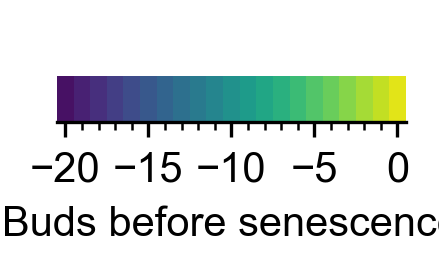

In [23]:
plotting.plot_dist_from_sen_palette_key(max_dist_from_sen=max_dist_from_sen,
                                        min_dist_from_sen=min_dist_from_sen,
                                        direction='ascending',
                                        xlabel='Buds before senescence')

### Plot rate constant (k) vs. buds before senescence

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.png


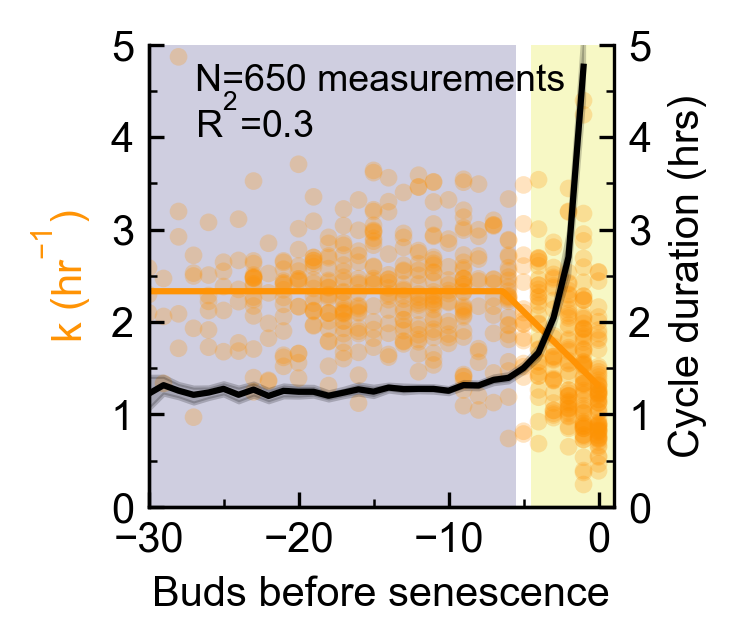

In [8]:
plotting.set_styles(plt, matplotlib)
reload(fitting_tools)
reload(plotting)
# strains = ['JPC121', 'JPC146', 'JPC220']
# # strains = ['JPC122']
# # strains = ['JPC258', 'JPC228']
# # strains = ['JPC258_r']
# # strains = ['JPC259']
# # strains = ['JPC199']
# # strains = ['JPC193']
# # strains = ['JPC262']
# # strains = ['JPC136']
# # strains = ['JPC274']
skip_comps = [
]
comps_list = constants.compartments_dict['wt_rkk']
# comps_list = fits_df.loc[fits_df.strain_name=='JPC279', 'compartment_name'].unique()
sub_fits_df = fits_df[fits_df.compartment_name.isin(comps_list)]
# sub_fits_df = sub_fits_df[~sub_fits_df.b.isna()]
sub_bud_df = buds_df[buds_df.compartment_name.isin(comps_list)]

result, results_df = plotting.plot_k_vs_dist_from_sen(
    sub_fits_df,
    sub_bud_df[sub_bud_df.cycle_duration_hrs<55],
    fillsep=True,
    fit_type='piecewise',
    xlim=(-30, 1))

### Illustrate differences in logistic fit between guess, free fit on all four paramaters, and constrained fit with only slope and x_center free on k vs. buds before death

##### Define booleans for sub selecting data

In [4]:
reload(fitting_tools)
ubr2_comps = [
    '20230810_byc_JPC262_R-YFP-Su9_ubr2d',
    '20230714_byc_JPC262_R-YFP-Su9_ubr2d',
    '20230822_byc_JPC262_R-YFP-Su9_in_ubr2d'
]

mub1_comps = [
    '20230822_byc_JPC274_R-YFP-Su9_in_mub1d',
    '20230518_byc_JPC274_R-YFP-Su9_mub1d',
    '20230810_byc_JPC274_R-YFP-Su9_mub1d'
]

wt_comps = [
    '20211008_byc_JPC146_UbiR-YFP-Su9_BY4741',
    '20221019_byc_JPC228_UBL-YFP-Su9_full',
    '20221028_byc_JPC228_DsRed-P2A-UBL-YFP-Su9_3x-int',
    '20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry',
    '20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry',
    '20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry'
]

comps_dict = {
    'ubr2': ubr2_comps,
    'mub1': mub1_comps,
    'wt': wt_comps
}

wtbool = (fits_df.compartment_name.isin(wt_comps))
ubr2bool = (fits_df.compartment_name.isin(ubr2_comps))
mub1bool = (fits_df.compartment_name.isin(mub1_comps))

##### Fit exponential curve to each dataset separately and to all data at once

Lets us know if pooling data gives similar result. I don't think I should do this with everything by standard because the mub1/ubr2 data have some weird replicates

In [5]:
resultdfs = []
results = []
for comp in wt_comps:
    result, resultsdf = fitting_tools.fit_model_to_df(
        fits_df,
        fits_df.compartment_name==comp,
        fitting_tools.model_guesses.exponential_turn_down[0],
        fitting_tools.model_guesses.exponential_turn_down[1]
    )
    resultdfs.append(resultsdf)
    results.append(result)
    
wtresultsdf = pd.concat(resultdfs)

reload(fitting_tools)

bulkresult, bulkresultdf = fitting_tools.fit_model_to_df(
    fits_df,
    wtbool,
    fitting_tools.model_guesses.exponential_turn_down[0],
    fitting_tools.model_guesses.exponential_turn_down[1],
    )

##### Fit WT data to multiple models to determine which best describes the data

Saved logistic fit results at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\JPC121_logistic-fit_b-vs-dist-from-sen.csv
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_after_death_y=k_desc=fit_comparisons.svg


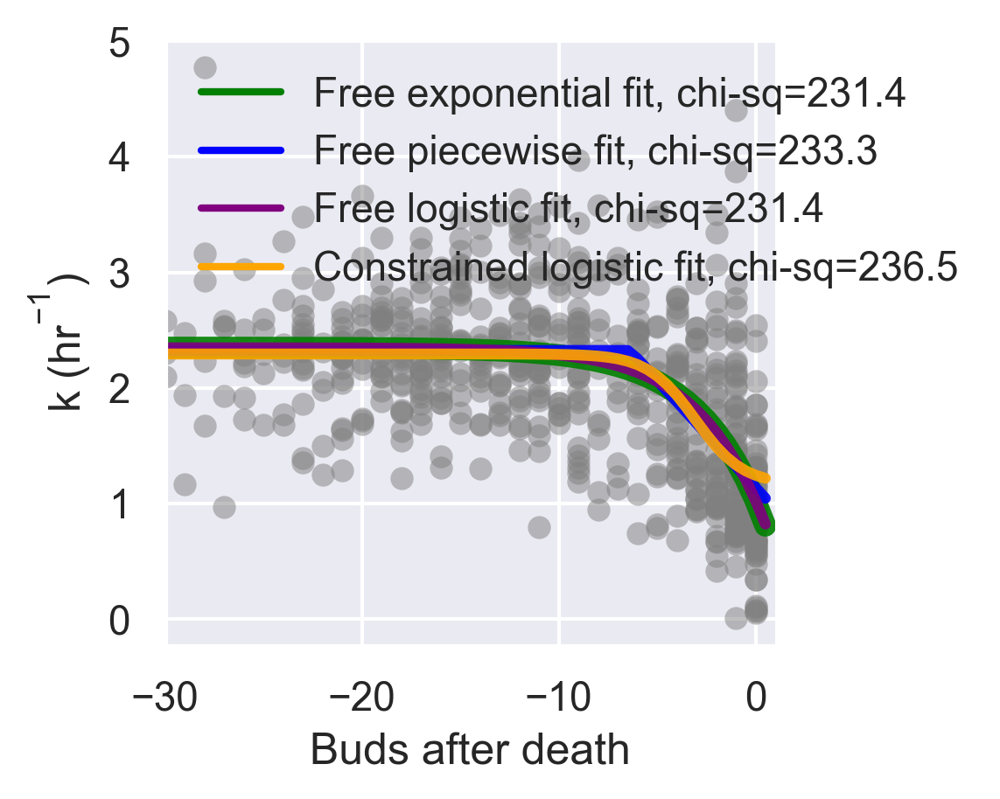

In [257]:
# Run the fits
model_guesses_list = [
    fitting_tools.model_guesses.exponential_turn_down,
    fitting_tools.model_guesses.piecewise_linear, 
    fitting_tools.model_guesses.logistic,
]
resultdfs = []
results = []
# Unconstrained fits
for model_guess in model_guesses_list:

    result, resultsdf = fitting_tools.fit_model_to_df(
        fits_df,
        wtbool,
        model_guess[0],
        model_guess[1]
    )
    resultdfs.append(resultsdf)
    results.append(result)
# Constrained logistic fit
constrained_logistic_df, smoothdf, constrained_logistic_result = fitting_tools.fit_logistic_to_fits_df(fits_df[wtbool], return_result=True)
results.append(constrained_logistic_result)

keys = [
    'Free exponential',
    'Free piecewise',
    'Free logistic',
    'Constrained logistic',
]

results_dict = dict(zip(keys, results))
# Plotting
fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)
fig.set_dpi(300)
sns.set()
yvar='b'
xvar='buds_after_death'
x = np.arange(-50, 1, 0.5)
alpha=0.9
ax.scatter(subdf[xvar], subdf[yvar], alpha=0.5, color='gray', linewidth=0, s=40)
colors = [
    'green',
    'blue',
    'purple',
    'orange'
]
i=0
for key, result in results_dict.items():
    lw = 3
    # Free logistic perfectly overlays exponential
    # so make it wider to see both
    if key == 'Free exponential':
        lw = 6
    y_pred = result.model.eval(params=result.params, x=x)
    ax.plot(x, y_pred, color=colors[i], lw=lw, alpha=alpha)
    i+=1

custom_lines = [Line2D([0], [0], color=color, lw=2) for color in colors]
labels = []
for key in results_dict.keys():
    label = f'{key} fit, chi-sq={np.round(results_dict[key].chisqr, 1)}'
    labels.append(label)
ax.legend(custom_lines, labels, frameon=False)
ax.set_xlabel('Buds after death')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlim(-30, 1)

plotting.save_figure(fig, {'x': 'buds_after_death', 'y': 'k', 'desc': 'fit_comparisons'}, ext='.svg')

## Figure 2: Shuttle receptor-mediated and ubiquitin-independent proteasome substrate degradation remain fast through the SEP

### Survival distributions Kaplan Meier Curves among substrates

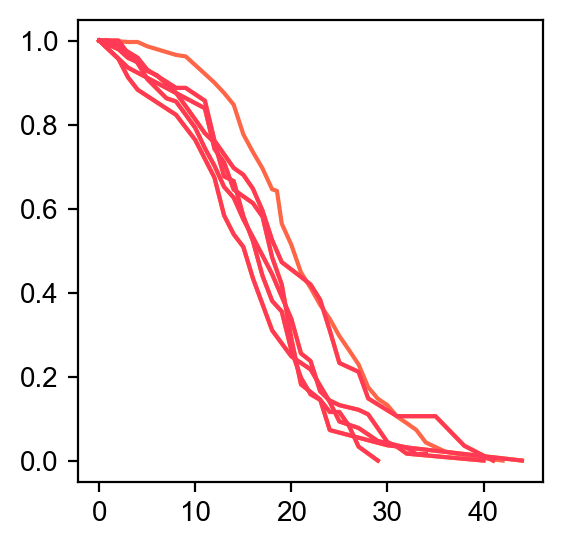

In [254]:
xvar = 'x_kmf'
yvar = 'y_kmf'
x_order = [
    'wt_rkk',
    'wt_ubl',
    'wt_rkk',
]
fig = plt.figure(figsize=(3, 3))
fig.set_dpi(200)
ax = fig.add_subplot(111)

for i, key in enumerate(x_order):
    compnames = constants.compartments_dict[key]
    color = colors[i]
    for compname in compnames:
        if survivaldf[survivaldf.compartment_name==compname]['rls_suitable'].iloc[0] == True:
            x = survivaldf[survivaldf.compartment_name==compname][xvar]
            y = survivaldf[survivaldf.compartment_name==compname][yvar]
            ax.plot(x, y, color=color)

C:\Users\johnp\AppData\Local\Temp\ipykernel_19668\1459826490.py:60: UserWarning: The palette list has more values (5) than needed (4), which may not be intended.
  sns.lineplot(**kwargs)


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_kmf_y=y_kmf_hue=samplename.svg


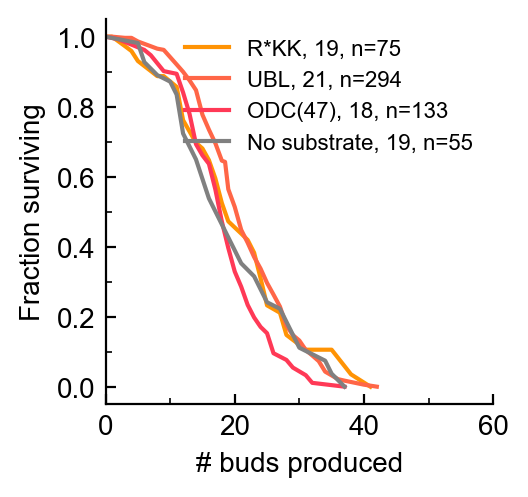

In [286]:
plotting.set_styles(matplotlib, plt)
palette = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC258'],
    plotting.strains_color_dict['JPC122'],
    'gray'
]


labels = [
    'R*KK',
    'UBL',
    'ODC(47)',
    'No substrate'
]

order = [
    'wt_rkk',
    'wt_ubl',
    'wt_odc',
    'wt'
]

xvar = 'x_kmf'
yvar = 'y_kmf'
wtnosub_survival_df = pd.read_csv(r"C:\Users\johnp\Dropbox\Projects\byc\data\20211105_byc\20211105_BY4741_no_fluor\No_construct_no_fluor_imaging_survivaldf.csv")
wtnosub_survival_df.loc[:, 'samplename'] = 'wt'
wtnosub_survival_df.loc[:, 'rls_suitable'] = True
wtnosub_survival_df.loc[:, 'compartment_name'] = '20211105_BY4741_no_fluor'

rep_comps = [
    '20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry',
    '20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741',
    '20221028_byc_JPC122_YFP-ODC_x3-int',
    '20211105_BY4741_no_fluor',
]
fig = plt.figure(figsize=(2.5, 2.5))
fig.set_dpi(200)
ax = fig.add_subplot(111)

# Survival across all experiments
# for i, key in enumerate(x_order):
#     compnames = constants.compartments_dict[key]
#     color = colors[i]
#     survivaldf.loc[survivaldf.compartment_name.isin(compnames), 'samplename'] = key
concatdf = pd.concat([survivaldf, wtnosub_survival_df])
# Survival in just representative compartments
concatdf = pd.concat([survivaldf[survivaldf.compartment_name.isin(rep_comps)], wtnosub_survival_df])

kwargs = {
    'x': 'x_kmf',
    'y': 'y_kmf',
    'hue': 'samplename',
    'hue_order': order,
    'data': concatdf[concatdf.compartment_name.isin(rep_comps)],
    'ax': ax,
    'palette': palette + ['gray']
}

sns.lineplot(**kwargs)

ax.set_xlim(0, 60)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plotting.format_ticks(ax)

for i, samplename in enumerate(order):
    rls = concatdf.loc[concatdf.samplename==samplename, 'kmf_halflife'].iloc[0]
    n_cells = concatdf.loc[concatdf.samplename==samplename, 'n_cells'].iloc[0]
    labels[i] = labels[i] + f', {np.int16(rls)}, n={np.int16(n_cells)}'

handles = ax.get_legend_handles_labels()[0]
nvals = [kwargs['data'][kwargs['data'].samplename==sample].n_cells.iloc[0] for sample in order]
rlss = [kwargs['data'][kwargs['data'].samplename==sample].kmf_halflife.iloc[0] for sample in order]
leg_labels = []
for i, label in enumerate(labels):
    newlabel = f'{label}, {int(rlss[i])}, n={int(nvals[i])}'
    leg_labels.append(newlabel)
ax.legend(handles, labels, title='', frameon=False, fontsize=8)
ax.set_ylabel('Fraction surviving')
ax.set_xlabel('# buds produced')

plotting.save_figure(fig, kwargs, ext='.svg')

### Bar graph of RLS of individual replicates of individual substrate stains

C:\Users\johnp\AppData\Local\Temp\ipykernel_19668\3788671224.py:34: UserWarning: The palette list has more values (5) than needed (4), which may not be intended.
  sns.stripplot(**kwargs, dodge=False, alpha=0.8)


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\title=survival_across_substrates.svg


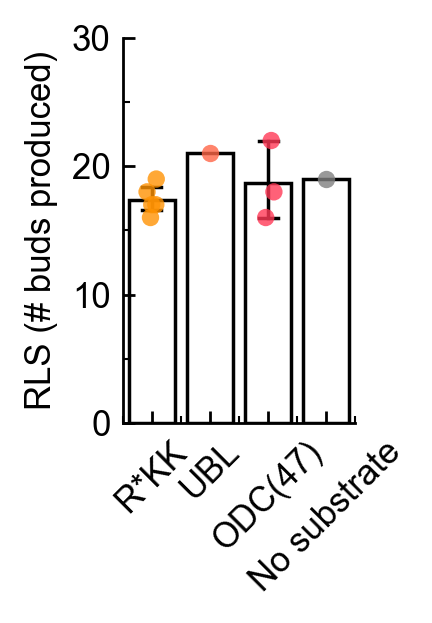

In [267]:
concatdf.loc[concatdf.compartment_name=='20220211_byc_JPC122_YFP-ODC(47)_BY4741', 'rls_suitable'] = True

aggdex = [
    'compartment_name',
    'rls_suitable',
    'samplename'
]

cols = [
    'kmf_halflife',
    'n_cells',
]

rlstable = concatdf[concatdf.samplename.isin(order)].groupby(aggdex, dropna=False, as_index=False)[cols].median()

fig, ax = plotting.figure_ax(width_scale=0.6)

kwargs = {
    'x': 'samplename',
    'y': 'kmf_halflife',
    'data': rlstable[rlstable.rls_suitable==True],
    'order': order,
    'hue': 'samplename',
    'hue_order': order,
    'palette': palette + ['gray'],
    'ax': ax
}

sns.barplot(**kwargs, dodge=False, errcolor='black', errwidth=1, capsize=0.33)
for patch in ax.patches:
    r, g, b, a = patch.get_facecolor()
    patch.set_facecolor((r, g, b, 0))
    patch.set_edgecolor('black')
sns.stripplot(**kwargs, dodge=False, alpha=0.8)
ax.set_ylabel('RLS (# buds produced)')

ax.set_xticklabels(labels)
ax.legend_.remove()
ax.set_xlabel('')
plt.xticks(rotation=45)
ax.set_ylim(0, 30)
plotting.format_ticks(ax)

plotting.save_figure(fig, {'title': 'survival_across_substrates'}, ext='.svg')

### Raw k before and after 5 buds from senescence

C:\Users\johnp\AppData\Local\Temp\ipykernel_19668\3623763036.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median


UBL_False vs. UBL_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.165e-02 U_stat=3.351e+04
R*KK_False vs. R*KK_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:6.541e-52 U_stat=1.817e+05
ODC(47)_False vs. ODC(47)_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:4.174e-02 U_stat=3.986e+04
R*KK fold change young over old=1.456621088208598 +/- 0.03184814169716017
R*KK fold change old over young=0.686520336754038
UBL fold change young over old=1.061766558698046 +/- 0.03650875566172263
UBL fold change old over young=0.9418266113280257
ODC(47) fold change young over old=0.9376688730622706 +/- 0.041205516183429276
ODC(47) fold change old over young=1.0664745612533413
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=substrate_y=b_hue=post_sep_dodge=True.svg


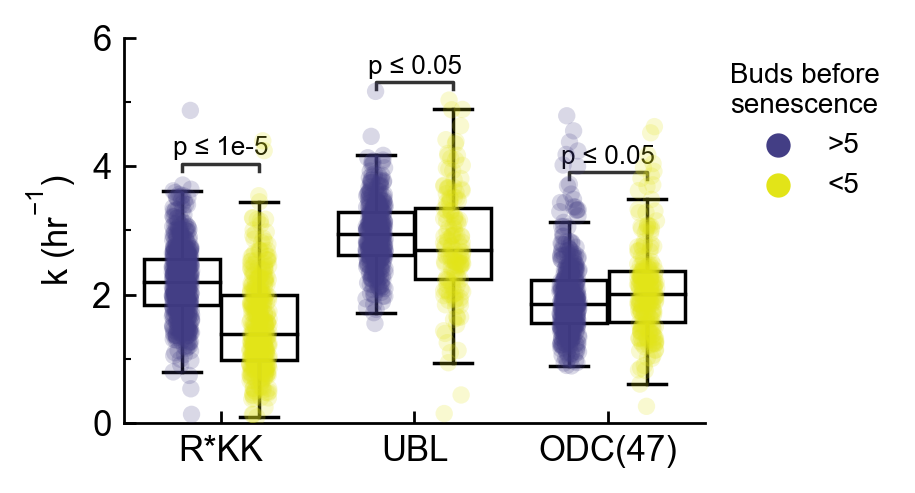

In [20]:
strain_groups = [
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC228', 'JPC258'],
    ['JPC122']
]

substrates = [
    'R*KK',
    'UBL',
    'ODC(47)'
]
colors = [plotting.strains_color_dict[strain] for strain in ['JPC121', 'JPC228', 'JPC122']]
all_strains = strain_groups[0] + strain_groups[1] + strain_groups[2]
sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
for i, group in enumerate(strain_groups):
    sub_fits_df.loc[sub_fits_df.strain_name.isin(group), 'substrate'] = substrates[i]

fig, ax = plotting.figure_ax(width_scale=1.5)
sub_fits_df.loc[:, 'post_sep'] = np.nan
sub_fits_df.loc[sub_fits_df.dist_from_sen>5, 'post_sep'] = False
sub_fits_df.loc[sub_fits_df.dist_from_sen<5, 'post_sep'] = True

# Normalize to pre/post SEP median
for substrate in sub_fits_df.substrate.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.post_sep==False)&(sub_fits_df.substrate==substrate), 'b'].median()
    sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median

kwargs = {
    'x': 'substrate',
    'y': 'b',
    'hue': 'post_sep',
    'data': sub_fits_df[~sub_fits_df.post_sep.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': substrates,
    'hue_order': [False, True]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('UBL', True), ("UBL", False)),
    (("ODC(47)", True), ("ODC(47)", False)),
    (("R*KK", True), ("R*KK", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 6)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 2))
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlabel('')
for substrate in substrates:
    subdf = sub_fits_df[sub_fits_df.substrate==substrate]
    data1 = subdf.loc[subdf.post_sep==False, 'b']
    data2 = subdf.loc[subdf.post_sep==True, 'b']
    fold_change = data1.mean()/data2.mean()
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM1, 2)]))
    fold_change_old_over_young = 1/fold_change
    print(f'{substrate} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{substrate} fold change old over young={fold_change_old_over_young}')
# ax.legend_.set_visible(False)
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['>5', '<5'],
                   title='Buds before\nsenescence',
                   frameon=False,
                   fontsize=legfontsize,
                   bbox_to_anchor=(1, 1))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### k normalized to pre-SEP mean before and after SEP where SEP is assumed to be 5 for all cells

C:\Users\johnp\AppData\Local\Temp\ipykernel_10136\954927709.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median


UBL_False vs. UBL_True: Mann-Whitney-Wilcoxon test two-sided, P_val:3.882e-03 U_stat=3.351e+04
R*KK_False vs. R*KK_True: Mann-Whitney-Wilcoxon test two-sided, P_val:2.437e-38 U_stat=7.616e+04
ODC(47)_False vs. ODC(47)_True: Mann-Whitney-Wilcoxon test two-sided, P_val:1.391e-02 U_stat=3.986e+04
R*KK fold change young over old=1.4737536356756198 +/- 0.03889431497660139
R*KK fold change old over young=0.6785394626297667
UBL fold change young over old=1.061766558698046 +/- 0.03650875566172263
UBL fold change old over young=0.9418266113280257
ODC(47) fold change young over old=0.9376688730622706 +/- 0.041205516183429276
ODC(47) fold change old over young=1.0664745612533413
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=substrate_y=b_over_pre_sep_median_hue=post_sep_dodge=True.svg


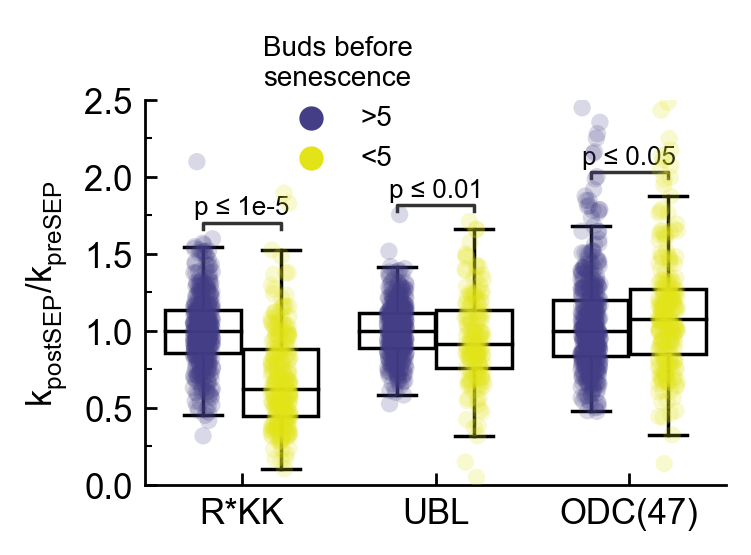

In [32]:
strain_groups = [
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC228', 'JPC258'],
    ['JPC122']
]

substrates = [
    'R*KK',
    'UBL',
    'ODC(47)'
]
colors = [plotting.strains_color_dict[strain] for strain in ['JPC121', 'JPC228', 'JPC122']]
all_strains = strain_groups[0] + strain_groups[1] + strain_groups[2]
# sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
comps = constants.compartments_dict['wt_odc'] + constants.compartments_dict['wt_rkk'] + constants.compartments_dict['wt_ubl']
sub_fits_df = fits_df[fits_df.compartment_name.isin(comps)]
for i, group in enumerate(strain_groups):
    sub_fits_df.loc[sub_fits_df.strain_name.isin(group), 'substrate'] = substrates[i]

fig, ax = plotting.figure_ax(width_scale=1.5)
sub_fits_df.loc[:, 'post_sep'] = np.nan
sub_fits_df.loc[sub_fits_df.dist_from_sen>5, 'post_sep'] = False
sub_fits_df.loc[sub_fits_df.dist_from_sen<5, 'post_sep'] = True

# Normalize to pre/post SEP median
for substrate in sub_fits_df.substrate.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.post_sep==False)&(sub_fits_df.substrate==substrate), 'b'].median()
    sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median

kwargs = {
    'x': 'substrate',
    'y': 'b_over_pre_sep_median',
    'hue': 'post_sep',
    'data': sub_fits_df[~sub_fits_df.post_sep.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': substrates,
    'hue_order': [False, True]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('UBL', True), ("UBL", False)),
    (("ODC(47)", True), ("ODC(47)", False)),
    (("R*KK", True), ("R*KK", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 2.5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.5))
ax.set_ylabel(plotting.annoying_strings().k_old_over_young)
ax.set_xlabel('')
for substrate in substrates:
    subdf = sub_fits_df[sub_fits_df.substrate==substrate]
    data1 = subdf.loc[subdf.post_sep==False, 'b']
    data2 = subdf.loc[subdf.post_sep==True, 'b']
    fold_change = data1.mean()/data2.mean()
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM1, 2)]))
    fold_change_old_over_young = 1/fold_change
    print(f'{substrate} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{substrate} fold change old over young={fold_change_old_over_young}')
# ax.legend_.set_visible(False)
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['>5', '<5'],
                   title='Buds before\nsenescence',
                   frameon=False,
                   fontsize=legfontsize,
                   bbox_to_anchor=(0.16, 0.75))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### k normalized to pre-SEP mean before and after SEP where SEP is fit for all individual cells

C:\Users\johnp\AppData\Local\Temp\ipykernel_8996\3914120697.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median


UBL_False vs. UBL_True: Mann-Whitney-Wilcoxon test two-sided, P_val:3.201e-05 U_stat=2.112e+04
R*KK_False vs. R*KK_True: Mann-Whitney-Wilcoxon test two-sided, P_val:2.264e-40 U_stat=1.307e+04
ODC(47)_False vs. ODC(47)_True: Mann-Whitney-Wilcoxon test two-sided, P_val:8.291e-02 U_stat=3.972e+04
R*KK fold change young over old=1.539 +/- 0.052
R*KK fold change old over young=0.65 +/- 0.052
UBL fold change young over old=1.09 +/- 0.072
UBL fold change old over young=0.917 +/- 0.072
ODC(47) fold change young over old=0.955 +/- 0.061
ODC(47) fold change old over young=1.047 +/- 0.061
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=substrate_y=b_over_real_pre_sep_median_hue=pre_SEP_dodge=True.svg


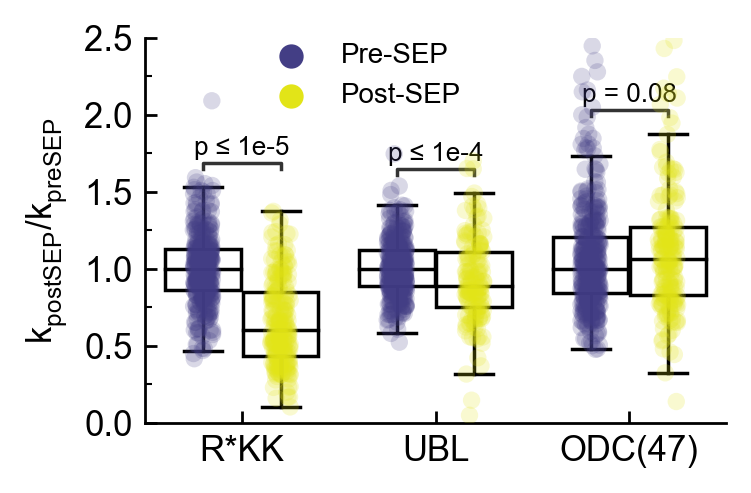

In [204]:
strain_groups = [
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC228', 'JPC258'],
    ['JPC122']
]

substrates = [
    'R*KK',
    'UBL',
    'ODC(47)'
]

samples = [
    'wt_rkk',
    'wt_ubl',
    'wt_odc'
]

colors = [plotting.strains_color_dict[strain] for strain in ['JPC121', 'JPC228', 'JPC122']]
all_strains = strain_groups[0] + strain_groups[1] + strain_groups[2]
# sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
comps = constants.compartments_dict['wt_odc'] + constants.compartments_dict['wt_rkk'] + constants.compartments_dict['wt_ubl']
sub_fits_df = fits_df[fits_df.compartment_name.isin(comps)]
for i, sample in enumerate(samples):
    sub_fits_df.loc[sub_fits_df.samplename==sample, 'substrate'] = substrates[i]

fig, ax = plotting.figure_ax(width_scale=1.5)

# Normalize to pre/post SEP median
for substrate in sub_fits_df.substrate.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.pre_SEP==True)&(sub_fits_df.substrate==substrate), 'b'].median()
    sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median

kwargs = {
    'x': 'substrate',
    'y': 'b_over_real_pre_sep_median',
    'hue': 'pre_SEP',
    'data': sub_fits_df[~sub_fits_df.pre_SEP.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': substrates,
    'hue_order': [True, False]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('UBL', True), ("UBL", False)),
    (("ODC(47)", True), ("ODC(47)", False)),
    (("R*KK", True), ("R*KK", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 2.5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.5))
ax.set_ylabel(plotting.annoying_strings().k_old_over_young)
ax.set_xlabel('')
for substrate in substrates:
    subdf = sub_fits_df[sub_fits_df.substrate==substrate]
    data1 = subdf.loc[subdf.pre_SEP==True, 'b']
    data2 = subdf.loc[subdf.pre_SEP==False, 'b']
    fold_change = np.round(data1.mean()/data2.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    fold_change_old_over_young = np.round(1/fold_change, 3)
    print(f'{substrate} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{substrate} fold change old over young={fold_change_old_over_young} +/- {SEM_of_fold_change}')
# ax.legend_.set_visible(False)
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['Pre-SEP', 'Post-SEP'],
                   title='',
                   frameon=False,
                   fontsize=legfontsize,
                   bbox_to_anchor=(0.16, 0.75))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Report rate constants for individual substrates in individual strains

In [43]:
for substrate in sub_fits_df.substrate.unique():
    booldex = (sub_fits_df.substrate==substrate)
    booldex = booldex & (sub_fits_df.pre_SEP==True)
    pre_SEP_k_mean = sub_fits_df.loc[booldex, 'b'].mean()
    pre_SEP_k_sem = sub_fits_df.loc[booldex, 'b'].sem()
    print(f'{substrate} pre-SEP rate = {np.round(pre_SEP_k_mean, 3)} +/- {np.round(pre_SEP_k_sem, 3)}')

ODC(47) pre-SEP rate = 1.965 +/- 0.03
R*KK pre-SEP rate = 2.337 +/- 0.028
UBL pre-SEP rate = 2.983 +/- 0.027


In [182]:
for substrate in sub_fits_df.substrate.unique():
    booldex = (sub_fits_df.substrate==substrate)
    booldex = booldex & (sub_fits_df.pre_SEP==False)
    pre_SEP_k_mean = sub_fits_df.loc[booldex, 'b'].mean()
    pre_SEP_k_sem = sub_fits_df.loc[booldex, 'b'].sem()
    print(f'{substrate} post-SEP rate = {np.round(pre_SEP_k_mean, 3)} +/- {np.round(pre_SEP_k_sem, 3)}')

ODC(47) post-SEP rate = 2.06 +/- 0.052
R*KK post-SEP rate = 1.526 +/- 0.042
UBL post-SEP rate = 2.746 +/- 0.067


In [203]:
for samplename in fits_df.samplename.unique():

    mean = fits_df.loc[(fits_df.samplename==samplename)&(fits_df.pre_SEP==True), 'b'].mean()
    sem = fits_df.loc[(fits_df.samplename==samplename)&(fits_df.pre_SEP==True), 'b'].sem()    
    print(f'Pre-SEP {samplename} rate constant: {np.round(mean, 3)} +\- {np.round(sem, 3)}')

Pre-SEP nan rate constant: nan +\- nan
Pre-SEP ubr1OE_rkk rate constant: 2.097 +\- 0.094
Pre-SEP wt_odc rate constant: 1.967 +\- 0.031
Pre-SEP ssa2OE_rkk rate constant: 2.115 +\- 0.048
Pre-SEP hsp104OE_rkk rate constant: 1.898 +\- 0.041
Pre-SEP wt_rkk rate constant: 2.336 +\- 0.029
Pre-SEP ssa1OE_rkk rate constant: 2.074 +\- 0.039
Pre-SEP wt_ubl rate constant: 2.985 +\- 0.027
Pre-SEP rpn4_ubl rate constant: 1.412 +\- 0.021
Pre-SEP wt_dsred rate constant: 0.366 +\- 0.007
Pre-SEP rpn4_odc rate constant: 0.92 +\- 0.021
Pre-SEP rpn4_rkk rate constant: 0.6 +\- 0.015
Pre-SEP ubr2_ubl rate constant: 2.928 +\- 0.114
Pre-SEP mub1_rkk rate constant: 2.038 +\- 0.027
Pre-SEP ubr2_rkk rate constant: 1.793 +\- 0.022
Pre-SEP ubr2_xform_to_rkk rate constant: 2.154 +\- 0.043


In [181]:
for samplename in sepdf.samplename.unique():

    mean = sepdf.loc[(sepdf.samplename==samplename), 'x0'].mean()
    sem = sepdf.loc[(sepdf.samplename==samplename), 'x0'].sem()    
    print(f'Pre-SEP {samplename} SEP: {np.round(mean, 3)} +\- {np.round(sem, 3)}')

Pre-SEP ubr1OE_rkk SEP: -4.759 +\- 0.282
Pre-SEP wt_odc SEP: -5.321 +\- 0.162
Pre-SEP ssa2OE_rkk SEP: -4.909 +\- 0.505
Pre-SEP hsp104OE_rkk SEP: -4.791 +\- 0.315
Pre-SEP wt_rkk SEP: -5.303 +\- 0.145
Pre-SEP ssa1OE_rkk SEP: -5.204 +\- 0.23
Pre-SEP wt_ubl SEP: -5.672 +\- 0.156
Pre-SEP rpn4_ubl SEP: -4.612 +\- 0.242
Pre-SEP wt_dsred SEP: -6.164 +\- 0.265
Pre-SEP rpn4_odc SEP: -4.811 +\- 0.323
Pre-SEP rpn4_rkk SEP: -4.419 +\- 0.241
Pre-SEP ubr2_ubl SEP: -6.909 +\- 0.621
Pre-SEP mub1_rkk SEP: -7.441 +\- 0.207
Pre-SEP ubr2_rkk SEP: -6.916 +\- 0.261
Pre-SEP ubr2_xform_to_rkk SEP: -5.647 +\- 0.176


In [187]:
for samplename in buds_df.samplename.unique():

    mean = buds_df.loc[(buds_df.samplename==samplename)&(buds_df.buds_before_SEP<0), 'cycle_duration_hrs'].mean()
    sem = buds_df.loc[(buds_df.samplename==samplename)&(buds_df.buds_before_SEP<0), 'cycle_duration_hrs'].sem()
    print(f'Pre-SEP {samplename} pre-SEP cycle duration: {np.round(mean, 3)} +\- {np.round(sem, 3)}')

Pre-SEP nan pre-SEP cycle duration: nan +\- nan
Pre-SEP ubr1OE_rkk pre-SEP cycle duration: 1.641 +\- 0.022
Pre-SEP wt_odc pre-SEP cycle duration: 1.351 +\- 0.006
Pre-SEP ssa2OE_rkk pre-SEP cycle duration: 1.65 +\- 0.019
Pre-SEP hsp104OE_rkk pre-SEP cycle duration: 1.48 +\- 0.018
Pre-SEP wt_rkk pre-SEP cycle duration: 1.292 +\- 0.006
Pre-SEP ssa1OE_rkk pre-SEP cycle duration: 1.348 +\- 0.012
Pre-SEP wt_ubl pre-SEP cycle duration: 1.252 +\- 0.004
Pre-SEP rpn4_ubl pre-SEP cycle duration: 2.103 +\- 0.014
Pre-SEP wt_dsred pre-SEP cycle duration: 1.217 +\- 0.005
Pre-SEP rpn4_odc pre-SEP cycle duration: 1.666 +\- 0.013
Pre-SEP rpn4_rkk pre-SEP cycle duration: 1.838 +\- 0.014
Pre-SEP ubr2_ubl pre-SEP cycle duration: 1.202 +\- 0.009
Pre-SEP mub1_rkk pre-SEP cycle duration: 1.311 +\- 0.007
Pre-SEP ubr2_rkk pre-SEP cycle duration: 1.224 +\- 0.007
Pre-SEP ubr2_xform_to_rkk pre-SEP cycle duration: 1.316 +\- 0.007


### Comparing fits to k vs. distance from senescence and SEP in different conditions

#### k vs. distance from senescence fitting

Saved logistic fit results at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\JPC121_linear-fit_b-vs-dist-from-sen.csv
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.png
Buds before SEP max of 22.0 and min of -35.0
Saved logistic fit results at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\JPC122_linear-fit_b-vs-dist-from-sen.csv
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.png
Buds before SEP max of 22.0 and min of -35.0
Saved logistic fit results at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\JPC228_linear-fit_b-vs-dist-from-sen.csv
Saved figure at
C:\Users\johnp\Dropbox\Pr

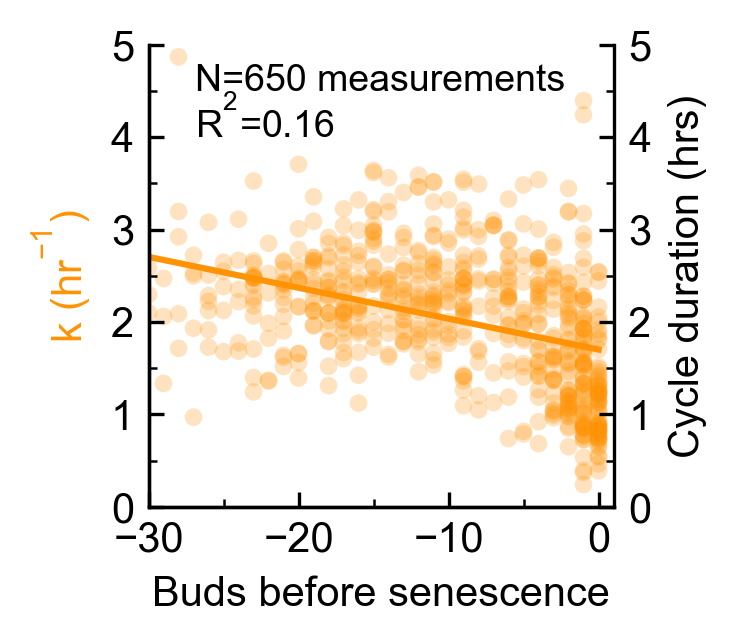

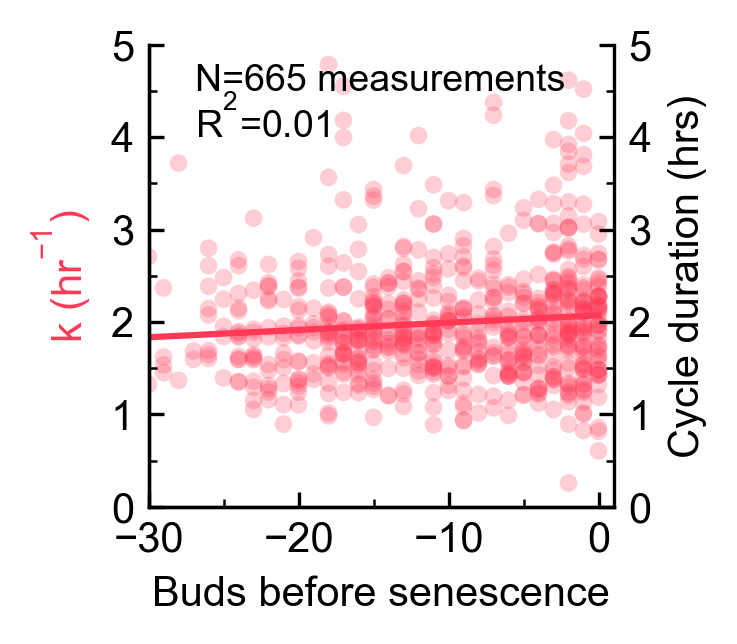

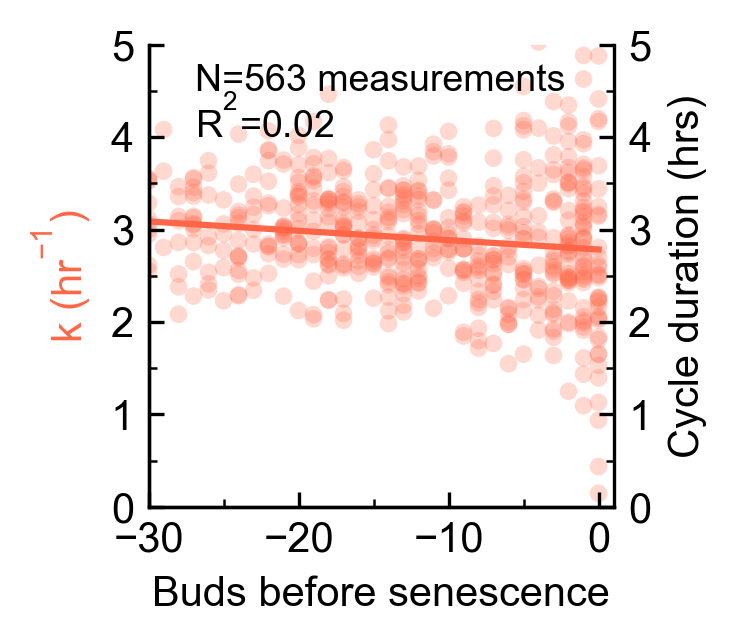

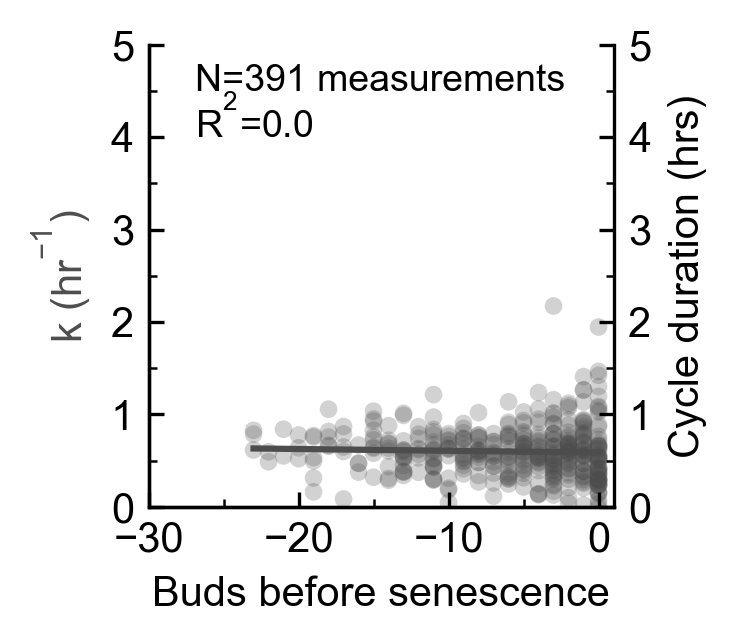

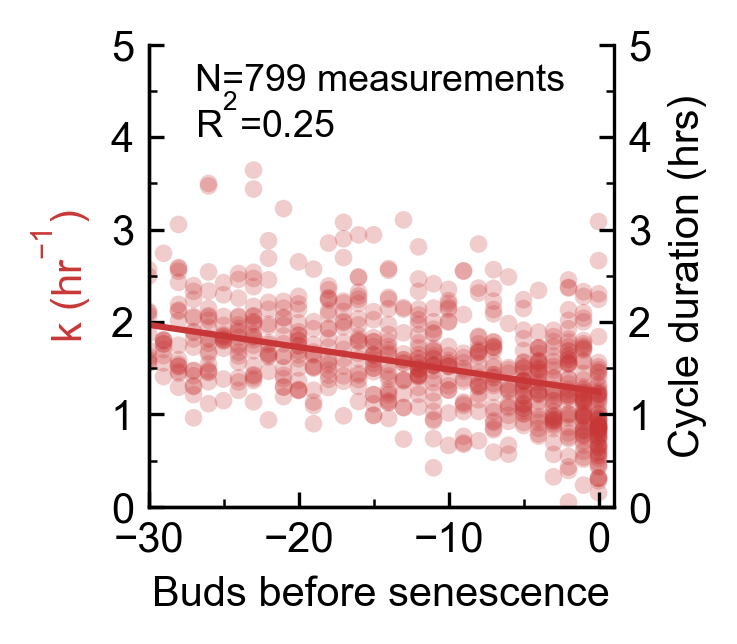

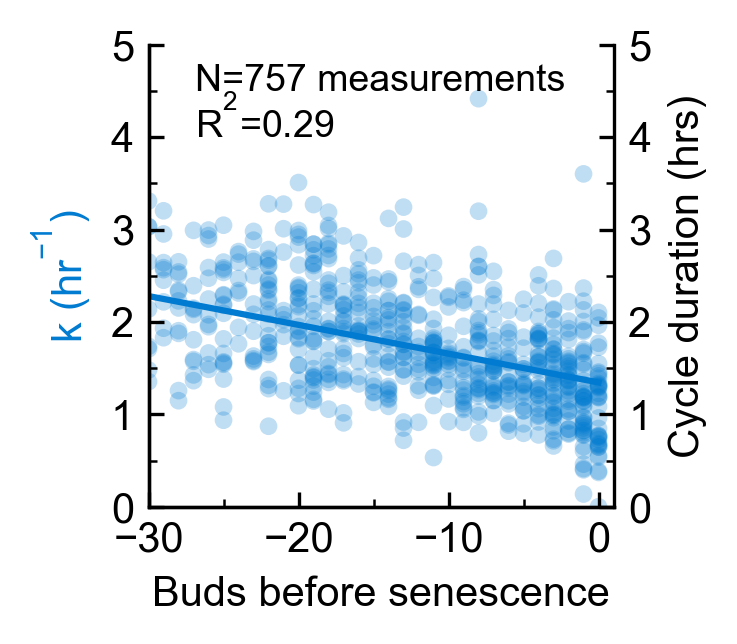

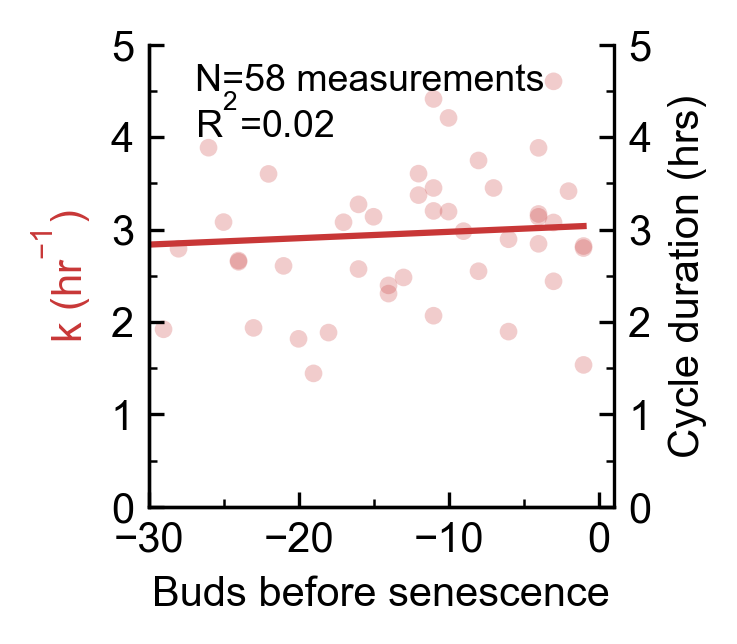

In [134]:
strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
xvar = 'buds_after_death'
yvar1 = 'b'
for strain in strains[:]:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.b.isna()) &
        (~fits_df.buds_after_death.isna())
    ]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_fits_df,
        sub_buds_df,
        yvar1=yvar1,
        yvar2=None,
        xvar=xvar,
        fit_type='line',
        xlabel='Buds before senescence',
        xlim=(-30, 1),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        fillsep=False,
        width_scale=1,
    )
    # Adjust length of x and y median to be as long as 
    # x and y_pred. This is needed as in the case of piecewise
    # fitting where x is super sampled to smooth out y_pred
    x_median = np.append(x_median, np.full(len(x) - len(x_median), np.nan))
    y_median = np.append(y_median, np.full(len(y_pred) - len(y_median), np.nan))
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    results_dfs.append(results_df)
    
    for col in results_df.columns:
        if col != 'x':
            strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
    
all_strains_fit_df = pd.concat(dfs)
all_strains_fit_table = pd.concat(results_dfs)

In [138]:
all_strains_fit_table.loc[:, ['strain_name', 'rsquared']]

,strain_name,rsquared
0,JPC121,0.163494
0,JPC122,0.009561
0,JPC228,0.022228
0,JPC263,0.001554
0,JPC262,0.252951
0,JPC274,0.294958
0,JPC259,0.015810


#### k vs. distance from SEP fitting

In [131]:
result.residual

array([ 0.80756592,  0.87518303,  0.04175542, -1.39303309, -0.94514992,
        0.33461477,  1.12626887, -0.42811537, -0.17970186,  1.24926811,
        0.0856365 , -0.58034674,  0.02814955, -0.09967043,  0.12067182,
       -0.00849849,  0.50630858,  0.36225822, -0.09433006, -0.1958561 ,
        0.51521324,  0.0421463 , -0.12901512,  0.95429925,  0.71484215,
        0.75674773,  0.77199244,  0.12686703, -0.05487437, -0.42811297,
       -0.57982757, -0.39386744,  1.48674044, -0.11589552,  0.20027324,
        0.22204311, -0.72575147, -0.11657681,  0.58181392, -0.14678979,
        0.62605351,  0.03930641, -1.39148566,  0.44890104, -0.38822284,
       -1.08403502,  0.1761515 , -0.86247252, -0.35086711, -1.19341598,
       -1.18641533, -0.17219587, -0.5832155 ,  0.54023164, -0.38643559,
        0.47287037])

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.png
Buds before SEP max of 9.0 and min of -35.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.png
Buds before SEP max of 12.0 and min of -30.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.png
Buds before SEP max of 10.0 and min of -36.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_se

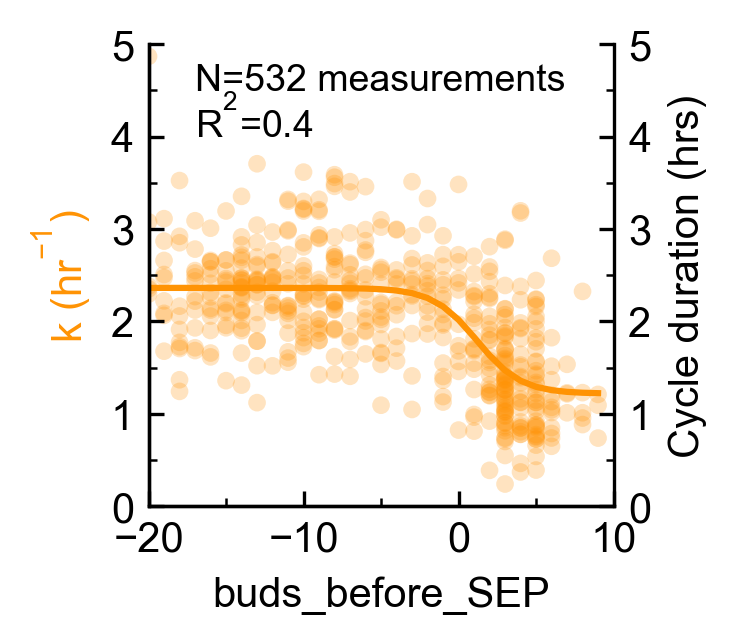

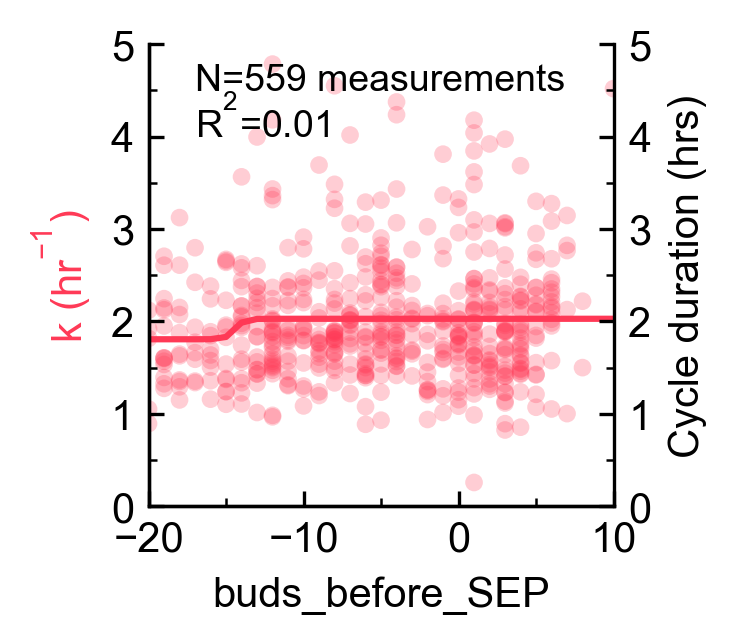

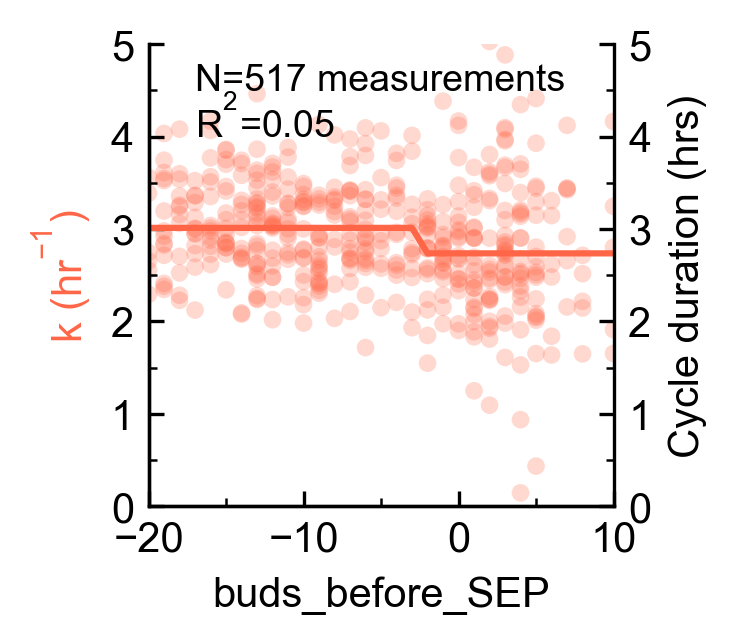

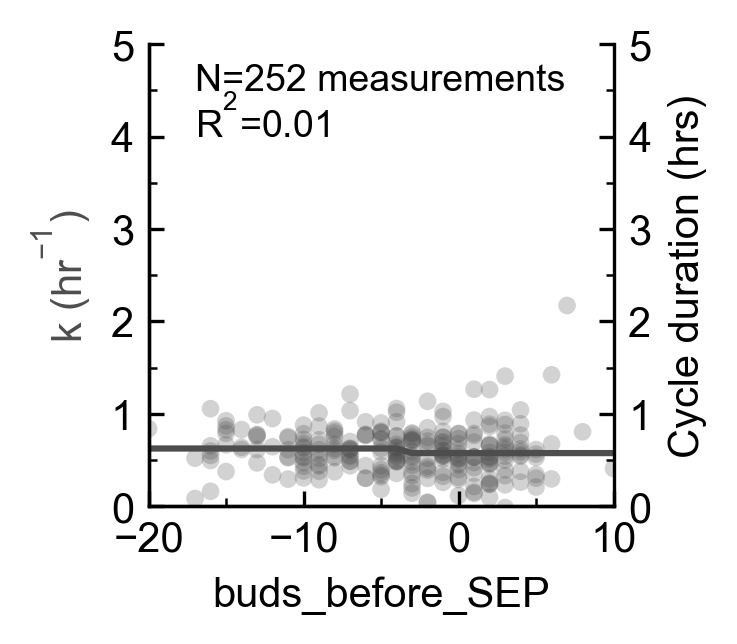

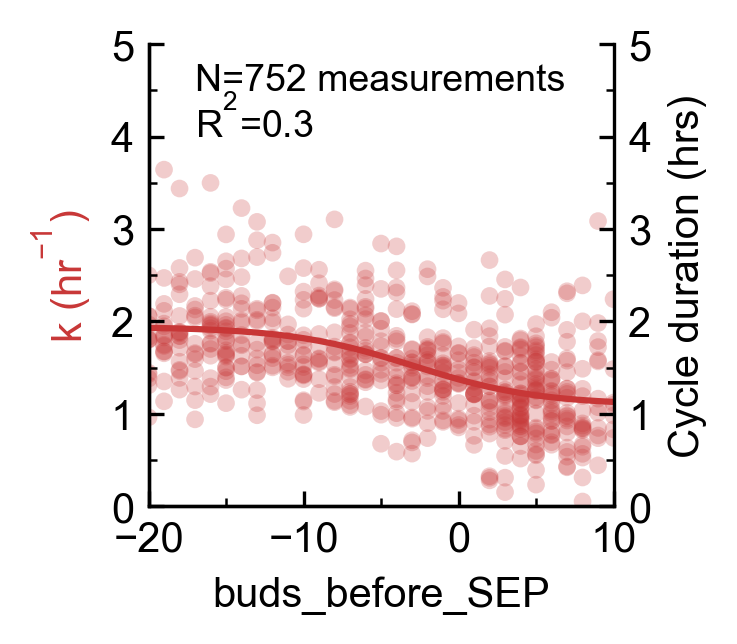

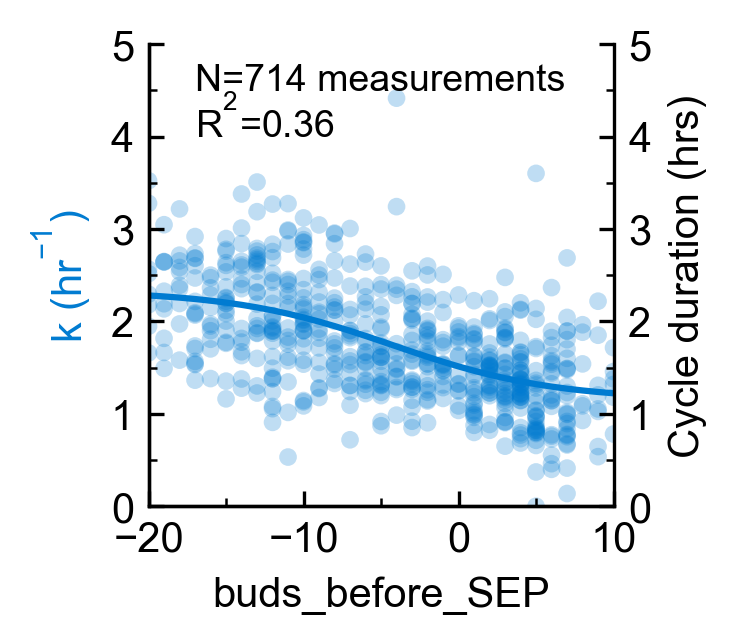

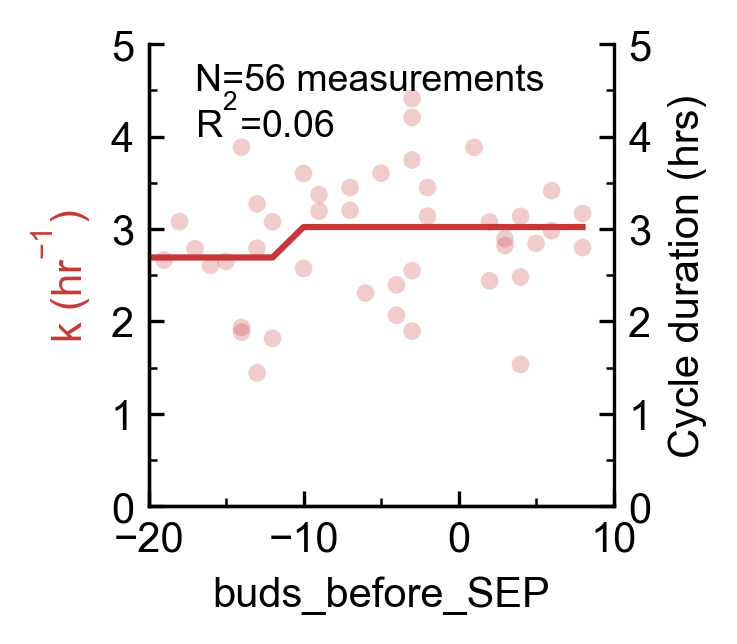

In [205]:
strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
for strain in strains[:]:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.buds_before_SEP.isna()) &
        (fits_df.x0_stderr_fraction.abs()<1)]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_fits_df,
        sub_buds_df,
        yvar1='b',
        yvar2=None,
        xvar='buds_before_SEP',
        fit_type='logistic',
        xlabel='buds_before_SEP',
        xlim=(-20, 10),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        fillsep=False,
        width_scale=1,
    )
    # Adjust length of x and y median to be as long as 
    # x and y_pred. This is needed as in the case of piecewise
    # fitting where x is super sampled to smooth out y_pred
    x_median = np.append(x_median, np.full(len(x) - len(x_median), np.nan))
    y_median = np.append(y_median, np.full(len(y_pred) - len(y_median), np.nan))
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    results_dfs.append(results_df)
    
    for col in results_df.columns:
        if col != 'x':
            strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
    
all_strains_fit_df = pd.concat(dfs)
all_strains_fit_table = pd.concat(results_dfs)

In [146]:
all_strains_fit_table.loc[:, 
                          ['samplename',
                           'rsquared',
                           'chisqr']]

,samplename,rsquared,chisqr
0,wt_rkk,0.388784,167.012869
0,wt_odc,0.008724,238.862289
0,wt_ubl,0.046597,185.154036
0,rpn4_rkk,0.008840,17.402779
0,ubr2_rkk,0.303275,166.091431
0,mub1_rkk,0.357809,187.017605
0,ubr2_ubl,0.060116,23.617723


In [212]:
all_strains_fit_table.loc[
    :,
    ['samplename',
     'x_center',
     'x_center_stderr',
     'x_center_stderr_fraction',
     'rsquared']
]

,samplename,x_center,x_center_stderr,x_center_stderr_fraction,rsquared
0,wt_rkk,1.194687,0.456043,0.381726,0.401780
0,wt_odc,-14.418960,1.306075,-0.090580,0.012587
0,wt_ubl,-2.486639,42.481381,-17.083857,0.047968
0,rpn4_rkk,-3.519570,103.614821,-29.439627,0.008840
0,ubr2_rkk,-2.904906,1.175020,-0.404495,0.304184
0,mub1_rkk,-4.243835,1.309536,-0.308574,0.361826
0,ubr2_ubl,-10.926541,3178.844094,-290.928669,0.060116


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_y=y_pred_hue=samplename.svg


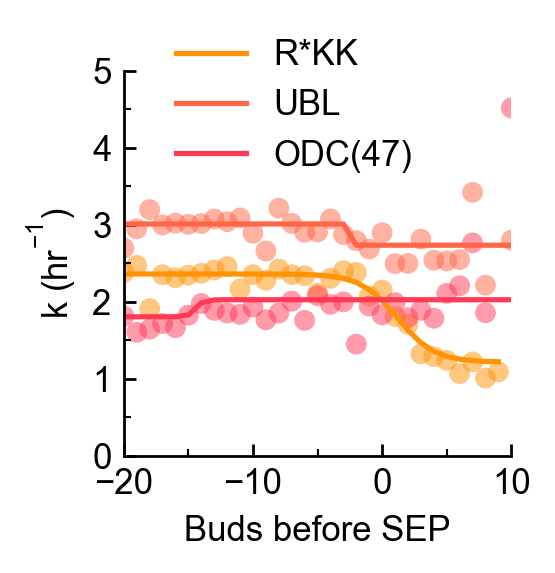

In [213]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'wt_ubl',
    'wt_odc'
]

substrates = [
    'R*KK',
    'UBL',
    'ODC(47)'
]

keys = list(all_strains_fit_df.samplename.unique())
hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC228'],
    plotting.strains_color_dict['JPC122'],
]

kwargs = {
    'x': 'x',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': all_strains_fit_df[all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': all_strains_fit_df[all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:3],
          substrates,
          frameon=False,
          loc=(0.1, 0.7),
         )

ax.set_xlabel('Buds before SEP')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlim(-20, 10)
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

In [163]:
all_strains_fit_table.loc[
    :,
    ['samplename', 'k', 'k_stderr', 'c', 'a']
]

,samplename,k,k_stderr,c,a
0,wt_rkk,0.236671,0.037347,2.387251,1.239250
0,wt_odc,0.100462,0.136847,1.893215,-0.237219
0,wt_ubl,1.608861,0.890973,2.947968,0.576350
0,rpn4_rkk,0.461380,0.621727,0.649315,0.104288
0,ubr2_rkk,0.075574,0.014328,2.046211,0.981123
0,mub1_rkk,0.052809,0.011147,2.545730,1.396637
0,ubr2_ubl,10.623511,54272.026951,2.896288,20986.203162


In [153]:
all_strains_fit_table.loc[
    all_strains_fit_table.samplename.isin(strains),
    ['samplename', 'x0', 'x0_stderr', 'x0_stderr_fraction',]
]

,samplename,x0,x0_stderr,x0_stderr_fraction
0,wt_rkk,-3.031516,0.652140,-0.215120
0,wt_odc,4.226856,1.134800,0.268474
0,wt_ubl,-9.878722,4.046801,-0.409648


In [154]:
all_strains_fit_table.loc[
    all_strains_fit_table.samplename.isin(strains),
    ['samplename', 'x_center', 'x_center_stderr_fraction',]
]

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_median_y=y_pred_hue=samplename.svg


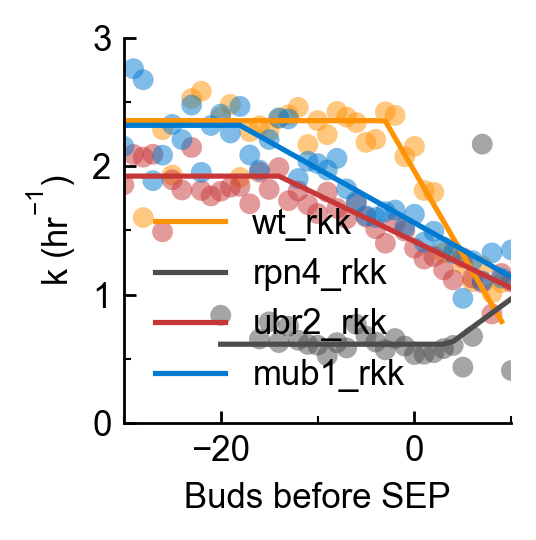

In [81]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
]
keys = list(all_strains_fit_df.samplename.unique())
hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC263'],
    plotting.strains_color_dict['JPC262'],
    plotting.strains_color_dict['JPC274']
]

kwargs = {
    'x': 'x_median',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': all_strains_fit_df[all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': all_strains_fit_df[all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:4],
          ax.get_legend_handles_labels()[1][0:4],
          frameon=False,
          
         )

ax.set_xlabel('Buds before SEP')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlim(-30, 10)
ax.set_ylim(0, 3)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

#### k vs. distance from senescence

In [169]:
%%capture plotting_output

strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
for strain in strains:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.buds_before_SEP.isna()) &
        (fits_df.x0_stderr_fraction.abs()<1)]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_fits_df,
        sub_buds_df,
        yvar1='b',
        yvar2=None,
        xvar='buds_after_death',
        fit_type='piecewise',
        xlabel='Buds before senescence',
        xlim=(-30, 1),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        fillsep=False,
        width_scale=1,
    )
    # Fill NaN values at the ends of array in these outputs
    # This this is needed if there's an NaN in the y variable. For instance when we're talking about 
    # cycle duration on the 0th bud before senescence, there is not next bud to define the end
    # of the 0th cell cycle so this is always NaN
    arrays = [
        x,
        y_pred,
        x_median,
        y_median
    ]
    results_dfs.append(results_df)
    arr_filled = [list(tpl) for tpl in zip(*zip_longest(*arrays))]
    x, y_pred, x_median, y_median = arr_filled
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    
    for col in results_df.columns:
        strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
k_vs_dist_from_sen_all_strains_fits_table = pd.concat(results_dfs)
k_vs_dist_from_sen_all_strains_fit_df = pd.concat(dfs)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_median_y=y_pred_hue=samplename.svg


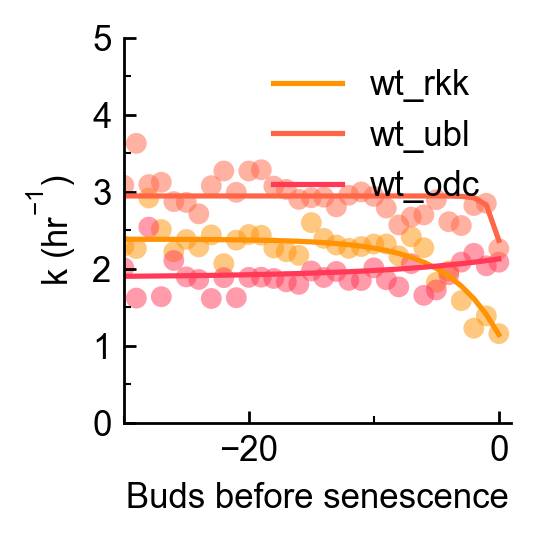

In [99]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'wt_ubl',
    'wt_odc'
]
keys = list(k_vs_dist_from_sen_all_strains_fit_df.samplename.unique())
hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC228'],
    plotting.strains_color_dict['JPC122'],
]

kwargs = {
    'x': 'x_median',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': k_vs_dist_from_sen_all_strains_fit_df[k_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': k_vs_dist_from_sen_all_strains_fit_df[k_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:3],
          ax.get_legend_handles_labels()[1][0:3],
          frameon=False
         )

ax.set_xlabel('Buds before senescence')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlim(-30, 1)
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_median_y=y_pred_hue=samplename.svg


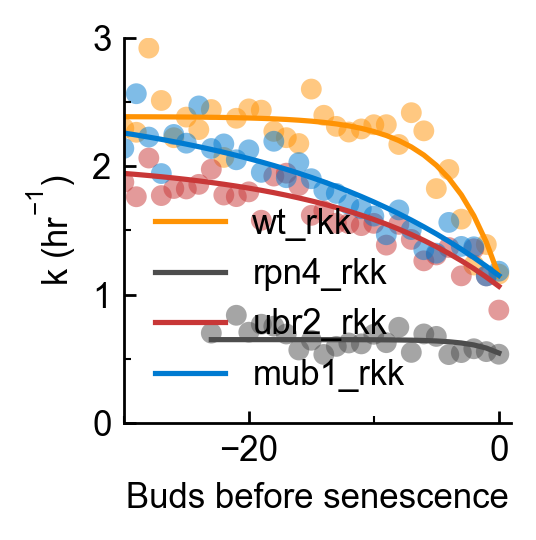

In [100]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
]
keys = list(k_vs_dist_from_sen_all_strains_fit_df.samplename.unique())
hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC263'],
    plotting.strains_color_dict['JPC262'],
    plotting.strains_color_dict['JPC274']
]

kwargs = {
    'x': 'x_median',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': k_vs_dist_from_sen_all_strains_fit_df[k_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': k_vs_dist_from_sen_all_strains_fit_df[k_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:4],
          ax.get_legend_handles_labels()[1][0:4],
          frameon=False,
          
         )

ax.set_xlabel('Buds before senescence')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlim(-30, 1)
ax.set_ylim(0, 3)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

Text(0.5, 0, 'x0 from k vs.\ndistance from sen')

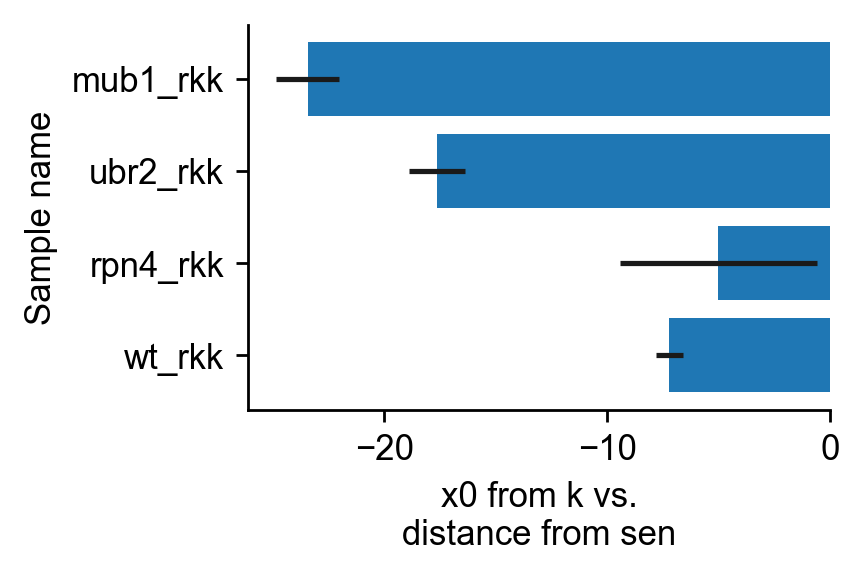

In [176]:
fig, ax = plotting.figure_ax(width_scale=1.5)

kwargs = {
    'y': 'samplename',
    'x': 'x0',
    'data': k_vs_dist_from_sen_all_strains_fits_table[~k_vs_dist_from_sen_all_strains_fits_table.samplename.isin(['ubr2_ubl', 'wt_ubl', 'wt_odc'])],
    'xerr': 'x0_stderr'
}

ax.barh(
    kwargs['data'][kwargs['y']],
    kwargs['data'][kwargs['x']],
    xerr=kwargs['data'][kwargs['xerr']]
)

ax.set_ylabel('Sample name')
ax.set_xlabel('x0 from k vs.\ndistance from sen')

#### Cycle duration vs. distance from senescence fit to piecewise

In [ ]:
sub_buds_df.loc[:, 'buds_after_death']

55519   -11.0
55520   -10.0
55521    -9.0
55522    -8.0
55523    -7.0
         ... 
56491    -4.0
56492    -3.0
56493    -2.0
56494    -1.0
56495     0.0
Name: buds_after_death, Length: 977, dtype: float64

In [ ]:
cols = [
    'cycle_duration_hrs',
]


idx = [
    'buds_after_death',
]

cols = cols + idx

sub_buds_table = sub_buds_df[~sub_buds_df.cycle_duration_hrs.isna()].loc[:, cols].groupby(by=idx).median().reset_index()

#### Fit piecewise to all cells cycle duratoin vs. buds before death

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.png
Buds before SEP max of 9.0 and min of -35.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.png
Buds before SEP max of 12.0 and min of -30.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.png
Buds before SEP max of 10.0 and min of -36.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_se

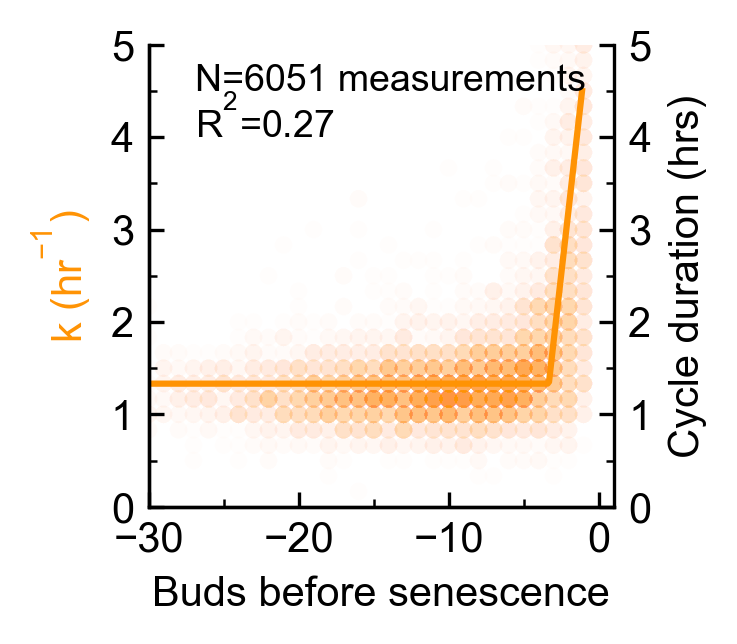

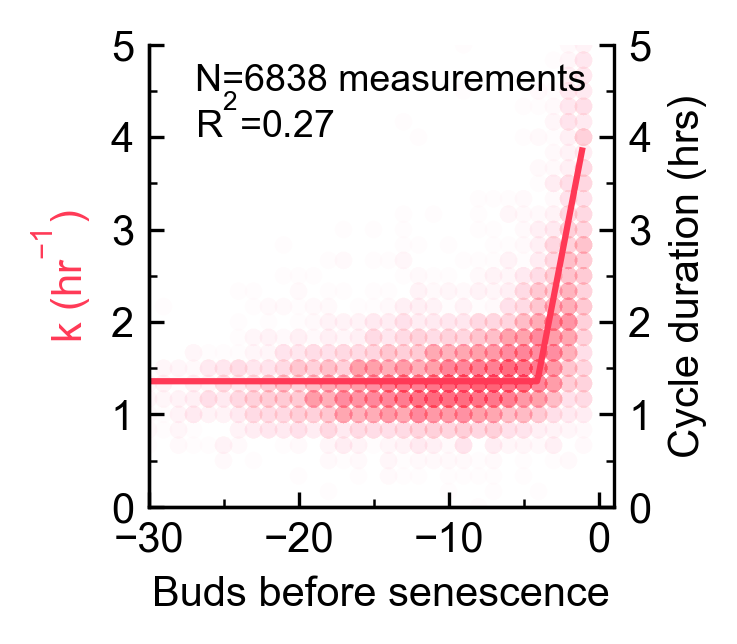

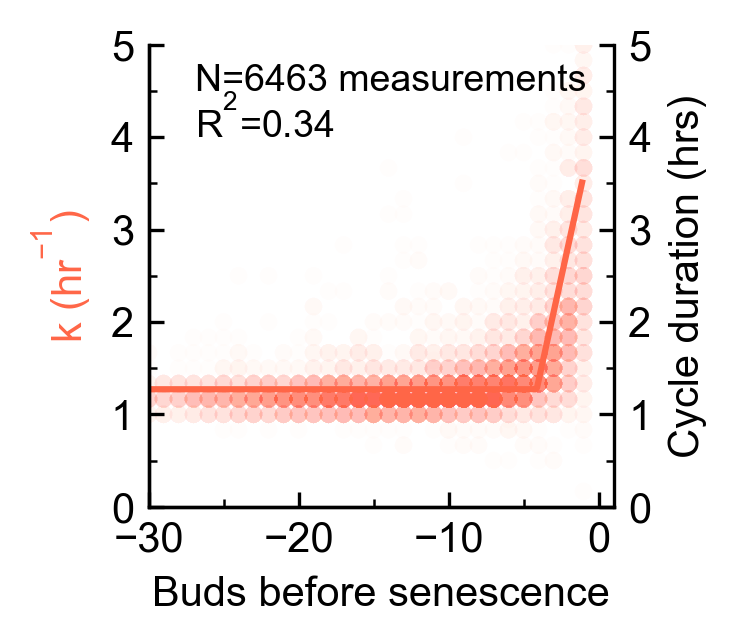

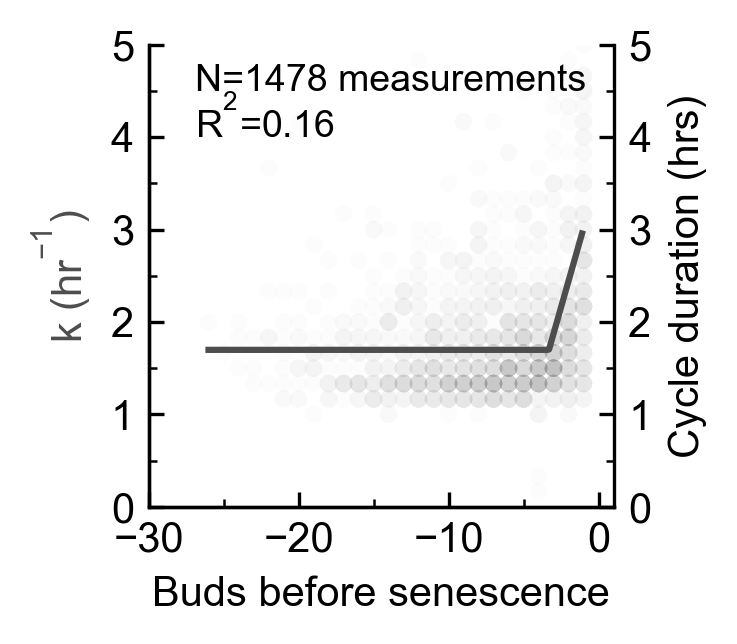

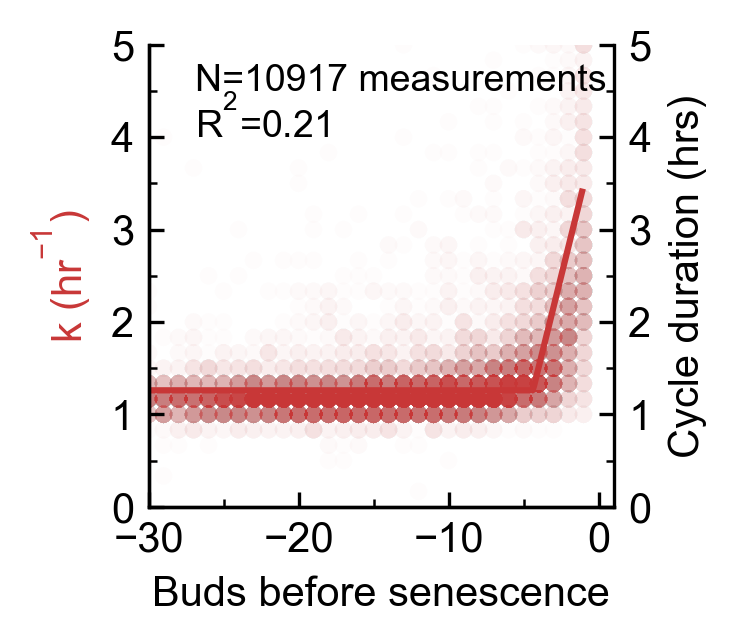

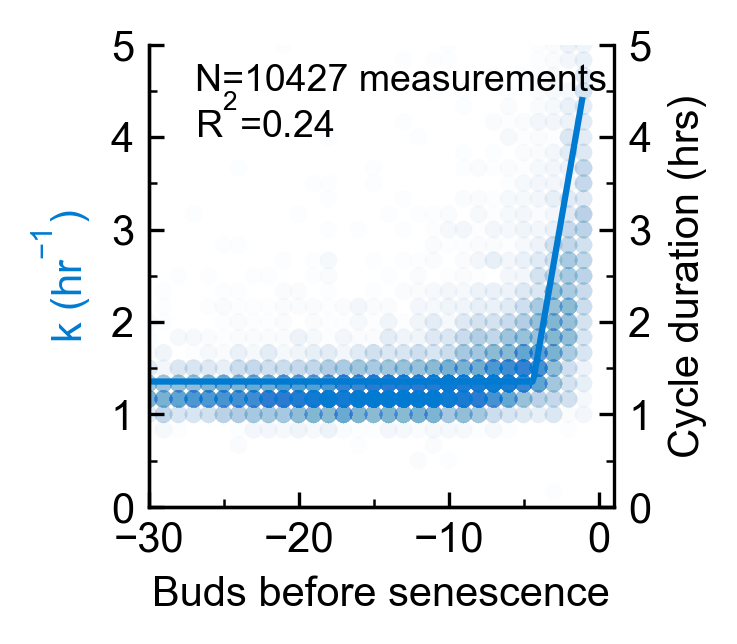

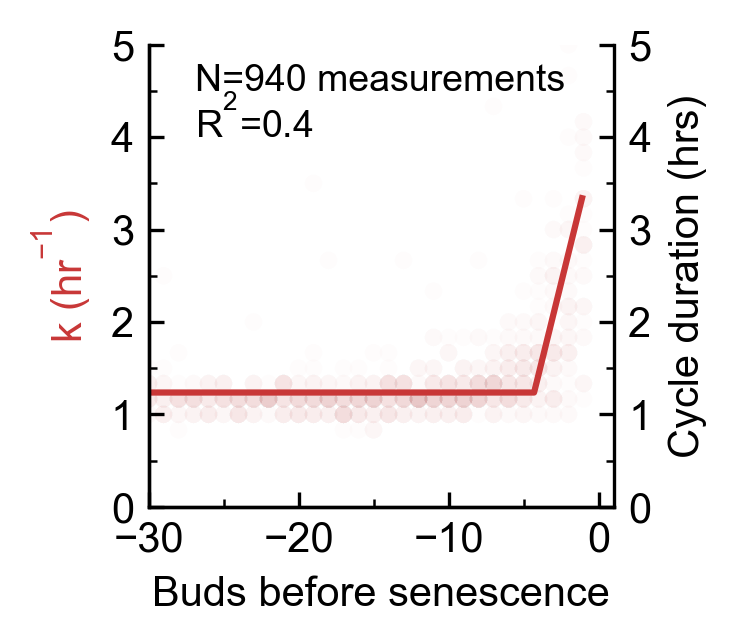

In [164]:
from itertools import zip_longest

strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
for strain in strains:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.buds_before_SEP.isna()) &
        (fits_df.x0_stderr_fraction.abs()<1)]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_buds_df[~sub_buds_df.cycle_duration_hrs.isna()],
        sub_buds_df[~sub_buds_df.cycle_duration_hrs.isna()],
        yvar1='cycle_duration_hrs',
        yvar2=None,
        xvar='buds_after_death',
        fit_type='piecewise',
        xlabel='Buds before senescence',
        xlim=(-30, 1),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        scatteralpha=0.01,
        fillsep=False,
        width_scale=1,
    )
    # Fill NaN values at the ends of array in these outputs
    # This this is needed if there's an NaN in the y variable. For instance when we're talking about 
    # cycle duration on the 0th bud before senescence, there is not next bud to define the end
    # of the 0th cell cycle so this is always NaN
    arrays = [
        x,
        y_pred,
        x_median,
        y_median
    ]
    results_dfs.append(results_df)
    arr_filled = [list(tpl) for tpl in zip(*zip_longest(*arrays))]
    x, y_pred, x_median, y_median = arr_filled
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    
    for col in results_df.columns:
        strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
cycledur_vs_dist_from_sen_all_strains_fits_table = pd.concat(results_dfs)
cycledur_vs_dist_from_sen_all_strains_fit_df = pd.concat(dfs)

#### Fit piecewise to median of all cells cycle duratoin vs. buds before death

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=w-t-_-r-k-k.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=w-t-_-r-k-k.png
Buds before SEP max of 9.0 and min of -35.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=w-t-_-o-d-c.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=w-t-_-o-d-c.png
Buds before SEP max of 12.0 and min of -30.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=w-t-_-u-b-l.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=w-t-_-u-b-l.png
Buds before SEP max of 10.0 and min of -36.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_

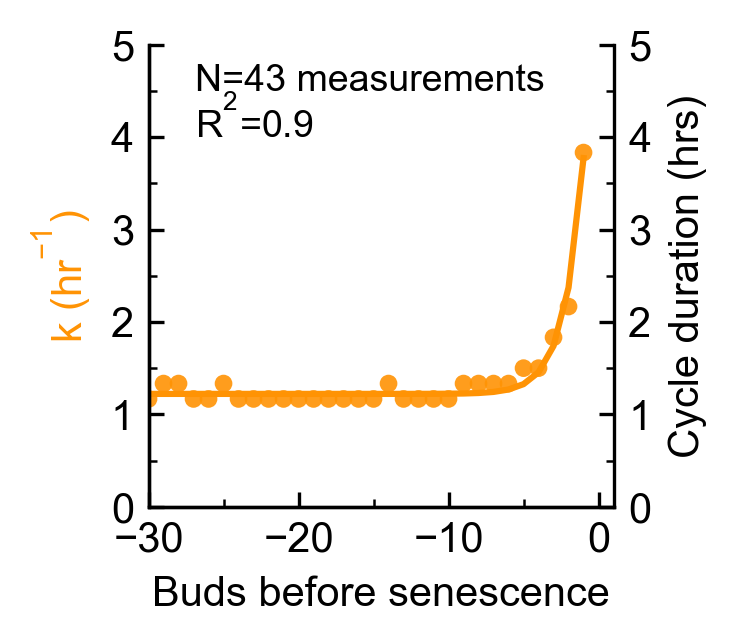

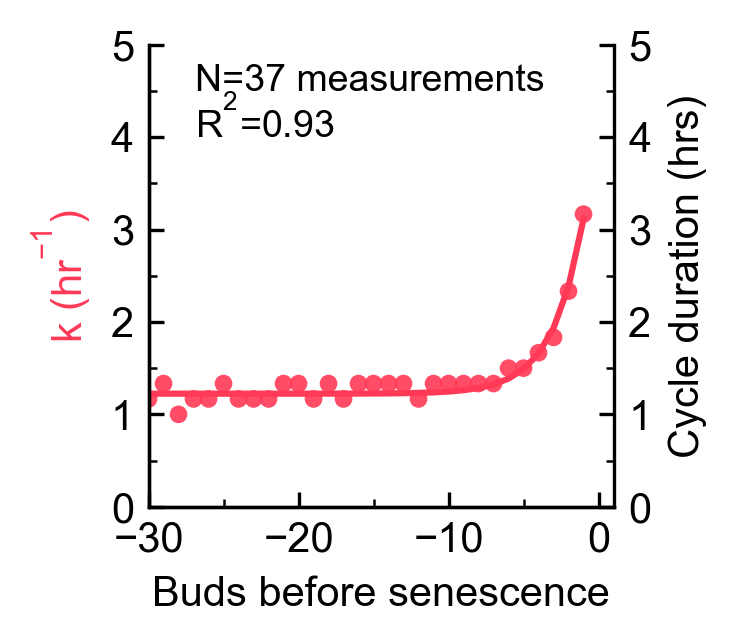

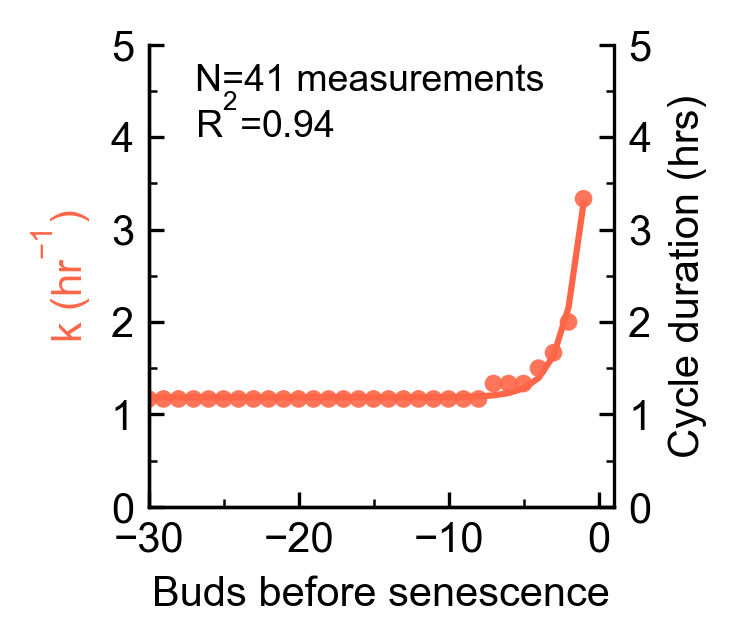

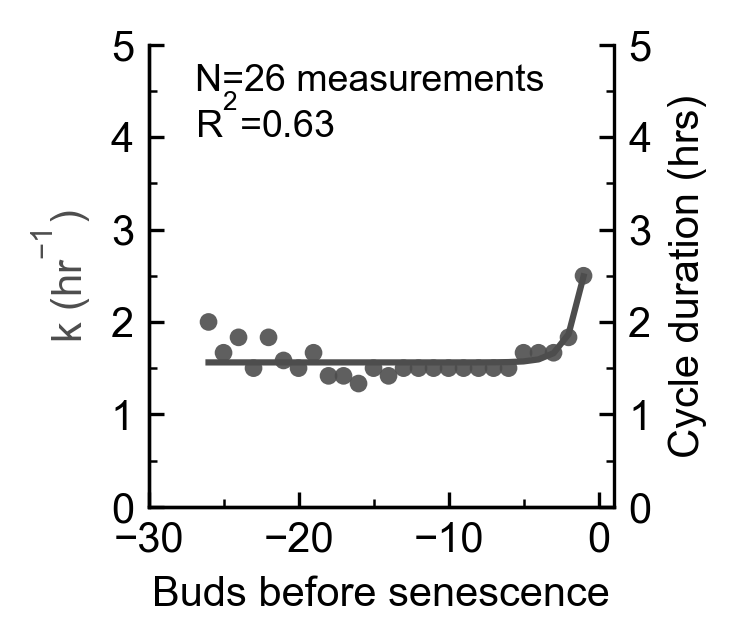

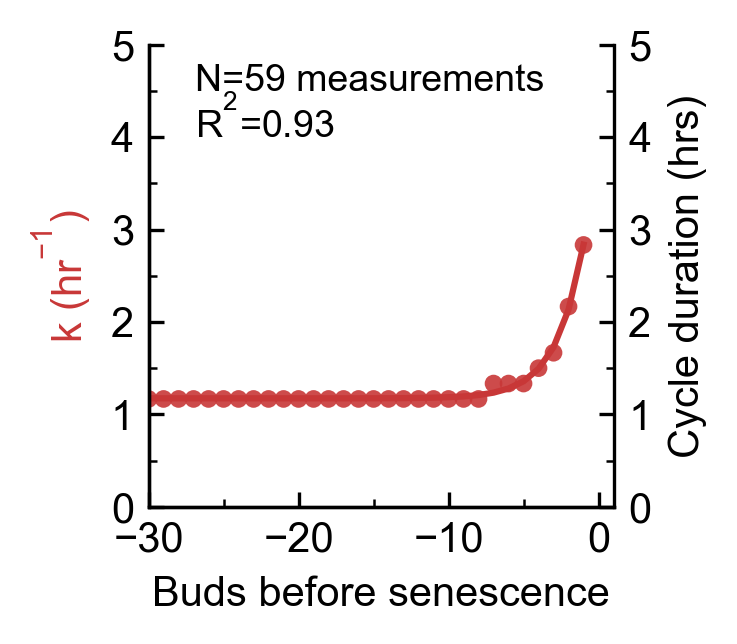

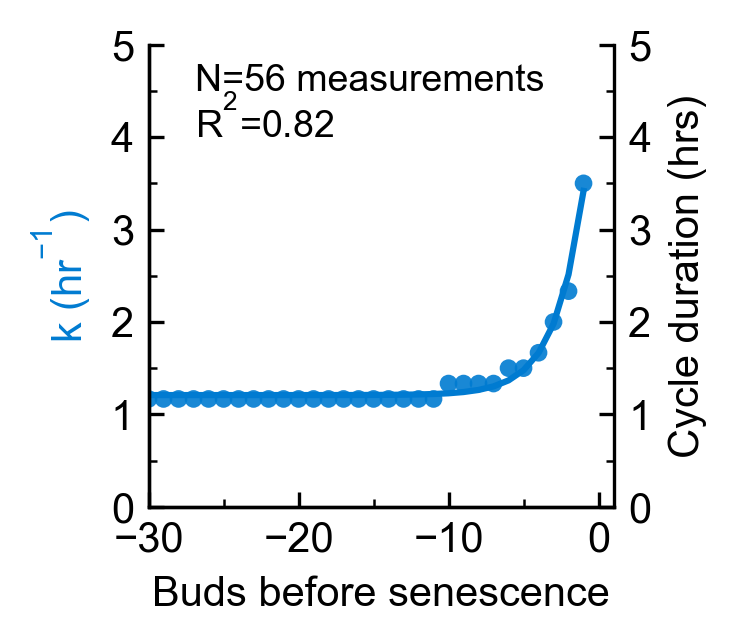

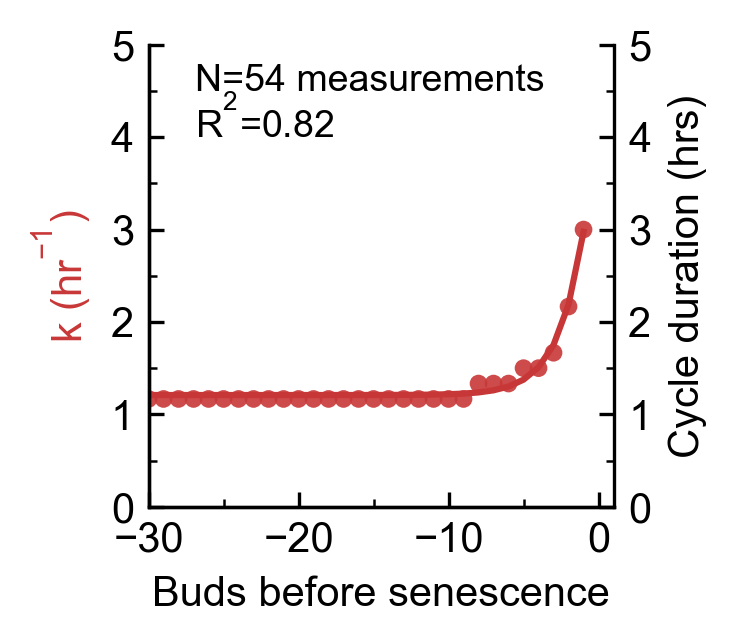

In [168]:
from itertools import zip_longest

strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
for strain in strains[:]:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.buds_before_SEP.isna()) &
        (fits_df.x0_stderr_fraction.abs()<1)]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    # Make a table of median cycle duration per
    # buds before senescence over all cells
    cols = [
        'cycle_duration_hrs',
    ]
    idx = [
        'buds_after_death',
        'samplename'
    ]
    cols = cols + idx
    sub_buds_table = sub_buds_df[~sub_buds_df.cycle_duration_hrs.isna()].loc[:, cols].groupby(by=idx).median().reset_index()
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_buds_table[~sub_buds_table.cycle_duration_hrs.isna()],
        sub_buds_table[~sub_buds_table.cycle_duration_hrs.isna()],
        yvar1='cycle_duration_hrs',
        yvar2=None,
        xvar='buds_after_death',
        fit_type='exponential',
        xlabel='Buds before senescence',
        xlim=(-30, 1),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        scatteralpha=0.9,
        fillsep=False,
        width_scale=1,
    )
    # Fill NaN values at the ends of array in these outputs
    # This this is needed if there's an NaN in the y variable. For instance when we're talking about 
    # cycle duration on the 0th bud before senescence, there is not next bud to define the end
    # of the 0th cell cycle so this is always NaN
    arrays = [
        x,
        y_pred,
        x_median,
        y_median
    ]
    results_dfs.append(results_df)
    arr_filled = [list(tpl) for tpl in zip(*zip_longest(*arrays))]
    x, y_pred, x_median, y_median = arr_filled
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    
    for col in results_df.columns:
        strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
cycledur_vs_dist_from_sen_all_strains_fits_table = pd.concat(results_dfs)
cycledur_vs_dist_from_sen_all_strains_fit_df = pd.concat(dfs)

In [171]:
cycledur_vs_dist_from_sen_all_strains_fits_table.loc[:, ['samplename', 'k', 'k_stderr', 'k_stderr_fraction']]

,samplename,k,k_stderr,k_stderr_fraction
0,wt_rkk,0.796218,0.095655,0.120137
0,wt_odc,0.489860,0.047098,0.096145
0,wt_ubl,0.771334,0.071192,0.092298
0,rpn4_rkk,1.117140,0.441101,0.394848
0,ubr2_rkk,0.550047,0.041787,0.075970
0,mub1_rkk,0.526464,0.070707,0.134306
0,ubr2_ubl,0.590277,0.081729,0.138459


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_y=y_pred_hue=samplename.svg


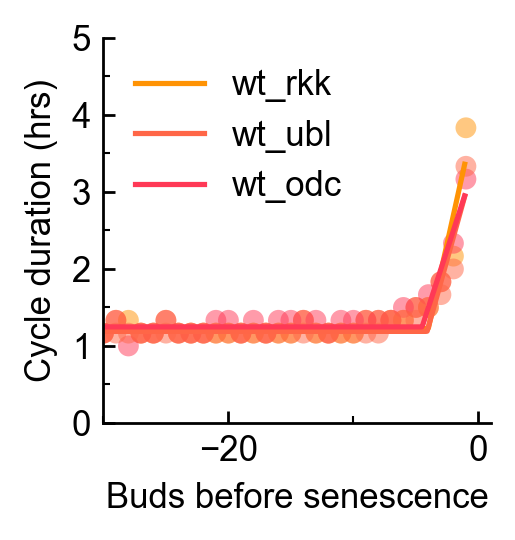

In [349]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'wt_ubl',
    'wt_odc'
]

hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC228'],
    plotting.strains_color_dict['JPC122'],
]

kwargs = {
    'x': 'x',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': cycledur_vs_dist_from_sen_all_strains_fit_df[cycledur_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': cycledur_vs_dist_from_sen_all_strains_fit_df[cycledur_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:3],
          ax.get_legend_handles_labels()[1][0:3],
          frameon=False
         )

ax.set_xlabel('Buds before senescence')
ax.set_ylabel('Cycle duration (hrs)')
ax.set_xlim(-30, 1)
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_y=y_pred_hue=samplename.svg


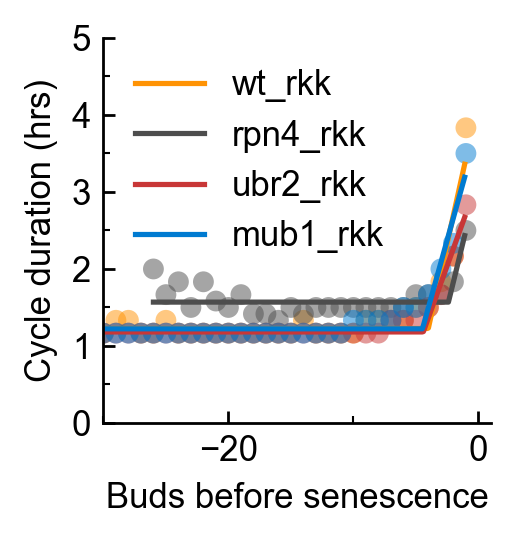

In [350]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
]
hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC263'],
    plotting.strains_color_dict['JPC262'],
    plotting.strains_color_dict['JPC274']
]

kwargs = {
    'x': 'x',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': cycledur_vs_dist_from_sen_all_strains_fit_df[cycledur_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': cycledur_vs_dist_from_sen_all_strains_fit_df[cycledur_vs_dist_from_sen_all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:4],
          ax.get_legend_handles_labels()[1][0:4],
          frameon=False,
          
         )

ax.set_xlabel('Buds before senescence')
ax.set_ylabel('Cycle duration (hrs)')
ax.set_xlim(-30, 1)
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

In [351]:
sepdf[sepdf.samplename=='rpn4_rkk'].compartment_name.unique()

array(['20230303_byc_JPC263_R-YFP-Su9_rpn4d',
       '20230609_byc_JPC277_R-YFP-Su9_in_rpn4d_cue5d'], dtype=object)

Text(0.5, 0, 'x0 from cycle duration vs.\ndistance from sen')

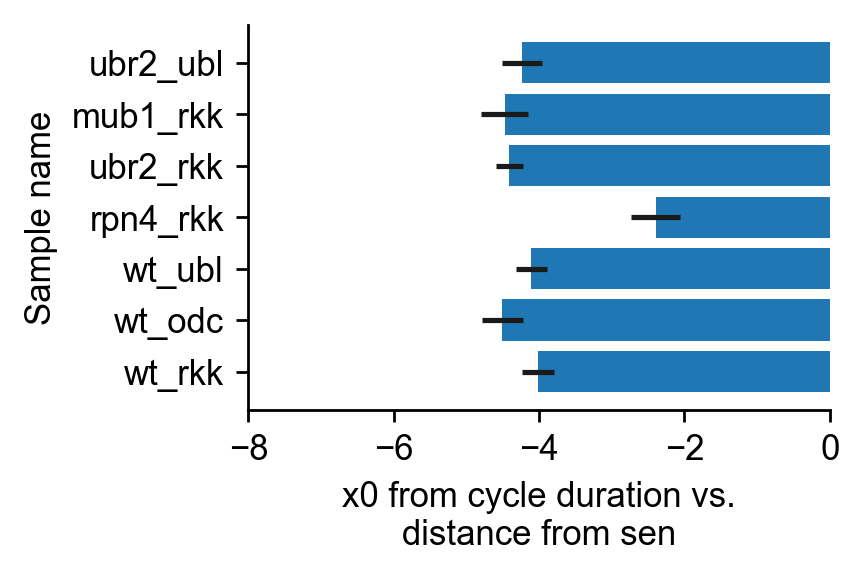

In [352]:
fig, ax = plotting.figure_ax(width_scale=1.5)

kwargs = {
    'y': 'samplename',
    'x': 'x0',
    'data': cycledur_vs_dist_from_sen_all_strains_fits_table,
    'xerr': 'x0_stderr'
}

ax.barh(
    kwargs['data'][kwargs['y']],
    kwargs['data'][kwargs['x']],
    xerr=kwargs['data'][kwargs['xerr']]
)

ax.set_ylabel('Sample name')
ax.set_xlim(-8, 0)
ax.set_xlabel('x0 from cycle duration vs.\ndistance from sen')

Text(0.5, 0, 'x0 from cycle duration vs.\ndistance from sen')

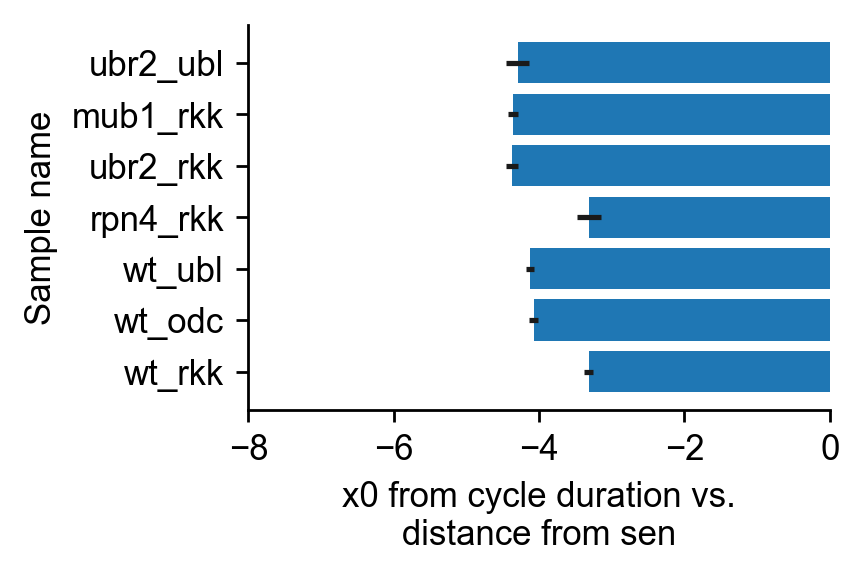

In [280]:
fig, ax = plotting.figure_ax(width_scale=1.5)

kwargs = {
    'y': 'samplename',
    'x': 'x0',
    'data': cycledur_vs_dist_from_sen_all_strains_fits_table,
    'xerr': 'x0_stderr'
}

ax.barh(
    kwargs['data'][kwargs['y']],
    kwargs['data'][kwargs['x']],
    xerr=kwargs['data'][kwargs['xerr']]
)

ax.set_ylabel('Sample name')
ax.set_xlim(-8, 0)
ax.set_xlabel('x0 from cycle duration vs.\ndistance from sen')

Text(0.5, 0, 'x0 from cycle freqency vs.\ndistance from sen')

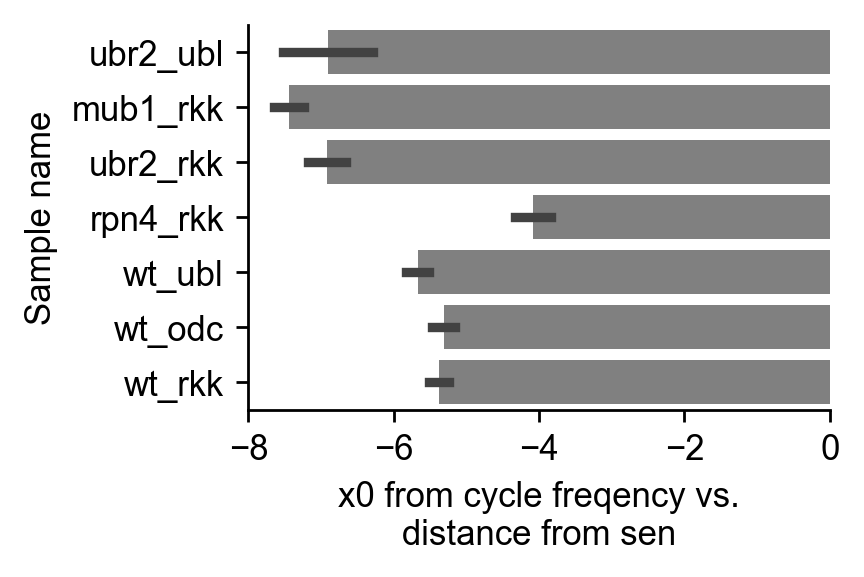

In [11]:
fig, ax = plotting.figure_ax(width_scale=1.5)

samples = [
    'ubr2_ubl',
    'mub1_rkk',
    'ubr2_rkk',
    'rpn4_rkk',
    'wt_ubl',
    'wt_odc',
    'wt_rkk'
]

kwargs = {
    'y': 'samplename',
    'x': 'x0',
    'data': sepdf[sepdf.samplename.isin(samples)],
    'order': samples,
    'errorbar': 'se',
    'color': 'gray'
    # 'xerr': 'x0_stderr'
}

sns.barplot(**kwargs)

ax.set_xlim(-8, 0)
ax.set_ylabel('Sample name')
ax.set_xlabel('x0 from cycle freqency vs.\ndistance from sen')

## Figure 3: Ubiquitylated substrate degradation correlates with Hsp104 morphology and induction correlate with

### Quantification of daughter shape to evaluate manual classification

In [5]:
from byc import utilities
from byc import constants
import os
from roifile import ImagejRoi

Make a master index for the experiment of interest

In [2]:
exptname = '20221201_byc'
compartmentname = '20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry'
mdf = utilities.generate_mdf(exptname, compartmentname)

Adding paths for channels ['bf', 'rfp', 'yfp']


Create directories in which to save ROIs with long vs. round classification

In [6]:
exptdir = os.path.join(constants.byc_data_dir, mdf.exptname.iloc[0])
longdir = os.path.join(exptdir, f'{compartmentname}_long_rois')
rounddir = os.path.join(exptdir, f'{compartmentname}_round_rois')
for dx in [longdir, rounddir]:
    if not os.path.exists(dx):
        os.mkdir(dx)
        print(f'Made directory at\n{dx}')
    else:
        print(f'Folder exists at\n{dx}')

Folder exists at
C:\Users\johnp\Dropbox\Projects\byc\data/20221201_byc\20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry_long_rois
Folder exists at
C:\Users\johnp\Dropbox\Projects\byc\data/20221201_byc\20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry_round_rois


Split ROIs into long vs. round and save them in the directories created above

In [4]:
created_roi_ids = []

for row in [mdf.loc[idx, :] for idx in mdf.index]:
    bud_roi_path = os.path.join(constants.byc_data_dir, row.bud_roi_set_relpath)
    bud_rois = ImagejRoi.fromfile(bud_roi_path)
    bud_id = '-'.join([str(int(roi.position)) for roi in bud_rois])
    # There will be duplicates because some bud ROIs were saved twice
    # to correspond to different crops of the same cell
    if bud_id in created_roi_ids:
        continue
    round_rois = [IJRoi for IJRoi in bud_rois if 'round' in IJRoi.name]
    long_rois = [IJRoi for IJRoi in bud_rois if 'long' in IJRoi.name]

    print(f'Saving ROIs for cell {row.cell_index} at...')
    # Save the long ROIs
    for i, roi in enumerate(round_rois):
        
        round_rois_basepath = os.path.join(rounddir, os.path.basename(bud_roi_path))
        single_roi_basepath = round_rois_basepath.replace('.zip', f'_xy{str(row.xy).zfill(2)}.zip')
        savepath = single_roi_basepath.replace('.zip', f'_{str(i).zfill(3)}.zip')

        roi.tobytes()
        roi.tofile(savepath)
        print(savepath)
    # Save the long ROIs
    for i, roi in enumerate(long_rois):
        
        long_rois_basepath = os.path.join(longdir, os.path.basename(bud_roi_path))
        single_roi_basepath = long_rois_basepath.replace('.zip', f'_xy{str(row.xy).zfill(2)}.zip')
        savepath = single_roi_basepath.replace('.zip', f'_{str(i).zfill(3)}.zip')

        roi.tobytes()
        roi.tofile(savepath)
        print(savepath)

    created_roi_ids.append(bud_id)

Plots

In [10]:
longcsvs = [os.path.join(longdir, file) for file in os.listdir(longdir) if '.csv' in file]
roundcsvs = [os.path.join(rounddir, file) for file in os.listdir(rounddir) if '.csv' in file]

longdf = pd.concat([pd.read_csv(path) for path in longcsvs])
roundf = pd.concat([pd.read_csv(path) for path in roundcsvs])

roundf.loc[:, 'shape'] = 'round'
longdf.loc[:, 'shape'] = 'long'

alldf = pd.concat([longdf, roundf], ignore_index=True).reset_index()

In [11]:
len(alldf)

352

In [24]:
alldf.loc[:, 'aspect_ratio'] = alldf.Feret/alldf.MinFeret
for var in ['Feret', 'MinFeret']:
    alldf.loc[:, f'{var}_um'] = alldf[var]*0.22

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=MinFeret_um_y=Feret_um_hue=shape.svg


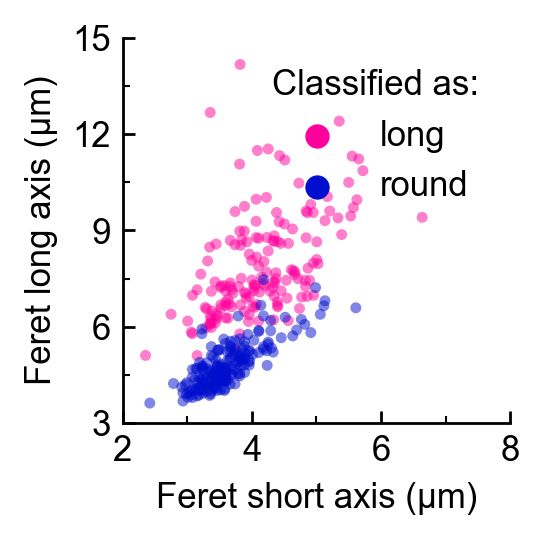

In [40]:
plotting.set_styles(plt, matplotlib)
fig, ax = plotting.figure_ax()

label1 = f'Feret long axis ({plotting.annoying_strings().mu}m)'
label2 = f'Feret short axis ({plotting.annoying_strings().mu}m)'

kwargs = {
    'x': 'MinFeret_um',
    'y': 'Feret_um',
    'hue': 'shape',
    'data': alldf,
    'ax': ax,
    'palette': [plotting.other_colors['mode1'], plotting.other_colors['mode2']]
}
# sns.lmplot(
#     x=kwargs['x'],
#     y=kwargs['y'],
#     hue=kwargs['hue'],
#     data=kwargs['data']
# )
sns.scatterplot(**kwargs, alpha=0.5, linewidth=0, s=10)

ax.legend(ax.get_legend_handles_labels()[0], ax.get_legend_handles_labels()[1], frameon=False,
          title='Classified as:')
ax.set_xlabel(label2)
ax.set_ylabel(label1)
ax.set_xlim(2, 8)
ax.set_xticks(np.arange(np.min(ax.get_xlim()), np.max(ax.get_xlim())+1, 2))
ax.set_ylim(3, 15)
ax.set_yticks(np.arange(np.min(ax.get_ylim()), np.max(ax.get_ylim())+1, 3))
plotting.format_ticks(ax)
plotting.save_figure(fig, kwargs, ext='.svg')

long vs. round: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:3.588e-54 U_stat=3.012e+04
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=shape_y=aspect_ratio_hue=shape_dodge=False.svg


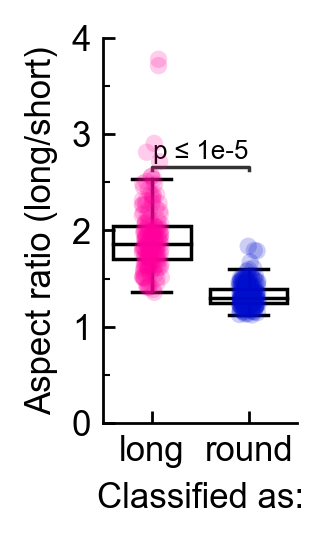

In [65]:
fig, ax = plotting.figure_ax(width_scale=0.5)

kwargs = {
    'x': 'shape',
    'y': 'aspect_ratio',
    'hue': 'shape',
    'palette': [plotting.other_colors['mode1'], plotting.other_colors['mode2']],
    'ax': ax,
    'data': alldf,
    'dodge': False
}
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)

from statannotations.Annotator import Annotator

# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
box_pairs=[
    ('long', 'round')
]

test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, data=data, x=x, y=y)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni")
annotator.apply_and_annotate()

sns.stripplot(**kwargs, alpha=0.2, size=5)

ax.legend_.set_visible(False)
ax.set_ylim(0, 4)
ax.set_xlabel('Classified as:')
ax.set_ylabel('Aspect ratio (long/short)')
plotting.format_ticks(ax, add_minor_x=False)

plotting.save_figure(fig, kwargs, ext='.svg')

### k vs. dist from sen in mode 1 and mode 2

ValueError: Could not interpret value `produced_elongated_daughters` for parameter `hue`

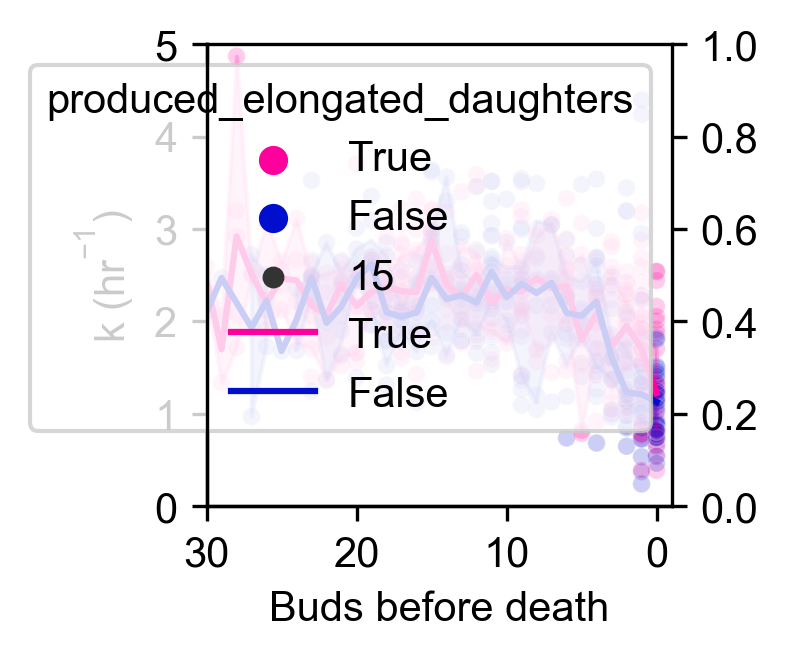

In [4]:
compartments = constants.compartments_dict['wt_rkk']
sub_fits_df = fits_df.loc[fits_df.compartment_name.isin(compartments), :]
sub_fits_df = sub_fits_df[sub_fits_df.dist_from_sen>=0]
sub_buds_df = buds_df.loc[buds_df.compartment_name.isin(compartments), :]
sub_buds_df = sub_buds_df[sub_buds_df.dist_from_sen>=0]

fig, ax = plotting.figure_ax()
fig.set_dpi(300)

kwargs = {
    'x': 'dist_from_sen',
    'y': 'b',
    'hue': 'produced_elongated_daughters',
    'ax': ax,
    'data': sub_fits_df,
    'palette': [other_colors['mode1'], other_colors['mode2']],
    'hue_order': [True, False],
}

sns.scatterplot(**kwargs, alpha=0.2, size=15)
sns.lineplot(**kwargs, alpha=1, estimator=np.median)
ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, ax.get_xlim()[0]+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.1, 1))
# plotting.legend_outside()
ax.set_xlabel('Buds before death')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)

# Plot cycle duration
ax2 = ax.twinx()
kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'hue': 'produced_elongated_daughters',
    'data': sub_buds_df,
    'hue_order': [True, False],
    'ax': ax,
    'palette': [other_colors['mode1'], other_colors['mode2']],
    'linestyle': '--'
}

sns.lineplot(**kwargs)
ax2.set_ylim(0, 5)
ax2.set_yticks(np.arange(0, np.max(ax.get_ylim())+0.1, 1))
ax2.set_ylabel('Cycle duration (hrs.)')
plotting.format_ticks(ax)
ax.legend(ax.get_legend_handles_labels()[0], ['1', '2'], frameon=False, title='Aging mode')

plotting.format_ticks(ax)
plotting.format_ticks(ax2)
ax2.spines['top'].set_visible(False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Strip plot k vs pre/post SEP where SEP is 5 for all cells vs. aging mode

False_False vs. False_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:4.916e-23 U_stat=2.032e+04
True_False vs. True_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:5.638e-16 U_stat=1.774e+04
True_False vs. False_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=2.048e+04
True_True vs. False_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:3.786e-03 U_stat=9.018e+03
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=produced_elongated_daughters_y=b_hue=post_sep_dodge=True.svg
False over True = 0.8661598967299784
True over False = 1.1545212422963813


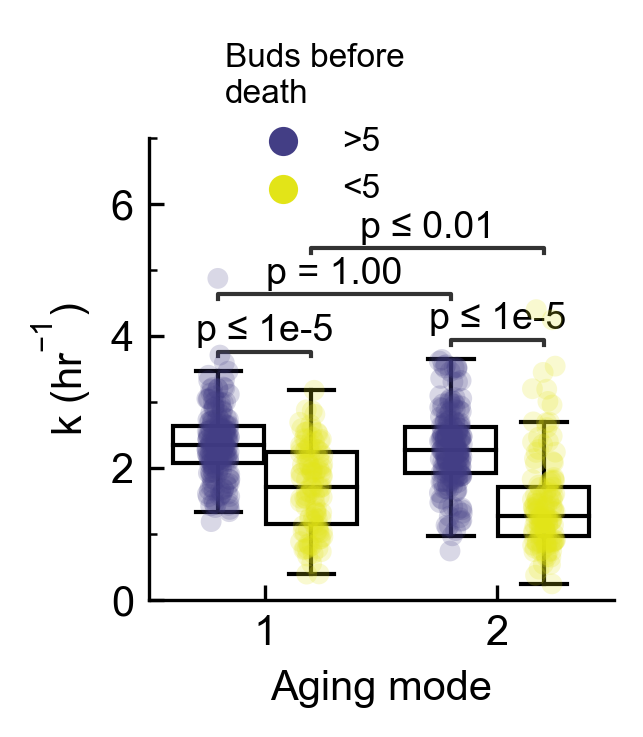

In [9]:
fig, ax = plotting.figure_ax(width_scale=1)
fig.set_dpi(300)

sub_fits_df.loc[sub_fits_df.dist_from_sen<5, 'post_sep'] = True
sub_fits_df.loc[sub_fits_df.dist_from_sen>5, 'post_sep'] = False

# ax.set_ylim(0, 4)

kwargs = {
    'x': 'produced_elongated_daughters',
    'y': 'b',
    'hue': 'post_sep',
    'ax': ax,
    'data': sub_fits_df[sub_fits_df.b<=5],
    'palette': plotting.get_pre_post_sep_palette(),
    'hue_order': [False, True],
    'dodge': True,
    'order': [True, False]
}
# Plot stuff
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict,
           showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
hue_order = kwargs['hue_order']
order = kwargs['order']
box_pairs=[
    ((True, True), (True, False)),
    ((False, True), (False, False)),
    ((True, False), (False, False)),
    ((True, True), (False, True))
]
test='Mann-Whitney'
text_format="simple"
loc="inside"
annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order, hue_order=hue_order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=9,
                   comparisons_correction="bonferroni",
                   line_offset_to_group=10, line_offset=30)
annotator.apply_and_annotate()
sns.stripplot(**kwargs, alpha=0.2)


ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)

ax.legend(
    ax.get_legend_handles_labels()[0][2:4],
    ['>5', '<5'],
    title='Buds before\ndeath',
    frameon=False,
    bbox_to_anchor=(0.1, 0.79),
    title_fontsize=8,
    fontsize=8
)
# ax.legend_.set_visible(False)
plotting.format_ticks(ax, add_minor_x=False)
ax.set_xticklabels(['1', '2'])
ax.set_xlabel('Aging mode')
ax.set_ylim(0, 7)

plotting.save_figure(fig, kwargs, ext='.svg')
# Print out fold change difference in post-SEP populations
df = kwargs['data']
xvar = kwargs['x']
yvar = kwargs['y']
huevar = kwargs['hue']
# hue will pretty much always be post_sep
xval1 = df[~df[xvar].isna()][xvar].unique()[0]
xval2 = df[~df[xvar].isna()][xvar].unique()[1]
mean1 = df.loc[(df[huevar]==True)&(df[xvar]==xval1), yvar].mean()
mean2 = df.loc[(df[huevar]==True)&(df[xvar]==xval2), yvar].mean()
print(f'{xval1} over {xval2} = {mean1/mean2}')
print(f'{xval2} over {xval1} = {mean2/mean1}')

### Strip plot k vs pre/post SEP where SEP is fit for individual cells vs. aging mode

False_False vs. False_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.628e-25 U_stat=1.990e+04
True_False vs. True_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:3.444e-16 U_stat=1.770e+04
True_False vs. False_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:5.036e-01 U_stat=1.937e+04
True_True vs. False_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.878e-04 U_stat=9.684e+03
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=produced_elongated_daughters_y=b_hue=post_SEP_dodge=True.svg
False over True = 0.8141310765533013
True over False = 1.228303437615466


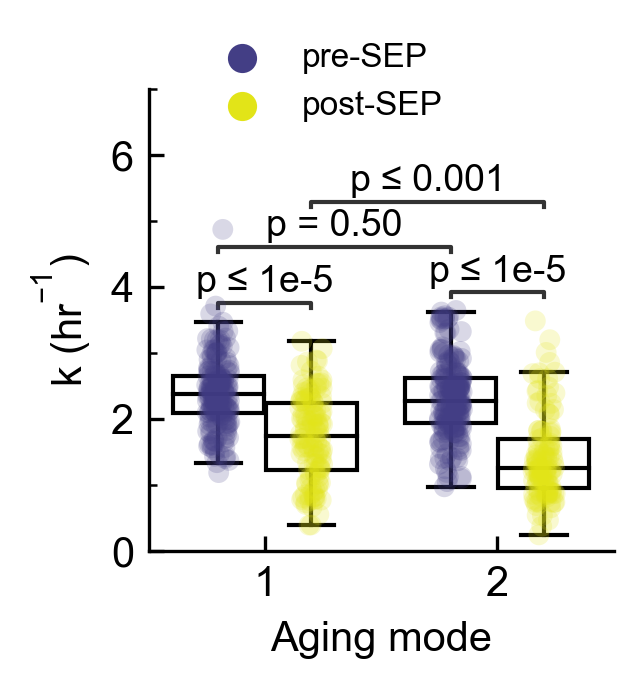

In [398]:
fig, ax = plotting.figure_ax(width_scale=1)
fig.set_dpi(300)

sub_fits_df.loc[sub_fits_df.buds_before_SEP<0, 'post_SEP'] = False
sub_fits_df.loc[sub_fits_df.buds_before_SEP>=0, 'post_SEP'] = True

# ax.set_ylim(0, 4)

kwargs = {
    'x': 'produced_elongated_daughters',
    'y': 'b',
    'hue': 'post_SEP',
    'ax': ax,
    'data': sub_fits_df[sub_fits_df.b<=5],
    'palette': plotting.get_pre_post_sep_palette(),
    'hue_order': [False, True],
    'dodge': True,
    'order': [True, False]
}
# Plot stuff
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict,
           showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
hue_order = kwargs['hue_order']
order = kwargs['order']
box_pairs=[
    ((True, True), (True, False)),
    ((False, True), (False, False)),
    ((True, False), (False, False)),
    ((True, True), (False, True))
]
test='Mann-Whitney'
text_format="simple"
loc="inside"
annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order, hue_order=hue_order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=9,
                   comparisons_correction="bonferroni",
                   line_offset_to_group=10, line_offset=30)
annotator.apply_and_annotate()
sns.stripplot(**kwargs, alpha=0.2)


ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)

ax.legend(
    ax.get_legend_handles_labels()[0][2:4],
    ['pre-SEP', 'post-SEP'],
    title='',
    frameon=False,
    loc=(0.1, 0.9),
    title_fontsize=8,
    fontsize=8
)
# ax.legend_.set_visible(False)
plotting.format_ticks(ax, add_minor_x=False)
ax.set_xticklabels(['1', '2'])
ax.set_xlabel('Aging mode')
ax.set_ylim(0, 7)

plotting.save_figure(fig, kwargs, ext='.svg')
# Print out fold change difference in post-SEP populations
df = kwargs['data']
xvar = kwargs['x']
yvar = kwargs['y']
huevar = kwargs['hue']
# hue will pretty much always be post_sep
xval1 = df[~df[xvar].isna()][xvar].unique()[0]
xval2 = df[~df[xvar].isna()][xvar].unique()[1]
mean1 = df.loc[(df[huevar]==True)&(df[xvar]==xval1), yvar].mean()
mean2 = df.loc[(df[huevar]==True)&(df[xvar]==xval2), yvar].mean()
print(f'{xval1} over {xval2} = {mean1/mean2}')
print(f'{xval2} over {xval1} = {mean2/mean1}')

### k vs. aging mode and dist from senescence in last five generations

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=produced_elongated_daughters_y=b_hue=dist_from_sen_dodge=True.svg


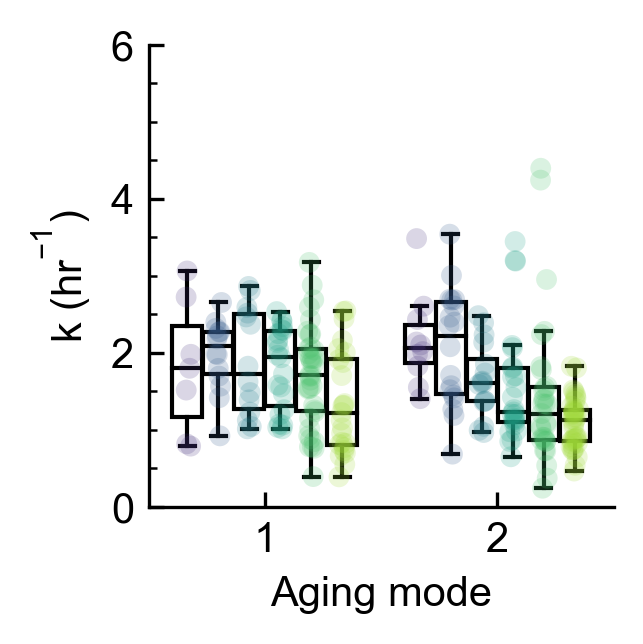

In [35]:
fig, ax = plotting.figure_ax(width_scale=1)
fig.set_dpi(300)

sub_fits_df.loc[sub_fits_df.dist_from_sen<5, 'post_sep'] = True
sub_fits_df.loc[sub_fits_df.dist_from_sen>5, 'post_sep'] = False

# ax.set_ylim(0, 4)
palette = plotting.get_dist_from_sen_color_map(max_dist_from_sen=5)
palette.reverse()
kwargs = {
    'x': 'produced_elongated_daughters',
    'y': 'b',
    'hue': 'dist_from_sen',
    'ax': ax,
    'data': sub_fits_df[(sub_fits_df.b<=5)&(sub_fits_df.dist_from_sen<=5)],
    'hue_order': [5, 4, 3, 2, 1, 0],
    'palette': palette,
    'order': [True, False],
    # 'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True
}
# Plot stuff
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict,
           showfliers=False)
# # annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = 'post_sep'
hue_order = [False, True]
order = kwargs['order']
box_pairs=[
    ((True, True), (True, False)),
    ((False, True), (False, False)),
    ((True, False), (False, False)),
    ((True, True), (False, True))
]
test='Mann-Whitney'
text_format="simple"
loc="inside"
annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order, hue_order=hue_order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=9,
                   comparisons_correction="bonferroni",
                   line_offset_to_group=5, line_offset=30)
annotator.apply_and_annotate()
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend_.set_visible(False)
plotting.format_ticks(ax, add_minor_x=False)
ax.set_xticklabels(['1', '2'])
ax.set_xlabel('Aging mode')
ax.set_ylim(0, 6)

plotting.save_figure(fig, kwargs, ext='.svg')

### Cycle duration vs. dist from sen vs. aging mode

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=cycle_duration_hrs_hue=produced_elongated_daughters.svg


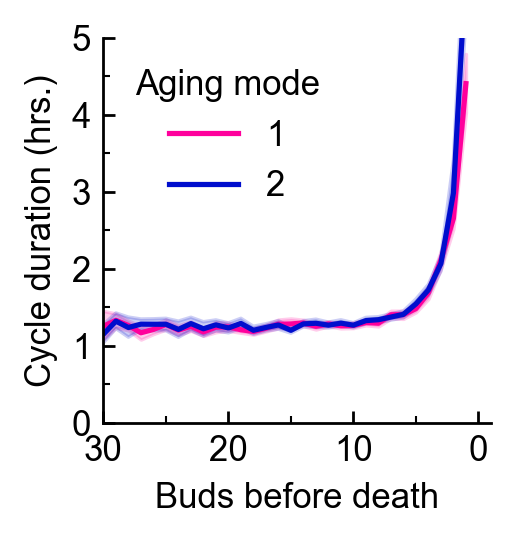

In [36]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'hue': 'produced_elongated_daughters',
    'data': sub_buds_df,
    'hue_order': [True, False],
    'ax': ax,
    'palette': [other_colors['mode1'], other_colors['mode2']]
}

sns.lineplot(**kwargs)

ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+0.1, 1))
ax.legend(ax.get_legend_handles_labels()[0], ['1', '2'], frameon=False, title='Aging mode')
ax.set_xlabel('Buds before death')
ax.set_ylabel('Cycle duration (hrs.)')
plotting.format_ticks(ax)
plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=cycle_number_y=cycle_duration_hrs_hue=produced_elongated_daughters.png


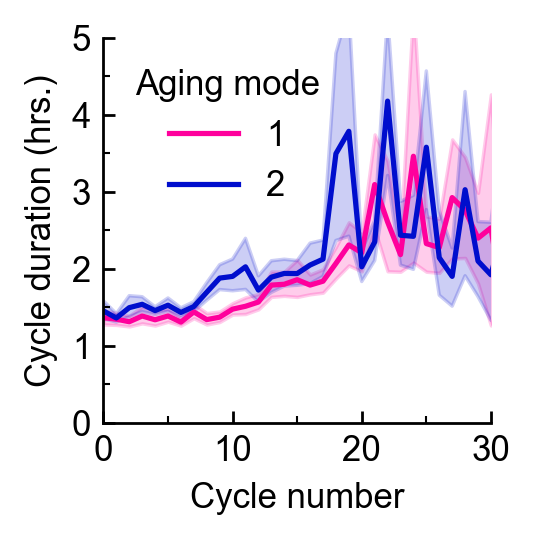

In [16]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'cycle_number',
    'y': 'cycle_duration_hrs',
    'hue': 'produced_elongated_daughters',
    'data': sub_buds_df,
    'hue_order': [True, False],
    'ax': ax,
    'palette': [other_colors['mode1'], other_colors['mode2']]
}

sns.lineplot(**kwargs)

ax.set_xlim(0, 30)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+0.1, 1))
ax.legend(ax.get_legend_handles_labels()[0], ['1', '2'], frameon=False, title='Aging mode')
ax.set_xlabel('Cycle number')
ax.set_ylabel('Cycle duration (hrs.)')
plotting.format_ticks(ax)
plotting.save_figure(fig, kwargs)

### Number of cells per aging mode

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=Mode_y=# of cells.svg


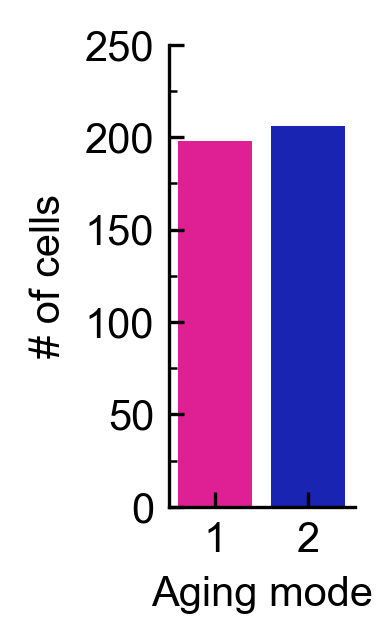

In [10]:
cols = [col for col in sub_fits_df.columns if sub_fits_df[col].dtype!='O']
aggdex = ['compartment_bud_id', 'produced_elongated_daughters', 'rls_suitable',
          'compartment_name']
cols = cols + [col for col in aggdex if col not in cols]
cell_table = sub_fits_df.loc[:, cols].pivot_table(index=aggdex, aggfunc=np.median).reset_index()
total_cells = len(~cell_table.produced_elongated_daughters.isna())
n_mode_1 = len(cell_table[cell_table.produced_elongated_daughters])
n_mode_2 = len(cell_table[cell_table.produced_elongated_daughters==False])
d = {
    '# of cells': [n_mode_1, n_mode_2],
    'Mode': [1, 2]
}

df = pd.DataFrame(d)

fig, ax = plotting.figure_ax(width_scale=0.4)
fig.set_dpi(300)

kwargs = {
    'x': 'Mode',
    'y': '# of cells',
    'data': df,
    'palette': [other_colors['mode1'], other_colors['mode2']],
    'ax': ax
}
sns.barplot(**kwargs)
ax.set_ylim(0, 250)
ax.set_xlabel('Aging mode')
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Comparing survival across aging modes

In [11]:
cols = [col for col in sub_fits_df.columns if sub_fits_df[col].dtype!='O']
aggdex = ['compartment_bud_id', 'produced_elongated_daughters', 'rls_suitable',
          'compartment_name']
cols = cols + [col for col in aggdex if col not in cols]
# Making this pivot table gets rid of duplicate entries for cells
# that were measured twice
cell_table = sub_fits_df.loc[:, cols].pivot_table(index=aggdex, aggfunc=np.median).reset_index()
total_cells = len(~cell_table.produced_elongated_daughters.isna())

found_buds_dfs = []
end_event_types = []

# annotate RLS censorship using buds_df because 
# it is not accurately annotated in trace df
# or crop_roi_df data
for bud_serial in cell_table.compartment_bud_id:
    if bud_serial in sub_buds_df.compartment_bud_id.unique():
        cell_buds_df = sub_buds_df[sub_buds_df.compartment_bud_id==bud_serial]
        end_event_type = cell_buds_df.end_event_type.iloc[0]
        cell_table.loc[cell_table.compartment_bud_id==bud_serial, 'end_event_type'] = end_event_type
        end_event_types.append(end_event_type)

survival_fit_dfs = []
cell_table.loc[cell_table.produced_elongated_daughters, 'aging_mode'] = int(1)
cell_table.loc[cell_table.produced_elongated_daughters==False, 'aging_mode'] = int(2)
cell_table_rls_suitable = cell_table[cell_table.rls_suitable==True]

for aging_mode in cell_table_rls_suitable.aging_mode.unique():
    
    try: 
        modedf = cell_table_rls_suitable[cell_table_rls_suitable.aging_mode==aging_mode]
        # Cannot compute survival curves if 0 length RLS in data
        modedf = modedf[modedf.rls!=0]
        n_cells = len(modedf)
        modedf.loc[modedf.first_bud_frame<=18, 'observed_since_start'] = True
        modedf.loc[modedf.first_bud_frame>18, 'observed_since_start'] = False
        survival_df = fitting_tools.annotate_mdf_censors(modedf)
        survival_fit = fitting_tools.survival_fit(survival_df)
        d = {
            'generations_kmf': [np.float64(val) for val in survival_fit['x_kmf']],
            'fraction_surviving_kmf': [np.float64(val) for val in survival_fit['y_kmf']],
            'halflife_kmf': np.full(len(survival_fit['x_kmf']), survival_fit['kmf_halflife']),
            'n_cells': np.full(len(survival_fit['x_kmf']), n_cells),
            'halflife_wbf': np.full(len(survival_fit['x_kmf']), survival_fit['wbf_halflife']),
            # 'generations_wbf': [np.float64(val) for val in survival_fit['x_wbf']],
            # 'fraction_survival_wbf': [np.float64(val) for val in survival_fit['y_wbf']],
        }
        survival_fit_df = pd.DataFrame(d)
        fitting_tools.add_conf_interval_to_survival_fit_df(survival_fit_df, survival_fit)
        for col in modedf.columns:
            if col not in survival_fit_df.columns:
                survival_fit_df.loc[:, col] = modedf[col].iloc[0]

        survival_fit_dfs.append(survival_fit_df)
    except Exception as e:
        print(f'Could not fit survival with following error:\n{e}')

survival_df = pd.concat(survival_fit_dfs, sort=False)
survival_df.index = range(0, len(survival_df))

C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lifelines\utils\__init__.py:1187: UserWarning: Attempting to convert an unexpected datatype 'object' to float. Suggestion: 1) use `lifelines.utils.datetimes_to_durations` to do conversions or 2) manually convert to floats/booleans.
  warnings.warn(warning_text, UserWarning)
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lifelines\utils\__init__.py:1187: UserWarning: Attempting to convert an unexpected datatype 'object' to float. Suggestion: 1) use `lifelines.utils.datetimes_to_durations` to do conversions or 2) manually convert to floats/booleans.
  warnings.warn(warning_text, UserWarning)
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lifelines\utils\__init__.py:1187: UserWarning: Attempting to convert an unexpected datatype 'object' to float. Suggestion: 1) use `lifelines.utils.datetimes_to_durations` to do conversions or 2) manually convert to floats/booleans.
  warnings.warn(warning_text, UserW

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          70.00 <0.005     53.90

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=generations_kmf_y=fraction_surviving_kmf_hue=aging_mode.svg


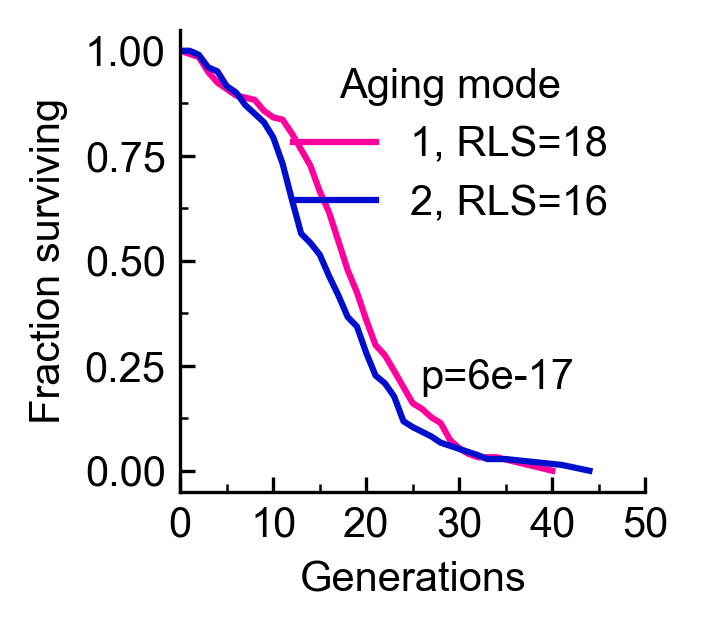

In [12]:
fig, ax = plotting.figure_ax()
fig.set_dpi(300)

mode1_rls = int(survival_df.loc[survival_df.aging_mode==1, 'halflife_kmf'].unique()[0])
mode2_rls = int(survival_df.loc[survival_df.aging_mode==2, 'halflife_kmf'].unique()[0])

kwargs = {
    'x': 'generations_kmf',
    'y': 'fraction_surviving_kmf',
    'hue': 'aging_mode',
    'palette': [other_colors['mode1'], other_colors['mode2']],
    'ax': ax,
    'data': survival_df,
    'hue_order': [1, 2]
}

sns.lineplot(**kwargs)
ax.set_xlim(0, 50)
ax.set_xticks(np.arange(0, 51, 10))
# ax.set_ylim(0, 1.25)
# ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+0.1, 0.5))
plotting.format_ticks(ax)
ax.set_xlabel('Generations')
ax.set_ylabel('Fraction surviving')
ax.legend(ax.get_legend_handles_labels()[0], [f'1, RLS={mode1_rls}', f'2, RLS={mode2_rls}'], title='Aging mode', frameon=False)
# Plot 95% of KMF estimate
# for i, val in enumerate(kwargs['hue_order']):
#     color = kwargs['palette'][i]
#     if 'level_0' in survival_df.columns:
#         survival_df.drop(labels=['level_0'], axis=1, inplace=True)
#     df = survival_df[survival_df[kwargs['hue']]==val].reset_index()
#     ax.fill_between(
#         df.generations_kmf,
#         df['KM_lower_95'],
#         df['KM_upper_95'],
#         color=color,
#         alpha=0.3,
#         edgecolor='white',
        
#         interpolate=True
#     )
# Calculate statistics
# using https://www.kdnuggets.com/2020/07/guide-survival-analysis-python-part-3.html
from lifelines.statistics import logrank_test

args = [
    survival_fit_dfs[0]['rls'],
    survival_fit_dfs[1]['rls']
]

logrankkwargs = {
    'event_observed_A': survival_fit_dfs[0]['rls_observed'],
    'event_observed_B': survival_fit_dfs[1]['rls_observed']
}
results = logrank_test(*args, **logrankkwargs)
results.print_summary()
rounded_p = np.round(results.p_value, int(str(results.p_value)[-2:]))
ax.annotate(f'p={rounded_p}', xy=(0.7, 0.4), xycoords='figure fraction')
plotting.save_figure(fig, kwargs, ext='.svg')

### Full trace Hsp104-mCherry in cells with and without aggregates from single experiment

#### Read in continuous signal data

In [149]:
compartments = [
    '20230201_byc_JPC245_Pre6-GFP_BY4741',
    '20230224_byc_JPC246_Rpt1-GFP_BY4741',
    '20230112_byc_JPC190_PSR',
    '20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry_full-traces'
]

channels = [
    'gfp',
    'gfp',
    'gfp',
    'rfp'
]

sensors = [
    'Pre6-GFP',
    'Rpt1-GFP',
    'Rpn4-driven GFP',
    'HSP104-mCherry'
]
dfs = []
for idx, compname in enumerate(compartments):
    exptname = utilities.exptname_from_compartment(compname)
    compdir = files.get_byc_compartmentdir(exptname, compname)
    tracesdfpath = os.path.join(compdir, f'{exptname}_alldf.csv')
    df = pd.read_csv(tracesdfpath)
    df.loc[:, 'compartment_name'] = compname
    df.loc[:, 'sensor'] = sensors[idx]
    if 'level_0' in df.columns:
        del df['level_0']
    # Create a column with generic fluorescence name
    # so values can be plotted on same axis
    for col in df.columns:
        channel = channels[idx]
        query = f'{channel}_mean'
        if query in col:
            df.loc[:, col.replace(query, 'fluor_mean')] = df.loc[:, col]
    # Calculate a background fluorescence value
    # That will be used for final normalization
    bg_fluor = df.fluor_mean.min()
    df.loc[:, 'fluor_mean_norm_to_pre_sep'] = np.nan
    for cell_index in df.cell_index.unique():
        cellbool = df.cell_index == cell_index
        youngbool = df.dist_from_sen > 5
        val_to_norm = df.loc[cellbool & youngbool, 'fluor_mean'].mean() - bg_fluor
        df.loc[cellbool, 'fluor_mean_norm_to_pre_sep'] = (df.fluor_mean - bg_fluor)/val_to_norm
    dfs.append(df)

tracesdf = pd.concat(dfs).reset_index()
if 'level_0' in tracesdf.columns:
    del tracesdf['level_0']
tracesdf.index = range(len(tracesdf))
tracesdf.loc[:, 'hours_before_last_bud'] = 0 - tracesdf.hours_after_last_bud
# Select out just the Hsp104-mCherry data
hsp104subtracedf = tracesdf[tracesdf.sensor=='HSP104-mCherry']
pre6subtracedf = tracesdf[tracesdf.sensor=='Pre6-GFP']
# Create a master index to use for accurate aggregate 
# appearance annotation
mdfs = []
for subtracedf in [hsp104subtracedf, pre6subtracedf]:
    exptname = subtracedf.exptname.iloc[0]
    compartmentname = subtracedf.compartment_name.iloc[0]
    mdf = utilities.generate_mdf(exptname, compartmentname)
    # Correct annotation of aggregate presence. The trace dataframes
    # get created where only the first timepoint for reach cell is 
    # labelled with contains_aggregate and the rest of the rows are
    # nan. 
    for cell_index in mdf.cell_index.unique():
        contains_agg = mdf.loc[mdf.cell_index==cell_index, 'contains_aggregate'].iloc[0]
        subtracedf.loc[subtracedf.cell_index==cell_index, 'contains_aggregate'] = contains_agg
    mdfs.append(mdf)

Adding paths for channels ['bf', 'rfp', 'yfp']
Adding paths for channels ['bf', 'gfp']


#### Calculate and annotate SEP for each cell in the full trace dataset

In [5]:
def get_bud_rois_path(x):
    df = pd.read_csv(x)
    bud_rois_path = files.abspath_from_relpath(df.bud_roi_set_relpath.iloc[0])
    
    return bud_rois_path

mdf.loc[:, 'bud_rois_df_path'] = [files.abspath_from_relpath(path) for path in mdf.bud_rois_df_relpath]
mdf.loc[:, 'bud_rois_path'] = mdf.bud_rois_df_path.apply(lambda x: get_bud_rois_path(x))

BudDB = database.BudDataBase(mdf[:])
sub_buds_df = BudDB.buddf

sub_buds_df.loc[:, 'bud_frequency_per_hr'] = 1/sub_buds_df.cycle_duration_hrs
sub_buds_df.loc[:, 'buds_after_death'] = 0 - sub_buds_df.dist_from_sen
database.set_bud_id(sub_buds_df)

Len bud_roi_paths = 203
Len xys = 203


Calculate the SEP for each cell in this cohort

In [6]:
%%capture SEP_fitting_output

comps = ['20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry_full-traces']
condition = comps[0]
booldex = (sub_buds_df.compartment_name.isin(comps))&(~sub_buds_df.bud_frequency_per_hr.isna())&(~sub_buds_df.buds_after_death.isna())&(sub_buds_df.cycle_duration_hrs>=1)
bounds_dict = {
    'x0': (-np.inf, 0),
    'y0': (-np.inf, np.inf),
    'k1': (-np.inf, np.inf)
}
# fig = plt.figure()
i = 0
dfs = []
for buddex in sub_buds_df[booldex].compartment_bud_id.unique():
    print(f'Fitting SEP for cell {i+1} of {len(sub_buds_df[booldex].compartment_bud_id.unique())}', end='\r')
    # try:
    if len(sub_buds_df[(sub_buds_df.compartment_bud_id==buddex)&booldex]) > 2:
        cell_index = sub_buds_df.loc[(sub_buds_df.compartment_bud_id==buddex)&booldex, 'cell_index'].iloc[0]
        result, df = fitting_tools.fit_model_to_df(
            sub_buds_df,
            (sub_buds_df.compartment_bud_id==buddex)&booldex,
            fitting_tools.model_guesses.piecewise_linear[0],
            fitting_tools.model_guesses.piecewise_linear[1],
            yvar='bud_frequency_per_hr',
            xvar='buds_after_death',
            bounds_dict=bounds_dict
        )
        df.loc[:, 'compartment_bud_id'] = buddex
        df.loc[:, 'cell_index'] = cell_index
        dfs.append(df)
        sns.set()
        fig, ax = plotting.figure_ax(width_scale=2, height_scale=1.5)
        result.plot_fit(ax=ax)
        # ax.annotate(f'x0={np.round(df.x0.iloc[0], 2)}', xy=(0.3, 0.3), xycoords='figure fraction')
        # ax.annotate(f'x0_stderr={np.round(df.x0_stderr.iloc[0], 2)}', xy=(0.3, 0.25), xycoords='figure fraction')
        ax.set_ylim(0, 1.5)
        plt.tight_layout()
        try:
            plotting.save_figure(fig, {'cell': buddex, 'fit': 'sep_detect'}, ext='.png')
        except Exception as e:
            print(f'Fit failed for buddex {buddex}\nException{e}', end='\r')
        plt.close(fig)
    i += 1
allsepdf = pd.concat(dfs)
filepath = os.path.join(constants.byc_data_dir, f'meta/{condition}_sep_fits.csv')
allsepdf.to_csv(filepath, index=False)

Annotate the SEP calculated above on the traces df

In [7]:
to_add = ['x0', 'x0_stderr', 'x0_stderr_fraction']

for cell_index in allsepdf.cell_index.unique():
    if cell_index in subtracedf.cell_index.unique():
        for col in allsepdf.columns:
            if col in to_add:
                value = allsepdf.loc[allsepdf.cell_index==cell_index, col].iloc[0]
                subtracedf.loc[subtracedf.cell_index==cell_index, col] = value
                sub_buds_df.loc[sub_buds_df.cell_index==cell_index, col] = value
subtracedf.loc[:, 'buds_before_SEP'] = np.abs(np.round(subtracedf.x0, 0)) - subtracedf.dist_from_sen
sub_buds_df.loc[:, 'buds_before_SEP'] = np.abs(np.round(sub_buds_df.x0, 0)) - sub_buds_df.dist_from_sen

bg_fluor = subtracedf.rfp_mean.min()

for cell_index in subtracedf.cell_index.unique():
    cellbool = subtracedf.cell_index == cell_index
    youngbool = subtracedf.buds_before_SEP < 0
    val_to_norm = subtracedf.loc[cellbool & youngbool, 'rfp_mean'].mean() - bg_fluor
    subtracedf.loc[cellbool, 'fluor_mean_norm_to_pre_realsep'] = (subtracedf[cellbool].rfp_mean - bg_fluor)/val_to_norm
    
# Make a summary table with mean fluorescence within each cell division
# to use for pre/post SEP comparison of fluorescence
idx = [
    'sensor',
    'cell_index',
    'dist_from_sen',
    'buds_before_SEP',
    'contains_aggregate'
]

cols = idx + ['fluor_mean_norm_to_pre_sep', 'fluor_mean_norm_to_pre_realsep']
subdf = subtracedf.loc[:, cols].pivot_table(index=idx, aggfunc=np.mean).reset_index()

C:\Users\johnp\AppData\Local\Temp\ipykernel_968\1870766354.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subtracedf.loc[subtracedf.cell_index==cell_index, col] = value
C:\Users\johnp\AppData\Local\Temp\ipykernel_968\1870766354.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subtracedf.loc[subtracedf.cell_index==cell_index, col] = value
C:\Users\johnp\AppData\Local\Temp\ipykernel_968\1870766354.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

### Plot Hsp104-mCherry vs. buds before SEP (normalized to pre real SEP levels)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_before_SEP_y=fluor_mean_norm_to_pre_realsep_hue=contains_aggregate.svg


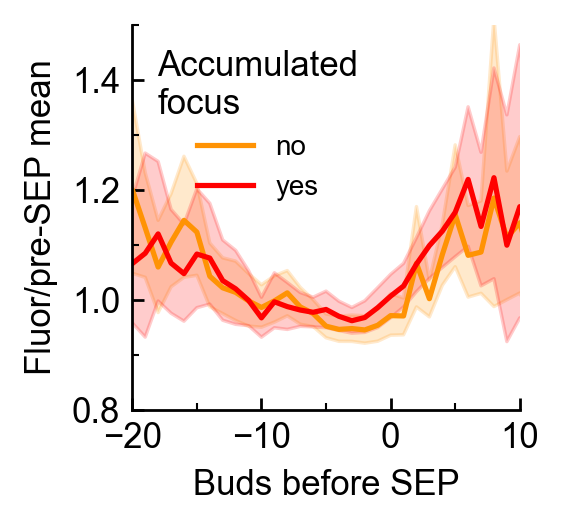

In [11]:
plotting.set_styles(matplotlib, plt)
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'buds_before_SEP',
    'y': 'fluor_mean_norm_to_pre_realsep',
    'data': subdf,
    'ax': ax,
    'hue': 'contains_aggregate',
    'hue_order': ['no', 'yes'],
    'palette': [strains_color_dict['JPC121'], 'red']
}

sns.lineplot(**kwargs)
ax.set_ylabel('Fluor/pre-SEP mean')
ax.set_xlabel('Buds before SEP')
ax.set_xlim(-20, 10)
# ax.set_xticks(np.arange(0, 21, 5))
ax.set_ylim(0.8, 1.5)

ax.legend(ax.get_legend_handles_labels()[0], ['no', 'yes'], title='Accumulated\nfocus', frameon=False, fontsize=8)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

### Proportion of cells that do and do not accumulate Hsp104-mCherry focus during RLS

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\y=contains_aggregate_bool_x=cell_index_hue=contains_aggregate_bool_dodge=False_orient=horizontal.svg


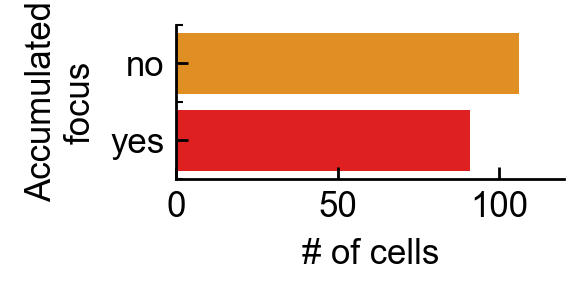

In [93]:
cols = [
    'contains_aggregate_bool',
]

idx = [
    'cell_index'
]

subdf.loc[subdf.contains_aggregate=='yes', 'contains_aggregate_bool'] = True
subdf.loc[subdf.contains_aggregate=='no', 'contains_aggregate_bool'] = False

cols = cols + idx

table = subdf.loc[:, cols].groupby(idx).median().reset_index()
summarytable = table.groupby('contains_aggregate_bool').cell_index.count().reset_index()

fig, ax = plotting.figure_ax(width_scale=1, height_scale=0.4)
kwargs = {
    'y': 'contains_aggregate_bool',
    'x': 'cell_index',
    'hue': 'contains_aggregate_bool',
    'data': summarytable,
    'ax': ax,
    'palette': [strains_color_dict['JPC121'], 'red'],
    'hue_order': [0., 1.],
    'dodge': False,
    'orient': 'horizontal',
}

sns.barplot(**kwargs)

ax.legend(
    ax.get_legend_handles_labels()[0],
    ax.get_legend_handles_labels()[1],
    title='Accumulated\nfocus',
    frameon=False,
    bbox_to_anchor=(1, 2), bbox_transform=fig.transFigure, fontsize=7)
ax.legend_.set_visible(False)
ax.set_xlabel('# of cells')
ax.set_ylabel('Accumulated\nfocus')
ax.set_xlim(0, 120)
ax.set_yticklabels(['no', 'yes'])
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### RLS in cells that did or did not accumulate an Hsp104-mCherry focus during RLS

<Axes: xlabel='contains_aggregate', ylabel='bud_number'>

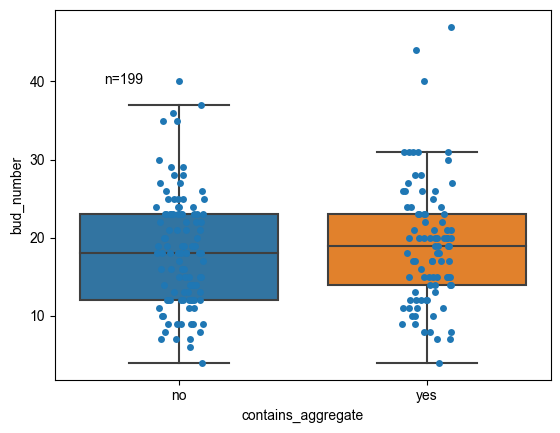

In [305]:
ax = plt.axes()

aggdex = [
    'end_event_type',
    'cell_index',
    'contains_aggregate'
]
stable = subtracedf.groupby(aggdex, as_index=False).bud_number.max()
kwargs = {
    'x': 'contains_aggregate',
    'y': 'bud_number', 
    'data': stable[stable.end_event_type=='death'],
    'ax': ax
}
n = len(kwargs['data'])
ax.annotate(f'n={n}', xy=(0.1, 0.8), xycoords=('axes fraction'))
sns.boxplot(**kwargs, showfliers=False)
sns.stripplot(**kwargs)

In [315]:
fit_dict.keys()

dict_keys(['y_kmf', 'x_kmf', 'x_wbf', 'y_wbf', 'kmf', 'wbf', 'kmf_halflife', 'wbf_halflife', 'n_cells', 'kmf_fit_object', 'wbf_fit_object'])

In [306]:
from byc import fitting_tools as ft
if 'bud_number' in stable.columns:
    stable.rename(columns={'bud_number': 'rls'}, inplace=True)
else:
    pass
stable.loc[stable.end_event_type=='death', 'rls_observed'] = True
stable.loc[stable.end_event_type=='escape', 'rls_observed'] = False
stable = stable.astype({'rls_observed': bool})                                     

fits_dict = {}
fitdfs = []
for agg in ['no', 'yes']:
    fit_dict = ft.survival_fit(stable[stable.contains_aggregate==agg])
    fits_dict[agg] = fit_dict
    dfdict = {
            'x_kmf': np.array(fit_dict['x_kmf']),
            'y_kmf': np.array(fit_dict['y_kmf']).flatten(),
        }
    df = pd.DataFrame(dfdict)
    df.loc[:, 'contains_aggregate'] = agg
    # Add data to the full df and table with row
    # per compartment
    for key in ['kmf_halflife', 'wbf_halflife', 'n_cells']:
        df.loc[:, key] = fit_dict[key]
        table.loc[i, key] = fit_dict[key]
    # Add data from the original dataframe and the row
    # per compartment table
    for col in stable[stable.contains_aggregate==agg].columns:
        if len(stable[stable.contains_aggregate==agg][col].unique()) == 1:
            df.loc[:, col] = stable[stable.contains_aggregate==agg][col].unique()[0]
    fitdfs.append(df)
survivaldf = pd.concat(fitdfs)

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.70 0.40      1.31

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_kmf_y=y_kmf_hue=contains_aggregate.svg


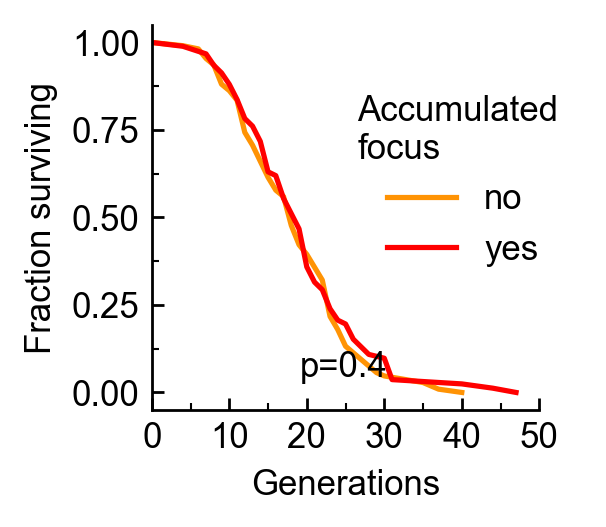

In [325]:
fig, ax = plotting.figure_ax()
xlim = (0, 50)
kwargs = {
    'x': 'x_kmf',
    'y': 'y_kmf',
    'data': survivaldf,
    'ax': ax,
    'hue': 'contains_aggregate',
    'palette': [plotting.strains_color_dict['JPC121'], 'red']
}

# sns.scatterplot(**kwargs, s=10)
sns.lineplot(**kwargs)
ax.set_xlabel('Generations')
ax.set_ylabel('Fraction surviving')
ax.legend(ax.get_legend_handles_labels()[0], ax.get_legend_handles_labels()[1],
          title='Accumulated \nfocus', frameon=False, bbox_to_anchor=(0.45, 0.9))
ax.set_xlim(xlim)
ax.set_xticks(np.arange(np.min(xlim), np.max(xlim)+1, 10))
plotting.format_ticks(ax)

from lifelines.statistics import logrank_test
survivaldfs = [stable[stable.contains_aggregate=='yes'], stable[stable.contains_aggregate=='no']]
args = [
    survivaldfs[0]['rls'],
    survivaldfs[1]['rls']
]

logrankkwargs = {
    'event_observed_A': survivaldfs[0]['rls_observed'],
    'event_observed_B': survivaldfs[1]['rls_observed']
}
results = logrank_test(*args, **logrankkwargs)
results.print_summary()
rounded_p = np.round(results.p_value, 2)
ax.annotate(f'p={rounded_p}', xy=(0.6, 0.3), xycoords='figure fraction')
plotting.save_figure(fig, kwargs, ext='.svg')

### Plot Hsp104-mCherry vs. hours before senescence vs. aggregate presence during RLS

Adding paths for channels ['bf', 'rfp', 'yfp']
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=hours_after_last_bud_y=fluor_mean_norm_to_pre_sep_hue=contains_aggregate.svg


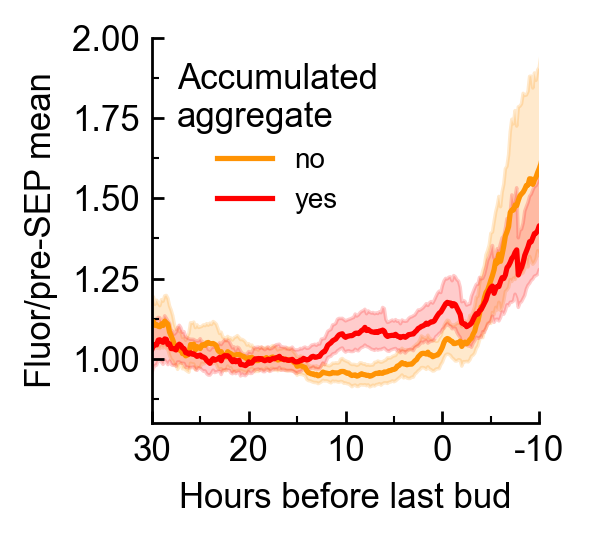

In [79]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'hours_after_last_bud',
    'y': 'fluor_mean_norm_to_pre_sep',
    'data': subtracedf,
    'ax': ax,
    'hue': 'contains_aggregate',
    'hue_order': ['no', 'yes'],
    'palette': [strains_color_dict['JPC121'], 'red']
}

sns.lineplot(**kwargs)
ax.set_ylabel('Fluor/pre-SEP mean')
ax.set_xlabel('Hours before last bud')
ax.set_xlim(-30, 10)
ax.set_xticks(np.arange(-30, 11, 10))
xticks = [int(val) for val in np.arange(-10, 31, 10)]
xticks.reverse()
ax.set_xticklabels(xticks)
ax.set_ylim(0.8, 2)

plotting.format_ticks(ax)
ax.legend(ax.get_legend_handles_labels()[0], ['no', 'yes'], title='Accumulated\naggregate', frameon=False, fontsize=8)
plotting.save_figure(fig, kwargs, ext='.svg')

### Plot Hsp104-mCherry vs. buds before senescence vs. aggregate presence during RLS

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=fluor_mean_norm_to_pre_sep_hue=contains_aggregate.svg


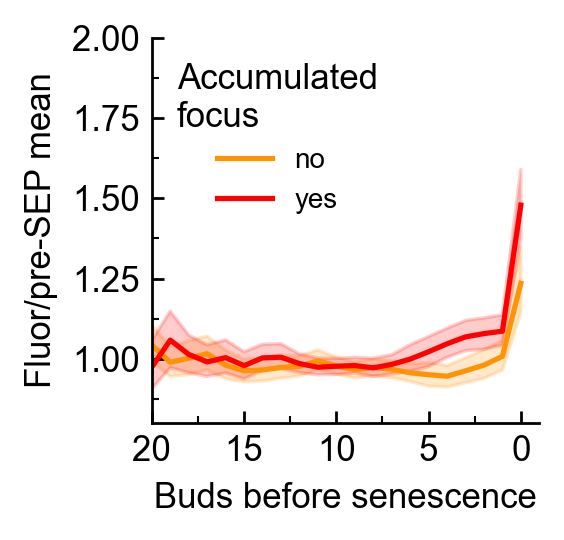

In [83]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'dist_from_sen',
    'y': 'fluor_mean_norm_to_pre_sep',
    'data': subdf,
    'ax': ax,
    'hue': 'contains_aggregate',
    'hue_order': ['no', 'yes'],
    'palette': [strains_color_dict['JPC121'], 'red']
}

sns.lineplot(**kwargs)
ax.set_ylabel('Fluor/pre-SEP mean')
ax.set_xlabel('Buds before senescence')
ax.set_xlim(20, -1)
ax.set_xticks(np.arange(0, 21, 5))
ax.set_ylim(0.8, 2)

ax.legend(ax.get_legend_handles_labels()[0], ['no', 'yes'], title='Accumulated\nfocus', frameon=False, fontsize=8)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

### Strip plot of Hsp104-mCherry vs. before and after individually fit SEP vs. aggregate presence

yes_False vs. yes_True: Mann-Whitney-Wilcoxon test two-sided, P_val:2.984e-16 U_stat=2.375e+05
no_False vs. no_True: Mann-Whitney-Wilcoxon test two-sided, P_val:5.153e-09 U_stat=2.996e+05
no_True vs. yes_True: Mann-Whitney-Wilcoxon test two-sided, P_val:2.560e-03 U_stat=1.411e+05
Pre6-GFP fold change young over old=nan
Pre6-GFP fold change old over young=nan
Rpt1-GFP fold change young over old=nan
Rpt1-GFP fold change old over young=nan
Rpn4-driven GFP fold change young over old=nan
Rpn4-driven GFP fold change old over young=nan
HSP104-mCherry fold change young over old=0.9114579229360148
HSP104-mCherry fold change old over young=1.0971433511475448
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=contains_aggregate_y=fluor_mean_norm_to_pre_realsep_hue=post_SEP_dodge=True.svg


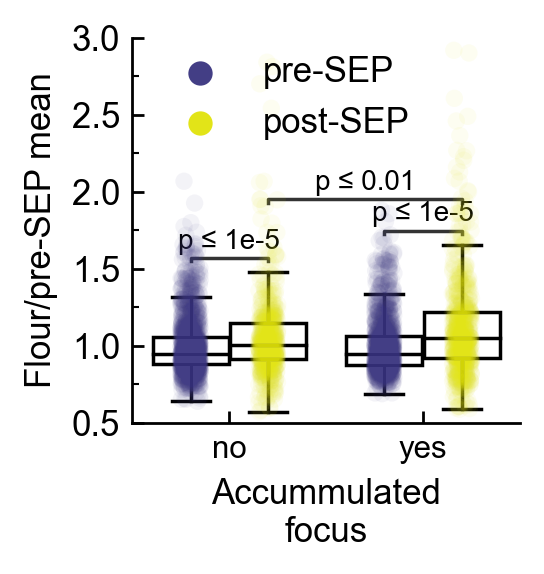

In [304]:
subdf.loc[:, 'post_SEP'] = np.nan
subdf.loc[subdf.buds_before_SEP>0, 'post_SEP'] = True
subdf.loc[subdf.buds_before_SEP<0, 'post_SEP'] = False
fig, ax = plotting.figure_ax(width_scale=1)
kwargs = {
    'x': 'contains_aggregate',
    'y': 'fluor_mean_norm_to_pre_realsep',
    'hue': 'post_SEP',
    'data': subdf,
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': ['no', 'yes'],
    'hue_order': [False, True]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
hue_order = kwargs['hue_order']
box_pairs=[
    (('no', True), ("no", False)),
    (("yes", True), ("yes", False)),
    (("no", True), ("yes", True))
]
test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,hue_order=hue_order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=8)
annotator.apply_and_annotate()

sns.stripplot(**kwargs, alpha=0.06)
# ax.set_ylim(0.9, 1.3)
# ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 2))
ax.set_ylabel('Flour/pre-SEP mean')
ax.set_xlabel('')
ax.set_xticklabels(ax.get_xticklabels(), fontsize=9)
ax.set_ylim(0.5, 3)
for sensor in sensors:
    slicedf = subdf[subdf.sensor==sensor]
    fold_change = slicedf.loc[subdf.post_SEP==False, 'fluor_mean_norm_to_pre_sep'].mean()/slicedf.loc[subdf.post_SEP==True, 'fluor_mean_norm_to_pre_sep'].mean()
    fold_change_old_over_young = 1/fold_change
    print(f'{sensor} fold change young over old={fold_change}')
    print(f'{sensor} fold change old over young={fold_change_old_over_young}')
# ax.set_xticklabels([f'>={np.round(upper, 2)}', f'<{np.round(lower, 2)}'])
ax.set_xlabel(f'Accummulated\nfocus')
plotting.format_ticks(ax, add_minor_x=False)
ax.legend(
    ax.get_legend_handles_labels()[0][2:4],
    ['pre-SEP', 'post-SEP'],
    title='', frameon=False,
    loc=(0.05, 0.7))
plotting.save_figure(fig, kwargs, ext='.svg')

### Strip plot of Hsp104-mCherry vs. before and after universal SEP of 5 vs. aggregate presence

ValueError: Could not interpret input 'fluor_mean_norm_to_pre_sep'

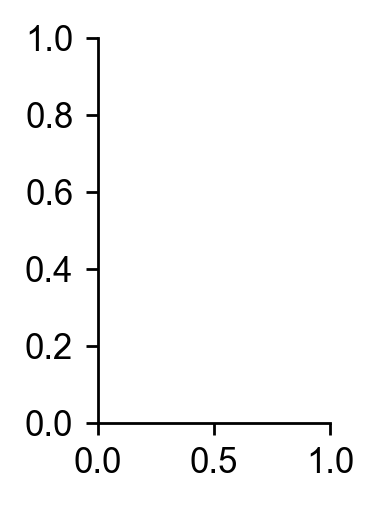

In [227]:
subdf.loc[:, 'post_sep'] = np.nan
subdf.loc[subdf.dist_from_sen<5, 'post_sep'] = True
subdf.loc[subdf.dist_from_sen>5, 'post_sep'] = False
fig, ax = plotting.figure_ax(width_scale=0.6)
kwargs = {
    'x': 'contains_aggregate',
    'y': 'fluor_mean_norm_to_pre_sep',
    'hue': 'post_sep',
    'data': subdf,
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': ['no', 'yes'],
    'hue_order': [False, True]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
hue_order = kwargs['hue_order']
box_pairs=[
    (('no', True), ("no", False)),
    (("yes", True), ("yes", False)),
    (("no", True), ("yes", True))
]
test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,hue_order=hue_order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=8)
annotator.apply_and_annotate()

sns.stripplot(**kwargs, alpha=0.06)
# ax.set_ylim(0.9, 1.3)
# ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 2))
ax.set_ylabel('Flour/pre-SEP mean')
ax.set_xlabel('')
ax.set_xticklabels(ax.get_xticklabels(), fontsize=9)
ax.set_ylim(0.5, 3)
for sensor in sensors:
    slicedf = subdf[subdf.sensor==sensor]
    fold_change = slicedf.loc[subdf.post_sep==False, 'fluor_mean_norm_to_pre_sep'].mean()/slicedf.loc[subdf.post_sep==True, 'fluor_mean_norm_to_pre_sep'].mean()
    fold_change_old_over_young = 1/fold_change
    print(f'{sensor} fold change young over old={fold_change}')
    print(f'{sensor} fold change old over young={fold_change_old_over_young}')
# ax.set_xticklabels([f'>={np.round(upper, 2)}', f'<{np.round(lower, 2)}'])
ax.set_xlabel(f'Accummulated\nfocus')
plotting.format_ticks(ax, add_minor_x=False)
ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5', '<5'], title='Buds before\nsenescence', frameon=False, bbox_to_anchor=(1, 1))
plotting.save_figure(fig, kwargs, ext='.svg')

### k vs. buds before death vs. aggregate presence

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=b_hue=contains_aggregate.svg


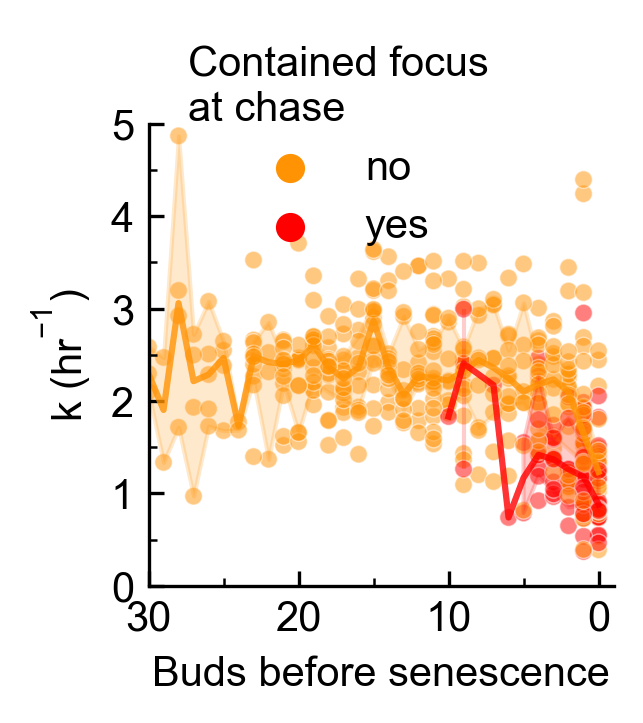

In [227]:
compartments = constants.compartments_dict['wt_rkk']
sub_fits_df = fits_df.loc[fits_df.compartment_name.isin(compartments), :]
sub_fits_df = sub_fits_df[sub_fits_df.dist_from_sen>=0]
sub_buds_df = buds_df.loc[buds_df.compartment_name.isin(compartments), :]
sub_buds_df = sub_buds_df[sub_buds_df.dist_from_sen>=0]

# Annotate each cell in sub_buds_df with whether it contained an aggregate at chase
# and also drop sub_buds_df
sub_buds_df.loc[:, 'contains_aggregate'] = np.nan
for celldex in sub_buds_df.compartment_bud_id.unique():
    if celldex in sub_fits_df.compartment_bud_id.unique():
        vals = sub_fits_df.loc[sub_fits_df.compartment_bud_id==celldex, 'contains_aggregate'].values
        if len(vals) > 1:
            if 'yes' in vals:
                sub_buds_df.loc[sub_buds_df.compartment_bud_id==celldex, 'contains_aggregate'] = 'yes'
                # print(vals, 'set to yes')
            elif 'no' in vals:
                sub_buds_df.loc[sub_buds_df.compartment_bud_id==celldex, 'contains_aggregate'] = 'no'
                # print(vals, 'set to no')
            else:
                sub_buds_df.loc[sub_buds_df.compartment_bud_id==celldex, 'contains_aggregate'] = np.nan
                # print(vals, 'set to nan')
        elif len(vals) == 1:
            sub_buds_df.loc[sub_buds_df.compartment_bud_id==celldex, 'contains_aggregate'] = vals[0]
            # print(vals)
            # print(f'One chase, set to {vals[0]}')

fig, ax = plotting.figure_ax()
fig.set_dpi(300)

kwargs = {
    'x': 'dist_from_sen',
    'y': 'b',
    'hue': 'contains_aggregate',
    'ax': ax,
    'data': sub_fits_df[~sub_fits_df.contains_aggregate.isna()],
    'palette': [strains_color_dict['JPC121'], 'red'],
}

sns.scatterplot(**kwargs, alpha=0.5, size=15)
sns.lineplot(**kwargs, alpha=0.8, estimator=np.median)
ax.legend(
    ax.get_legend_handles_labels()[0][0:2],
    ['no', 'yes'], title='Contained focus\nat chase',
    frameon=False,
    loc=(0.05, 0.7)
)
ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+.1, 1))
plotting.format_ticks(ax)
ax.set_xlabel('Buds before senescence')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)

# ax2 = ax.twinx()
# kwargs = {
#     'x': 'dist_from_sen',
#     'y': 'cycle_duration_hrs',
#     'hue': 'contains_aggregate',
#     'data': sub_buds_df,
#     'ax': ax2,
#     'palette': kwargs['palette'],
#     'hue_order': ['no', 'yes'],
#     'linestyle': '--'
# }

# sns.lineplot(**kwargs)
# ax2.set_ylim(0, 5)
# ax2.spines['top'].set_visible(False)
# ax2.legend_.set_visible(False)
# ax2.set_ylabel('Cyle duration (hrs.)')
# plotting.format_ticks(ax2)

plotting.save_figure(fig, kwargs, ext='.svg')

In [228]:
aggdex = [
    'produced_elongated_daughters',
    'contains_aggregate',
    'rls_observed',
    'compartment_bud_id',
    'end_event_type',
    'rls_suitable',
    'potential_blue_light_exposure_during_filter_cube_switching',
    'pre-load-vortex',
    'pre-load-spin',
    'first_bud_frame'
]
wanted_cols = [col for col in sub_fits_df.columns if sub_fits_df[col].dtype != 'O']
cols_to_add = [col for col in aggdex if col not in wanted_cols]
wanted_cols = wanted_cols + cols_to_add
cell_table = sub_fits_df.loc[:, wanted_cols].pivot_table(index=aggdex, aggfunc=np.median).reset_index()
cell_table.loc[cell_table.first_bud_frame<=18, 'observed_since_start'] = True
cell_table.loc[cell_table.first_bud_frame>18, 'observed_since_start'] = False

### Cell cycle duration vs buds before senescence and aggregate presence at chase

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=cycle_duration_hrs_hue=contains_aggregate_linestyle=--.svg


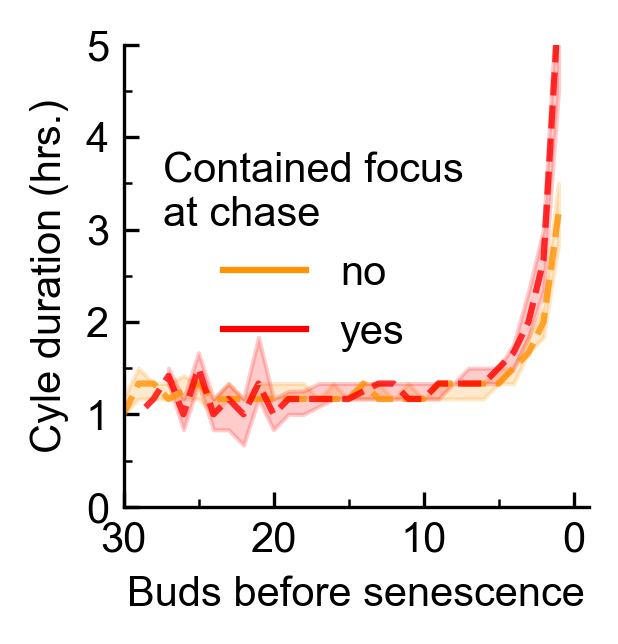

In [154]:
fig, ax = plotting.figure_ax()
fig.set_dpi(300)

kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'hue': 'contains_aggregate',
    'data': sub_buds_df,
    'ax': ax,
    'palette': kwargs['palette'],
    'hue_order': ['no', 'yes'],
    'linestyle': '--'
}

# sns.scatterplot(**kwargs, alpha=0.5, size=15)
sns.lineplot(**kwargs, alpha=0.8, estimator=np.median)
ax.legend(
    ax.get_legend_handles_labels()[0][0:2],
    ['no', 'yes'], title='Contained focus\nat chase',
    frameon=False,
    loc=(0.05, 0.3)
)
ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+.1, 1))
plotting.format_ticks(ax)
ax.set_xlabel('Buds before senescence')
ax.set_ylabel('Cyle duration (hrs.)')

plotting.save_figure(fig, kwargs, ext='.svg')

### k vs. buds before SEP vs. aggregate presence

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_before_SEP_y=b_hue=contains_aggregate.svg


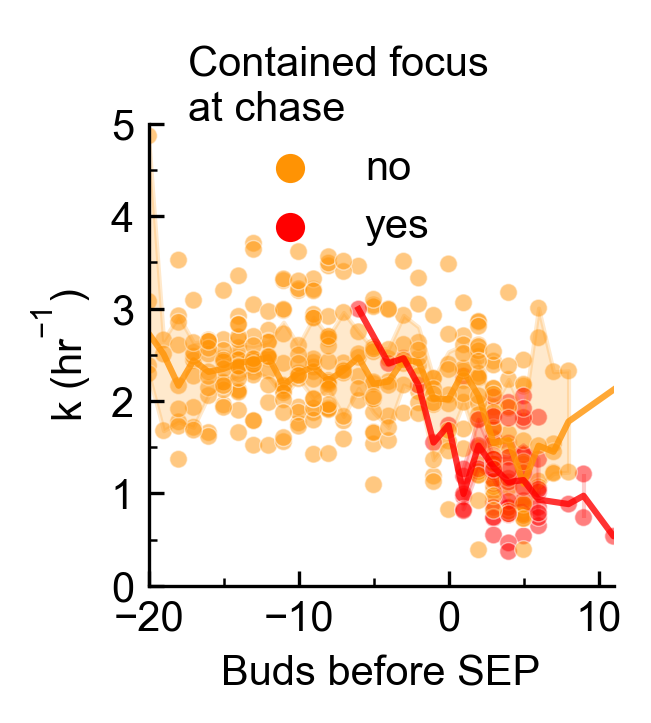

In [229]:
fig, ax = plotting.figure_ax()
fig.set_dpi(300)

kwargs = {
    'x': 'buds_before_SEP',
    'y': 'b',
    'hue': 'contains_aggregate',
    'ax': ax,
    'data': sub_fits_df[~sub_fits_df.contains_aggregate.isna()],
    'palette': [strains_color_dict['JPC121'], 'red'],
}

sns.scatterplot(**kwargs, alpha=0.5, size=15)
sns.lineplot(**kwargs, alpha=0.8, estimator=np.median)
ax.legend(
    ax.get_legend_handles_labels()[0][0:2],
    ['no', 'yes'], title='Contained focus\nat chase',
    frameon=False,
    loc=(0.05, 0.7))
ax.set_xlim(-20, 11)
ax.set_xticks(np.arange(np.min(ax.get_xlim()), np.max(ax.get_xlim())+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+.1, 1))
plotting.format_ticks(ax)
ax.set_xlabel('Buds before SEP')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)

# ax2 = ax.twinx()
# kwargs = {
#     'x': 'buds_before_SEP',
#     'y': 'cycle_duration_hrs',
#     'hue': 'contains_aggregate',
#     'data': sub_buds_df,
#     'ax': ax2,
#     'palette': kwargs['palette'],
#     'hue_order': ['no', 'yes'],
#     'linestyle': '--'
# }

# sns.lineplot(**kwargs)
# ax2.set_ylim(0, 8)
# ax2.spines['top'].set_visible(False)
# ax2.legend_.set_visible(False)
# ax2.set_ylabel('Cyle duration (hrs.)')
# plotting.format_ticks(ax2)

plotting.save_figure(fig, kwargs, ext='.svg')

### Cell cycle duration vs buds before SEP and aggregate presence at chase

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_before_SEP_y=cycle_duration_hrs_hue=contains_aggregate_linestyle=--.svg


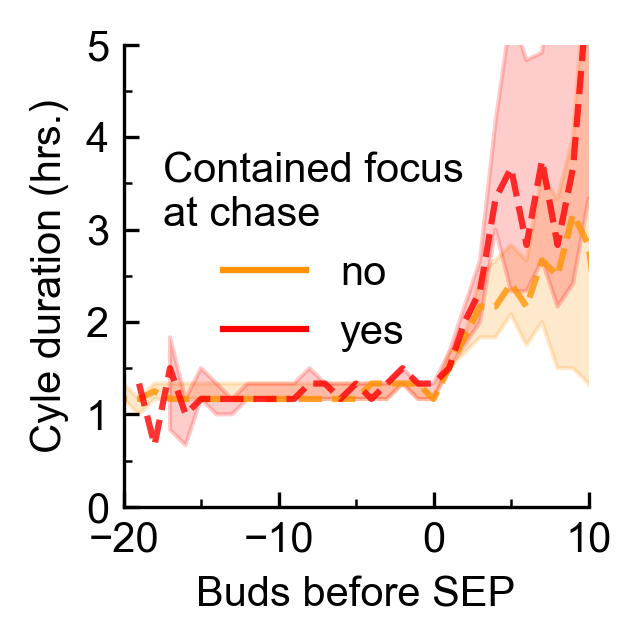

In [61]:
fig, ax = plotting.figure_ax()
fig.set_dpi(300)

kwargs = {
    'x': 'buds_before_SEP',
    'y': 'cycle_duration_hrs',
    'hue': 'contains_aggregate',
    'data': sub_buds_df,
    'ax': ax,
    'palette': kwargs['palette'],
    'hue_order': ['no', 'yes'],
    'linestyle': '--'
}

# sns.scatterplot(**kwargs, alpha=0.5, size=15)
sns.lineplot(**kwargs, alpha=0.8, estimator=np.median)
ax.legend(
    ax.get_legend_handles_labels()[0][0:2],
    ['no', 'yes'], title='Contained focus\nat chase',
    frameon=False,
    loc=(0.05, 0.3)
)
ax.set_xlim(-20, 10)
ax.set_xticks(np.arange(np.min(ax.get_xlim()), np.max(ax.get_xlim())+0.1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+.1, 1))
plotting.format_ticks(ax)
ax.set_xlabel('Buds before SEP')
ax.set_ylabel('Cyle duration (hrs.)')

plotting.save_figure(fig, kwargs, ext='.svg')

### Strip and box plots of pre-sep-normalized k before and after SEP vs aggregate presence at chase

yes_True vs. yes_False: Mann-Whitney-Wilcoxon test two-sided, P_val:2.662e-06 U_stat=2.990e+02
no_True vs. no_False: Mann-Whitney-Wilcoxon test two-sided, P_val:7.664e-12 U_stat=1.530e+04
no_False vs. yes_False: Mann-Whitney-Wilcoxon test two-sided, P_val:5.027e-08 U_stat=4.782e+03
no fold change young over old=1.338 +/- 0.08
no fold change old over young=0.747 +/- 0.08
no fold change old over young with or without agg=0.759 +/- 0.0766096195932708
Rate constant for no aggregate pre-SEP=2.371 +/- 0.036
Rate constant for no aggregate post-SEP=1.773 +/- 0.071
yes fold change young over old=1.946 +/- 0.24
yes fold change old over young=0.514 +/- 0.24
yes fold change old over young with or without agg=0.51 +/- 0.057882833084725416
Rate constant for yes aggregate pre-SEP=2.317 +/- 0.234
Rate constant for yes aggregate post-SEP=1.19 +/- 0.05
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=contains_aggregate_y=b_over_real_pre_sep_median_hue=pre_SEP_dodge=True.svg


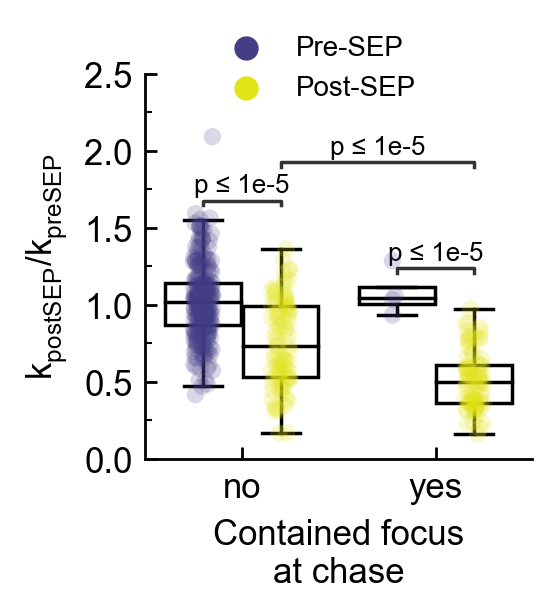

In [230]:
fig, ax = plotting.figure_ax(width_scale=1)
# Normalize to pre/post SEP median
for substrate in sub_fits_df.substrate.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.pre_SEP==True)&(sub_fits_df.substrate==substrate), 'b'].median()
    sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median

    kwargs = {
    'x': 'contains_aggregate',
    'y': 'b_over_real_pre_sep_median',
    'hue': 'pre_SEP',
    'data': sub_fits_df[~sub_fits_df.post_sep.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': ['no', 'yes'],
    'hue_order': [True, False]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
hue_order = kwargs['hue_order']
box_pairs=[
    (('no', True), ("no", False)),
    (("yes", True), ("yes", False)),
    (("yes", False), ("no", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order, hue_order=hue_order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 2.5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.5))
ax.set_ylabel(plotting.annoying_strings().k_old_over_young)
ax.set_xlabel('Contained focus\nat chase')
for agg_pres in ['no', 'yes']:
    subdf = sub_fits_df[sub_fits_df.contains_aggregate==agg_pres]
    data1 = subdf.loc[subdf.pre_SEP==True, 'b']
    data2 = subdf.loc[subdf.pre_SEP==False, 'b']
    data_all_pre_SEP = sub_fits_df.loc[sub_fits_df.pre_SEP==True, 'b']
    fold_change = np.round(data1.mean()/data2.mean(), 3)
    fold_change_from_all_pre_SEP_1 = np.round(data1.mean()/data_all_pre_SEP.mean(), 3)
    fold_change_from_all_pre_SEP_2 = np.round(data2.mean()/data_all_pre_SEP.mean(), 3)
    fold_change_from_all_pre_SEP = np.round(sub_fits_df.b.mean()/data_all_pre_SEP.mean(), 3)
    # Stats for old vs. young within yes/no aggregates
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    fold_change_old_over_young = np.round(1/fold_change, 3)
    fold_change_old_over_all_young = np.round(1/fold_change_from_all_pre_SEP, 3)
    # Stats for old vs. young when young means any cell with or without an aggregate
    # at the chase
    SEM_from_all_pre_SEP =np.std(data_all_pre_SEP, ddof=1) / np.sqrt(np.size(data_all_pre_SEP))
    SEM_of_fold_change_from_all_pre_SEP_1_over_preSEP = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM_from_all_pre_SEP, 2)]))
    SEM_of_fold_change_from_all_pre_SEP_2_over_preSEP = np.sqrt(np.sum([np.power(SEM2, 2), np.power(SEM_from_all_pre_SEP, 2)]))
    print(f'{agg_pres} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{agg_pres} fold change old over young={fold_change_old_over_young} +/- {SEM_of_fold_change}')
    print(f'{agg_pres} fold change old over young with or without agg={fold_change_from_all_pre_SEP_2} +/- {SEM_of_fold_change_from_all_pre_SEP_2_over_preSEP}')
    print(f'Rate constant for {agg_pres} aggregate pre-SEP={np.round(data1.mean(), 3)} +/- {np.round(data1.sem(), 3)}')
    print(f'Rate constant for {agg_pres} aggregate post-SEP={np.round(data2.mean(), 3)} +/- {np.round(data2.sem(), 3)}')
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['Pre-SEP', 'Post-SEP'],
                   title='',
                   frameon=False,
                   fontsize=legfontsize,
                   loc=(0.16, 0.9))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Looking for cells that had multiple cell divisions after aggregate formed to see if the daughter cell inherits the aggregate

In [66]:
sub_fits_df.loc[
    (sub_fits_df.dist_from_sen.between(1, 6)) & (sub_fits_df.contains_aggregate=='yes'),
    ['compartment_name', 'xy', 'cell_index', 'dist_from_sen']
].sort_values(by='dist_from_sen', ascending=False)

,compartment_name,xy,cell_index,dist_from_sen
397,20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,1.0,26.0,6.0
613,20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,2.0,123.0,5.0
814,20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry,2.0,102.0,5.0
835,20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry,2.0,96.0,4.0
544,20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,2.0,88.0,4.0
381,20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,0.0,17.0,4.0
538,20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,4.0,175.0,4.0
422,20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,4.0,193.0,4.0
413,20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,2.0,81.0,4.0
403,20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry,0.0,9.0,4.0


### Strip plot of k vs. pre/post SEP vs. aggregate presence

yes_False vs. yes_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.679e-01 U_stat=3.460e+02
no_False vs. no_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:3.123e-10 U_stat=2.023e+04
no_False vs. yes_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:5.974e-01 U_stat=1.148e+03
no_True vs. yes_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:4.212e-07 U_stat=5.595e+03
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=contains_aggregate_y=b_hue=post_sep_dodge=True.svg
no over yes = 1.4698388637866278
yes over no = 0.6803466860467823


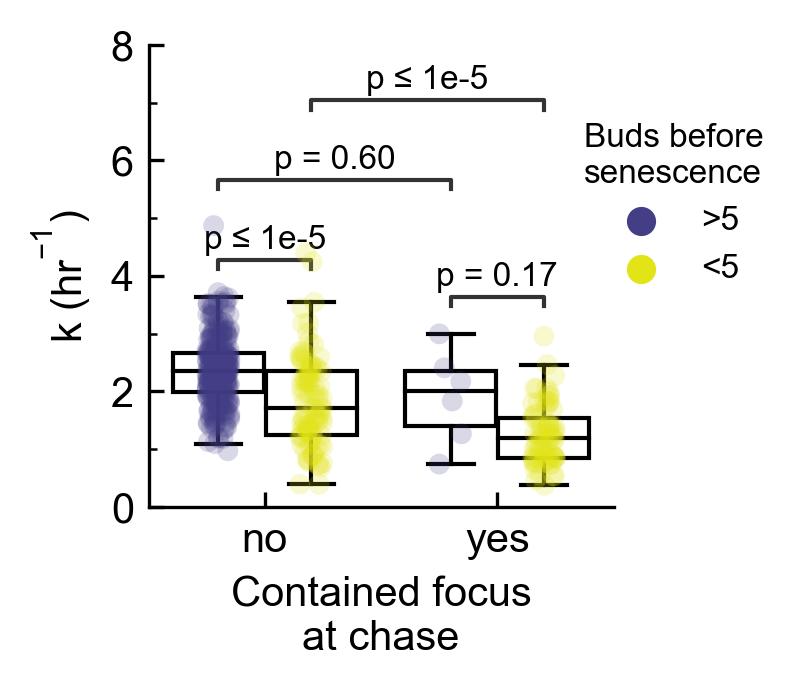

In [76]:
fig, ax = plotting.figure_ax(width_scale=1)
fig.set_dpi(300)

sub_fits_df.loc[sub_fits_df.dist_from_sen<5, 'post_sep'] = True
sub_fits_df.loc[sub_fits_df.dist_from_sen>5, 'post_sep'] = False

# ax.set_ylim(0, 4)

kwargs = {
    'x': 'contains_aggregate',
    'y': 'b',
    'hue': 'post_sep',
    'ax': ax,
    'data': sub_fits_df[sub_fits_df.b<=5],
    'palette': plotting.get_pre_post_sep_palette(),
    'hue_order': [False, True],
    'dodge': True,
    'order': ['no', 'yes']
}
# Plot stuff
sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict,
           showfliers=False)
ax.set_ylim(0, 8)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('yes', True), ('yes', False)),
    (('no', True), ('no', False)),
    (('yes', False), ('no', False)),
    (('yes', True), ('no', True))
]
test='Mann-Whitney'
text_format="full"
text_format='simple'
loc="inside"
annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order, hue_order=kwargs['hue_order'])
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=8,
                   comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Strip plot after the stats annotation so that the bars
# don't adjust to the top dot
sns.stripplot(**kwargs, alpha=0.2)

ax.legend(
    ax.get_legend_handles_labels()[0][2:4],
    ['>5', '<5'],
    title='Buds before\nsenescence',
    frameon=False,
    fontsize=8,
    title_fontsize=8,
    bbox_to_anchor=(0.8, 0.8), bbox_transform=fig.transFigure
)

ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
# ax.legend_.set_visible(False)
plotting.format_ticks(ax, add_minor_x=False)
ax.set_xticklabels(['no', 'yes'])
ax.set_xlabel('Contained focus\nat chase')
plotting.save_figure(fig, kwargs, ext='.svg')
# Print out fold change difference in post-SEP populations
df = kwargs['data']
xvar = kwargs['x']
yvar = kwargs['y']
huevar = kwargs['hue']
# hue will pretty much always be post_sep
xval1 = df[~df[xvar].isna()][xvar].unique()[0]
xval2 = df[~df[xvar].isna()][xvar].unique()[1]
mean1 = df.loc[(df[huevar]==True)&(df[xvar]==xval1), yvar].mean()
mean2 = df.loc[(df[huevar]==True)&(df[xvar]==xval2), yvar].mean()
print(f'{xval1} over {xval2} = {mean1/mean2}')
print(f'{xval2} over {xval1} = {mean2/mean1}')
# ax.set_ylim(0, 5)

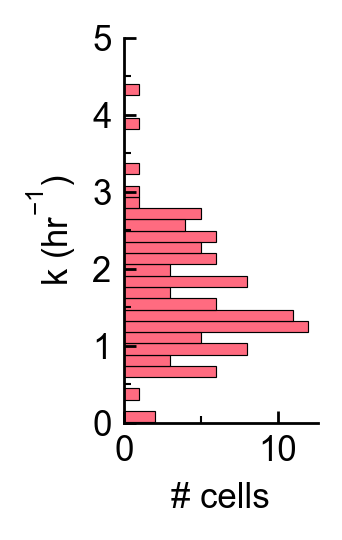

In [68]:
fig, ax = plotting.figure_ax(width_scale=0.5)

kwargs = {
    'y': 'b',
    'data': sub_fits_df[(sub_fits_df.post_sep==True) & (sub_fits_df.contains_aggregate=='no')],
    'ax': ax,
    'color': ratecolor,
    'bins': 30
}

sns.histplot(**kwargs)

ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlabel('# cells')
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

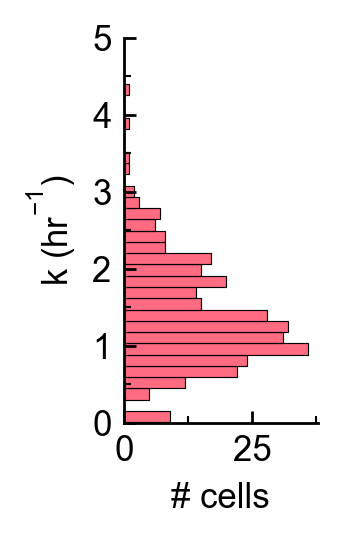

In [69]:
fig, ax = plotting.figure_ax(width_scale=0.5)

kwargs = {
    'y': 'b',
    'data': sub_fits_df[(sub_fits_df.post_sep==True)],
    'ax': ax,
    'color': ratecolor,
    'bins': 30
}

sns.histplot(**kwargs)

ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlabel('# cells')
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

### Between mode 1 and mode 2, who is more likely to contain an aggregate?

p=3.752525763446708e-05
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\y=produced_elongated_daughters_x=counts_hue=contains_aggregate_dodge=False_orient=horizontal.svg


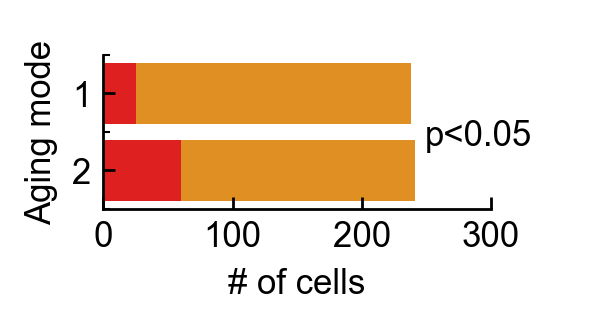

In [18]:
fig, ax = plotting.figure_ax(width_scale=1, height_scale=0.4)
subdf = sub_fits_df[~sub_fits_df.contains_aggregate.isna()]
cols = [
    'contains_aggregate',
    'produced_elongated_daughters',
    'b',
]

aggdex = [
    'produced_elongated_daughters',
    'contains_aggregate',
]
pivottable = subdf.loc[:, cols].pivot_table(index=aggdex, aggfunc='count').reset_index()
from statsmodels.stats.proportion import proportions_ztest
total_mode_1 = pivottable.set_index('produced_elongated_daughters').loc[True, 'b'].sum()
total_mode_2 = pivottable.set_index('produced_elongated_daughters').loc[False, 'b'].sum()
mode_1_with_agg = pivottable.set_index([
    'produced_elongated_daughters',
    'contains_aggregate'
]).loc[(True, 'yes'), 'b']
mode_2_with_agg = pivottable.set_index([
    'produced_elongated_daughters',
    'contains_aggregate'
]).loc[(False, 'yes'), 'b']
# Format the table so it can be shown as a proper stacked bar
pivottable.loc[:, 'counts'] = np.nan
pivottable.loc[:, 'counts'] = [total_mode_2, mode_2_with_agg, total_mode_1, mode_1_with_agg]
# The below is correct but is not setting counts values on the original dataframe
# pivottable.set_index(aggdex).loc[(True, 'no'), 'counts'] = total_mode_1
# pivottable.set_index(aggdex).loc[(False, 'no'), 'counts'] = total_mode_2
# pivottable.set_index(aggdex).loc[(True, 'yes'), 'counts'] = mode_1_with_agg
# pivottable.set_index(aggdex).loc[(False, 'yes'), 'counts'] = mode_2_with_agg
# Calculate hypergeometric chi sq test stat and p-value
count = np.array([mode_1_with_agg, mode_2_with_agg])
nobs = np.array([total_mode_1, total_mode_2])
stat, pval = proportions_ztest(count, nobs)

kwargs = {
    'y': 'produced_elongated_daughters',
    'x': 'counts',
    'order': [True, False],
    'hue': 'contains_aggregate',
    'data': pivottable,
    'ax': ax,
    'palette': [strains_color_dict['JPC121'], 'red'],
    'hue_order': ['no', 'yes'],
    'dodge': False,
    'orient': 'horizontal'
}

sns.barplot(**kwargs)

ax.legend(
    ax.get_legend_handles_labels()[0],
    ax.get_legend_handles_labels()[1],
    title='Accumulated\nfocus',
    frameon=False,
    bbox_to_anchor=(1, 2), bbox_transform=fig.transFigure, fontsize=7)
ax.legend_.set_visible(False)
ax.set_yticklabels(['1', '2'])
ax.set_xlabel('# of cells')
ax.set_ylabel('Aging mode')
ax.set_xlim(0, 300)
print(f'p={pval}')
if pval < 0.05:
    pstr = 'p<0.05'
else:
    pstr = "p={}".format(np.round(pval, 5))
ax.annotate(pstr, xycoords='figure fraction', xy=(0.85, 0.9))


plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Cycle duration vs. buds before death vs. aggregate presence

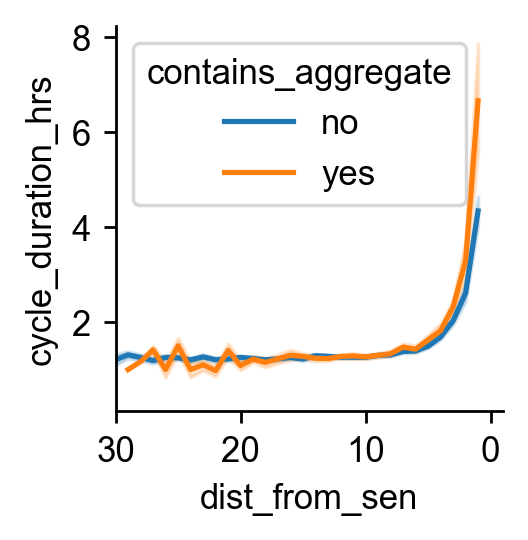

In [336]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'hue': 'contains_aggregate',
    'data': sub_buds_df,
    'ax': ax,
}

sns.lineplot(**kwargs)

ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+0.1, 10))

## Figure S4: Plot of DsRed decay rate approaching senescence

### Explaining DsRed decay rate with dilution into the growing cytosolic volume

In [182]:
compartmentname = "20230201_byc_JPC258_cytoplasm_dilution"
collection_interval_minutes = 10
exptname = utilities.exptname_from_compartment(compartmentname)
compartmentdir = files.get_byc_compartmentdir(exptname, compartmentname)
channels_list = utilities.check_compartmentdir_for_channels(compartmentdir)
channels = ' '.join(channels_list)
# Check that there are crop and bud roi dfs, which contain
# annotated information about the .zip roi files, for all the cells in the dataset
utilities.check_bud_and_crop_roi_dfs(compartmentdir)
mdf = utilities.generate_mdf(exptname, compartmentname, channels=channels_list)
filename = f'{compartmentname}_alldf_measured.csv.gzip'
allmeasuredpath = os.path.join(compartmentdir, filename)

Missing crop df .csv files for cells []
Missing bud df .csv files for cells []
Adding paths for channels ['bf', 'rfp', 'yfp']


#### Read in measurements

In [183]:
chase_frame = 20

bud_roi_path = os.path.abspath(os.path.join(compartmentdir, f'{exptname}_cell000_bud_rois.zip'))
bud_rois = files.read_rectangular_rois_as_df(bud_roi_path)

crop_roi_paths = [os.path.abspath(os.path.join(compartmentdir, fn)) for fn in os.listdir(compartmentdir) if 'crop_rois.zip' in fn]
crop_rois = [files.read_rectangular_rois_as_df(path) for path in crop_roi_paths]

csv_fns = [fn for fn in os.listdir(compartmentdir) if '.csv' in fn]
yfp_csvs = [os.path.join(compartmentdir, fn) for fn in csv_fns if 'yfp' in fn]
rfp_csvs = [os.path.join(compartmentdir, fn) for fn in csv_fns if 'rfp' in fn]

df = pd.DataFrame()
skip_cols = [
    'Slice',
    'Area',
]

csvs_dict = {
    'yfp': yfp_csvs,
    'rfp': rfp_csvs
}

tracedfs = []
for i in range(len(yfp_csvs)):
    channel_dfs = []
    for channel_name in csvs_dict.keys():

        tracedf = pd.read_csv(csvs_dict[channel_name][i])
        renamedict = {}
        for col in tracedf.columns:
            if col not in skip_cols:
                renamedict[col] = f'{col}_{channel_name}'
        tracedf.rename(columns=renamedict, inplace=True)
        channel_dfs.append(tracedf)
    crop_roi = crop_rois[i]
    channels_tracedf = pd.merge(channel_dfs[0], channel_dfs[1])
    channels_tracedf.loc[:, 'cell_index'] = i
    if i == 0:
        channels_tracedf.loc[:, 'cell'] = 'mother'
        channels_tracedf.loc[:, 'cell_type'] = 'mother'
    else:
        channels_tracedf.loc[:, 'cell'] = f'daughter {i}'
        channels_tracedf.loc[:, 'daughter_number'] = i
        channels_tracedf.loc[:, 'cell_type'] = 'daughter'
    channels_tracedf.loc[:, 'frame_rel'] = channels_tracedf.Slice - 1
    channels_tracedf.loc[:, 'frame_absolute'] = channels_tracedf.frame_rel + crop_roi.position.min() - 1
    channels_tracedf.loc[:, 'frame_rel_to_chase'] = channels_tracedf.frame_absolute - chase_frame
    tracedfs.append(channels_tracedf)

In [184]:
tracesdf = pd.concat(tracedfs, sort=False).reset_index()
tracesdf.loc[:, 'hours_absolute'] = tracesdf.frame_absolute*10/60
tracesdf.loc[:, 'hours_after_chase'] = tracesdf.frame_rel_to_chase*10/60
tracesdf.loc[:, 'rfp_bg_sub'] = tracesdf.Mean_rfp - tracesdf.Mean_rfp.min()
tracesdf.loc[:, 'rfp_norm'] = tracesdf.rfp_bg_sub/tracesdf.loc[tracesdf.frame_absolute==chase_frame, 'rfp_bg_sub'].values[0]
tracesdf.loc[tracesdf.cell_index==0, 'cell'] = 'mother'
tracesdf.loc[tracesdf.cell_index!=0, 'cell'] = tracesdf.cell_index.apply(lambda x: f'daughter {int(str(x))}')

#### Can we say something about maturation times in sYFP2 vs. DsRed-Express2?

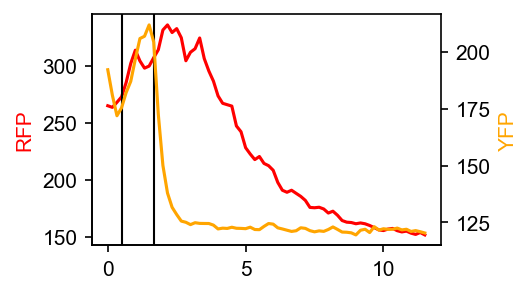

In [188]:
fig, ax = plotting.figure_ax(width_scale=1.5)
fig.set_dpi(150)
subdf = tracesdf[tracesdf.cell=='mother']
yfpcolor = 'orange'
rfpcolor = 'red'

ax.plot(subdf.hours_absolute, subdf.Mean_rfp, color=rfpcolor)
ax2 = ax.twinx()
ax2.plot(subdf.hours_absolute, subdf.Mean_yfp, color=yfpcolor)
ax.set_ylabel('RFP', color=rfpcolor)
ax2.set_ylabel('YFP', color=yfpcolor)

tet_hits_hr = 0.5
ax.axvline(tet_hits_hr, color='black', linewidth=1)
yfp_exp_starts_hr = (10*10)/60
ax.axvline(yfp_exp_starts_hr, color='black', linewidth=1)

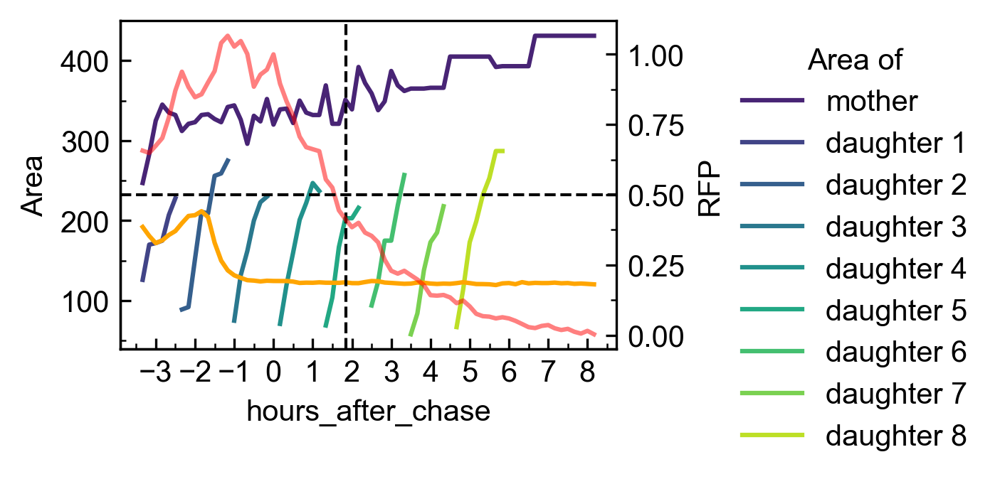

In [189]:
fig, ax = plotting.figure_ax(width_scale=1.5)
fig.set_dpi(300)
ax2 = ax.twinx()
ax.set_xticks(np.arange(-3, 8.1, 1))

kwargs = {
    'x': 'hours_after_chase',
    'y': 'Area',
    'hue': 'cell',
    'data': tracesdf,
    'palette': 'viridis',
    'ax': ax
}

sns.lineplot(**kwargs)

ax2.plot(tracesdf[tracesdf.cell=='mother'].hours_after_chase,
         tracesdf[tracesdf.cell=='mother'].rfp_norm,
         color= 'red',
         alpha= 0.5)

ax.legend(
    ax.get_legend_handles_labels()[0],
    ax.get_legend_handles_labels()[1],
    title='Area of',
    frameon=False,
    bbox_to_anchor=(1.2, 1),
    loc=2

)
ax.plot(tracesdf[tracesdf.cell=='mother'].hours_after_chase,
         tracesdf[tracesdf.cell=='mother'].Mean_yfp, color='orange')

ax2.set_ylabel('RFP')
plotting.format_ticks(ax)
plotting.format_ticks(ax2)

ax2.axhline(0.5, color='black', linestyle='--', linewidth=1)
ax.axvline(1.85, color='black', linestyle='--', linewidth=1)

#### Calculating cytoplasm volume "seen" by the substrate over time

In [190]:
motherdf = tracesdf[tracesdf.cell=='mother']
motherdf.loc[:, 'daughter_area'] = np.nan
daughtersdf = tracesdf[tracesdf.cell_type=='daughter']
daughtersdf.index = daughtersdf.frame_absolute
for daughter_number in daughtersdf.daughter_number.unique():
    daughter_appears_frame = daughtersdf.loc[daughtersdf.daughter_number==daughter_number, 'frame_absolute'].min()
    daughter_ends_frame = daughtersdf.loc[daughtersdf.daughter_number==daughter_number, 'frame_absolute'].max()
    motherdf.loc[daughter_appears_frame:daughter_ends_frame, 'daughter_area'] = np.array(daughtersdf.loc[daughtersdf.daughter_number==daughter_number, 'Area'])
    motherdf.loc[daughter_appears_frame:daughter_ends_frame, 'daughter_number'] = daughter_number
    motherdf.loc[daughter_ends_frame, 'final_daughter_area'] = daughtersdf.loc[daughter_ends_frame, 'Area']

motherdf.loc[motherdf.final_daughter_area.isna(), 'final_daughter_area'] = 0
# Add up the accumating daughter area starting at chase
for frame_absolute in motherdf[motherdf.frame_absolute>=chase_frame].frame_absolute:
    motherdf.loc[frame_absolute, 'daughter_area_plus_final_previous'] = motherdf.daughter_area.iloc[frame_absolute] + motherdf.loc[motherdf.frame_absolute.between(chase_frame, frame_absolute, inclusive='left'), 'final_daughter_area'].sum()
motherdf.loc[(motherdf.daughter_area_plus_final_previous.isna())&(motherdf.frame_absolute<=chase_frame),
              'daughter_area_plus_final_previous'] = 0
motherdf.loc[:, 'accumulated_cytosol_area'] = motherdf.Area + motherdf.daughter_area_plus_final_previous

motherdf.loc[:, 'accumulated_cytosol_area_norm_to_t0'] = motherdf.accumulated_cytosol_area/motherdf.loc[motherdf.hours_after_chase==0, 'accumulated_cytosol_area'].values[0]

C:\Users\johnp\AppData\Local\Temp\ipykernel_19668\2738744245.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  motherdf.loc[:, 'daughter_area'] = np.nan
C:\Users\johnp\AppData\Local\Temp\ipykernel_19668\2738744245.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  motherdf.loc[daughter_ends_frame, 'final_daughter_area'] = daughtersdf.loc[daughter_ends_frame, 'Area']
C:\Users\johnp\AppData\Local\Temp\ipykernel_19668\2738744245.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sli

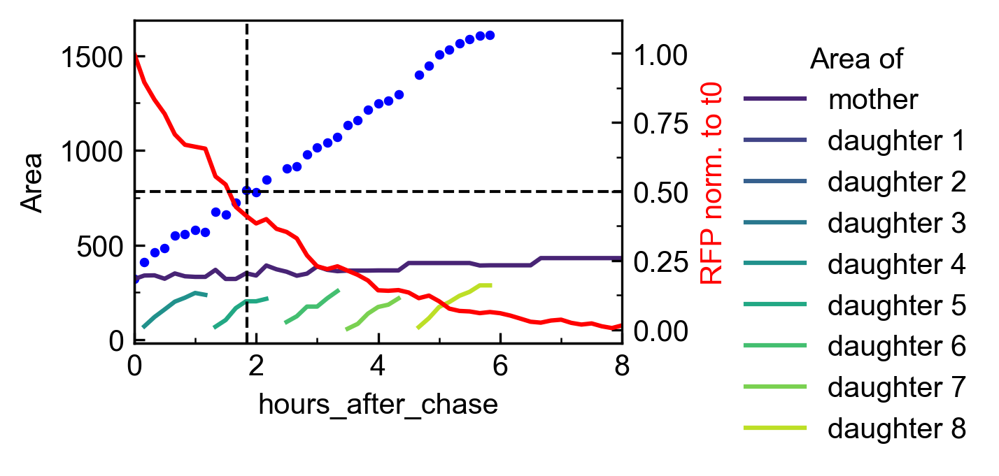

In [191]:
fig, ax = plotting.figure_ax(width_scale=1.5)
fig.set_dpi(300)
ax.set_xlim(0, 8)
ax2 = ax.twinx()

kwargs = {
    'x': 'hours_after_chase',
    'y': 'Area',
    'hue': 'cell',
    'data': tracesdf,
    'palette': 'viridis',
    'ax': ax
}

sns.lineplot(**kwargs)

ax2.plot(tracesdf[tracesdf.cell=='mother'].hours_after_chase,
         tracesdf[tracesdf.cell=='mother'].rfp_norm,
         color= 'red',
         alpha= 1)

ax.scatter(motherdf.hours_after_chase, motherdf.accumulated_cytosol_area, color='blue', s=5)
# ax2.scatter(motherdf.hours_after_chase, motherdf.accumulated_cytosol_area_norm_to_t0, color='blue', s=5, marker='o')

ax.legend(
    ax.get_legend_handles_labels()[0],
    ax.get_legend_handles_labels()[1],
    title='Area of',
    frameon=False,
    bbox_to_anchor=(1.2, 1),
    loc=2

)
ax2.set_ylabel('RFP norm. to t0', color='red')
plotting.format_ticks(ax)
plotting.format_ticks(ax2)

ax2.axhline(0.5, color='black', linestyle='--', linewidth=1)
ax.axvline(1.85, color='black', linestyle='--', linewidth=1)

In [192]:
total_area_at_halflife = motherdf.loc[motherdf.frame_rel_to_chase==10, 'accumulated_cytosol_area'].iloc[0]
total_area_at_halflife

total_area_at_chase = motherdf.loc[motherdf.frame_rel_to_chase==0, 'accumulated_cytosol_area'].iloc[0]
total_area_at_chase

320.0

In [193]:
x = motherdf[~motherdf.accumulated_cytosol_area.isna()].hours_after_chase
x = x[chase_frame:]
y = motherdf[~motherdf.accumulated_cytosol_area.isna()].accumulated_cytosol_area_norm_to_t0
y = y[chase_frame:]

from lmfit.model import ModelResult
from lmfit import Model
from lmfit import Parameters

line_model = Model(ft.line)
params = Parameters()
vary = {
    'b': False,
    'm': True
}
for param in ['b', 'm']:
    params.add(param, value=1, vary=vary[param])
linear_result = line_model.fit(y, params, x=x)

In [194]:
x = np.array(motherdf[motherdf.hours_after_chase>=0].hours_after_chase)
y_bg_sub = motherdf[motherdf.hours_after_chase>=0].Mean_rfp -  motherdf[motherdf.hours_after_chase>=0].Mean_rfp.min()
y = np.array(y_bg_sub/y_bg_sub[chase_frame])

from lmfit.model import ModelResult
from lmfit import Model
from lmfit import Parameters

exp_model = Model(ft.single_exp)
params = Parameters()
mins = {
    'a': 0,
    'b': 0,
    'c': 0
}

maxes = {
    'a': np.inf,
    'b': np.inf,
    'c': np.inf
}
for param in ['a', 'b', 'c']:
    params.add(param, value=1, vary=True)
model = exp_model.fit(y, params, x=x)

### DsRed and cumulative cytosolic area over time

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=hours_after_tet_y=Dsred_and_total_cytosol_area.svg


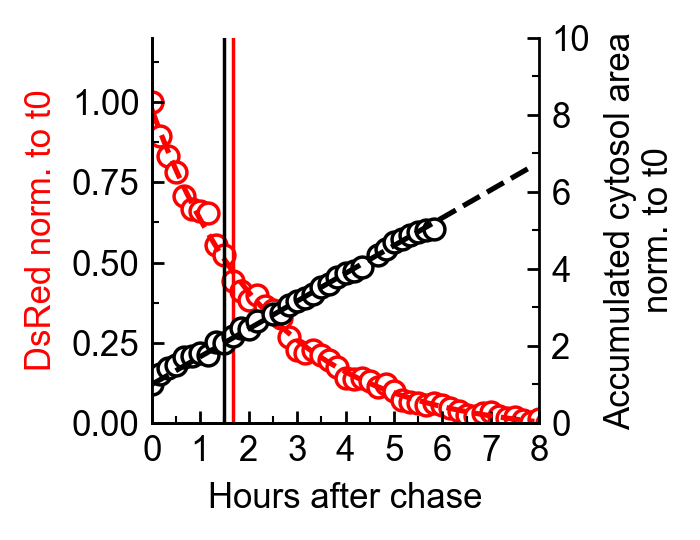

In [195]:
fig, ax = plotting.figure_ax()
cycle_color = 'black'
rfp_color = 'red'
x_smooth = np.arange(0, 8, 0.1)
linewidth = 1

pars = [
    model.params['a'].value,
    model.params['b'].value,
    model.params['c'].value
]

# pars = [
#     1,
#     0.37,
#     0.00
# ]

y_pred = ft.single_exp(x_smooth, *pars)
dsred_halflife = np.log(2)/model.params['b'].value

ax.plot(x_smooth, y_pred, color=rfp_color, linestyle='--')
ax.scatter(x, y, color='white', edgecolor=rfp_color)
ax.set_ylim(0, 1.2)
ax.set_xlim(0, 8)
ax.set_xticks(np.arange(0, 8.1, 1))
ax.axvline(dsred_halflife, color=rfp_color, linewidth=linewidth)

# plot cell accumulate area fit
ax2 = ax.twinx()
ax2.scatter(motherdf.hours_after_chase, motherdf.accumulated_cytosol_area_norm_to_t0, color='white', edgecolor=cycle_color)
y_area = ft.line(x_smooth, linear_result.params['m'].value, linear_result.params['b'].value)
ax2.plot(x_smooth, y_area, color=cycle_color, linestyle='--')
ax2.set_ylim(0, 10)
deltas = np.abs(2 - y_area)
deltas_raw = np.abs(2 - motherdf.accumulated_cytosol_area_norm_to_t0)
area_doubling_time = x_smooth[np.argmin(deltas)]
area_doubling_time_raw = motherdf.hours_after_chase[np.argmin(deltas_raw)]
# ax2.axvline(area_doubling_time, color=cycle_color, linewidth=linewidth)
ax2.axvline(area_doubling_time_raw, color=cycle_color, linewidth=linewidth, linestyle='-')
for a in [ax, ax2]:
    plotting.format_ticks(a)
    a.spines['top'].set_visible(False)
ax.set_ylabel('DsRed norm. to t0', color=rfp_color)
ax2.set_ylabel('Accumulated cytosol area\nnorm. to t0', loc='center', color=cycle_color)
ax.set_xlabel('Hours after chase')

kwargs = {
    'x': 'hours_after_tet',
    'y': 'Dsred_and_total_cytosol_area'
}

plotting.save_figure(fig, kwargs, ext='.svg')

### DsRed k vs. dist from sen

Need to read in data again once the database is refreshed and label with SEP fit.

I can also add a few hundred more cells to this analysis to include the ones that were already processed for 20230201_byc JPC258 YFP

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC258_r.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC258_r.png


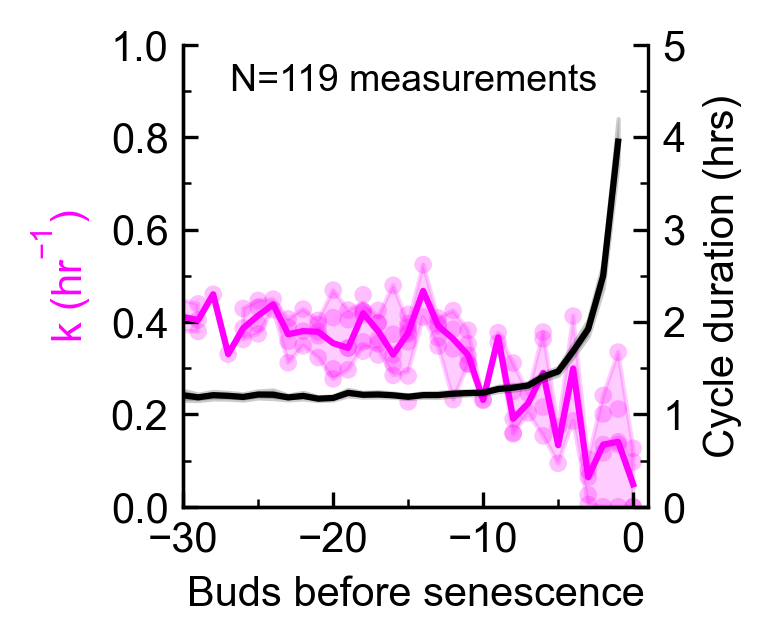

In [18]:
samplename = 'wt_dsred'
compartments = constants.compartments_dict[samplename]
yfp_compartments = [compartments[0].replace('_rfp', '')]
sub_buds_df = buds_df[buds_df.compartment_name.isin(yfp_compartments)]
sub_fits_df = fits_df[
    (fits_df.compartment_name.isin(compartments))]
result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
    sub_fits_df,
    sub_buds_df,
    yvar1='b',
    yvar2='cycle_duration_hrs',
    xvar='buds_after_death',
    fit_type='median',
    xlabel='Buds before senescence',
    xlim=(-30, 1),
    ylim_k=(0, 1),
    ylim_cycle=(0, 5),
    shade_stderr=False,
    fillalpha=0.25,
    fillsep=False,
    width_scale=1,
)
# Adjust length of x and y median to be as long as 
# x and y_pred. This is needed as in the case of piecewise
# fitting where x is super sampled to smooth out y_pred
x_median = np.append(x_median, np.full(len(x) - len(x_median), np.nan))
y_median = np.append(y_median, np.full(len(y_pred) - len(y_median), np.nan))
strain_fit_df = pd.DataFrame({
    'x': x,
    'y_pred': y_pred,
    'x_median': x_median,
    'y_median': y_median
})

In [233]:
pre_sep = sub_bud_df[sub_bud_df.dist_from_sen>5].cycle_duration_hrs.mean()
post_sep = sub_bud_df[sub_bud_df.dist_from_sen<5].cycle_duration_hrs.mean()
post_sep/pre_sep

2.0364030247196334

### strip plots of pre/post SEP DsRed

False vs. True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:4.010e-10 U_stat=1.889e+03
DsRed fold change young over old=2.8711298725194685 +/- 0.010739147229709922
DsRed fold change old over young=0.3482949376729106
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=post_sep_y=b_hue=post_sep_dodge=False.svg


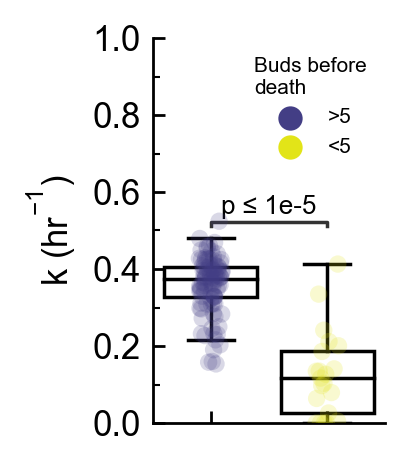

In [42]:
strain_groups = [
    ['JPC258_r']
]

substrates = [
    'DsRed'
]
colors = [plotting.strains_color_dict[strain] for strain in ['JPC258_r']]
all_strains = strain_groups[0]
sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
for i, group in enumerate(strain_groups):
    sub_fits_df.loc[sub_fits_df.strain_name.isin(group), 'substrate'] = substrates[i]

fig, ax = plotting.figure_ax(width_scale=0.6)
sep_border = 5
sub_fits_df.loc[sub_fits_df.dist_from_sen>sep_border, 'post_sep'] = False
sub_fits_df.loc[sub_fits_df.dist_from_sen<sep_border, 'post_sep'] = True

kwargs = {
    'x': 'post_sep',
    'y': 'b',
    'hue': 'post_sep',
    'data': sub_fits_df[~sub_fits_df.post_sep.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': False,
    'order': [False, True],
    'hue_order': [False, True]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
order = kwargs['order']
box_pairs=[
    (False, True),
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 1)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.2))
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlabel('')
for substrate in substrates:
    subdf = sub_fits_df[sub_fits_df.substrate==substrate]
    data1 = subdf.loc[subdf.post_sep==False, 'b']
    data2 = subdf.loc[subdf.post_sep==True, 'b']
    fold_change = data1.mean()/data2.mean()
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM1, 2)]))
    fold_change_old_over_young = 1/fold_change
    print(f'{substrate} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{substrate} fold change old over young={fold_change_old_over_young}')
# ax.legend_.set_visible(False)
legfontsize = 6
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], [f'>{sep_border}', f'<{sep_border}'],
                   title='Buds before\ndeath',
                   frameon=False,
                   fontsize=legfontsize,
                   bbox_to_anchor=(1, 1))
legend.get_title().set_fontsize(legfontsize)
ax.set_xticklabels([])
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

## Figure 5: Speed of ubiquitylated substrate degradation loss inversely correlates with proteasome expression
Lots of this analysis actually sits under figure 2 because I'm just plotting everything at once

### Survival curves between mutants

In [109]:
for samplename, compartments_list in constants.compartments_dict.items():
    survivaldf.loc[survivaldf.compartment_name.isin(compartments_list), 'samplename'] = samplename
    table.loc[table.compartment_name.isin(compartments_list), 'samplename'] = samplename
    rls_tables_df.loc[rls_tables_df.compartment_name.isin(compartments_list), 'samplename'] = samplename

wt_rkk
Comparing wt_rkk to wt_rkk
rpn4_rkk
Comparing rpn4_rkk to wt_rkk
mub1_rkk
Comparing mub1_rkk to wt_rkk
ubr2_rkk
Comparing ubr2_rkk to wt_rkk
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_kmf_y=y_kmf_hue=samplename.svg


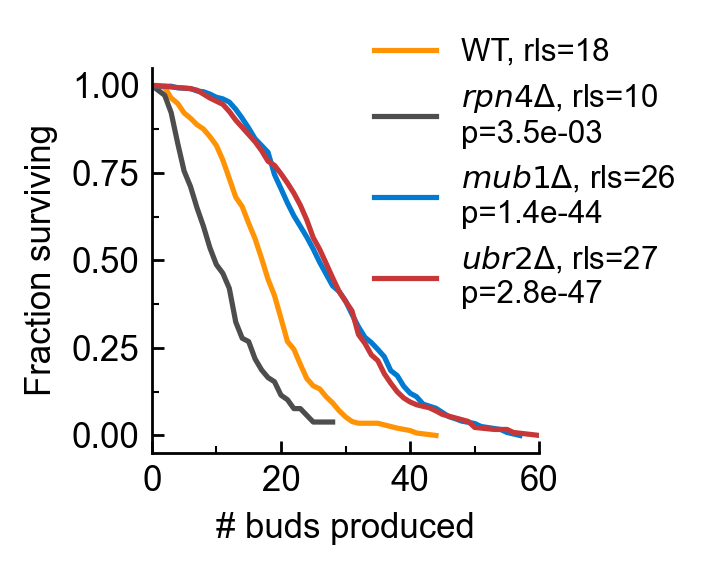

In [113]:
palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC263'],
    strains_color_dict['JPC274'],
    strains_color_dict['JPC262']
]

samples = [
    'wt_rkk',
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk'
]
labels =  [
    'WT',
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('mub1'),
    plotting.get_gene_deletion_string('ubr2')
]

label_dict = dict(zip(samples, labels))

plotting.set_styles(matplotlib, plt)

fig,ax = plotting.figure_ax(width_scale=1, height_scale=1)
comps = constants.compartments_dict['wt_rkk'] + constants.compartments_dict['mub1_rkk'] + constants.compartments_dict['ubr2_rkk'] + constants.compartments_dict['rpn4_rkk']
kwargs = {
    'x': 'x_kmf',
    'y': 'y_kmf',
    'hue': 'samplename',
    'hue_order': ['wt_rkk', 'rpn4_rkk', 'mub1_rkk', 'ubr2_rkk'],
    'data': survivaldf_pooled,
    'ax': ax,
    'palette': palette
}

sns.lineplot(**kwargs, estimator=np.mean)
# Calculate significance using
# https://www.kdnuggets.com/2020/07/guide-survival-analysis-python-part-3.html
from lifelines.statistics import logrank_test
labels_with_pval = []
for sample in samples:
    print(sample)
    # Print RLS of individual strains
    rls = int(survivaldf_pooled.loc[survivaldf_pooled.samplename==sample, 'kmf_halflife'].iloc[0])
    args = [
        rls_tables_df[rls_tables_df.samplename==sample]['rls'],
        rls_tables_df[rls_tables_df.samplename=='wt_rkk']['rls']
    ]

    logrankkwargs = {
        'event_observed_A': rls_tables_df[rls_tables_df.samplename==sample]['rls_observed'],
        'event_observed_B': rls_tables_df[rls_tables_df.samplename=='wt_rkk']['rls_observed']
    }
    results = logrank_test(*args, **logrankkwargs)
    print(f'Comparing {sample} to wt_rkk')
    # results.print_summary()
    if sample == 'wt_rkk':
        label_with_pval = label_dict[sample] + f', rls={rls}'
    else:
        pval_str = f"{results.p_value:.1e}"
        label_with_pval = label_dict[sample] + f', rls={rls}' + f'\np={pval_str}'
    labels_with_pval.append(label_with_pval)
ax.legend(ax.get_legend_handles_labels()[0],
          labels_with_pval,
          frameon=False, bbox_to_anchor=(0.5, 0.3), fontsize=9)
ax.set_xlabel('# buds produced')
ax.set_ylabel('Fraction surviving')
ax.set_xlim(0, 60)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

### Fold change of k before and after SEP fit for individual cells

C:\Users\johnp\AppData\Local\Temp\ipykernel_8996\1136626036.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b']/pre_sep_median


mub1_rkk_False vs. mub1_rkk_True: Mann-Whitney-Wilcoxon test two-sided, P_val:1.004e-46 U_stat=2.132e+04
rpn4_rkk_False vs. rpn4_rkk_True: Mann-Whitney-Wilcoxon test two-sided, P_val:4.710e-01 U_stat=1.316e+04
ubr2_rkk_False vs. ubr2_rkk_True: Mann-Whitney-Wilcoxon test two-sided, P_val:3.968e-45 U_stat=2.652e+04
rpn4_rkk fold change young over old=0.988 +/- 0.034
rpn4_rkk fold change old over young=1.012 +/- 0.034
mub1_rkk fold change young over old=1.512 +/- 0.04
mub1_rkk fold change old over young=0.661 +/- 0.04
ubr2_rkk fold change young over old=1.469 +/- 0.037
ubr2_rkk fold change old over young=0.681 +/- 0.037
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=b_over_real_pre_sep_median_hue=pre_SEP_dodge=True.svg


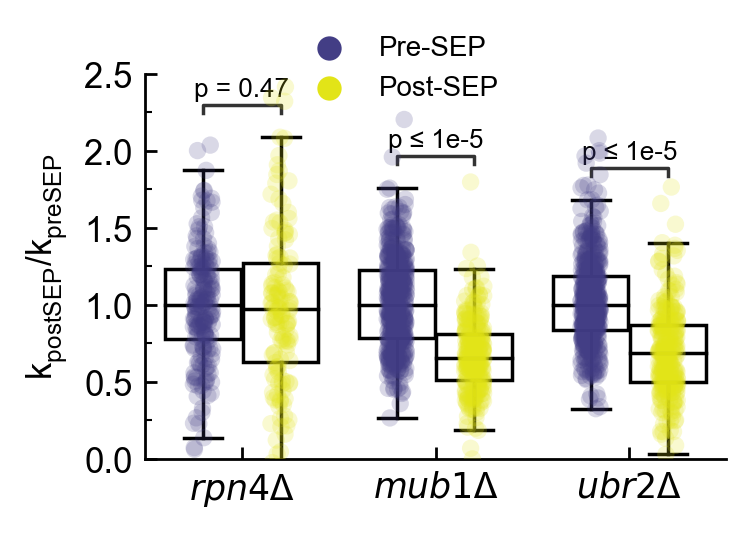

In [81]:
plotting.set_styles(matplotlib, plt)

strain_groups = [
    ['JPC263'],
    ['JPC274'],
    ['JPC262']
]

labels = [
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('mub1'),
    plotting.get_gene_deletion_string('ubr2')
]

samples = [
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk'
]
# sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
comps = constants.compartments_dict['rpn4_rkk'] + constants.compartments_dict['mub1_rkk'] + constants.compartments_dict['ubr2_rkk']
sub_fits_df = fits_df[fits_df.compartment_name.isin(comps)]

fig, ax = plotting.figure_ax(width_scale=1.5)

# Normalize to pre/post SEP median
for samplename in sub_fits_df.samplename.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.pre_SEP==True)&(sub_fits_df.samplename==samplename), 'b'].median()
    sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b']/pre_sep_median

kwargs = {
    'x': 'samplename',
    'y': 'b_over_real_pre_sep_median',
    'hue': 'pre_SEP',
    'data': sub_fits_df[~sub_fits_df.pre_SEP.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': samples,
    'hue_order': [True, False]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('rpn4_rkk', True), ("rpn4_rkk", False)),
    (("mub1_rkk", True), ("mub1_rkk", False)),
    (("ubr2_rkk", True), ("ubr2_rkk", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 2.5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.5))
ax.set_ylabel(plotting.annoying_strings().k_old_over_young)
ax.set_xticklabels(labels)
ax.set_xlabel('')
for samplename in samples:
    subdf = sub_fits_df[sub_fits_df.samplename==samplename]
    data1 = subdf.loc[subdf.pre_SEP==True, 'b']
    data2 = subdf.loc[subdf.pre_SEP==False, 'b']
    fold_change = np.round(data1.mean()/data2.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    fold_change_old_over_young = np.round(1/fold_change, 3)
    print(f'{samplename} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{samplename} fold change old over young={fold_change_old_over_young} +/- {SEM_of_fold_change}')
# ax.legend_.set_visible(False)
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['Pre-SEP', 'Post-SEP'],
                   title='',
                   frameon=False,
                   fontsize=legfontsize,
                   loc=(0.25, 0.9))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

#### Mean rate constants from before and after SEP for each sample

In [82]:
fits_df.loc[:, 'halflife'] = np.log(2)/fits_df.b
all_samples = samples + ['wt_dsred', 'wt_rkk']
for sample in all_samples:
    print(sample)
    bools = (fits_df.samplename==sample)&(fits_df.pre_SEP==True)&(fits_df.x0_stderr_fraction.abs()<1)
    mean_pre_sep = fits_df.loc[bools, 'b'].mean()
    sem_pre_sep = fits_df.loc[bools, 'b'].sem()
    
    mean_hlpre_sep = fits_df.loc[bools, 'halflife'].mean()
    sem_hlpre_sep = fits_df.loc[bools, 'halflife'].sem()
    
    print(mean_pre_sep)
    print(sem_pre_sep)
    
    print(mean_hlpre_sep)
    print(sem_hlpre_sep)

rpn4_rkk
0.607821323650693
0.01689172509901929
1.5303279009175303
0.1484313430757242
mub1_rkk
2.035014957405579
0.02674546501582522
0.3726425054436918
0.005689900550829527
ubr2_rkk
1.7979609884389842
0.022168963514598756
0.4172693947891519
0.0058781274409983875
wt_dsred
0.366119969419597
0.006943640393396114
1.9739903052651206
0.05058851167790945
wt_rkk
2.3439858547649637
0.028706472318217043
0.31269732174169396
0.004236972019353125


### Fold change in k from before to after SEP when SEP is assumed to be 5 for all cells

C:\Users\johnp\AppData\Local\Temp\ipykernel_8996\1687258435.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b_over_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b']/pre_sep_median


mub1_rkk_False vs. mub1_rkk_True: Mann-Whitney-Wilcoxon test two-sided, P_val:8.756e-33 U_stat=7.705e+04
rpn4_rkk_False vs. rpn4_rkk_True: Mann-Whitney-Wilcoxon test two-sided, P_val:2.875e-01 U_stat=1.336e+04
ubr2_rkk_False vs. ubr2_rkk_True: Mann-Whitney-Wilcoxon test two-sided, P_val:6.716e-41 U_stat=9.323e+04
rpn4_rkk fold change young over old=1.008 +/- 0.029
rpn4_rkk fold change old over young=0.992 +/- 0.029
mub1_rkk fold change young over old=1.487 +/- 0.045
mub1_rkk fold change old over young=0.672 +/- 0.045
ubr2_rkk fold change young over old=1.485 +/- 0.04
ubr2_rkk fold change old over young=0.673 +/- 0.04
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=b_over_pre_sep_median_hue=post_sep_dodge=True.svg


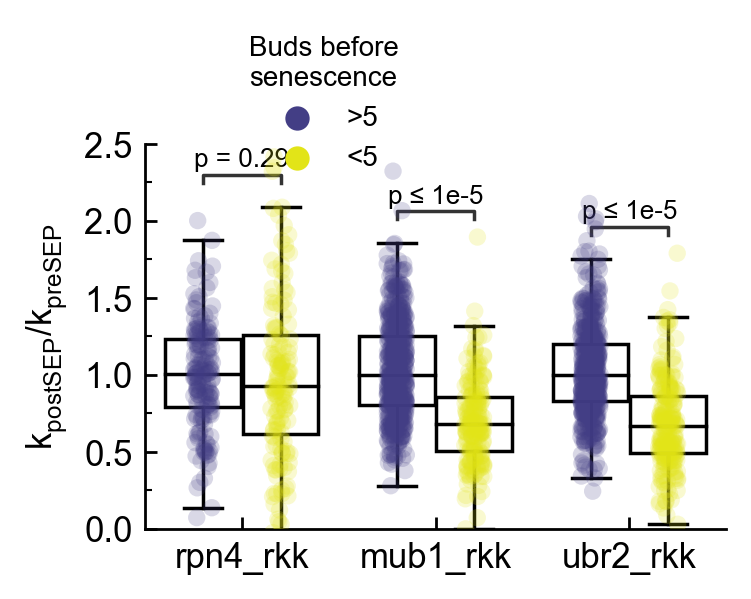

In [83]:
strain_groups = [
    ['JPC263'],
    ['JPC274'],
    ['JPC262']
]

labels = [
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('mub1'),
    plotting.get_gene_deletion_string('ubr2')
]

samples = [
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk'
]

# sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
comps = constants.compartments_dict['rpn4_rkk'] + constants.compartments_dict['mub1_rkk'] + constants.compartments_dict['ubr2_rkk']
sub_fits_df = fits_df[fits_df.compartment_name.isin(comps)]

fig, ax = plotting.figure_ax(width_scale=1.5)

# Normalize to pre/post SEP median
for samplename in sub_fits_df.samplename.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.dist_from_sen>5)&(sub_fits_df.samplename==samplename), 'b'].median()
    sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b_over_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.samplename==samplename, 'b']/pre_sep_median

kwargs = {
    'x': 'samplename',
    'y': 'b_over_pre_sep_median',
    'hue': 'post_sep',
    'data': sub_fits_df[~sub_fits_df.pre_SEP.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': samples,
    'hue_order': [False, True]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('rpn4_rkk', True), ("rpn4_rkk", False)),
    (("mub1_rkk", True), ("mub1_rkk", False)),
    (("ubr2_rkk", True), ("ubr2_rkk", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 2.5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.5))
ax.set_ylabel(plotting.annoying_strings().k_old_over_young)
ax.set_xlabel('')
for samplename in samples:
    subdf = sub_fits_df[sub_fits_df.samplename==samplename]
    data1 = subdf.loc[subdf.dist_from_sen>5, 'b']
    data2 = subdf.loc[subdf.dist_from_sen<5, 'b']
    fold_change = np.round(data1.mean()/data2.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    fold_change_old_over_young = np.round(1/fold_change, 3)
    print(f'{samplename} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{samplename} fold change old over young={fold_change_old_over_young} +/- {SEM_of_fold_change}')
# ax.legend_.set_visible(False)
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['>5', '<5'],
                   title='Buds before\nsenescence',
                   frameon=False,
                   fontsize=legfontsize,
                   loc=(0.16, 0.9))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.png
Buds before SEP max of 9.0 and min of -35.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.png
Buds before SEP max of 12.0 and min of -30.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.png
Buds before SEP max of 10.0 and min of -36.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_se

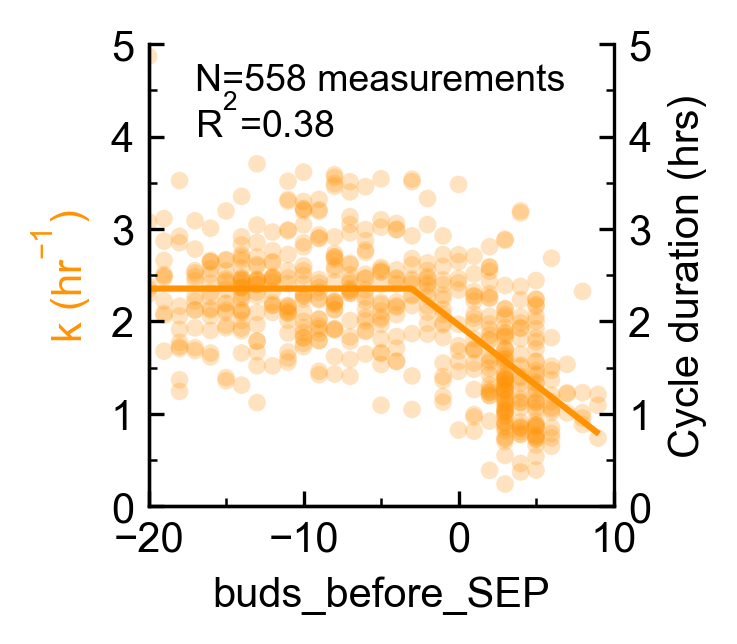

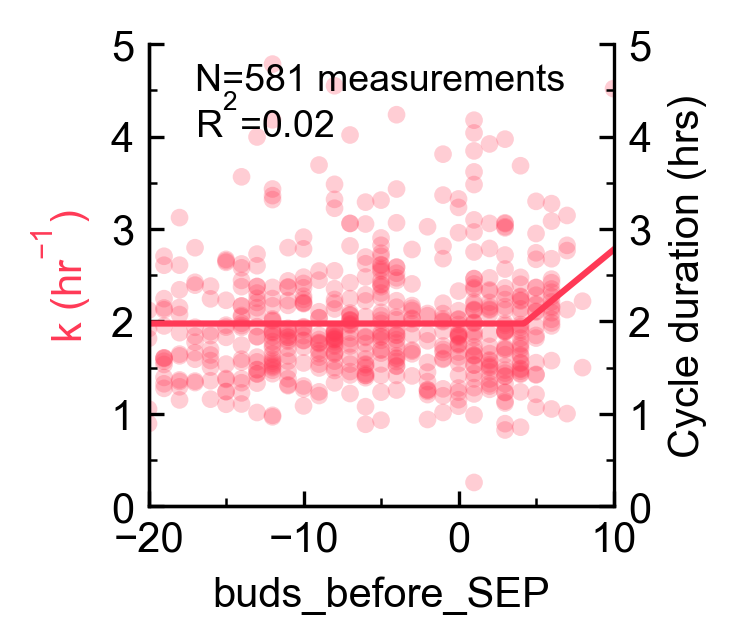

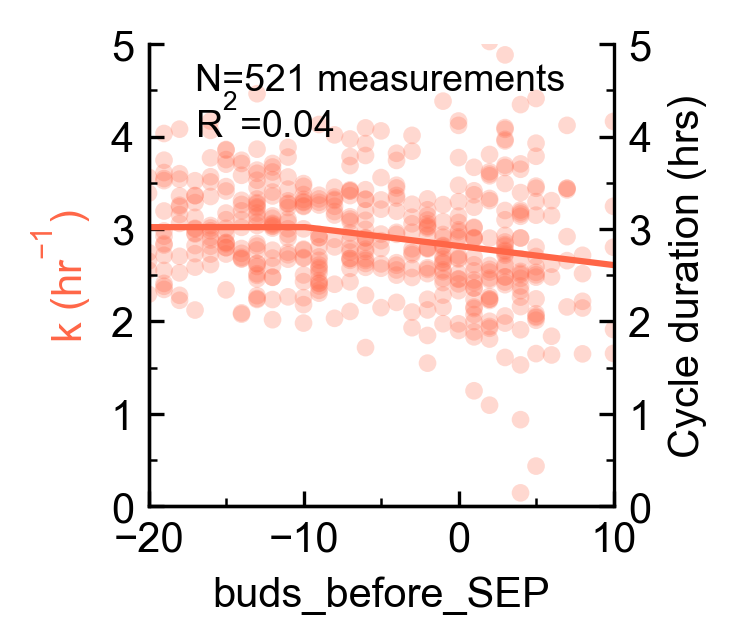

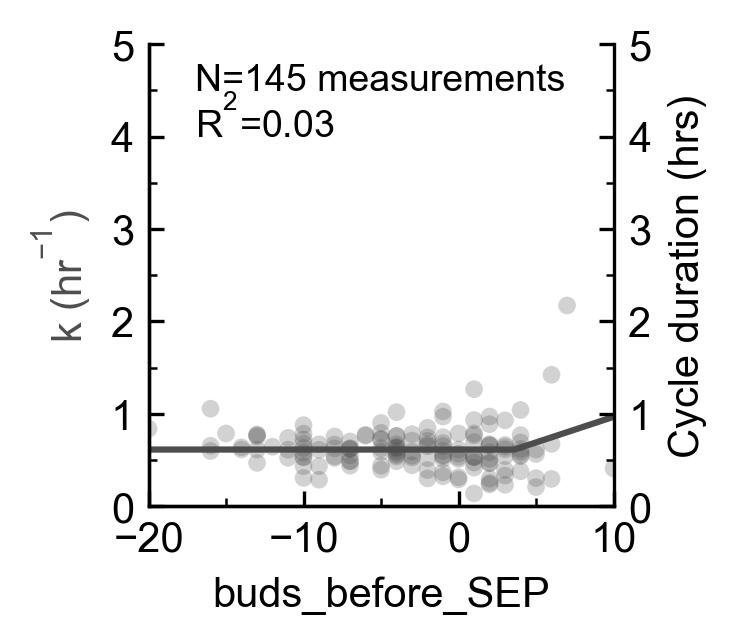

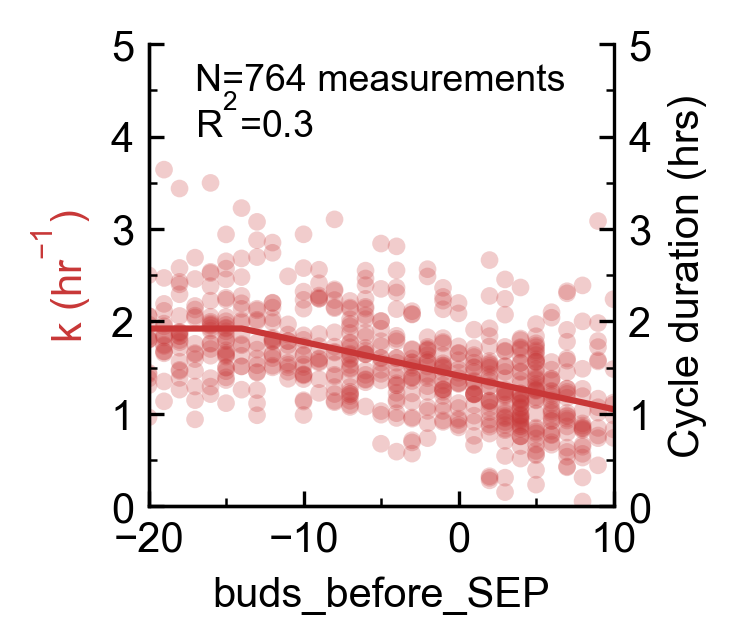

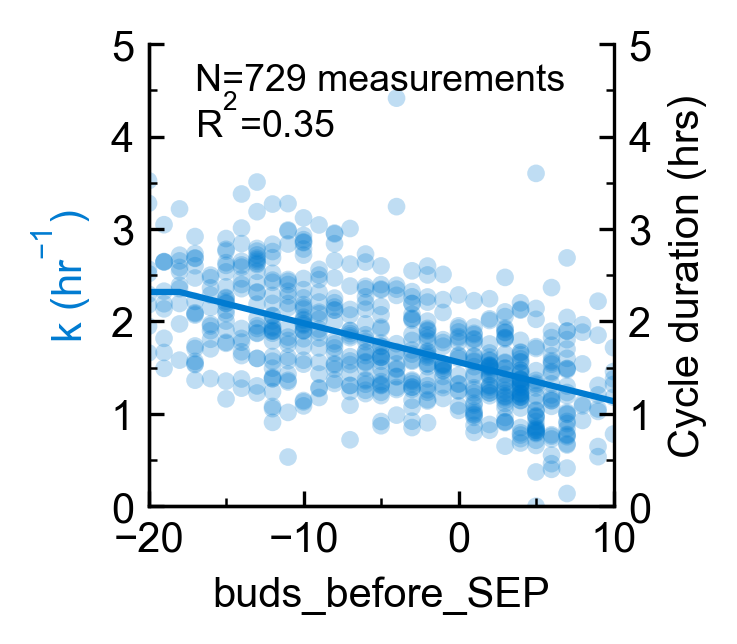

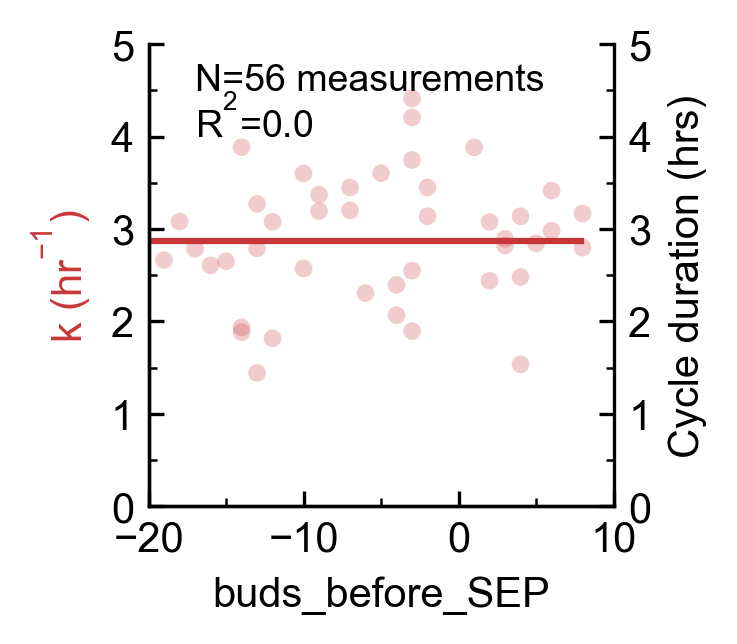

In [64]:
strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
for strain in strains[:]:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.buds_before_SEP.isna()) &
        (fits_df.x0_stderr_fraction.abs()<1)]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_fits_df,
        sub_buds_df,
        yvar1='b',
        yvar2=None,
        xvar='buds_before_SEP',
        fit_type='piecewise',
        xlabel='buds_before_SEP',
        xlim=(-20, 10),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        fillsep=False,
        width_scale=1,
    )
    # Adjust length of x and y median to be as long as 
    # x and y_pred. This is needed as in the case of piecewise
    # fitting where x is super sampled to smooth out y_pred
    x_median = np.append(x_median, np.full(len(x) - len(x_median), np.nan))
    y_median = np.append(y_median, np.full(len(y_pred) - len(y_median), np.nan))
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    results_dfs.append(results_df)
    
    for col in results_df.columns:
        if col != 'x':
            strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
    
all_strains_fit_df = pd.concat(dfs)
all_strains_fit_table = pd.concat(results_dfs)

### k normalized to pre-SEP mean before and after SEP where SEP is fit for all individual cells

C:\Users\johnp\AppData\Local\Temp\ipykernel_3708\727678624.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median


UBL_True vs. UBL_False: Mann-Whitney-Wilcoxon test two-sided, P_val:4.522e-05 U_stat=3.158e+04
R*KK_True vs. R*KK_False: Mann-Whitney-Wilcoxon test two-sided, P_val:3.884e-42 U_stat=6.830e+04
ODC(47)_True vs. ODC(47)_False: Mann-Whitney-Wilcoxon test two-sided, P_val:7.619e-02 U_stat=3.248e+04
R*KK fold change young over old=1.531 +/- 0.051
R*KK fold change old over young=0.653 +/- 0.051
UBL fold change young over old=1.086 +/- 0.072
UBL fold change old over young=0.921 +/- 0.072
ODC(47) fold change young over old=0.954 +/- 0.06
ODC(47) fold change old over young=1.048 +/- 0.06
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=substrate_y=b_over_real_pre_sep_median_hue=pre_SEP_dodge=True.svg


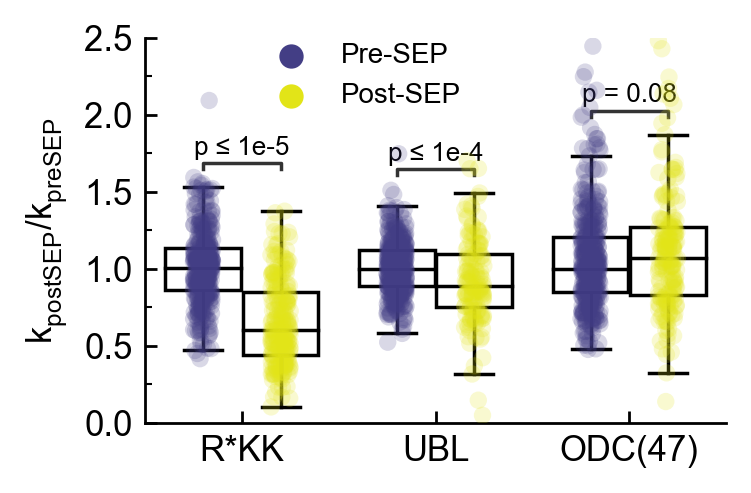

In [5]:
strain_groups = [
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC228', 'JPC258'],
    ['JPC122']
]

substrates = [
    'R*KK',
    'UBL',
    'ODC(47)'
]
colors = [plotting.strains_color_dict[strain] for strain in ['JPC121', 'JPC228', 'JPC122']]
all_strains = strain_groups[0] + strain_groups[1] + strain_groups[2]
# sub_fits_df = fits_df[fits_df.strain_name.isin(all_strains)]
comps = constants.compartments_dict['wt_odc'] + constants.compartments_dict['wt_rkk'] + constants.compartments_dict['wt_ubl']
sub_fits_df = fits_df[fits_df.compartment_name.isin(comps)]
for i, group in enumerate(strain_groups):
    sub_fits_df.loc[sub_fits_df.strain_name.isin(group), 'substrate'] = substrates[i]

fig, ax = plotting.figure_ax(width_scale=1.5)

# Normalize to pre/post SEP median
for substrate in sub_fits_df.substrate.unique():
    pre_sep_median = sub_fits_df.loc[(sub_fits_df.pre_SEP==True)&(sub_fits_df.substrate==substrate), 'b'].median()
    sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b_over_real_pre_sep_median'] = sub_fits_df.loc[sub_fits_df.substrate==substrate, 'b']/pre_sep_median

kwargs = {
    'x': 'substrate',
    'y': 'b_over_real_pre_sep_median',
    'hue': 'pre_SEP',
    'data': sub_fits_df[~sub_fits_df.post_sep.isna()],
    'ax': ax,
    'palette': plotting.get_pre_post_sep_palette(),
    'dodge': True,
    'order': substrates,
    'hue_order': [True, False]
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
hue = kwargs['hue']
order = kwargs['order']
box_pairs=[
    (('UBL', True), ("UBL", False)),
    (("ODC(47)", True), ("ODC(47)", False)),
    (("R*KK", True), ("R*KK", False))
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2)
ax.set_ylim(0, 2.5)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 0.5))
ax.set_ylabel(plotting.annoying_strings().k_old_over_young)
ax.set_xlabel('')
for substrate in substrates:
    subdf = sub_fits_df[sub_fits_df.substrate==substrate]
    data1 = subdf.loc[subdf.pre_SEP==True, 'b']
    data2 = subdf.loc[subdf.pre_SEP==False, 'b']
    fold_change = np.round(data1.mean()/data2.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    fold_change_old_over_young = np.round(1/fold_change, 3)
    print(f'{substrate} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
    print(f'{substrate} fold change old over young={fold_change_old_over_young} +/- {SEM_of_fold_change}')
# ax.legend_.set_visible(False)
legfontsize = 8
legend = ax.legend(ax.get_legend_handles_labels()[0][2:], ['Pre-SEP', 'Post-SEP'],
                   title='',
                   frameon=False,
                   fontsize=legfontsize,
                   bbox_to_anchor=(0.16, 0.75))
legend.get_title().set_fontsize(legfontsize)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Comparing fits to k vs. distance from senescence and SEP in different conditions

#### k vs. distance from SEP

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC121-JPC220.png
Buds before SEP max of 9.0 and min of -35.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC122.png
Buds before SEP max of 12.0 and min of -30.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.svg
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=k and cycle duration_strains=JPC228-JPC258.png
Buds before SEP max of 10.0 and min of -36.0
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_se

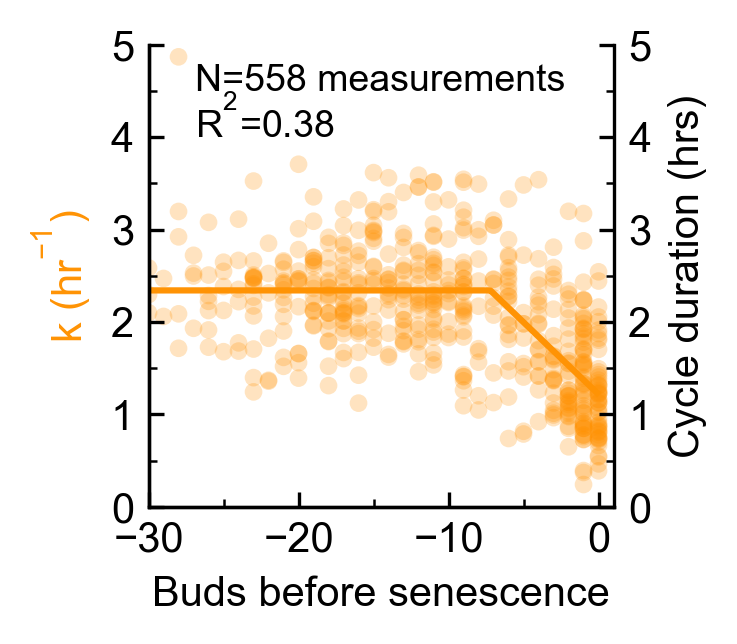

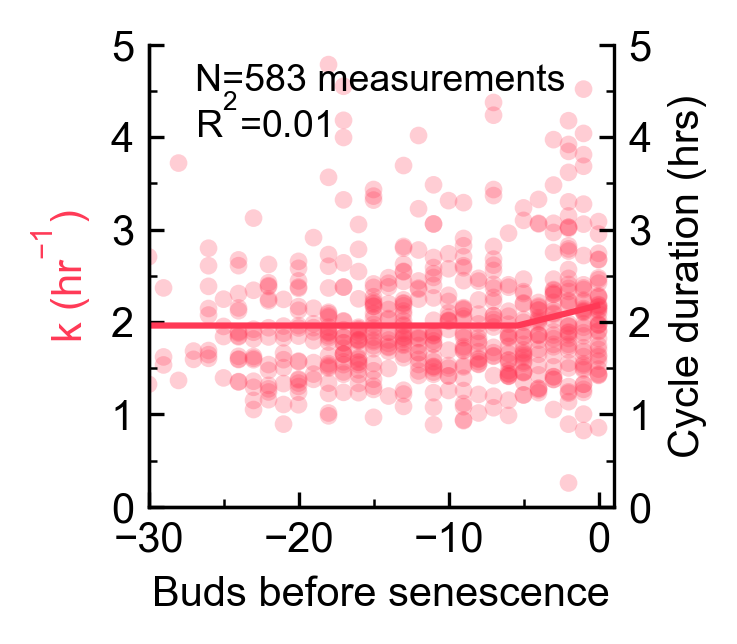

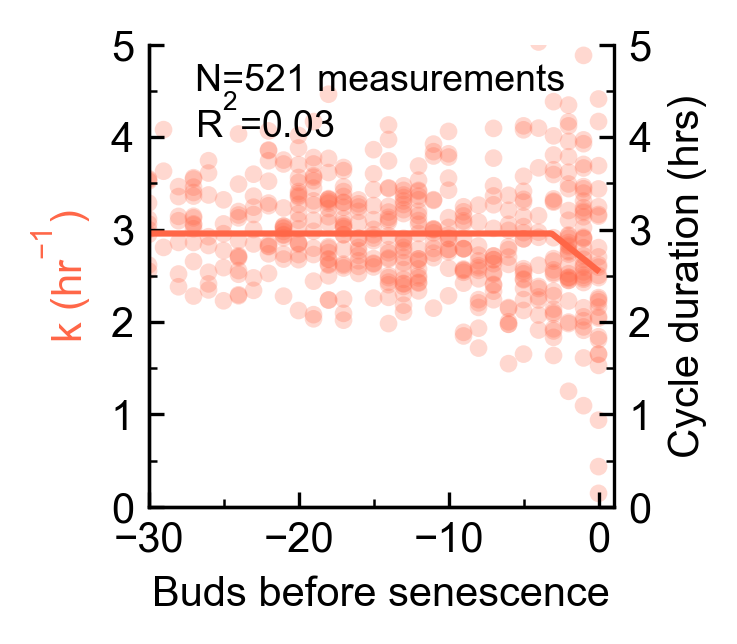

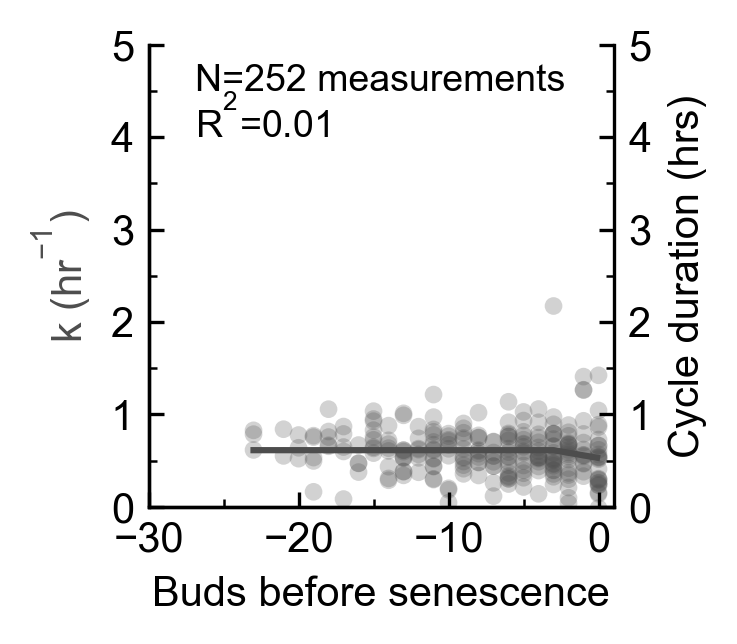

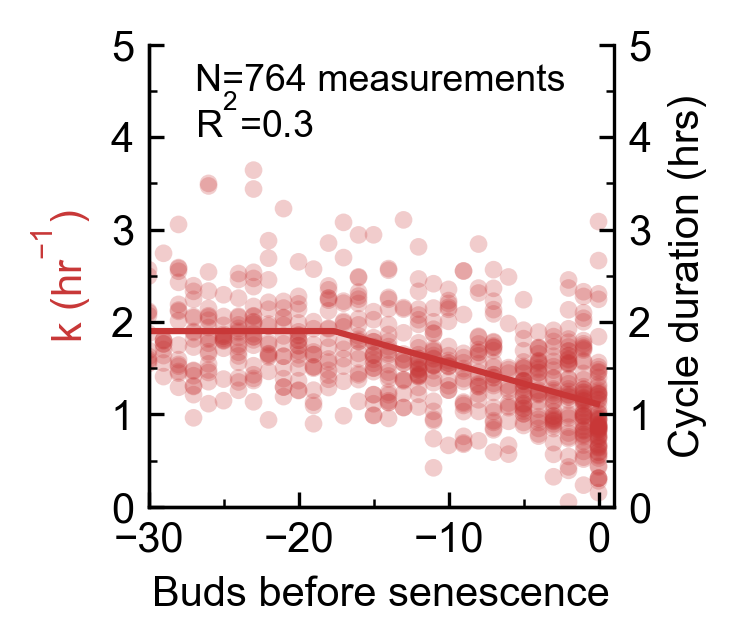

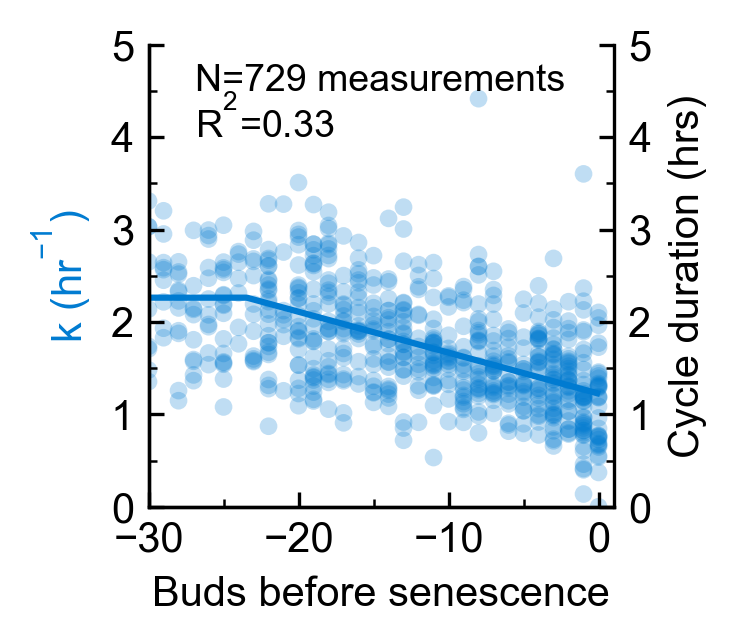

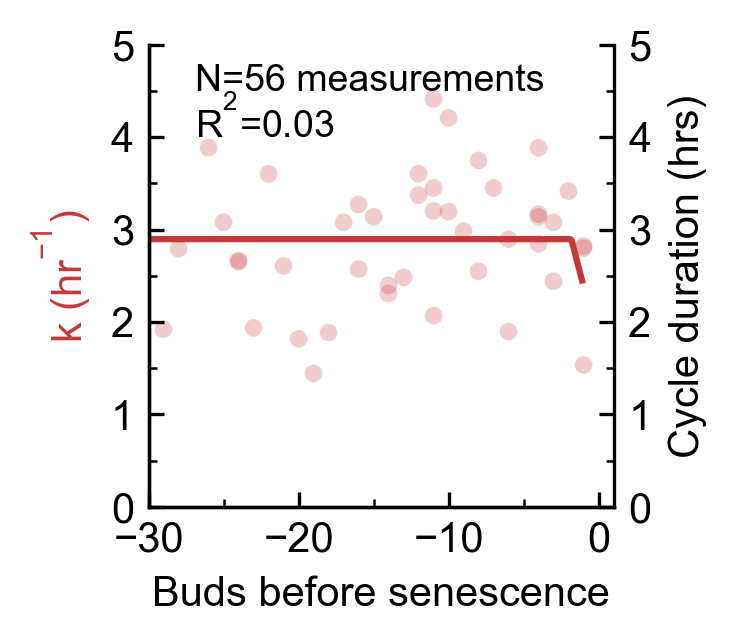

In [84]:
strains = [
    'wt_rkk',
    'wt_odc',
    'wt_ubl',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
    'ubr2_ubl'
]
dfs = []
results_dfs = []
for strain in strains[:]:
    compartments = constants.compartments_dict[strain]
    sub_fits_df = fits_df[
        (fits_df.compartment_name.isin(compartments)) &
        (~fits_df.buds_before_SEP.isna()) &
        (fits_df.x0_stderr_fraction.abs()<1)]
    sub_buds_df = buds_df[buds_df.compartment_name.isin(compartments)]
    result, results_df, x, y_pred, x_median, y_median = plotting.plot_k_vs_dist_from_sen(
        sub_fits_df,
        sub_buds_df,
        yvar1='b',
        yvar2=None,
        xvar='buds_after_death',
        fit_type='piecewise',
        xlabel='Buds before senescence',
        xlim=(-30, 1),
        ylim_k=(0, 5),
        ylim_cycle=(0, 5),
        shade_stderr=False,
        fillalpha=0.25,
        fillsep=False,
        width_scale=1,
    )
    # Adjust length of x and y median to be as long as 
    # x and y_pred. This is needed as in the case of piecewise
    # fitting where x is super sampled to smooth out y_pred
    x_median = np.append(x_median, np.full(len(x) - len(x_median), np.nan))
    y_median = np.append(y_median, np.full(len(y_pred) - len(y_median), np.nan))
    strain_fit_df = pd.DataFrame({
        'x': x,
        'y_pred': y_pred,
        'x_median': x_median,
        'y_median': y_median
    })
    results_dfs.append(results_df)
    
    for col in results_df.columns:
        if col != 'x':
            strain_fit_df.loc[:, col] = results_df.loc[0, col]
    dfs.append(strain_fit_df)
    print(f'Buds before SEP max of {sub_fits_df.buds_before_SEP.max()} and min of {sub_fits_df.buds_before_SEP.min()}')
    plt.close(fig)
    
all_strains_fit_df = pd.concat(dfs)
all_strains_fit_table = pd.concat(results_dfs)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=x_y=y_pred_hue=samplename.svg


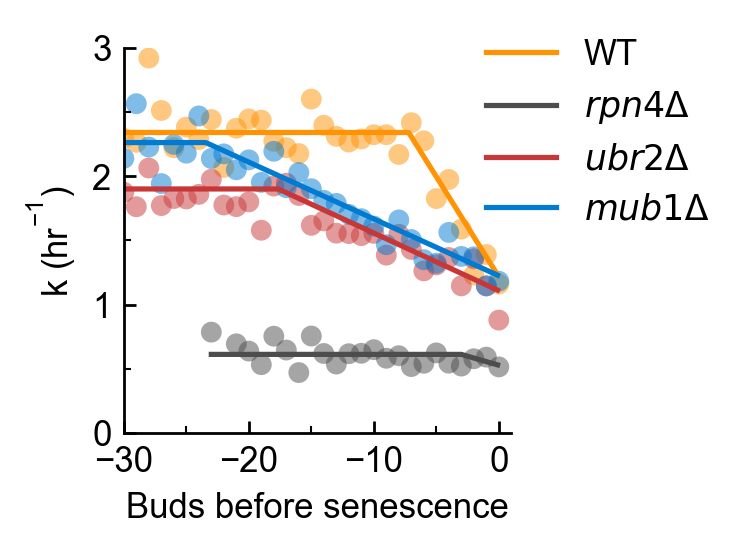

In [85]:
fig, ax = plotting.figure_ax()

strains = [
    'wt_rkk',
    'rpn4_rkk',
    'ubr2_rkk',
    'mub1_rkk',
]
keys = list(all_strains_fit_df.samplename.unique())
hues = [
    plotting.strains_color_dict['JPC121'],
    plotting.strains_color_dict['JPC263'],
    plotting.strains_color_dict['JPC262'],
    plotting.strains_color_dict['JPC274']
]

labels = [
    'WT',
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('ubr2'),
    plotting.get_gene_deletion_string('mub1'),
]
kwargs = {
    'x': 'x',
    'y': 'y_pred',
    'hue': 'samplename',
    'data': all_strains_fit_df[all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax
}

sns.lineplot(**kwargs)
kwargs2 = {
    'x': 'x_median',
    'y': 'y_median',
    'hue': 'samplename',
    'data': all_strains_fit_df[all_strains_fit_df.samplename.isin(strains)],
    'palette': hues,
    'hue_order': strains,
    'ax': ax,
    'linewidth': 0,
    'alpha': 0.5
}
sns.scatterplot(**kwargs2)

ax.legend(ax.get_legend_handles_labels()[0][0:4],
          labels,
          frameon=False,
          loc=(0.9, 0.5)          
         )

ax.set_xlabel('Buds before senescence')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlim(-30, 1)
ax.set_xticks(np.arange(-30, 1, 10))
ax.set_ylim(0, 3)
plotting.format_ticks(ax)

plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=buds_produced_after_deg_collapse_hue=samplename_dodge=False.svg


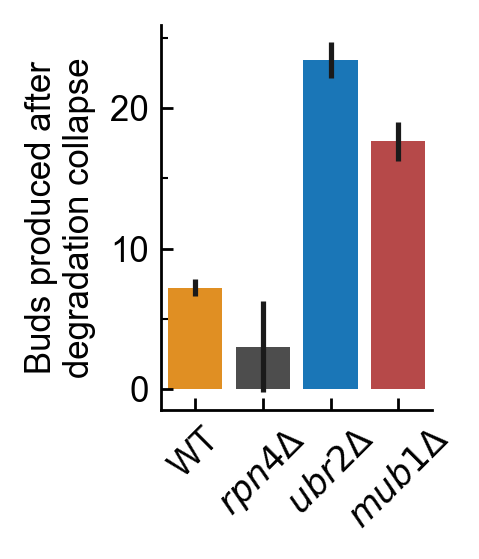

In [86]:
fig, ax = plotting.figure_ax(width_scale=0.7)

all_strains_fit_table.loc[:, 'buds_produced_after_deg_collapse'] = np.abs(all_strains_fit_table.x0)

samples = [
    'wt_rkk',
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk'
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC263'],
    strains_color_dict['JPC274'],
    strains_color_dict['JPC262'],
]

kwargs = {
    'x': 'samplename',
    'y': 'buds_produced_after_deg_collapse',
    'hue': 'samplename',
    'hue_order': samples,
    'order': samples,
    'palette': palette,
    'dodge': False,
    'data': all_strains_fit_table[all_strains_fit_table.samplename.isin(samples)],
    'yerr': all_strains_fit_table[all_strains_fit_table.samplename.isin(samples)].x0_stderr
}

sns.barplot(
    **kwargs
)
# ax.bar(
#     kwargs['data'][kwargs['x']],
#     kwargs['data'][kwargs['y']],
#     yerr=kwargs['data'][kwargs['xerr']]
# )
ax.legend_.set_visible(False)
ax.set_xlabel('')
ax.set_xticklabels(labels)
ax.set_ylabel('Buds produced after\ndegradation collapse')
plt.xticks(rotation=45)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

In [87]:
kwargs['data']

,x0,x0_stderr,x0_stderr_fraction,ndata,y0,y0_stderr,y0_stderr_fraction,k1,k1_stderr,k1_stderr_fraction,...,position,position_max,top,width,date,compartment_dir,compartment_reldir,compartment_name,date_sample,buds_produced_after_deg_collapse
0,-7.211009,0.609605,-0.084538,558,2.341429,0.030400,0.012984,-0.155967,0.016856,-0.108076,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.211009
0,-2.998970,3.239714,-1.080276,252,0.612284,0.019010,0.031048,-0.028180,0.039556,-1.403697,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.998970
0,-17.645049,1.250543,-0.070872,764,1.901256,0.027820,0.014633,-0.044923,0.003978,-0.088554,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.645049
0,-23.442411,1.414045,-0.060320,729,2.262797,0.042833,0.018929,-0.044271,0.003045,-0.068770,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23.442411


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=k1_hue=samplename_dodge=False.svg


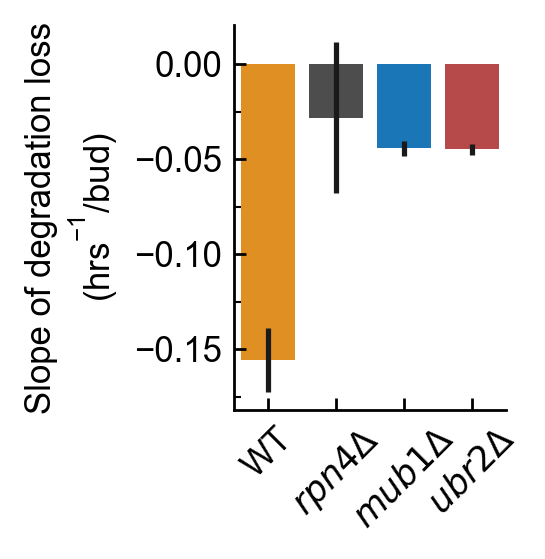

In [96]:
fig, ax = plotting.figure_ax(width_scale=0.7)

all_strains_fit_table.loc[:, 'buds_produced_after_deg_collapse'] = np.abs(all_strains_fit_table.x0)

samples = [
    'wt_rkk',
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk'
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC263'],
    strains_color_dict['JPC274'],
    strains_color_dict['JPC262'],
]

kwargs = {
    'x': 'samplename',
    'y': 'k1',
    'hue': 'samplename',
    'hue_order': samples,
    'order': samples,
    'palette': palette,
    'dodge': False,
    'data': all_strains_fit_table[all_strains_fit_table.samplename.isin(samples)],
    'yerr': all_strains_fit_table[all_strains_fit_table.samplename.isin(samples)].k1_stderr
}

sns.barplot(
    **kwargs
)
# ax.bar(
#     kwargs['data'][kwargs['x']],
#     kwargs['data'][kwargs['y']],
#     yerr=kwargs['data'][kwargs['xerr']]
# )
ax.legend_.set_visible(False)
ax.set_xlabel('')
ax.set_xticklabels(labels)
ax.set_ylabel('Slope of degradation loss\n($hrs^{-1}$/bud)')
plt.xticks(rotation=45)
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

In [87]:
kwargs['data'].loc[:, ['samplename', 'k1', 'k1_stderr']]

,samplename,k1,k1_stderr
0,wt_rkk,-0.155967,0.016856
0,rpn4_rkk,-0.018003,0.021325
0,ubr2_rkk,-0.044923,0.003978
0,mub1_rkk,-0.044271,0.003045


### Comparing buds produced after SEP between proteasome expression mutants

wt_rkk vs. rpn4_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:1.492e-06 U_stat=6.021e+04
wt_rkk vs. mub1_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:2.984e-17 U_stat=5.509e+04
wt_rkk vs. ubr2_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:7.370e-07 U_stat=6.677e+04
wt_rkk fold change over rpn4_rkk=1.2 +/- 0.282
rpn4_rkk fold change over wt_rkk=0.833 +/- 0.282
wt_rkk fold change over mub1_rkk=0.713 +/- 0.253
mub1_rkk fold change over wt_rkk=1.403 +/- 0.253
wt_rkk fold change over ubr2_rkk=0.767 +/- 0.299
ubr2_rkk fold change over wt_rkk=1.304 +/- 0.299
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=buds_produced_after_SEP_hue=samplename.svg


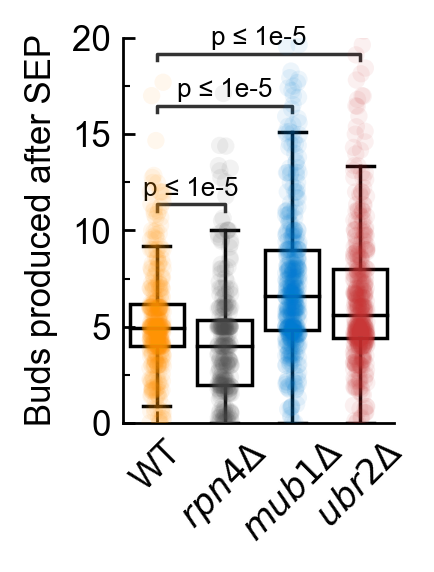

In [89]:
fig, ax = plotting.figure_ax(width_scale=0.7)
sepdf.loc[:, 'buds_produced_after_SEP'] = sepdf.x0*-1

samples = [
    'wt_rkk',
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk',
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC263'],
    strains_color_dict['JPC274'],
    strains_color_dict['JPC262'],
]

labels = [
    'WT',
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('mub1'),
    plotting.get_gene_deletion_string('ubr2')
]
kwargs = {
    'x': 'samplename',
    'y': 'buds_produced_after_SEP',
    'hue': 'samplename',
    'data': sepdf[(sepdf.samplename.isin(samples))&(sepdf.x0_stderr_fraction<1)&(sepdf.x0<0)],
    'order': samples,
    'palette': palette,
    # 'xerr': 'x0_stderr'
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False, dodge=False)
# sns.barplot(**kwargs)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
order = kwargs['order']
box_pairs=[
    ('wt_rkk', 'rpn4_rkk'),
    ('wt_rkk', 'mub1_rkk'),
    ('wt_rkk', 'ubr2_rkk'),
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.07, dodge=False)
for pair in box_pairs:
    datadf = kwargs['data']
    xval1 = pair[0]
    xval2 = pair[1]
    subdf = datadf[datadf[kwargs['x']].isin(pair)]
    data1 = subdf.loc[subdf[kwargs['x']]==xval1, kwargs['y']]
    data2 = subdf.loc[subdf[kwargs['x']]==xval2, kwargs['y']]
    fold_change_1_over_2 = np.round(data1.mean()/data2.mean(), 3)
    fold_change_2_over_1 = np.round(data2.mean()/data1.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    print(f'{xval1} fold change over {xval2}={fold_change_1_over_2} +/- {SEM_of_fold_change}')
    print(f'{xval2} fold change over {xval1}={fold_change_2_over_1} +/- {SEM_of_fold_change}')

ax.set_ylim(0, 20)
ax.set_xlabel('')
ax.set_xticklabels(labels)
ax.set_ylabel('Buds produced after SEP')
plt.xticks(rotation=45)
plotting.format_ticks(ax, add_minor_x=False)
ax.legend_.set_visible(False)
plotting.save_figure(fig, kwargs, ext='.svg')

wt_rkk vs. rpn4_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:1.245e-13 U_stat=3.223e+04
wt_rkk vs. mub1_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:9.847e-11 U_stat=6.179e+04
wt_rkk vs. ubr2_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:1.039e-05 U_stat=6.860e+04
wt_rkk fold change over rpn4_rkk=1.561 +/- 0.012
rpn4_rkk fold change over wt_rkk=0.64 +/- 0.012
wt_rkk fold change over mub1_rkk=1.358 +/- 0.01
mub1_rkk fold change over wt_rkk=0.736 +/- 0.01
wt_rkk fold change over ubr2_rkk=1.195 +/- 0.011
ubr2_rkk fold change over wt_rkk=0.837 +/- 0.011
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=k1_hue=samplename.svg


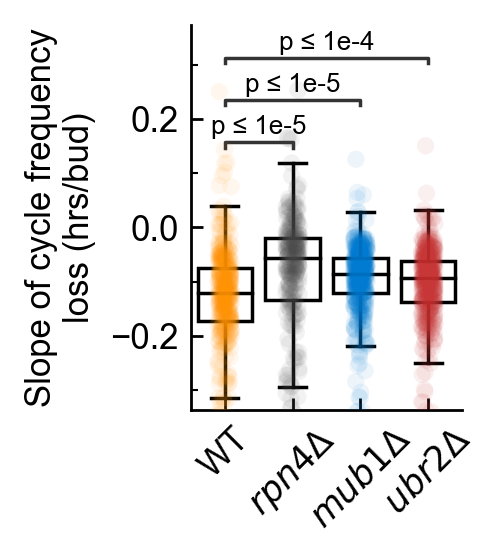

In [90]:
fig, ax = plotting.figure_ax(width_scale=0.7)
sepdf.loc[:, 'buds_produced_after_SEP'] = sepdf.x0*-1

samples = [
    'wt_rkk',
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk',
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC263'],
    strains_color_dict['JPC274'],
    strains_color_dict['JPC262'],
]

labels = [
    'WT',
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('mub1'),
    plotting.get_gene_deletion_string('ubr2')
]
kwargs = {
    'x': 'samplename',
    'y': 'k1',
    'hue': 'samplename',
    'data': sepdf[(sepdf.samplename.isin(samples))&(sepdf.x0_stderr_fraction<1)&(sepdf.x0<0)],
    'order': samples,
    'palette': palette,
    # 'xerr': 'x0_stderr'
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False, dodge=False)
# sns.barplot(**kwargs)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
order = kwargs['order']
box_pairs=[
    ('wt_rkk', 'rpn4_rkk'),
    ('wt_rkk', 'mub1_rkk'),
    ('wt_rkk', 'ubr2_rkk'),
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.07, dodge=False)
for pair in box_pairs:
    datadf = kwargs['data']
    xval1 = pair[0]
    xval2 = pair[1]
    subdf = datadf[datadf[kwargs['x']].isin(pair)]
    data1 = subdf.loc[subdf[kwargs['x']]==xval1, kwargs['y']]
    data2 = subdf.loc[subdf[kwargs['x']]==xval2, kwargs['y']]
    fold_change_1_over_2 = np.round(data1.mean()/data2.mean(), 3)
    fold_change_2_over_1 = np.round(data2.mean()/data1.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    print(f'{xval1} fold change over {xval2}={fold_change_1_over_2} +/- {SEM_of_fold_change}')
    print(f'{xval2} fold change over {xval1}={fold_change_2_over_1} +/- {SEM_of_fold_change}')

# ax.set_ylim(0, 20)
ax.set_xlabel('')
ax.set_xticklabels(labels)
ax.set_ylabel('Slope of cycle frequency\nloss (hrs/bud)')
plt.xticks(rotation=45)
plotting.format_ticks(ax, add_minor_x=False)
ax.legend_.set_visible(False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Comparing slope of cycle frequency decline after SEP

wt_rkk vs. rpn4_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:4.237e-06 U_stat=2.121e+04
wt_rkk vs. mub1_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:3.041e-08 U_stat=7.553e+04
wt_rkk vs. ubr2_rkk: Mann-Whitney-Wilcoxon test two-sided, P_val:5.652e-04 U_stat=8.300e+04
wt_rkk fold change over rpn4_rkk=1.388 +/- 0.014
rpn4_rkk fold change over wt_rkk=1.285 +/- 0.014
wt_rkk fold change over mub1_rkk=1.306 +/- 0.01
mub1_rkk fold change over wt_rkk=1.285 +/- 0.01
wt_rkk fold change over ubr2_rkk=1.15 +/- 0.01
ubr2_rkk fold change over wt_rkk=1.285 +/- 0.01
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=samplename_y=k1_hue=samplename.svg


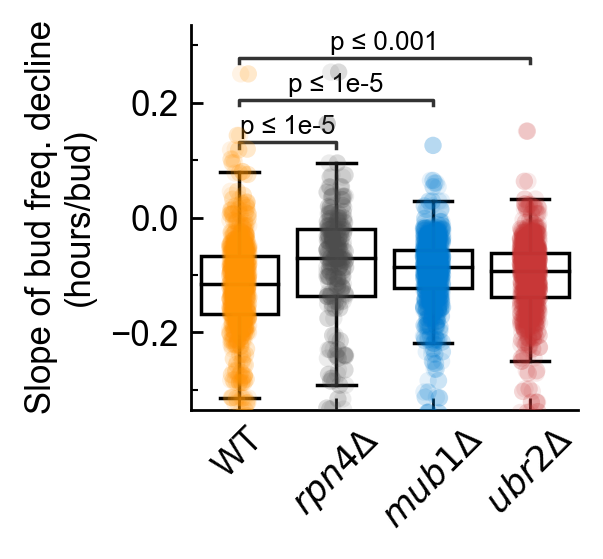

In [61]:
fig, ax = plotting.figure_ax(width_scale=1)
sepdf.loc[:, 'buds_produced_after_SEP'] = sepdf.x0*-1

samples = [
    'wt_rkk',
    'rpn4_rkk',
    'mub1_rkk',
    'ubr2_rkk',
]

palette = [
    strains_color_dict['JPC121'],
    strains_color_dict['JPC263'],
    strains_color_dict['JPC274'],
    strains_color_dict['JPC262'],
]

labels = [
    'WT',
    plotting.get_gene_deletion_string('rpn4'),
    plotting.get_gene_deletion_string('mub1'),
    plotting.get_gene_deletion_string('ubr2')
]
kwargs = {
    'x': 'samplename',
    'y': 'k1',
    'hue': 'samplename',
    'data': sepdf[(sepdf.samplename.isin(samples))&(sepdf.x0_stderr_fraction<1)&(sepdf.x0<0)],
    'order': samples,
    'palette': palette,
    # 'xerr': 'x0_stderr'
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False, dodge=False)

# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
order = kwargs['order']
box_pairs=[
    ('wt_rkk', 'rpn4_rkk'),
    ('wt_rkk', 'mub1_rkk'),
    ('wt_rkk', 'ubr2_rkk'),
]
test='Mann-Whitney'
text_format="full"
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,)
                    # comparisons_correction="bonferroni",)
annotator.apply_and_annotate()
# Wait to plot strip so that the annotator won't plot
# All the way up at the highest outlier
sns.stripplot(**kwargs, alpha=0.2, dodge=False)
for pair in box_pairs:
    datadf = kwargs['data']
    xval1 = pair[0]
    xval2 = pair[1]
    subdf = datadf[datadf[kwargs['x']].isin(pair)]
    data1 = subdf.loc[subdf[kwargs['x']]==xval1, kwargs['y']]
    data2 = subdf.loc[subdf[kwargs['x']]==xval2, kwargs['y']]
    fold_change_1_over_2 = np.round(data1.mean()/data2.mean(), 3)
    SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
    SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
    SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
    SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
    fold_change_2_over_1 = np.round(1/fold_change_1_over_2, 3)
    print(f'{xval1} fold change over {xval2}={fold_change_1_over_2} +/- {SEM_of_fold_change}')
    print(f'{xval2} fold change over {xval1}={fold_change_old_over_young} +/- {SEM_of_fold_change}')

sns.stripplot(**kwargs, alpha=0.1)
# ax.set_ylim(0, 20)
ax.set_xlabel('')
ax.set_xticklabels(labels)
ax.set_ylabel('Slope of bud freq. decline\n(hours/bud)')
plt.xticks(rotation=45)
plotting.format_ticks(ax, add_minor_x=False)
ax.legend_.set_visible(False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Degradation of RKK and UBL and ODC in WT and rpn4&Delta;

rpn4d-UBL_True vs. rpn4d-UBL_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=1.776e+03
WT-UBL_True vs. WT-UBL_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.182e-01 U_stat=3.995e+03
WT-ODC_True vs. WT-ODC_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=4.399e+04
rpn4d-ODC_True vs. rpn4d-ODC_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:8.473e-02 U_stat=6.660e+02
WT-RKK_True vs. WT-RKK_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:5.080e-61 U_stat=4.231e+04
rpn4d-RKK_True vs. rpn4d-RKK_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=8.390e+02
WT-DsRed_True vs. WT-DsRed_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:2.807e-09 U_stat=1.270e+02
Saved figure at 
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig2_JPC258-J

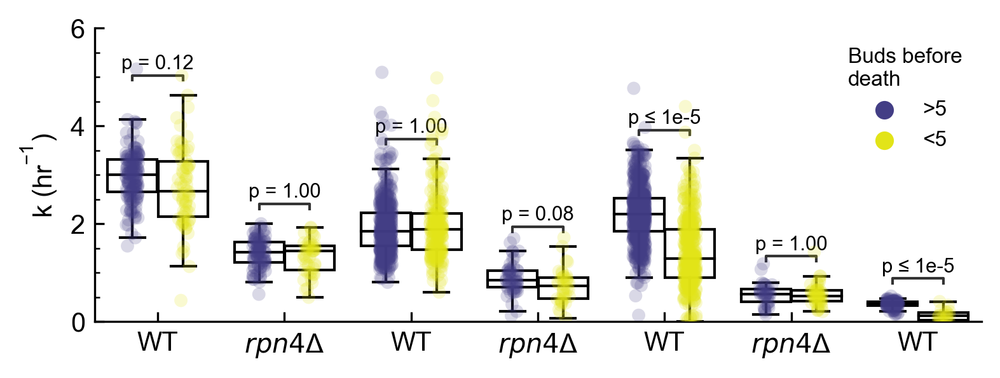

In [4]:
fits_df.loc[fits_df.compartment_name=='20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741_rfp', 'strain_name'] = 'JPC258_r'
from statannotations.Annotator import Annotator
strain_groups = [
    ['JPC258', 'JPC228'],
    ['JPC257'],
    ['JPC122'],
    ['JPC261'],
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC263'],
    ['JPC258_r']    
]
# strain_groups = strain_groups[0:
strains = []
for group in strain_groups:
    for strain in group:
        strains.append(strain)

bg_substrates = [
    'WT-UBL',
    'rpn4d-UBL',
    'WT-ODC',
    'rpn4d-ODC',
    'WT-RKK',
    'rpn4d-RKK',
    'WT-DsRed'
]

# bg_substrates = bg_substrates[0:4]

skip_comps = [
]

bound1 = 5
bound2 = 5
fits_df.loc[:, 'post-sep'] = np.nan
fits_df.loc[fits_df.dist_from_sen<bound1, 'post-sep'] = True
fits_df.loc[fits_df.dist_from_sen>bound2, 'post-sep'] = False
subdf = fits_df[fits_df.strain_name.isin(strains)]
subdf = subdf[~subdf.compartment_name.isin(skip_comps)]
for idx, strain_group in enumerate(strain_groups):
    subdf.loc[subdf.strain_name.isin(strain_group), 'background_substrate'] = bg_substrates[idx]

fig, ax = plotting.figure_ax(width_scale=3)
fig.set_dpi(300)

stripkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'data': subdf,
    'palette': pre_post_SEP_palette,
    'alpha': 0.2
}

boxkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'data': subdf,
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'palette': pre_post_SEP_palette,
    'showfliers': False
}
sns.boxplot(**boxkwargs, **plotting.transparent_boxes_prop_dict)

ax.set_xticklabels(bg_substrates)
ax.set_xlabel('')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5 buds befored death', '<5 buds before death'],
          frameon=False,
          title='',
          bbox_to_anchor=(0.6, 1))

# plt.xticks(rotation=45)

# annotate t-test results
data=stripkwargs['data']
x = stripkwargs['x']
y = stripkwargs['y']
hue = stripkwargs['hue']
order = stripkwargs['order']
box_pairs=[
    (('WT-UBL', True), ("WT-UBL", False)),
    (('rpn4d-UBL', True), ("rpn4d-UBL", False)),
    (("WT-ODC", True), ("WT-ODC", False)),
    (("rpn4d-ODC", True), ("rpn4d-ODC", False)),
    (("WT-RKK", True), ("WT-RKK", False)),
    (("rpn4d-RKK", True), ("rpn4d-RKK", False)),
    (("WT-DsRed", True), ("WT-DsRed", False))
]

box_pairs = box_pairs
test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni")
annotator.apply_and_annotate()

sns.stripplot(**stripkwargs)
ax.set_ylim(0, 6)
legend = ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5', '<5'], title='Buds before\ndeath', fontsize=8, frameon=False)
legend.get_title().set_fontsize(8)
ax.set_xticklabels(['WT',
                    plotting.get_gene_deletion_string('rpn4'),
                    'WT',
                    plotting.get_gene_deletion_string('rpn4'),
                    'WT',
                    plotting.get_gene_deletion_string('rpn4'),
                    'WT'])
ax.set_xlabel('')
plotting.format_ticks(ax, add_minor_x=False, yminorspace=0.5)
filetype = '.svg'
strainnames = '-'.join(strains)
savepath = os.path.join(constants.byc_data_dir, f'meta/plots/fig2_{strainnames}_pre-post-SEP_summary{filetype}')
savepath = os.path.abspath(savepath)
fig.savefig(savepath)
print(f'Saved figure at \n{savepath}')

# Save subdf so it can be analyzed in R
subdf.to_csv(os.path.join(constants.byc_data_dir, 'subdf_wt_vs_rpn4_across_substrates.csv'), index=False)

### Degradation of UBL and ODC in WT and rpn4&Delta;

rpn4d-UBL_False vs. rpn4d-UBL_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:3.770e-03 U_stat=9.822e+03
WT-UBL_False vs. WT-UBL_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.615e-02 U_stat=3.392e+04
WT-ODC_False vs. WT-ODC_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=4.420e+04
rpn4d-ODC_False vs. rpn4d-ODC_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.715e-03 U_stat=4.679e+03
Saved figure at 
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig2_JPC258-JPC228-JPC257-JPC122-JPC261_pre-post-SEP_summary.svg


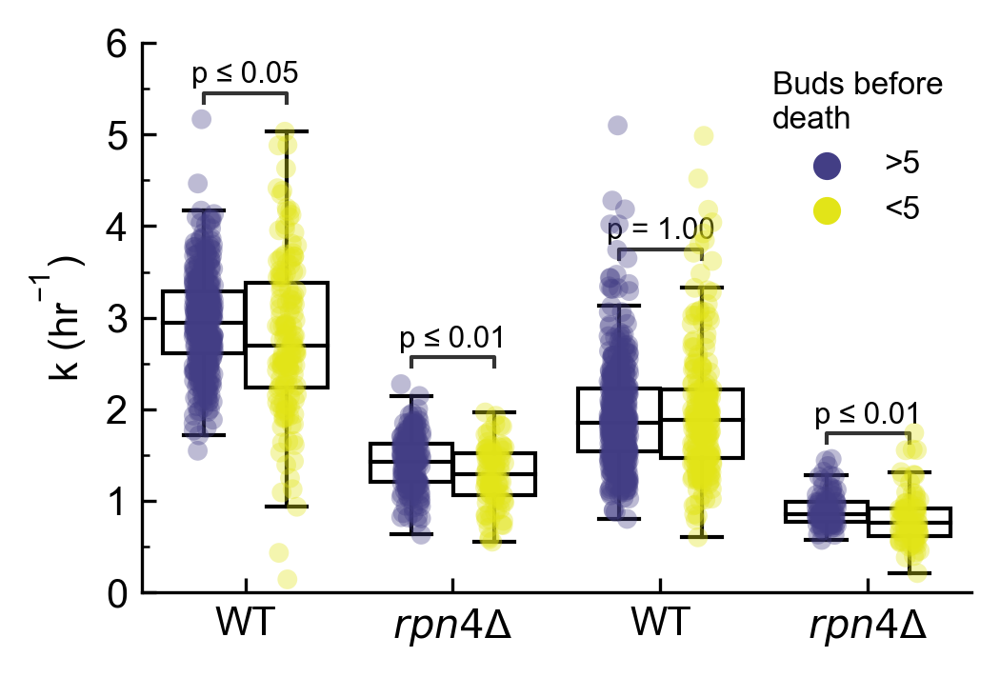

In [45]:
fits_df.loc[fits_df.compartment_name=='20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741_rfp', 'strain_name'] = 'JPC258_r'
from statannotations.Annotator import Annotator
strain_groups = [
    ['JPC258', 'JPC228'],
    ['JPC257'],
    ['JPC122'],
    ['JPC261'],
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC263'],
    ['JPC258_r']    
]
strain_groups = strain_groups[0:4]
strains = []
for group in strain_groups:
    for strain in group:
        strains.append(strain)

bg_substrates = [
    'WT-UBL',
    'rpn4d-UBL',
    'WT-ODC',
    'rpn4d-ODC',
    'WT-RKK',
    'rpn4d-RKK',
    'WT-DsRed'
]

bg_substrates = bg_substrates[0:4]

skip_comps = [
]

bound1 = 5
bound2 = 5
fits_df.loc[:, 'post-sep'] = np.nan
fits_df.loc[fits_df.dist_from_sen<bound1, 'post-sep'] = True
fits_df.loc[fits_df.dist_from_sen>bound2, 'post-sep'] = False
subdf = fits_df[fits_df.strain_name.isin(strains)]
subdf = subdf[~subdf.compartment_name.isin(skip_comps)]
for idx, strain_group in enumerate(strain_groups):
    subdf.loc[subdf.strain_name.isin(strain_group), 'background_substrate'] = bg_substrates[idx]

fig, ax = plotting.figure_ax(width_scale=1.5)
fig.set_dpi(300)

stripkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'data': subdf,
    'palette': pre_post_SEP_palette,
    'alpha': 0.35
}

boxkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'data': subdf,
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'palette': pre_post_SEP_palette,
    'showfliers': False
}
sns.boxplot(**boxkwargs, **plotting.transparent_boxes_prop_dict)

ax.set_xticklabels(bg_substrates)
ax.set_xlabel('')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5 buds befored death', '<5 buds before death'],
          frameon=False,
          title='',
          bbox_to_anchor=(0.6, 1))

# plt.xticks(rotation=45)

# annotate t-test results
data=stripkwargs['data']
x = stripkwargs['x']
y = stripkwargs['y']
hue = stripkwargs['hue']
order = stripkwargs['order']
box_pairs=[
    (('WT-UBL', True), ("WT-UBL", False)),
    (('rpn4d-UBL', True), ("rpn4d-UBL", False)),
    (("WT-ODC", True), ("WT-ODC", False)),
    (("rpn4d-ODC", True), ("rpn4d-ODC", False)),
    (("WT-RKK", True), ("WT-RKK", False)),
    (("rpn4d-RKK", True), ("rpn4d-RKK", False)),
    (("WT-DsRed", True), ("WT-DsRed", False))
]

box_pairs = box_pairs[0:4]
test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni")
annotator.apply_and_annotate()

sns.stripplot(**stripkwargs)
ax.set_ylim(0, 6)
legend = ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5', '<5'], title='Buds before\ndeath', fontsize=8, frameon=False)
legend.get_title().set_fontsize(8)
ax.set_xticklabels(['WT', plotting.get_gene_deletion_string('rpn4'), 'WT', plotting.get_gene_deletion_string('rpn4')])
ax.set_xlabel('')
plotting.format_ticks(ax, add_minor_x=False, yminorspace=0.5)
filetype = '.svg'
strainnames = '-'.join(strains)
savepath = os.path.join(constants.byc_data_dir, f'meta/plots/fig2_{strainnames}_pre-post-SEP_summary{filetype}')
savepath = os.path.abspath(savepath)
fig.savefig(savepath)
print(f'Saved figure at \n{savepath}')

# Save subdf so it can be analyzed in R
subdf.to_csv(os.path.join(constants.byc_data_dir, 'subdf_wt_vs_rpn4_across_substrates.csv'), index=False)

### Degradation of RKK in WT and rpn4&Delta; and DsRed in WT

rpn4d-RKK_True vs. rpn4d-RKK_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=8.390e+02
WT-RKK_True vs. WT-RKK_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:2.177e-61 U_stat=4.231e+04
WT-DsRed_True vs. WT-DsRed_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.203e-09 U_stat=1.270e+02
Saved figure at 
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig2_JPC121-JPC146-JPC220-JPC263-JPC258_r_pre-post-SEP_summary.svg


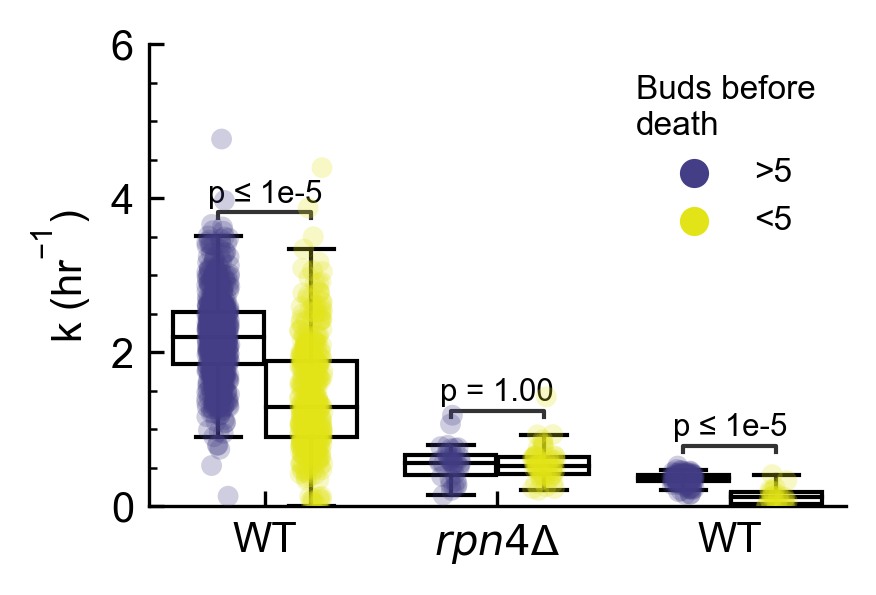

In [29]:
fits_df.loc[fits_df.compartment_name=='20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741_rfp', 'strain_name'] = 'JPC258_r'
from statannotations.Annotator import Annotator
range_to_plot = [4, 7]
strain_groups = [
    ['JPC258', 'JPC228'],
    ['JPC257'],
    ['JPC122'],
    ['JPC261'],
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC263'],
    ['JPC258_r']    
]
strain_groups = strain_groups[range_to_plot[0]:range_to_plot[1]]
strains = []
for group in strain_groups:
    for strain in group:
        strains.append(strain)

bg_substrates = [
    'WT-UBL',
    'rpn4d-UBL',
    'WT-ODC',
    'rpn4d-ODC',
    'WT-RKK',
    'rpn4d-RKK',
    'WT-DsRed'
]

bg_substrates = bg_substrates[range_to_plot[0]:range_to_plot[1]]

skip_comps = [
]

bound1 = 5
bound2 = 5
fits_df.loc[:, 'post-sep'] = np.nan
fits_df.loc[fits_df.dist_from_sen<bound1, 'post-sep'] = True
fits_df.loc[fits_df.dist_from_sen>bound2, 'post-sep'] = False
subdf = fits_df[fits_df.strain_name.isin(strains)]
subdf = subdf[~subdf.compartment_name.isin(skip_comps)]
for idx, strain_group in enumerate(strain_groups):
    subdf.loc[subdf.strain_name.isin(strain_group), 'background_substrate'] = bg_substrates[idx]

fig, ax = plotting.figure_ax(width_scale=1.5)
fig.set_dpi(300)

stripkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'data': subdf,
    'palette': pre_post_SEP_palette,
    'alpha': 0.25
}

boxkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'data': subdf,
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'palette': pre_post_SEP_palette,
    'showfliers': False
}
sns.boxplot(**boxkwargs, **plotting.transparent_boxes_prop_dict)

ax.set_xticklabels(bg_substrates)
ax.set_xlabel('')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5 buds befored death', '<5 buds before death'],
          frameon=False,
          title='',
          bbox_to_anchor=(0.6, 1))

# plt.xticks(rotation=45)

# annotate t-test results
data=stripkwargs['data']
x = stripkwargs['x']
y = stripkwargs['y']
hue = stripkwargs['hue']
order = stripkwargs['order']
box_pairs=[
    (('WT-UBL', True), ("WT-UBL", False)),
    (('rpn4d-UBL', True), ("rpn4d-UBL", False)),
    (("WT-ODC", True), ("WT-ODC", False)),
    (("rpn4d-ODC", True), ("rpn4d-ODC", False)),
    (("WT-RKK", True), ("WT-RKK", False)),
    (("rpn4d-RKK", True), ("rpn4d-RKK", False)),
    (("WT-DsRed", True), ("WT-DsRed", False))
]

box_pairs = box_pairs[range_to_plot[0]:range_to_plot[1]]
test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni")
annotator.apply_and_annotate()

sns.stripplot(**stripkwargs)
ax.set_ylim(0, 6)
legend = ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5', '<5'], title='Buds before\ndeath', fontsize=8, frameon=False)
legend.get_title().set_fontsize(8)
ax.set_xticklabels(['WT', plotting.get_gene_deletion_string('rpn4'), 'WT'])
ax.set_xlabel('')
plotting.format_ticks(ax, add_minor_x=False, yminorspace=0.5)
filetype = '.svg'
strainnames = '-'.join(strains)
savepath = os.path.join(constants.byc_data_dir, f'meta/plots/fig2_{strainnames}_pre-post-SEP_summary{filetype}')
savepath = os.path.abspath(savepath)
fig.savefig(savepath)
print(f'Saved figure at \n{savepath}')

# Save subdf so it can be analyzed in R
subdf.to_csv(os.path.join(constants.byc_data_dir, 'subdf_wt_vs_rpn4_across_substrates.csv'), index=False)

### Degradation of RKK rpn4&Delta; and DsRed in WT

WT-DsRed_False vs. WT-DsRed_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.203e-09 U_stat=1.889e+03
rpn4d-RKK_False vs. rpn4d-RKK_True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:1.000e+00 U_stat=9.460e+02
rpn4d-RKK_True vs. WT-DsRed_False: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val:6.592e-11 U_stat=4.093e+03
Saved figure at 
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig2_JPC263-JPC258_r_pre-post-SEP_summary.svg


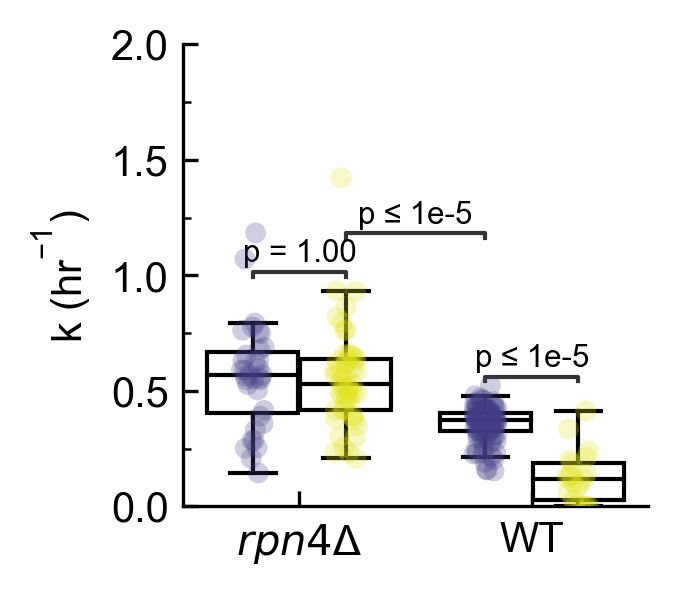

In [235]:
fits_df.loc[fits_df.compartment_name=='20230201_byc_JPC228-20230127-int_UBL-YFP-Su9x3_BY4741_rfp', 'strain_name'] = 'JPC258_r'
from statannotations.Annotator import Annotator
range_to_plot = [5, 7]
strain_groups = [
    ['JPC258', 'JPC228'],
    ['JPC257'],
    ['JPC122'],
    ['JPC261'],
    ['JPC121', 'JPC146', 'JPC220'],
    ['JPC263'],
    ['JPC258_r']    
]
strain_groups = strain_groups[range_to_plot[0]:range_to_plot[1]]
strains = []
for group in strain_groups:
    for strain in group:
        strains.append(strain)

bg_substrates = [
    'WT-UBL',
    'rpn4d-UBL',
    'WT-ODC',
    'rpn4d-ODC',
    'WT-RKK',
    'rpn4d-RKK',
    'WT-DsRed'
]

bg_substrates = bg_substrates[range_to_plot[0]:range_to_plot[1]]

skip_comps = [
]

bound1 = 5
bound2 = 5
fits_df.loc[:, 'post-sep'] = np.nan
fits_df.loc[fits_df.dist_from_sen<bound1, 'post-sep'] = True
fits_df.loc[fits_df.dist_from_sen>bound2, 'post-sep'] = False
subdf = fits_df[fits_df.strain_name.isin(strains)]
subdf = subdf[~subdf.compartment_name.isin(skip_comps)]
for idx, strain_group in enumerate(strain_groups):
    subdf.loc[subdf.strain_name.isin(strain_group), 'background_substrate'] = bg_substrates[idx]

fig, ax = plotting.figure_ax(width_scale=1)
fig.set_dpi(300)

stripkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'data': subdf,
    'palette': pre_post_SEP_palette,
    'alpha': 0.25
}

boxkwargs = {
    'x': 'background_substrate',
    'y': 'b',
    'data': subdf,
    'hue': 'post-sep',
    'hue_order': [False, True],
    'order': bg_substrates,
    'ax': ax,
    'dodge': True,
    'palette': pre_post_SEP_palette,
    'showfliers': False
}
sns.boxplot(**boxkwargs, **plotting.transparent_boxes_prop_dict)

ax.set_xticklabels(bg_substrates)
ax.set_xlabel('')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5 buds befored death', '<5 buds before death'],
          frameon=False,
          title='',
          bbox_to_anchor=(0.6, 1))

# plt.xticks(rotation=45)

# annotate t-test results
data=stripkwargs['data']
x = stripkwargs['x']
y = stripkwargs['y']
hue = stripkwargs['hue']
order = stripkwargs['order']
box_pairs=[
    (("rpn4d-RKK", True), ("rpn4d-RKK", False)),
    (("WT-DsRed", True), ("WT-DsRed", False)),
    (("rpn4d-RKK", True), ("WT-DsRed", False))
]

# box_pairs = box_pairs[range_to_plot[0]:range_to_plot[1]]
test='Mann-Whitney'
text_format="simple"
loc="inside"

annotator = Annotator(ax, box_pairs, hue=hue, data=data, x=x, y=y, order=order,)
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=7.5,
                    comparisons_correction="bonferroni")
annotator.apply_and_annotate()

sns.stripplot(**stripkwargs)
ax.set_ylim(0, 2)
ax.legend(ax.get_legend_handles_labels()[0][2:4], ['>5', '<5'], title='Buds before\ndeath', fontsize=8, frameon=False)
ax.legend_.set_visible(False)
ax.set_xticklabels([plotting.get_gene_deletion_string('rpn4'), 'WT'])
ax.set_xlabel('')
plotting.format_ticks(ax, add_minor_x=False, yminorspace=0.25)
filetype = '.svg'
strainnames = '-'.join(strains)
savepath = os.path.join(constants.byc_data_dir, f'meta/plots/fig2_{strainnames}_pre-post-SEP_summary{filetype}')
savepath = os.path.abspath(savepath)
fig.savefig(savepath)
print(f'Saved figure at \n{savepath}')

# Save subdf so it can be analyzed in R
subdf.to_csv(os.path.join(constants.byc_data_dir, 'subdf_wt_vs_rpn4_across_substrates.csv'), index=False)

## Miscellaneous

### Multiple measurements in the same cell analysis

#### Get the subset of data

In [150]:
compartments = constants.compartments_dict['wt_rkk']
strains = fits_df.loc[fits_df.compartment_name.isin(compartments), 'strain_name'].unique()

sub_fits_df = fits_df[fits_df.compartment_name.isin(compartments)]
sub_fits_df = sub_fits_df[sub_fits_df.dist_from_sen>=0]
sub_fits_df = sub_fits_df[~sub_fits_df.b.isna()]
sub_bud_df = buds_df[buds_df.compartment_name.isin(compartments)]
ratecolor = strains_color_dict[strains[0]]

#### Plot "vectors" with a line for each cell

C:\Users\johnp\AppData\Local\Temp\ipykernel_3708\3975215962.py:18: UserWarning: The palette list has more values (330) than needed (329), which may not be intended.
  sns.lineplot(**kwargs)


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_after_death_y=b_hue=bud_id_alpha=0.12_linewidth=1.svg


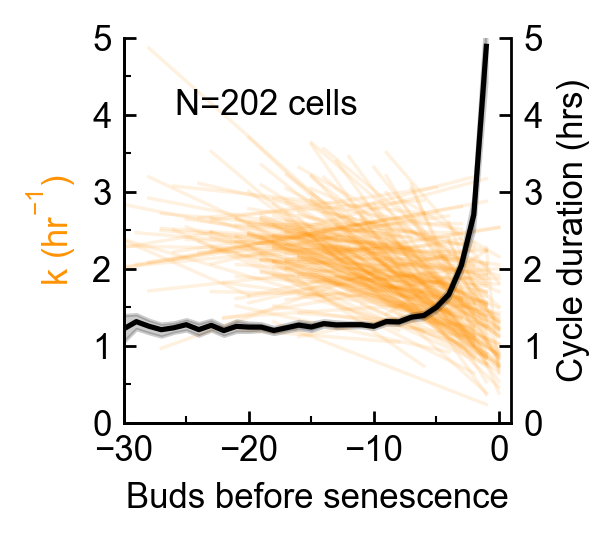

In [151]:
fig, ax = plotting.figure_ax()

xlim = (-30, 1)
xticks = np.arange(xlim[0], xlim[1]+0.1, 10)
ylim = (0, 5)
yticks = np.arange(ylim[0], ylim[1]+0.1, 1)
kwargs = {
    'x': 'buds_after_death',
    'y': 'b',
    'hue': 'bud_id',
    'data': sub_fits_df,
    'ax': ax,
    'alpha': 0.12,
    'linewidth': 1,
    'palette': [ratecolor for i in range(len(sub_fits_df.bud_id.unique()))]
}
# Plot data
sns.lineplot(**kwargs)
# Plot cycle duration
ax2 = ax.twinx()
kwargs2 = {
    'x': 'buds_after_death',
    'y': 'cycle_duration_hrs',
    'data': sub_bud_df,
    'ax': ax2,
    'color': 'black'
}
sns.lineplot(**kwargs2)
# Plot aesthetics
plotting.format_ticks(ax2)
ax2.spines['top'].set_visible(False)
ax2.set_ylim(0, 5)
ax.set_ylim(0, 3)
plotting.format_ticks(ax)
ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'), color=ratecolor)
ax2.set_ylabel('Cycle duration (hrs)')
# Formatting
ax.legend_.set_visible(False)
ax.set_xlim(xlim)
ax.set_xticks(xticks)
ax.set_ylim(ylim)
ax.set_yticks(yticks)
plotting.format_ticks(ax)
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs, color=ratecolor)
ax.set_xlabel('Buds before senescence')
# Count the number of cells with two measurements
table = sub_fits_df.loc[:, ['bud_id', 'buds_after_death', 'b']].pivot_table(index=['bud_id'], aggfunc='count').reset_index()
n_val = len(table[table.b==2].bud_id.unique())
ax.annotate(f'N={n_val} cells', xy=(0.35, 0.85), xycoords='figure fraction')
# Save figure
plotting.save_figure(fig, kwargs, ext='.svg')

#### Calculate and plot fold changes between chase 1 and 2

In [152]:
multimeasure_bud_ids = [bud_id for bud_id in sub_fits_df.bud_id.unique() if len(sub_fits_df.loc[sub_fits_df.bud_id==bud_id, :])==2]
multimeasuredf = sub_fits_df[sub_fits_df.bud_id.isin(multimeasure_bud_ids)]

chase1_df = multimeasuredf[multimeasuredf.abs_chase_frame<100]
chase2_df = multimeasuredf[multimeasuredf.abs_chase_frame>100]

for df in [chase1_df, chase2_df]:
    df.sort_values(by='bud_id', ascending=True, inplace=True)
    if 'level_0' in df.columns:
        df.drop(columns='level_0', inplace=True, axis=1)
    df.reset_index(inplace=True)
    if 'level_0' in df.columns:
        df.drop(columns='level_0', inplace=True, axis=1)    
# We should have perfectly paired chases for same cell when
# young and old
chasedf = pd.merge(chase1_df, chase2_df, on='bud_id', suffixes=('_chase1', '_chase2'))
chasedf.loc[:, 'b_chase1_over_b_chase2'] = chasedf.b_chase1/chasedf.b_chase2
chasedf.loc[:, 'b_chase2_over_b_chase1'] = chasedf.b_chase2/chasedf.b_chase1

C:\Users\johnp\AppData\Local\Temp\ipykernel_3708\100309678.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.sort_values(by='bud_id', ascending=True, inplace=True)
C:\Users\johnp\AppData\Local\Temp\ipykernel_3708\100309678.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns='level_0', inplace=True, axis=1)
C:\Users\johnp\AppData\Local\Temp\ipykernel_3708\100309678.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

Text(0.5, 0, 'Buds before SEP (chase 2)')

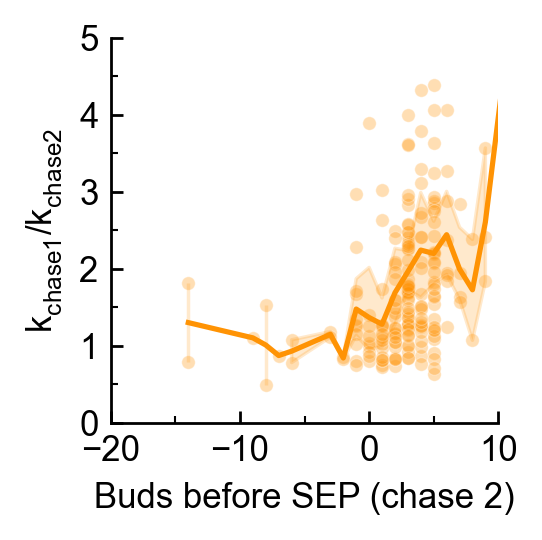

In [308]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'buds_before_SEP_chase2',
    'y': 'b_chase1_over_b_chase2',
    'data': chasedf,
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
sns.lineplot(**kwargs, estimator='mean')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 5)
ax.set_xlim(-20, 10)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
plotting.format_ticks(ax)

ax.set_ylabel((r'$k_{chase1}$/$k_{chase2}$'))
ax.set_xlabel('Buds before SEP (chase 2)')

Text(0.5, 0, 'Buds before death (chase 2)')

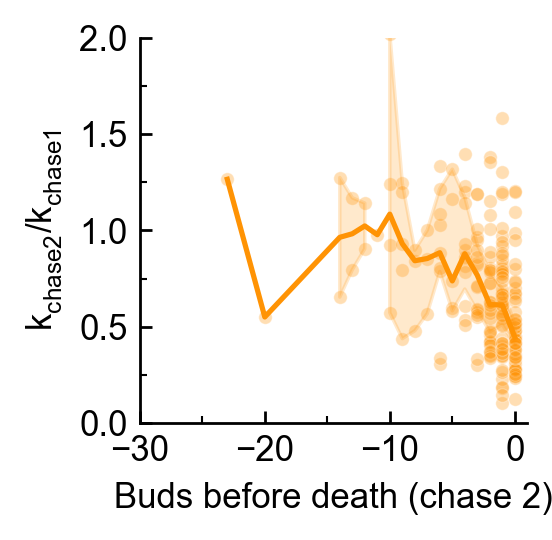

In [153]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'buds_after_death_chase2',
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf,
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
sns.lineplot(**kwargs, estimator='median')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 2)
ax.set_xlim(-30, 1)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
plotting.format_ticks(ax)

ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xlabel('Buds before death (chase 2)')

Text(0.5, 0, 'Buds before SEP (chase 2)')

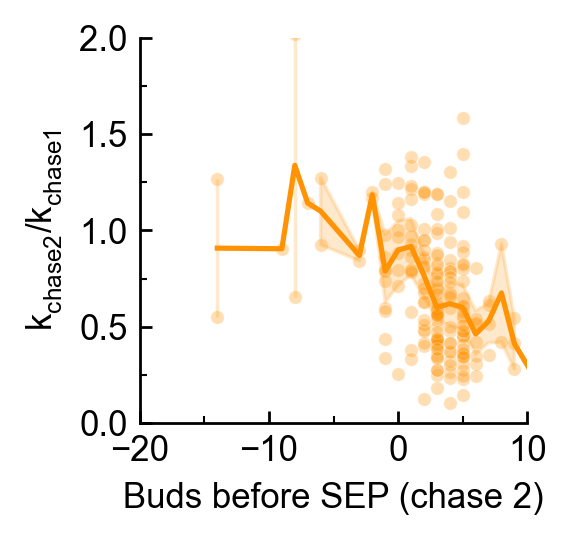

In [310]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'buds_before_SEP_chase2',
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf,
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
sns.lineplot(**kwargs, estimator='mean')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 2)
ax.set_xlim(-20, 10)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
plotting.format_ticks(ax)

ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xlabel('Buds before SEP (chase 2)')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\file=name.svg


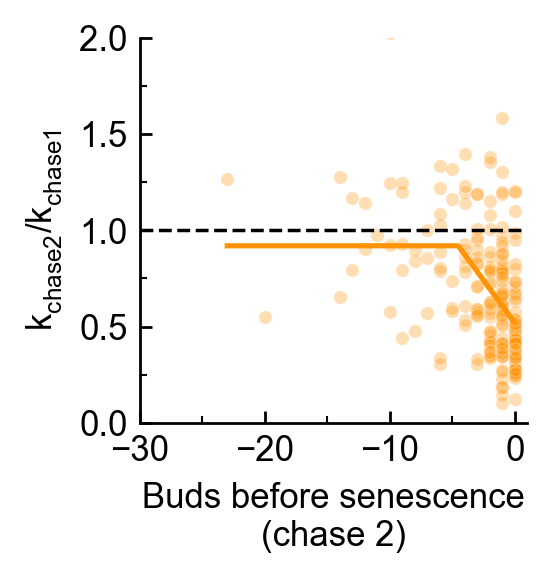

In [164]:
# fit to logistic
yvar1 = 'b_chase2_over_b_chase1'
xvar = 'buds_after_death_chase2'
result, results_df = fitting_tools.fit_model_to_df(chasedf, ~chasedf[yvar1].isna(),
                                                fitting_tools.model_guesses.piecewise_linear[0],
                                                fitting_tools.model_guesses.piecewise_linear[1],
                                                yvar=yvar1,
                                                xvar=xvar
                                                )
x = np.sort(chasedf[xvar].unique())
x_smooth = np.arange(np.min(x), np.max(x), 0.1)
y_pred = result.model.eval(params=result.params, x=x)
y_pred_smooth = result.model.eval(params=result.params, x=x_smooth)

fig, ax = plotting.figure_ax()

kwargs = {
    'x': xvar,
    'y': yvar1,
    'data': chasedf,
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
# sns.lineplot(**kwargs, estimator='median')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 2)
ax.set_xlim(-30, 1)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
ax.axhline(1, linestyle='--', color='black', linewidth=1)
plotting.format_ticks(ax)

ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xlabel('Buds before senescence\n(chase 2)')
ax.plot(x_smooth, y_pred_smooth, color=ratecolor)

plotting.save_figure(fig, {'file': 'name'}, ext='.svg')

In [165]:
result

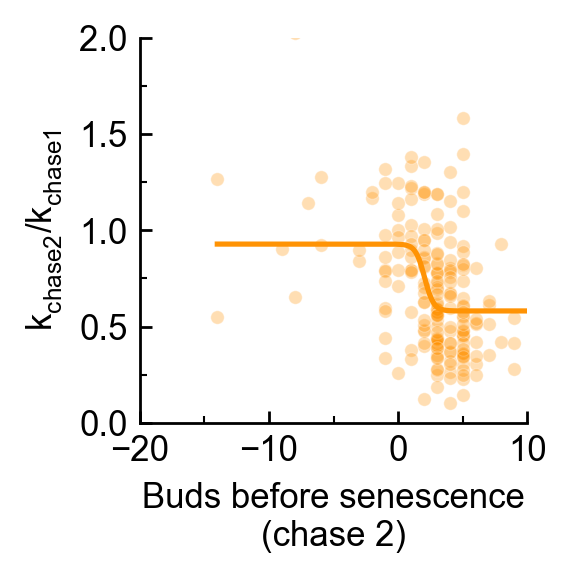

In [319]:
# fit to logistic
yvar1 = 'b_chase2_over_b_chase1'
xvar = 'buds_before_SEP_chase2'
gooddata_chasedf = chasedf[(~chasedf[yvar1].isna())&(~chasedf[xvar].isna())]
result, results_df = fitting_tools.fit_model_to_df(chasedf, (~chasedf[yvar1].isna())&(~chasedf[xvar].isna()),
                                                fitting_tools.model_guesses.logistic[0],
                                                fitting_tools.model_guesses.logistic[1],
                                                yvar=yvar1,
                                                xvar=xvar
                                                )
x = np.sort(gooddata_chasedf[xvar].unique())
x_smooth = np.arange(np.min(x), np.max(x), 0.1)
y_pred = result.model.eval(params=result.params, x=x)
y_pred_smooth = result.model.eval(params=result.params, x=x_smooth)

fig, ax = plotting.figure_ax()

kwargs = {
    'x': xvar,
    'y': yvar1,
    'data': gooddata_chasedf,
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
# sns.lineplot(**kwargs, estimator='median')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 2)
ax.set_xlim(-20, 10)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
plotting.format_ticks(ax)

ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xlabel('Buds before senescence\n(chase 2)')
ax.plot(x_smooth, y_pred_smooth, color=ratecolor)

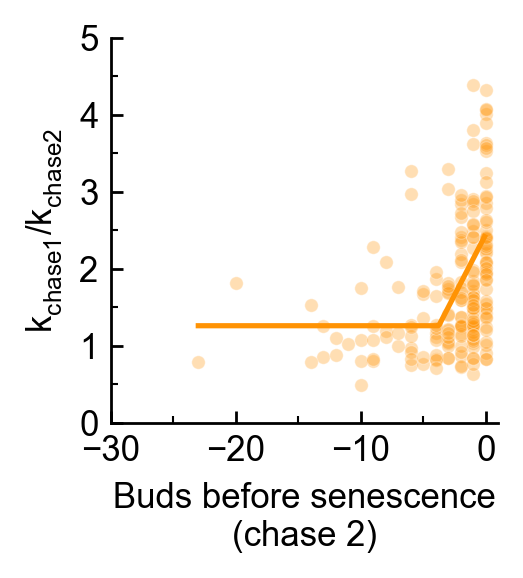

In [294]:
# fit to logistic
yvar1 = 'b_chase1_over_b_chase2'
xvar = 'buds_after_death_chase2'
result, results_df = fitting_tools.fit_model_to_df(chasedf, ~chasedf[yvar1].isna(),
                                                fitting_tools.model_guesses.piecewise_linear[0],
                                                fitting_tools.model_guesses.piecewise_linear[1],
                                                yvar=yvar1,
                                                xvar=xvar
                                                )
x = np.sort(chasedf[xvar].unique())
x_smooth = np.arange(np.min(x), np.max(x), 0.1)
y_pred = result.model.eval(params=result.params, x=x)
y_pred_smooth = result.model.eval(params=result.params, x=x_smooth)

fig, ax = plotting.figure_ax()

kwargs = {
    'x': xvar,
    'y': yvar1,
    'data': chasedf,
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
# sns.lineplot(**kwargs, estimator='median')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 5)
ax.set_xlim(-30, 1)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
plotting.format_ticks(ax)

ax.set_ylabel((r'$k_{chase1}$/$k_{chase2}$'))
ax.set_xlabel('Buds before senescence\n(chase 2)')
ax.plot(x_smooth, y_pred_smooth, color=ratecolor)

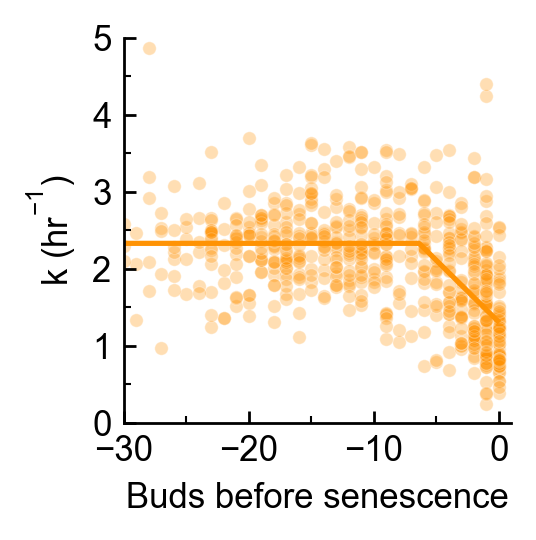

In [296]:
# fit to logistic
yvar1 = 'b'
xvar = 'buds_after_death'
boolean = (~fits_df[yvar1].isna()) & (fits_df.compartment_name.isin(constants.compartments_dict['wt_rkk']))
result, results_df = fitting_tools.fit_model_to_df(fits_df, boolean,
                                                fitting_tools.model_guesses.piecewise_linear[0],
                                                fitting_tools.model_guesses.piecewise_linear[1],
                                                yvar=yvar1,
                                                xvar=xvar
                                                )
x = np.sort(fits_df[boolean][xvar].unique())
x_smooth = np.arange(np.min(x), np.max(x), 0.1)
y_pred = result.model.eval(params=result.params, x=x)
y_pred_smooth = result.model.eval(params=result.params, x=x_smooth)

fig, ax = plotting.figure_ax()

kwargs = {
    'x': xvar,
    'y': yvar1,
    'data': fits_df[boolean],
    'ax': ax,
    'color': ratecolor,
}

sns.scatterplot(**kwargs, s=15, alpha=0.3)
# sns.lineplot(**kwargs, estimator='median')
# sns.boxplot(**kwargs)

ax.set_ylim(0, 5)
ax.set_xlim(-30, 1)
ax.set_xticks(np.arange(ax.get_xlim()[0], ax.get_xlim()[1]+0.1, 10))
plotting.format_ticks(ax)

ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.set_xlabel('Buds before senescence')
ax.plot(x_smooth, y_pred_smooth, color=ratecolor)

#### Bar graphs with 95% CI

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_chase2_y=b_chase1_over_b_chase2.svg


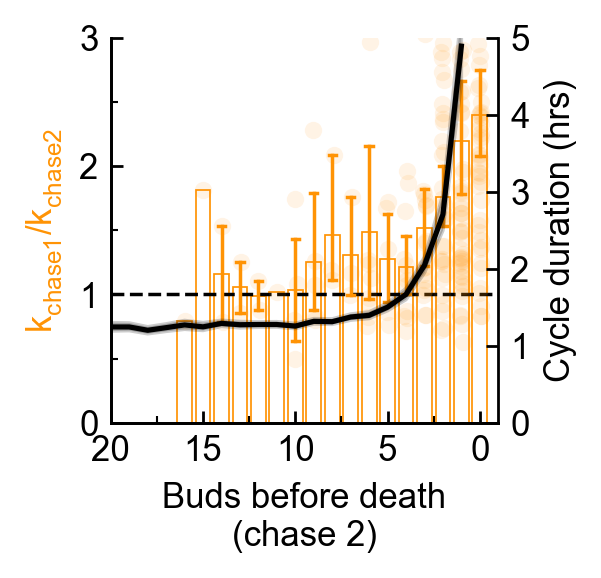

In [301]:
fig, ax = plotting.figure_ax()
ax.axhline(1, color='black', linewidth=1, linestyle='--')
# Don't want cells where both measurements were made after SEP
bools = (chasedf.dist_from_sen_chase1>5)

kwargs = {
    'x': 'dist_from_sen_chase2',
    'y': 'b_chase1_over_b_chase2',
    'data': chasedf[bools],
    'ax': ax,
}
sns.stripplot(**kwargs, alpha=0.1, color=ratecolor)
sns.barplot(
    **kwargs,
    color='white',
    edgecolor=ratecolor,
    linewidth=0.5,
    errorbar=('ci', 95),
    errcolor=ratecolor,
    errwidth=1,
    capsize=0.4
)
# Plot cycle duration
ax2 = ax.twinx()
kwargs2 = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'data': sub_bud_df,
    'ax': ax2,
    'color': 'black'
}
sns.lineplot(**kwargs2)
# Plot aesthetics
plotting.format_ticks(ax2)
ax2.spines['top'].set_visible(False)
ax2.set_ylim(0, 5)
ax.set_ylim(0, 3)
ax.set_xlim(16, -1)
xticks = [int(val) for val in np.arange(0, 21, 5)]
ax.set_xticks(xticks)
ax.set_xticklabels(xticks)
plotting.format_ticks(ax)
ax.set_ylabel((r'$k_{chase1}$/$k_{chase2}$'), color=ratecolor)
ax.set_xlabel('Buds before death\n(chase 2)')
ax2.set_ylabel('Cycle duration (hrs)')
# for patch in ax.patches:
#     patch.set_facecolor('white')
plotting.save_figure(fig, kwargs, ext='.svg')

<Axes: xlabel='buds_before_SEP_chase2', ylabel='b_chase2_over_b_chase1'>

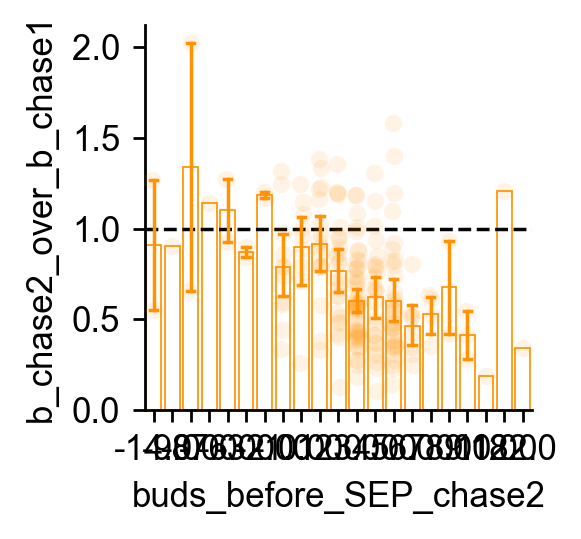

In [370]:
fig, ax = plotting.figure_ax()
ax.axhline(1, color='black', linewidth=1, linestyle='--')
# Don't want cells where both measurements were made after SEP
bools = (chasedf.dist_from_sen_chase1>5)
kwargs = {
    'x': 'buds_before_SEP_chase2',
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf,
    'ax': ax,
}
sns.stripplot(**kwargs, alpha=0.1, color=ratecolor)
sns.barplot(
    **kwargs,
    color='white',
    edgecolor=ratecolor,
    linewidth=0.5,
    errorbar=('ci', 95),
    errcolor=ratecolor,
    errwidth=1,
    capsize=0.4,
)
# ax.set_xlim(-20, 11)
# xticks = np.arange(-20, 11, 10)
# ax.set_xticks(xticks)
# plotting.format_ticks(ax)
# ax.set_xticklabels([np.int16(num) for num in xticks])

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=buds_before_SEP_chase2_y=b_chase2_over_b_chase1.svg


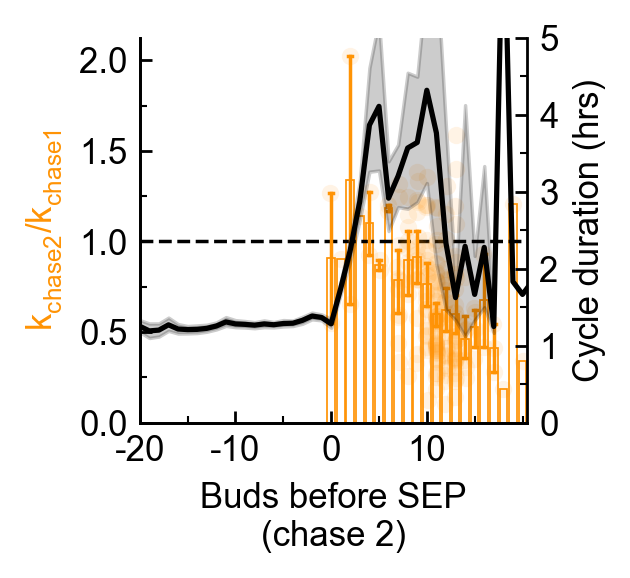

In [363]:
fig, ax = plotting.figure_ax()
ax.axhline(1, color='black', linewidth=1, linestyle='--')
# Don't want cells where both measurements were made after SEP
bools = (chasedf.dist_from_sen_chase1>5)
ax.set_xlim(-20, 11)
xticks = np.arange(-20, 11, 10)
kwargs = {
    'x': 'buds_before_SEP_chase2',
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf,
    'ax': ax,
}
sns.stripplot(**kwargs, alpha=0.1, color=ratecolor)
sns.barplot(
    **kwargs,
    color='white',
    edgecolor=ratecolor,
    linewidth=0.5,
    errorbar=('ci', 95),
    errcolor=ratecolor,
    errwidth=1,
    capsize=0.4,
)
ax.set_xticks(xticks)
plotting.format_ticks(ax)
ax.set_xticklabels([np.int16(num) for num in xticks])
# Plot cycle duration
ax2 = ax.twinx()
ax2.spines['top'].set_visible(False)
ax2.set_ylim(0, 5)
plotting.format_ticks(ax2)
kwargs2 = {
    'x': 'buds_before_SEP',
    'y': 'cycle_duration_hrs',
    'data': sub_bud_df,
    'ax': ax2,
    'color': 'black'
}
sns.lineplot(**kwargs2)
ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'), color=ratecolor)
ax.set_xlabel('Buds before SEP\n(chase 2)')
ax2.set_ylabel('Cycle duration (hrs)')
# for patch in ax.patches:
#     patch.set_facecolor('white')
plotting.save_figure(fig, kwargs, ext='.svg')

#### Strip plots of fold change chase2/chase1 vs. after SEP for chase chase 2 when SEP is assumed 5 for all cells

False vs. True: Mann-Whitney-Wilcoxon test two-sided, P_val:1.213e-05 U_stat=3.895e+03
ODC(47) fold change young over old=1.444 +/- 0.065
ODC(47) fold change old over young=0.693 +/- 0.065
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=post_sep_y=b_chase2_over_b_chase1_color=(1.0, 0.5764705882352941, 0.01568627450980392).svg


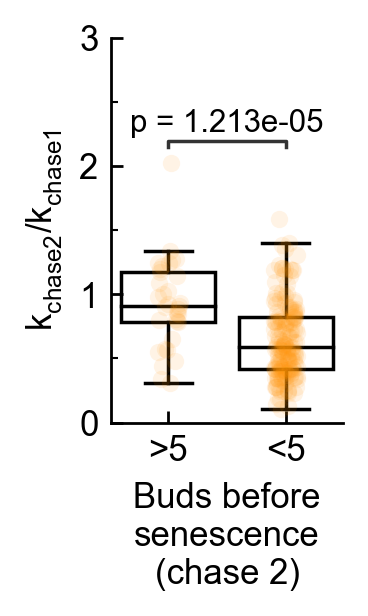

In [173]:
fig, ax = plotting.figure_ax(width_scale=0.6)
chasedf.loc[chasedf.dist_from_sen_chase2>5, 'post_sep'] = False
chasedf.loc[chasedf.dist_from_sen_chase2<5, 'post_sep'] = True
# Don't want to compare cells where both chases were done post-sep
bools = (chasedf.dist_from_sen_chase1>5)
kwargs = {
    'x': 'post_sep',
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf[bools],
    'ax': ax,
    'color': ratecolor
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
sns.stripplot(**kwargs, alpha=0.1)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
box_pairs=[
    (True, False)
]
test='Mann-Whitney'
text_format="full"
loc="inside"
annotator = Annotator(ax, box_pairs, data=data, x=x, y=y, )
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=9, line_offset_to_group=0)
annotator.apply_and_annotate()

# sns.stripplot(**kwargs, alpha=0.1)
ax.set_ylim(0, 3)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 1))
# ax.set_yscale('log', base=2)
ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xticklabels(['>5', '<5'])
ax.set_xlabel('Buds before\nsenescence\n(chase 2)')

# Calculate fold changes and error
subdf = kwargs['data']
data1 = subdf.loc[subdf.post_sep==False, kwargs['y']]
data2 = subdf.loc[subdf.post_sep==True, kwargs['y']]
fold_change = np.round(data1.mean()/data2.mean(), 3)
fold_change_old_over_young = np.round(data2.mean()/data1.mean(), 3)
SEM1 = np.std(data1, ddof=1) / np.sqrt(np.size(data1))
SEM2 = np.std(data2, ddof=1) / np.sqrt(np.size(data2))
SEM_of_fold_change = np.sqrt(np.sum([np.power(SEM1, 2), np.power(SEM2, 2)]))
SEM_of_fold_change = np.round(SEM_of_fold_change, 3)
fold_change_old_over_young = np.round(1/fold_change, 3)
print(f'{substrate} fold change young over old={fold_change} +/- {SEM_of_fold_change}')
print(f'{substrate} fold change old over young={fold_change_old_over_young} +/- {SEM_of_fold_change}')
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

In [ ]:
fig, ax = plotting.figure_ax(width_scale=0.6)
chasedf.loc[chasedf.dist_from_sen_chase2>5, 'post_sep'] = False
chasedf.loc[chasedf.dist_from_sen_chase2<5, 'post_sep'] = True
# Don't want to compare cells where both chases were done post-sep
bools = (chasedf.dist_from_sen_chase1>5)
kwargs = {
    'x': 'post_sep',
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf[bools],
    'ax': ax,
    'color': ratecolor
}

sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
sns.stripplot(**kwargs, alpha=0.1)
# annotate t-test results
data=kwargs['data']
x = kwargs['x']
y = kwargs['y']
box_pairs=[
    (True, False)
]
test='Mann-Whitney'
text_format="full"
loc="inside"
annotator = Annotator(ax, box_pairs, data=data, x=x, y=y, )
annotator.configure(test=test, text_format=text_format,
                    loc=loc, show_test_name=False,
                    line_width=1, fontsize=9, line_offset_to_group=0)
annotator.apply_and_annotate()

# sns.stripplot(**kwargs, alpha=0.1)
ax.set_ylim(0, 3)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 1))
# ax.set_yscale('log', base=2)
ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xticklabels(['>5', '<5'])
ax.set_xlabel('Buds before death\n(chase 2)')
fold_change = chasedf.loc[chasedf.post_sep==False, 'b_chase2_over_b_chase1'].mean()/chasedf.loc[chasedf.post_sep==True, 'b_chase2_over_b_chase1'].mean()
print(f'Fold change young over old={fold_change}')
plotting.format_ticks(ax, add_minor_x=False)
plotting.save_figure(fig, kwargs, ext='.svg')

### Histogram of end of life k2/k1

Text(0.5, 1.0, 'Cells <5 buds\nbuds before death\n(at chase2)')

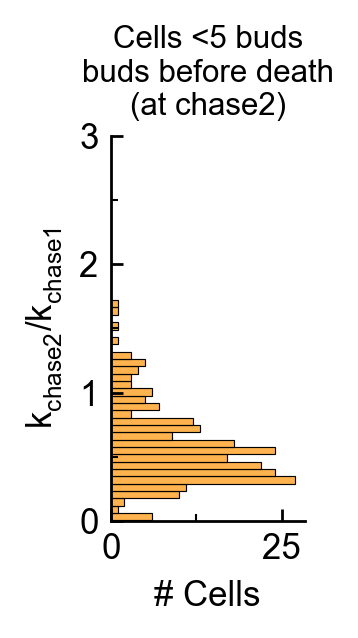

In [170]:
fig, ax = plotting.figure_ax(width_scale=0.5)

kwargs = {
    'y': 'b_chase2_over_b_chase1',
    'data': chasedf[chasedf.dist_from_sen_chase2<5],
    'ax': ax,
    'hue_order': [False, True],
    'bins': 30,
    'color': ratecolor,
    'alpha': 0.7,
    'kde': False
}

sns.histplot(**kwargs)

ax.set_ylim(0, 6)
ax.set_yticks(np.arange(0, np.max(ax.get_ylim())+0.1, 1))
ax.set_ylim(0, 3)
ax.set_yticks(np.arange(0, ax.get_ylim()[1]+0.01, 1))
# ax.set_yscale('log', base=2)
ax.set_ylabel((r'$k_{chase2}$/$k_{chase1}$'))
ax.set_xlabel('# Cells')
plotting.format_ticks(ax)
ax.set_title('Cells <5 buds\nbuds before death\n(at chase2)', fontsize=9)

### Scatter plot of correlation between chases

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=b_chase1_y=b_chase2_hue=buds_after_death_chase2_alpha=0.5_linewidth=0_size=20.svg


C:\Users\johnp\Dropbox\Projects\byc\byc\plotting.py:1098: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  fig.set_tight_layout(True)


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\notebooks\plots\gen_from_death_color_palette_max_dist_from_sen=0.svg


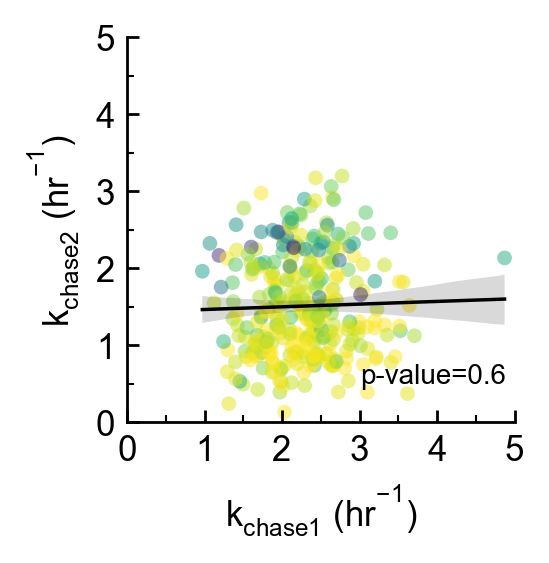

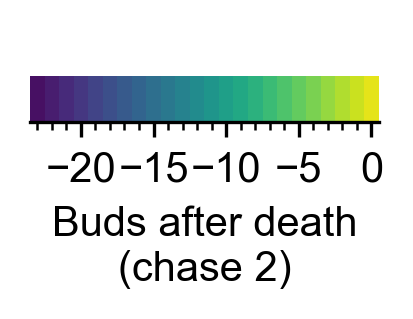

In [200]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'b_chase1',
    'y': 'b_chase2',
    'hue': 'buds_after_death_chase2',
    'data': chasedf[chasedf.dist_from_sen_chase2>-1],
    'palette': 'viridis',
    'ax': ax,
    'alpha': 0.5,
    'linewidth': 0,
    'size': 20
}
# ax.plot(np.arange(0, 5, 0.1), fitting_tools.line(np.arange(0, 5, 0.1), 1, 0),
#         color='black', linewidth=1, alpha=.5)
sns.scatterplot(**kwargs)
sns.regplot(x=kwargs['x'], y=kwargs['y'], data=kwargs['data'], color='black', scatter=False, line_kws={'linewidth': 1})

ax.legend_.set_visible(False)
ax.set_xlim(0, 5)
ax.set_ylim(0, 5)
ax.set_ylabel(r'$k_{chase2}$' + plotting.annoying_strings().k_inverse_hrs[1:])
ax.set_xlabel(r'$k_{chase1}$' + plotting.annoying_strings().k_inverse_hrs[1:])
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+0.1, 1))
plotting.format_ticks(ax)
# Stats for linear regression
from scipy.stats import linregress
x = kwargs['data'][kwargs['x']]
y = kwargs['data'][kwargs['y']]                  
slope, intercept, r, p, se = linregress(x, y)
m_text = f'Slope={np.round(slope, 2)}'
p_text = f'p-value={np.round(p, 2)}'
# ax.annotate(m_text, xy=(0.6, 0.7), xycoords='axes fraction', fontsize=9)
ax.annotate(p_text, xy=(0.6, 0.1), xycoords='axes fraction', fontsize=8)
plotting.save_figure(fig, kwargs, ext='.svg')
# Make legend
min_dist_from_sen=int(kwargs['data'].buds_after_death_chase2.min())
max_dist_from_sen=int(kwargs['data'].buds_after_death_chase2.max())
plotting.plot_dist_from_sen_palette_key(
    min_dist_from_sen=min_dist_from_sen,
    max_dist_from_sen=max_dist_from_sen,
    xlabel='Buds after death\n(chase 2)',
    direction='ascending',
    xticks=[-20, -15, -10, -5, 0])

## Degradation rate constant vs age at chase

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=age_at_chase_y=b.svg


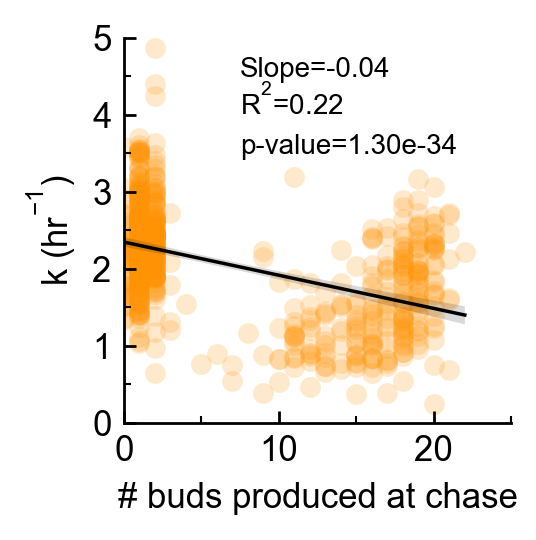

In [34]:
booldex = (fits_df.compartment_name.isin(constants.compartments_dict['wt_rkk']))&(~fits_df.b.isna())&(~fits_df.age_at_chase.isna())
booldex = booldex & (fits_df.first_bud_frame<18)
fig, ax = plotting.figure_ax()
kwargs = {
    'x': 'age_at_chase',
    'y': 'b',
    'data': fits_df[booldex]
}
strains = kwargs['data'].strain_name.unique()
sns.scatterplot(**kwargs, linewidth=0, alpha=0.2, color=strains_color_dict[strains[0]])
sns.regplot(**kwargs, scatter=False, line_kws={'color': 'black', 'linewidth': 1})

# Stats for linear regression
from scipy.stats import linregress
x = kwargs['data'][kwargs['x']]
y = kwargs['data'][kwargs['y']]                  
slope, intercept, r, p, se = linregress(x, y)
m_text = 'Slope={:.2f}'.format(slope)
rsq_text = plotting.annoying_strings().r_sq + '={:.2f}'.format(np.power(r, 2))
p_text = 'p-value={:.2e}'.format(p)
# ax.annotate(m_text, xy=(0.6, 0.7), xycoords='axes fraction', fontsize=9)
ax.annotate(m_text, xy=(0.3, 0.9), xycoords='axes fraction', fontsize=8)
ax.annotate(rsq_text, xy=(0.3, 0.8), xycoords='axes fraction', fontsize=8)
ax.annotate(p_text, xy=(0.3, 0.7), xycoords='axes fraction', fontsize=8)

lineresult, linedf = fitting_tools.fit_model_to_df(
    fits_df,
    booldex,
    fitting_tools.model_guesses.line[0],
    fitting_tools.model_guesses.line[1],
    xvar=kwargs['x'],
    yvar=kwargs['y']
)
ax.set_xlim(0, 25)
ax.set_ylim(0, 5)
ax.set_xlabel('# buds produced at chase')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
plotting.format_ticks(ax)
plotting.save_figure(fig, kwargs, ext='.svg')

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=age_at_chase_y=b.svg


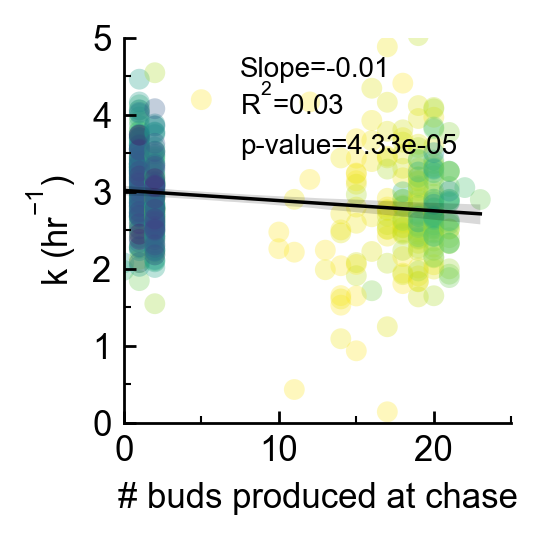

In [254]:
booldex = (fits_df.compartment_name.isin(constants.compartments_dict['wt_ubl']))&(~fits_df.b.isna())&(~fits_df.age_at_chase.isna())
booldex = booldex & (fits_df.first_bud_frame<18)
fig, ax = plotting.figure_ax()
kwargs = {
    'x': 'age_at_chase',
    'y': 'b',
    'data': fits_df[booldex]
}
strains = kwargs['data'].strain_name.unique()
sns.scatterplot(
    **kwargs,
    linewidth=0,
    alpha=0.3,    
    hue='buds_after_death',
    palette='viridis',)
sns.regplot(
    **kwargs,
    scatter=False,
    line_kws={'color': 'black', 'linewidth': 1}
)

# Stats for linear regression
from scipy.stats import linregress
x = kwargs['data'][kwargs['x']]
y = kwargs['data'][kwargs['y']]                  
slope, intercept, r, p, se = linregress(x, y)
m_text = 'Slope={:.2f}'.format(slope)
rsq_text = plotting.annoying_strings().r_sq + '={:.2f}'.format(np.power(r, 2))
p_text = 'p-value={:.2e}'.format(p)
# ax.annotate(m_text, xy=(0.6, 0.7), xycoords='axes fraction', fontsize=9)
ax.annotate(m_text, xy=(0.3, 0.9), xycoords='axes fraction', fontsize=8)
ax.annotate(rsq_text, xy=(0.3, 0.8), xycoords='axes fraction', fontsize=8)
ax.annotate(p_text, xy=(0.3, 0.7), xycoords='axes fraction', fontsize=8)

lineresult, linedf = fitting_tools.fit_model_to_df(
    fits_df,
    booldex,
    fitting_tools.model_guesses.line[0],
    fitting_tools.model_guesses.line[1],
    xvar=kwargs['x'],
    yvar=kwargs['y']
)
ax.set_xlim(0, 25)
ax.set_ylim(0, 5)
ax.set_xlabel('# buds produced at chase')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
ax.legend_.set_visible(False)
plotting.format_ticks(ax)
plotting.save_figure(fig, kwargs, ext='.svg')

## Correct and complete annotation of cell cycle information on `fits_df` for analsysi of xplanatory variabels for degradation rate approaching senescence

In [9]:
strains = ['JPC121', 'JPC220', 'JPC146']
tet_stock_concn = '1000X'
sub_fits_df = fits_df[fits_df.strain_name.isin(strains)]
sub_fits_df = sub_fits_df[sub_fits_df.tet_stock_concn==tet_stock_concn]
sub_fits_df = sub_fits_df[sub_fits_df.dist_from_sen>=0]

In [98]:
collection_interval_mins = 10
sub_fits_df.loc[:, 'measdex'] = sub_fits_df.compartment_name.str.cat(sub_fits_df.cell_index.astype(int).astype(str), sep='-')
unique_measdices = sub_fits_df.measdex.unique()
i=1
cell_buds_dfs = []
for measdex in unique_measdices:
    print(f'Measuring cell chase {i} of {len(unique_measdices)}', end='\r')
    measdex_bool = sub_fits_df.measdex==measdex
    cell_index = int(sub_fits_df.loc[measdex_bool, 'cell_index'].iloc[0])
    # Use the cell's crop ROI dataframe .csv file to annotate whether
    # the cell contains an aggregate at the time the chase performed
    compdir = sub_fits_df.loc[measdex_bool, 'compartment_dir'].iloc[0]
    crop_roi_df = database.get_crop_roi_df_from_cell_index_compdir(cell_index, compdir)
    if 'contains_aggregate' in crop_roi_df.columns:
        contains_aggregate = crop_roi_df.contains_aggregate.iloc[0]
    else:
        contains_aggregate = np.nan
    sub_fits_df.loc[measdex_bool, 'contains_aggregate'] = contains_aggregate
    abs_chase_frame = sub_fits_df[measdex_bool].abs_chase_frame.iloc[0]
    # Read in and analyze the bud_rois_df
    bud_rois_zip_path = sub_fits_df[measdex_bool].bud_roi_set_path.iloc[0]
    cell_buds_df = files.read_rectangular_rois_as_df(bud_rois_zip_path)
    cell_buds_df.sort_values(by='position', ascending=True, inplace=True)
    cell_buds_df.reset_index(inplace=True)
    # Last frame is the death frame so it's not included in cycle duration measurements
    cell_buds_df.loc[:cell_buds_df.index.max()-2, 'cycle_duration_frames'] = np.diff(cell_buds_df.position[0:-1])
    cell_buds_df.loc[:, 'cycle_duration_hrs'] = (cell_buds_df.cycle_duration_frames*collection_interval_mins)/60
    cell_buds_df.loc[:, 'frame'] = cell_buds_df.position - 1
    cell_buds_df.loc[:, 'cycle_number'] = cell_buds_df.index
    database.annotate_daughter_shapes(cell_buds_df)
    n_long_daughters = len(cell_buds_df[cell_buds_df.bud_shape=='long'])
    n_round_daughters = len(cell_buds_df[cell_buds_df.bud_shape=='round'])
    # Annotate the last frame at which the cell was seen alive
    # and get rid of it from the data
    cell_buds_df.loc[:, 'death_frame'] = cell_buds_df.frame.max()
    cell_buds_df = cell_buds_df.loc[0:cell_buds_df.index.max()-1, :]
    # Keep track of the buds df for later use
    cell_buds_df.loc[:, 'cell_index'] = cell_index
    cell_buds_df.loc[:, 'compartment_name'] = os.path.basename(crop_roi_df.compartment_dir.iloc[0])
    cell_buds_df.loc[:, 'dist_from_sen'] = cell_buds_df.cycle_number.max() - cell_buds_df.cycle_number
    cell_buds_df.loc[:, 'b'] = sub_fits_df.loc[measdex_bool, 'b'].iloc[0]
    cell_buds_df.loc[:, 'dist_from_sen_at_chase'] = sub_fits_df.loc[measdex_bool, 'dist_from_sen'].iloc[0]
    if len(cell_buds_df)>9:
        pre_sep_duration = cell_buds_df.loc[cell_buds_df.dist_from_sen>5, 'cycle_duration_hrs'].mean()
        post_sep_duration = cell_buds_df.loc[cell_buds_df.dist_from_sen<4, 'cycle_duration_hrs'].mean()
        cell_buds_df.loc[:, 'pre_sep_cycle_avg'] =  pre_sep_duration
        cell_buds_df.loc[:, 'post_sep_cycle_avg'] = post_sep_duration
        cycle_duration_fold_change = pre_sep_duration/post_sep_duration
        cell_buds_df.loc[:, 'pre_to_post_sep_cycle_time_fold_change'] = cycle_duration_fold_change
    else:
        cycle_duration_fold_change = np.nan
    cell_buds_dfs.append(cell_buds_df)
    sub_fits_df.loc[measdex_bool, 'pre_to_post_sep_cycle_time_fold_change'] = cycle_duration_fold_change
    deltas = abs_chase_frame - cell_buds_df.frame
    # Ideally we want the cell cycle that's occuring during the chase
    # so we first try selecting those that start before or at the chase
    # frame
    positive_deltas = deltas[deltas>=0]
    if len(positive_deltas) > 0:
        cycle_number_closest_chase = np.argmin(positive_deltas)
    # if we can't find a cell cycle starting before or after the chase
    # (probably the case in a lot of t0 chases) we choose the cell 
    # cycle that starts closest to the chase
    else:
        abs_deltas = np.abs(deltas)
        cycle_number_closest_chase = np.argmin(abs_deltas)

    cycle_duration_at_chase = cell_buds_df.loc[cycle_number_closest_chase, 'cycle_duration_hrs']
    if np.isnan(cycle_duration_at_chase):
        try:
            # print(f'Closest cycle duration could not be calculated, using the one before')
            cycle_number_second_closest_to_chase = cycle_number_closest_chase-1
            cycle_duration_at_chase = cell_buds_df.loc[cycle_number_second_closest_to_chase, 'cycle_duration_hrs']
        except:
            pass
    sub_fits_df.loc[measdex_bool, 'cycle_duration_at_chase'] = cycle_duration_at_chase
    sub_fits_df.loc[measdex_bool, 'rls'] = len(cell_buds_df)
    sub_fits_df.loc[measdex_bool, 'n_long_daughters'] = n_long_daughters
    sub_fits_df.loc[measdex_bool, 'n_round_daughters'] = n_round_daughters
    # Only consider a cell's age at chase to be observed if the cell's
    # bud production started being observed in the first 3 hours of the expt
    if sub_fits_df.frame.min() < 19:
        sub_fits_df.loc[measdex_bool, 'age_at_chase'] = len(cell_buds_df[cell_buds_df.frame<=abs_chase_frame])
        sub_fits_df.loc[measdex_bool, 'rls_observed'] = True
    else:
        sub_fits_df.loc[measdex_bool, 'age_at_chase'] = np.nan
        sub_fits_df.loc[measdex_bool, 'rls_observed'] = False
    last_bud_hours = (cell_buds_df.frame.max()*collection_interval_mins)/60
    abs_chase_hours = (abs_chase_frame*collection_interval_mins)/60
    sub_fits_df.loc[measdex_bool, 'hours_after_last_bud'] = abs_chase_hours - last_bud_hours

    i+=1

sep_border = 5
sub_fits_df.loc[sub_fits_df.dist_from_sen<sep_border, 'post_sep'] = True
sub_fits_df.loc[sub_fits_df.dist_from_sen>sep_border, 'post_sep'] = False
n_long_thresh = 1
sub_fits_df.loc[sub_fits_df.n_long_daughters>=n_long_thresh, 'produced_elongated_daughters'] = True
sub_fits_df.loc[sub_fits_df.n_long_daughters==0, 'produced_elongated_daughters'] = False
sub_fits_df.loc[sub_fits_df.dist_from_sen>5, 'post_sep'] = False
sub_fits_df.loc[sub_fits_df.dist_from_sen<5, 'post_sep'] = True

allbudsdf = pd.concat(cell_buds_dfs, ignore_index=True)
allbudsdf.reset_index(inplace=True)

(array([ 26., 100., 210., 148.,  95.,  80.,  31.,  12.,   3.,   1.]),
 array([0.05252101, 0.18441176, 0.31630252, 0.44819328, 0.58008403,
        0.71197479, 0.84386555, 0.9757563 , 1.10764706, 1.23953782,
        1.37142857]),
 <BarContainer object of 10 artists>)

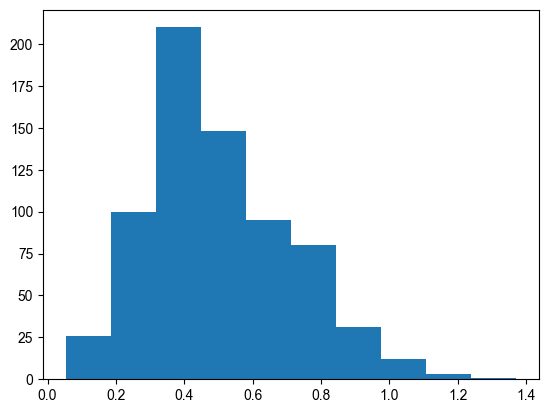

In [101]:
plt.hist(sub_fits_df.pre_to_post_sep_cycle_time_fold_change)

C:\Users\johnp\AppData\Local\Temp\ipykernel_6176\1726138026.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  oldbudsdf.loc[oldbudsdf.b>=b_cutoff, 'b_category'] = f'>={b_cutoff}'


(30.0, -1.0)

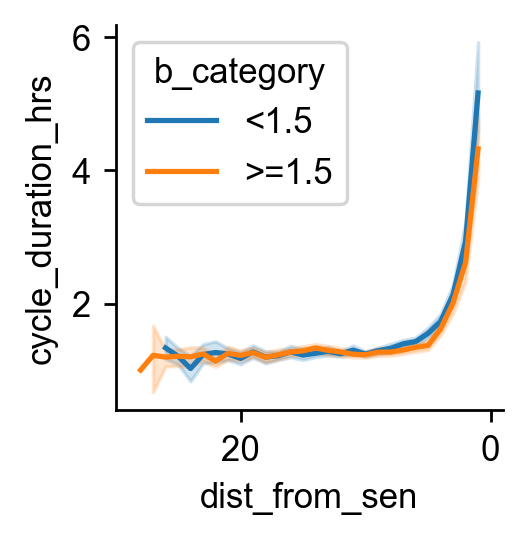

In [71]:
fig, ax = plotting.figure_ax()
oldbudsdf = allbudsdf[allbudsdf.dist_from_sen_at_chase<=8]
b_cutoff = 1.5
oldbudsdf.loc[oldbudsdf.b>=b_cutoff, 'b_category'] = f'>={b_cutoff}'
oldbudsdf.loc[oldbudsdf.b<b_cutoff, 'b_category'] = f'<{b_cutoff}'
kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'hue': 'b_category',
    'data': oldbudsdf,
    'ax': ax,
}

sns.lineplot(**kwargs)
ax.set_xlim(30, -1)

### K vs. cycle duration at chase vs. pre/post SEP hue

Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig.png


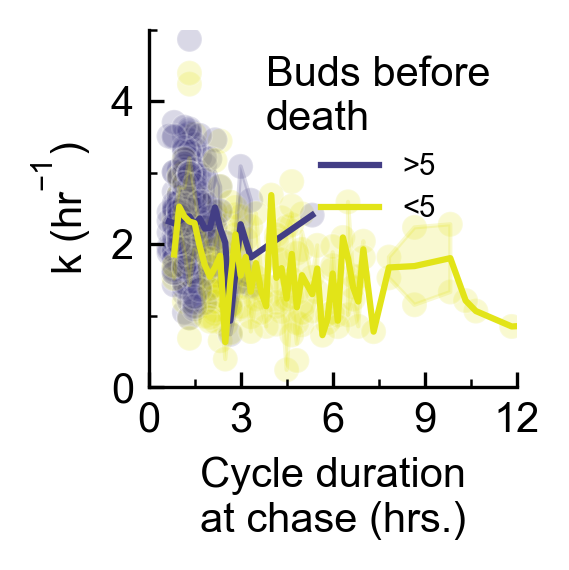

In [75]:
palette = plotting.get_pre_post_sep_palette()
sep_border = 5
sub_fits_df.loc[sub_fits_df.dist_from_sen<sep_border, 'post_sep'] = True
sub_fits_df.loc[sub_fits_df.dist_from_sen>sep_border, 'post_sep'] = False
sub_fits_df = sub_fits_df[sub_fits_df.cycle_duration_at_chase>0.5]
fig, ax = plotting.figure_ax()
fig.set_dpi(300)
scatterkwargs = {
    'x': 'cycle_duration_at_chase',
    'y': 'b',
    'hue': 'post_sep',
    'palette': palette,
    'data': sub_fits_df,
    'ax': ax,
    'alpha': 0.2
}
sns.scatterplot(**scatterkwargs)

linekwargs = {
    'x': 'cycle_duration_at_chase',
    'y': 'b',
    'hue': 'post_sep',
    'palette': palette,
    'data': sub_fits_df,
    'estimator': 'mean',
    'ax': ax,
    'alpha': 1
}

sns.lineplot(**linekwargs)

ax.set_xlim(0, 12)
ax.set_xticks(np.arange(0, 12.1, 3))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, 5.1, 2))
ax.set_xlabel('Cycle duration\nat chase (hrs.)')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
plotting.format_ticks(ax)
handles = ax.get_legend_handles_labels()[0][2:4]
labels = ['>5', '<5']
ax.legend(handles, labels, title='Buds before\ndeath', frameon=False, fontsize=7)
# plotting.legend_outside()
plt.tight_layout()

savepath = os.path.abspath(os.path.join(constants.byc_data_dir, f'meta/plots/fig.png'))
fig.savefig(savepath)
print(f'Figure saved at\n{savepath}')

### k vs. age at chase with hue dist_from_sen

## k vs. age at chase

Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig.svg


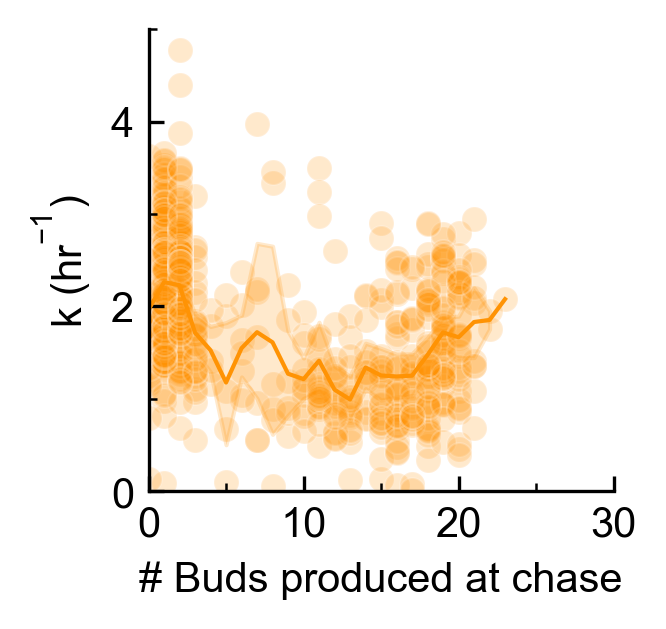

In [7]:
fig, ax = plotting.figure_ax()
fig.set_dpi(300)
ratecolor = plotting.strains_color_dict['JPC121']

kwargs = {
    'x': 'age_at_chase',
    'y': 'b',
    'data': sub_fits_df,
    'ax': ax,
    'alpha': 0.2,
    'color':ratecolor,
}

sns.scatterplot(**kwargs)
sns.lineplot(
    x=kwargs['x'],
    y=kwargs['y'],
    data=kwargs['data'],
    color=ratecolor,
    linewidth=1
)

ax.set_xlim(0, 30)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, 5.1, 2))
plotting.format_ticks(ax)
if ax.legend_:
    ax.legend_.set_visible(False)
ylabel = plotting.annoying_strings().k_inverse_hrs
ax.set_ylabel(ylabel)
ax.set_xlabel('# Buds produced at chase')

savepath = os.path.abspath(os.path.join(constants.byc_data_dir, f'meta/plots/fig.svg'))
fig.savefig(savepath)
print(f'Figure saved at\n{savepath}')
mdistfromsen = int(np.max(sub_fits_df.dist_from_sen))
# plotting.plot_dist_from_sen_palette_key(
#     max_dist_from_sen=mdistfromsen,
#     major_tick_space=10,
#     minor_tick_space=5
#     )

Figure saved at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\fig.png


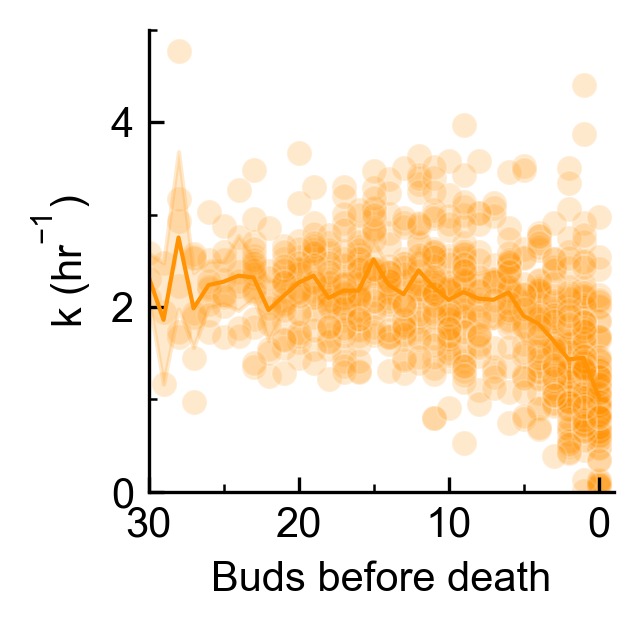

In [16]:
fig, ax = plotting.figure_ax()
fig.set_dpi(300)
ratecolor = plotting.strains_color_dict['JPC121']
kwargs = {
    'x': 'dist_from_sen',
    'y': 'b',
    'hue': 'dist_from_sen',
    'palette': 'viridis_r',
    'data': sub_fits_df,
    'ax': ax,
    'alpha': 0.4,
}


kwargs = {
    'x': 'dist_from_sen',
    'y': 'b',
    'data': sub_fits_df,
    'ax': ax,
    'alpha': 0.2,
    'color':ratecolor,
}

sns.scatterplot(**kwargs)
sns.lineplot(
    x=kwargs['x'],
    y=kwargs['y'],
    data=kwargs['data'],
    color=ratecolor,
    linewidth=1
)

ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+1, 10))
ax.set_ylim(0, 5)
ax.set_yticks(np.arange(0, 5.1, 2))
plotting.format_ticks(ax)
if ax.legend_:
    ax.legend_.set_visible(False)
ylabel = plotting.annoying_strings().k_inverse_hrs
ax.set_ylabel(ylabel)
ax.set_xlabel('Buds before death')

savepath = os.path.abspath(os.path.join(constants.byc_data_dir, f'meta/plots/fig.png'))
fig.savefig(savepath)
print(f'Figure saved at\n{savepath}')
mdistfromsen = int(np.max(sub_fits_df.dist_from_sen))
# plotting.plot_dist_from_sen_palette_key(
#     max_dist_from_sen=mdistfromsen,
#     major_tick_space=10,
#     minor_tick_space=5
#     )

### Cycle duration by age

(0.0, 10.0)

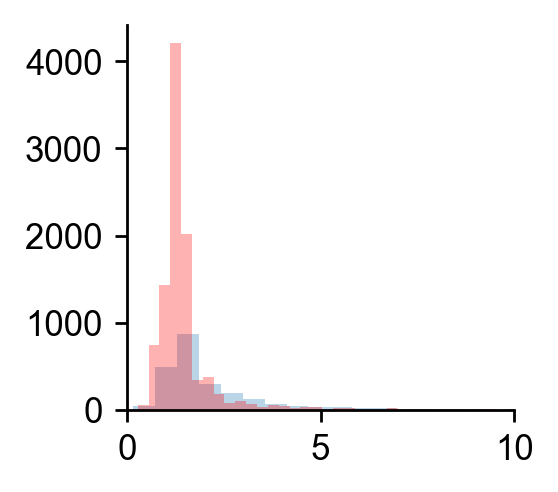

In [103]:
fig, ax = plotting.figure_ax()

ax.hist(sub_buds_df[sub_buds_df.cycle_number>15].cycle_duration_hrs, bins=100, alpha=0.3)
ax.hist(sub_buds_df[sub_buds_df.cycle_number<=15].cycle_duration_hrs, bins=100, color='red', alpha=0.3)
ax.set_xlim(0, 10)

Text(0.5, 0, 'Cycle #')

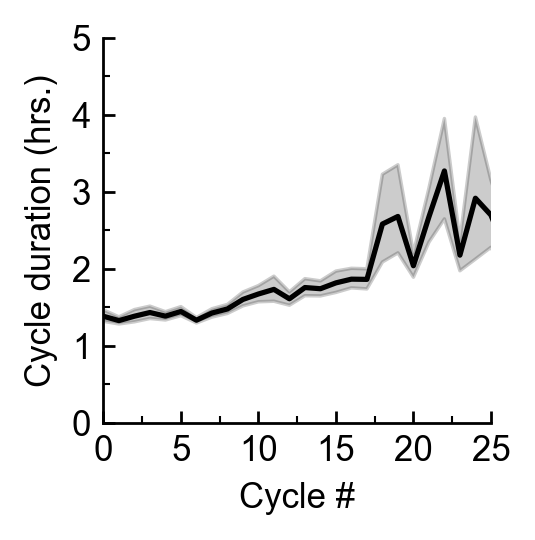

In [116]:
sub_buds_df = buds_df[buds_df.strain_name.isin(strains)]
sub_buds_df = sub_buds_df[sub_buds_df.tet_stock_concn=='1000X']
sub_buds_df = sub_buds_df[sub_buds_df.first_bud_frame<=18]
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'cycle_number',
    'y': 'cycle_duration_hrs',
    'data': sub_buds_df,
    'ax': ax,
    'color': 'black',
}

sns.lineplot(**kwargs)
# sns.scatterplot(**kwargs)
ax.set_xlim(0, 25)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+1, 5))
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

ax.set_ylabel('Cycle duration (hrs.)')
ax.set_xlabel('Cycle #')

Text(0.5, 0, 'Buds before death')

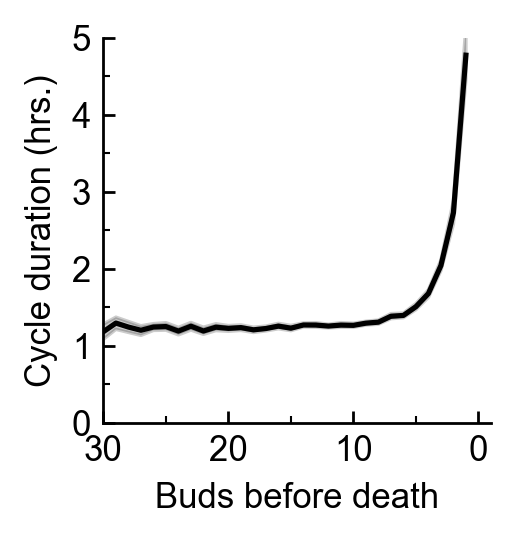

In [134]:
sub_buds_df = buds_df[buds_df.strain_name.isin(strains)]
sub_buds_df = sub_buds_df[sub_buds_df.tet_stock_concn=='1000X']
sub_buds_df = sub_buds_df[sub_buds_df.first_bud_frame<=18]
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'data': sub_buds_df,
    'ax': ax,
    'color': 'black',
}

sns.lineplot(**kwargs)
# sns.scatterplot(**kwargs)
ax.set_xlim(30, -1)
ax.set_xticks(np.arange(0, np.max(ax.get_xlim())+1, 10))
ax.set_ylim(0, 5)
plotting.format_ticks(ax)

ax.set_ylabel('Cycle duration (hrs.)')
ax.set_xlabel('Buds before death')

## Detecting individual cell SEPs by fitting piecewise linear function cycle duration vs. buds before death

In [44]:
from lmfit import Model
from byc import constants, database

In [80]:
traces_df, fits_df, buds_df = database.read_in_trace_fits_buds_dfs()

C:\Users\johnp\Dropbox\Projects\byc\byc\database.py:661: DtypeWarning: Columns (64,66,71,85,89,91,92,93,94,95,96,97,98,99,100,101,102,145,146,148,150,167,168,169,171,172,213,217,218,219,221,222,223,224) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(savepath, compression='gzip')


Read dataframe at
C:\Users\johnp\Dropbox\Projects\byc\data/meta/traces_df.csv.gzip


C:\Users\johnp\Dropbox\Projects\byc\byc\database.py:661: DtypeWarning: Columns (65,67,84,113,119,147,148,149,151,152,153,154,171,173) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(savepath, compression='gzip')


Read dataframe at
C:\Users\johnp\Dropbox\Projects\byc\data/meta/fits_df.csv.gzip


C:\Users\johnp\Dropbox\Projects\byc\byc\database.py:661: DtypeWarning: Columns (23,24,42,47,51,52,53,55,56,57,58,62) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(savepath, compression='gzip')


Read dataframe at
C:\Users\johnp\Dropbox\Projects\byc\data/meta/buds_df.csv.gzip


In [45]:
def piecewise_linear(x, x0, y0, k1):
    return np.piecewise(x, [x <= x0, x>x0], [lambda x:y0, lambda x:k1*x + y0 - x0*k1])

def piecewise_linear_double_constant(x, x0, x1, y0, y1, k1):
    return np.piecewise(x, [x <= x0, (x>x0) & (x<=x1), x>x1], [lambda x:y0, lambda x:k1*x + y0 - x0*k1, lambda x:y1 + y0 - x1*k1])

def horizontal_line(x, y0):
    y = np.array([y0 for xval in x])
    return y

def fit_piecewise(
    xvar='cycle_number',
    yvar='cycle_duration_hrs',
    df=None,
    **kwargs
):
    fit_func = kwargs.get('fit_func', piecewise_linear)
    # Need to get rid of NaN values before trying to fit
    no_nan_bool = ~df[yvar].isna()
    x = df.loc[no_nan_bool, xvar].values
    y = df.loc[no_nan_bool, yvar].values
    # Make some guesses about each param
    # Start of SEP is 5 buds before death on average
    x0 = np.max(x) - 5
    x1 = x0 + 2
    # Most cells take 70 minutes per divsiion 
    # when young
    y0 = 1/(70/60)
    y1 = 1/3
    # Arbitrary guess for slope,
    # shoudl be well constrained by the data
    k1 = 1
    model = Model(fit_func)
    result = model.fit(
        y,
        x0=x0,
        x1=x1,
        y0=y0,
        y1=y1,
        k1=k1,
        x=x
    )
    resultdf = fitting_tools.df_from_ModelResult(result)
    param_vals = [result.params[key].value for key in result.params.keys()]
    xsmooth = np.linspace(-30, 0, 30)
    ypred = fit_func(xsmooth, *param_vals)
    smoothdf = pd.DataFrame({
    'xsmooth': xsmooth,
    'ypred': ypred
    })

    df.loc[:, f'{yvar}_pred'] = fit_func(df[xvar].values, *param_vals)

    return result, smoothdf, resultdf

## Fit to find individual cell SEPs

#### Filter data

In [46]:
buds_df.loc[:, 'bud_frequency_per_hr'] = 1/buds_df.cycle_duration_hrs

compnames = constants.compartments_dict['wt_rkk']
compnames = fits_df.loc[fits_df.strain_name.isin(strains), 'compartment_name'].unique()
# compnames = [
# '20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry',
# '20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry',
# '20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry'
# ]
# compnames = ['20230518_byc_JPC274_R-YFP-Su9_mub1d']

### Individual cell figures

Fitting cell 1 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_0_SEP_fit.svg
Fitting cell 2 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\AppData\Local\Temp\ipykernel_17500\962662884.py:70: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subdf.loc[subdf.compartment_bud_id==buddex, col] = resultdf.loc[0, col]
C:\Users\johnp\AppData\Local\Temp\ipykernel_17500\962662884.py:70: Sett

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_1_SEP_fit.svg
Fitting cell 3 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_2_SEP_fit.svg
Fitting cell 4 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_3_SEP_fit.svg
Fitting cell 5 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_4_SEP_fit.svg
Fitting cell 6 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_5_SEP_fit.svg
Fitting cell 7 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_6_SEP_fit.svg
Fitting cell 8 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_7_SEP_fit.svg
Fitting cell 9 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_8_SEP_fit.svg
Fitting cell 10 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_9_SEP_fit.svg
Fitting cell 11 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_10_SEP_fit.svg
Fitting cell 12 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_11_SEP_fit.svg
Fitting cell 13 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_12_SEP_fit.svg
Fitting cell 14 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_13_SEP_fit.svg
Fitting cell 15 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_14_SEP_fit.svg
Fitting cell 16 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_15_SEP_fit.svg
Fitting cell 17 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_16_SEP_fit.svg
Fitting cell 18 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_17_SEP_fit.svg
Fitting cell 19 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_18_SEP_fit.svg
Fitting cell 20 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_19_SEP_fit.svg
Fitting cell 21 of 690
Only 5 buds for cell 20210910_JPC121_UbiR-YFP_su9x2_in_BYC4741_old_chase-141-150-158-165-179-222-272
Fitting cell 22 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_21_SEP_fit.svg
Fitting cell 23 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_22_SEP_fit.svg
Fitting cell 24 of 690
Only 2 buds for cell 20210910_JPC121_UbiR-YFP_su9x2_in_BYC4741_old_chase-153-173-189-205
Fitting cell 25 of 690
Only 7 buds for cell 20210910_JPC121_UbiR-YFP_su9x2_in_BYC4741_old_chase-155-165-172-180-193-207-218-230-267
Fitting cell 26 of 690
Only 1 buds for cell 20210910_JPC121_UbiR-YFP_su9x2_in_BYC4741_old_chase-156-172-198
Fitting cell 27 of 690
Only 5 buds for cell 20210910_JPC121_UbiR-YFP_su9x2_in_BYC4741_old_chase-165-179-193-208-225-279-304
Fitting cell 28 of 690
Only 3 buds for cell 20210910_JPC121_UbiR-YFP_su9x2_in_BYC4741_old_chase-169-190-205-214-264
Fitting cell 29 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_28_SEP_fit.svg
Fitting cell 30 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_29_SEP_fit.svg
Fitting cell 31 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_30_SEP_fit.svg
Fitting cell 32 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_31_SEP_fit.svg
Fitting cell 33 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_32_SEP_fit.svg
Fitting cell 34 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_33_SEP_fit.svg
Fitting cell 35 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_34_SEP_fit.svg
Fitting cell 36 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_35_SEP_fit.svg
Fitting cell 37 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_36_SEP_fit.svg
Fitting cell 38 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_37_SEP_fit.svg
Fitting cell 39 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_38_SEP_fit.svg
Fitting cell 40 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_39_SEP_fit.svg
Fitting cell 41 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_40_SEP_fit.svg
Fitting cell 42 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_41_SEP_fit.svg
Fitting cell 43 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_42_SEP_fit.svg
Fitting cell 44 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_43_SEP_fit.svg
Fitting cell 45 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_44_SEP_fit.svg
Fitting cell 46 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_45_SEP_fit.svg
Fitting cell 47 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_46_SEP_fit.svg
Fitting cell 48 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_47_SEP_fit.svg
Fitting cell 49 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_48_SEP_fit.svg
Fitting cell 50 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_49_SEP_fit.svg
Fitting cell 51 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_50_SEP_fit.svg
Fitting cell 52 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_51_SEP_fit.svg
Fitting cell 53 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_52_SEP_fit.svg
Fitting cell 54 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_53_SEP_fit.svg
Fitting cell 55 of 690
Only 1 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-103-118-266
Fitting cell 56 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_55_SEP_fit.svg
Fitting cell 57 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_56_SEP_fit.svg
Fitting cell 58 of 690
Only 6 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-111-121-134-151-163-180-203-234
Fitting cell 59 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_58_SEP_fit.svg
Fitting cell 60 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_59_SEP_fit.svg
Fitting cell 61 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_60_SEP_fit.svg
Fitting cell 62 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_61_SEP_fit.svg
Fitting cell 63 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_62_SEP_fit.svg
Fitting cell 64 of 690
Only 6 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-126-135-142-148-158-165-180-224
Fitting cell 65 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_64_SEP_fit.svg
Fitting cell 66 of 690
Only 7 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-130-139-157-167-179-189-202-223-412
Fitting cell 67 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_66_SEP_fit.svg
Fitting cell 68 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_67_SEP_fit.svg
Fitting cell 69 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_68_SEP_fit.svg
Fitting cell 70 of 690
Only 3 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-142-173-192-219-416
Fitting cell 71 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_70_SEP_fit.svg
Fitting cell 72 of 690
Only 3 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-146-149-163-171-186-465
Fitting cell 73 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_72_SEP_fit.svg
Fitting cell 74 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_73_SEP_fit.svg
Fitting cell 75 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_74_SEP_fit.svg
Fitting cell 76 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_75_SEP_fit.svg
Fitting cell 77 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_76_SEP_fit.svg
Fitting cell 78 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_77_SEP_fit.svg
Fitting cell 79 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_78_SEP_fit.svg
Fitting cell 80 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_79_SEP_fit.svg
Fitting cell 81 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_80_SEP_fit.svg
Fitting cell 82 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_81_SEP_fit.svg
Fitting cell 83 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_82_SEP_fit.svg
Fitting cell 84 of 690
Only 7 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-6-16-29-36-46-57-64-90-104
Fitting cell 85 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_84_SEP_fit.svg
Fitting cell 86 of 690
Only 5 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-6-18-28-39-46-56-76
Fitting cell 87 of 690
Only 2 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-6-18-34-158
Fitting cell 88 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_87_SEP_fit.svg
Fitting cell 89 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_88_SEP_fit.svg
Fitting cell 90 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_89_SEP_fit.svg
Fitting cell 91 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_90_SEP_fit.svg
Fitting cell 92 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_91_SEP_fit.svg
Fitting cell 93 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_92_SEP_fit.svg
Fitting cell 94 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_93_SEP_fit.svg
Fitting cell 95 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_94_SEP_fit.svg
Fitting cell 96 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_95_SEP_fit.svg
Fitting cell 97 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_96_SEP_fit.svg
Fitting cell 98 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_97_SEP_fit.svg
Fitting cell 99 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_98_SEP_fit.svg
Fitting cell 100 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_99_SEP_fit.svg
Fitting cell 101 of 690
Only 6 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-9-20-30-38-47-57-61-72-83
Fitting cell 102 of 690
Only 4 buds for cell 20211008_byc_JPC146_UbiR-YFP-Su9_BY4741-90-95-103-113-130-283
Fitting cell 103 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_102_SEP_fit.svg
Fitting cell 104 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_103_SEP_fit.svg
Fitting cell 105 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_104_SEP_fit.svg
Fitting cell 106 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_105_SEP_fit.svg
Fitting cell 107 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_106_SEP_fit.svg
Fitting cell 108 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_107_SEP_fit.svg
Fitting cell 109 of 690
Only 1 buds for cell 20220622_byc_JPC121_two-chase-14-43-195
Fitting cell 110 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_109_SEP_fit.svg
Fitting cell 111 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_110_SEP_fit.svg
Fitting cell 112 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_111_SEP_fit.svg
Fitting cell 113 of 690
Only 7 buds for cell 20220622_byc_JPC121_two-chase-2-11-25-38-54-69-84-106-262
Fitting cell 114 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_113_SEP_fit.svg
Fitting cell 115 of 690
Only 4 buds for cell 20220622_byc_JPC121_two-chase-22-34-58-82-109-248
Fitting cell 116 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_115_SEP_fit.svg
Fitting cell 117 of 690
Only 7 buds for cell 20220622_byc_JPC121_two-chase-28-45-55-67-82-101-120-132-170
Fitting cell 118 of 690
Only 3 buds for cell 20220622_byc_JPC121_two-chase-4-13-23-37-154
Fitting cell 119 of 690


C:\Users\johnp\Dropbox\Projects\byc\byc\plotting.py:92: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=figsize)
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\byc\byc\plotting.py:92: RuntimeWarning: More than 20 figures ha

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_118_SEP_fit.svg
Fitting cell 120 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_119_SEP_fit.svg
Fitting cell 121 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_120_SEP_fit.svg
Fitting cell 122 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_121_SEP_fit.svg
Fitting cell 123 of 690
Only 1 buds for cell 20220622_byc_JPC121_two-chase-4-27-170
Fitting cell 124 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_123_SEP_fit.svg
Fitting cell 125 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_124_SEP_fit.svg
Fitting cell 126 of 690
Only 2 buds for cell 20220622_byc_JPC121_two-chase-6-17-33-221
Fitting cell 127 of 690
Only 3 buds for cell 20220622_byc_JPC121_two-chase-69-78-88-106-156
Fitting cell 128 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_127_SEP_fit.svg
Fitting cell 129 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_128_SEP_fit.svg
Fitting cell 130 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_129_SEP_fit.svg
Fitting cell 131 of 690
Only 2 buds for cell 20220622_byc_JPC121_two-chase-8-12-38-51-80
Fitting cell 132 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_131_SEP_fit.svg
Fitting cell 133 of 690
Only 1 buds for cell 20220622_byc_JPC121_two-chase-9-58-250
Fitting cell 134 of 690
Only 3 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-0-14-43-73-167
Fitting cell 135 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_134_SEP_fit.svg
Fitting cell 136 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_135_SEP_fit.svg
Fitting cell 137 of 690
Only 3 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-1-16-40-77-175
Fitting cell 138 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_137_SEP_fit.svg
Fitting cell 139 of 690
Only 2 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-128-140-149-181
Fitting cell 140 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_139_SEP_fit.svg
Fitting cell 141 of 690
Only 3 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-135-138-147-158-169-200
Fitting cell 142 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_141_SEP_fit.svg
Fitting cell 143 of 690
Only 4 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-148-155-166-171-193-202
Fitting cell 144 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_143_SEP_fit.svg
Fitting cell 145 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_144_SEP_fit.svg
Fitting cell 146 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_145_SEP_fit.svg
Fitting cell 147 of 690
Only 1 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-16-51-97
Fitting cell 148 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_147_SEP_fit.svg
Fitting cell 149 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_148_SEP_fit.svg
Fitting cell 150 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_149_SEP_fit.svg
Fitting cell 151 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_150_SEP_fit.svg
Fitting cell 152 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_151_SEP_fit.svg
Fitting cell 153 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_152_SEP_fit.svg
Fitting cell 154 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_153_SEP_fit.svg
Fitting cell 155 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_154_SEP_fit.svg
Fitting cell 156 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_155_SEP_fit.svg
Fitting cell 157 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_156_SEP_fit.svg
Fitting cell 158 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_157_SEP_fit.svg
Fitting cell 159 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_158_SEP_fit.svg
Fitting cell 160 of 690
Only 5 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-22-28-36-69-79-94-201
Fitting cell 161 of 690
Only 1 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-24-112-200
Fitting cell 162 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_161_SEP_fit.svg
Fitting cell 163 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_162_SEP_fit.svg
Fitting cell 164 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_163_SEP_fit.svg
Fitting cell 165 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_164_SEP_fit.svg
Fitting cell 166 of 690
Only 6 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-26-34-40-47-57-60-68-86-124
Fitting cell 167 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_166_SEP_fit.svg
Fitting cell 168 of 690
Only 1 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-3-17-184
Fitting cell 169 of 690
Only 4 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-3-23-34-50-70-124
Fitting cell 170 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_169_SEP_fit.svg
Fitting cell 171 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_170_SEP_fit.svg
Fitting cell 172 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_171_SEP_fit.svg
Fitting cell 173 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_172_SEP_fit.svg
Fitting cell 174 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_173_SEP_fit.svg
Fitting cell 175 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_174_SEP_fit.svg
Fitting cell 176 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_175_SEP_fit.svg
Fitting cell 177 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_176_SEP_fit.svg
Fitting cell 178 of 690
Only 2 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-6-60-90-188
Fitting cell 179 of 690
Only 1 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-6-61-204
Fitting cell 180 of 690
Only 4 buds for cell 20220825_byc_JPC121_two-chase_1000xetOH-96-104-124-139-157-182
Fitting cell 181 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_180_SEP_fit.svg
Fitting cell 182 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_181_SEP_fit.svg
Fitting cell 183 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_182_SEP_fit.svg
Fitting cell 184 of 690
Only 3 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-1-11-22-24-31-121
Fitting cell 185 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_184_SEP_fit.svg
Fitting cell 186 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_185_SEP_fit.svg
Fitting cell 187 of 690
Only 7 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-117-122-129-137-146-156-171-196-215
Fitting cell 188 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_187_SEP_fit.svg
Fitting cell 189 of 690
Only 2 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-119-138-148-235
Fitting cell 190 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_189_SEP_fit.svg
Fitting cell 191 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_190_SEP_fit.svg
Fitting cell 192 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_191_SEP_fit.svg
Fitting cell 193 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_192_SEP_fit.svg
Fitting cell 194 of 690
Only 7 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-18-24-32-40-50-67-86-106-311
Fitting cell 195 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_194_SEP_fit.svg
Fitting cell 196 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_195_SEP_fit.svg
Fitting cell 197 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_196_SEP_fit.svg
Fitting cell 198 of 690
Only 5 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-27-34-41-47-60-71-184
Fitting cell 199 of 690
Only 6 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-3-10-18-27-34-46-65-148
Fitting cell 200 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_199_SEP_fit.svg
Fitting cell 201 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_200_SEP_fit.svg
Fitting cell 202 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_201_SEP_fit.svg
Fitting cell 203 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_202_SEP_fit.svg
Fitting cell 204 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_203_SEP_fit.svg
Fitting cell 205 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_204_SEP_fit.svg
Fitting cell 206 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_205_SEP_fit.svg
Fitting cell 207 of 690
Only 5 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-45-53-63-69-93-114-286
Fitting cell 208 of 690
Only 5 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-5-10-16-24-31-40-193
Fitting cell 209 of 690
Only 7 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-52-59-68-78-87-99-112-128-225
Fitting cell 210 of 690
Only 6 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-66-76-85-97-111-128-161-298
Fitting cell 211 of 690
Only 4 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-7-18-24-31-42-249
Fitting cell 212 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_211_SEP_fit.svg
Fitting cell 213 of 690
Only 6 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-71-80-91-101-111-125-153-

C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_213_SEP_fit.svg
Fitting cell 215 of 690
Only 4 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-73-80-89-105-125-304
Fitting cell 216 of 690
Only 2 buds for cell 20220831_byc_JPC220_R-YFP-Su9_HSP104-mCherry-87-117-138-280
Fitting cell 217 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_216_SEP_fit.svg
Fitting cell 218 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_217_SEP_fit.svg
Fitting cell 219 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_218_SEP_fit.svg
Fitting cell 220 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_219_SEP_fit.svg
Fitting cell 221 of 690
Only 2 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-0-25-56-367
Fitting cell 222 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_221_SEP_fit.svg
Fitting cell 223 of 690
Only 7 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-0-8-15-21-29-37-45-52-87
Fitting cell 224 of 690
Only 1 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-0-82-232
Fitting cell 225 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_224_SEP_fit.svg
Fitting cell 226 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_225_SEP_fit.svg
Fitting cell 227 of 690
Only 6 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-1-9-16-22-31-56-107-498
Fitting cell 228 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_227_SEP_fit.svg
Fitting cell 229 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_228_SEP_fit.svg
Fitting cell 230 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_229_SEP_fit.svg
Fitting cell 231 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_230_SEP_fit.svg
Fitting cell 232 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_231_SEP_fit.svg
Fitting cell 233 of 690
Only 2 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-10-36-63-185
Fitting cell 234 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_233_SEP_fit.svg
Fitting cell 235 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_234_SEP_fit.svg
Fitting cell 236 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_235_SEP_fit.svg
Fitting cell 237 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_236_SEP_fit.svg
Fitting cell 238 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_237_SEP_fit.svg
Fitting cell 239 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_238_SEP_fit.svg
Fitting cell 240 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_239_SEP_fit.svg
Fitting cell 241 of 690
Only 1 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-13-51-397
Fitting cell 242 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_241_SEP_fit.svg
Fitting cell 243 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_242_SEP_fit.svg
Fitting cell 244 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_243_SEP_fit.svg
Fitting cell 245 of 690
Only 3 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-24-35-55-106-293
Fitting cell 246 of 690
Only 1 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-26-48-319
Fitting cell 247 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_246_SEP_fit.svg
Fitting cell 248 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_247_SEP_fit.svg
Fitting cell 249 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_248_SEP_fit.svg
Fitting cell 250 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_249_SEP_fit.svg
Fitting cell 251 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_250_SEP_fit.svg
Fitting cell 252 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_251_SEP_fit.svg
Fitting cell 253 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_252_SEP_fit.svg
Fitting cell 254 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_253_SEP_fit.svg
Fitting cell 255 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_254_SEP_fit.svg
Fitting cell 256 of 690
Only 4 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-4-10-30-47-94-509
Fitting cell 257 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_256_SEP_fit.svg
Fitting cell 258 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_257_SEP_fit.svg
Fitting cell 259 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_258_SEP_fit.svg
Fitting cell 260 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_259_SEP_fit.svg
Fitting cell 261 of 690
Only 5 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-4-13-22-29-49-57-164
Fitting cell 262 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_261_SEP_fit.svg
Fitting cell 263 of 690
Only 2 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-4-30-71-133
Fitting cell 264 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_263_SEP_fit.svg
Fitting cell 265 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_264_SEP_fit.svg
Fitting cell 266 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_265_SEP_fit.svg
Fitting cell 267 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_266_SEP_fit.svg
Fitting cell 268 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_267_SEP_fit.svg
Fitting cell 269 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_268_SEP_fit.svg
Fitting cell 270 of 690
Only 1 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-5-64-177
Fitting cell 271 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_270_SEP_fit.svg
Fitting cell 272 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_271_SEP_fit.svg
Fitting cell 273 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_272_SEP_fit.svg
Fitting cell 274 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_273_SEP_fit.svg
Fitting cell 275 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_274_SEP_fit.svg
Fitting cell 276 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_275_SEP_fit.svg
Fitting cell 277 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_276_SEP_fit.svg
Fitting cell 278 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_277_SEP_fit.svg
Fitting cell 279 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_278_SEP_fit.svg
Fitting cell 280 of 690
Only 3 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-7-21-32-50-153
Fitting cell 281 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_280_SEP_fit.svg
Fitting cell 282 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_281_SEP_fit.svg
Fitting cell 283 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_282_SEP_fit.svg
Fitting cell 284 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_283_SEP_fit.svg
Fitting cell 285 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_284_SEP_fit.svg
Fitting cell 286 of 690
Only 3 buds for cell 20221019_byc_JPC228_UBL-YFP-Su9_full-9-37-61-94-195
Fitting cell 287 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_286_SEP_fit.svg
Fitting cell 288 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_287_SEP_fit.svg
Fitting cell 289 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_288_SEP_fit.svg
Fitting cell 290 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_289_SEP_fit.svg
Fitting cell 291 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_290_SEP_fit.svg
Fitting cell 292 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_291_SEP_fit.svg
Fitting cell 293 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_292_SEP_fit.svg
Fitting cell 294 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_293_SEP_fit.svg
Fitting cell 295 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_294_SEP_fit.svg
Fitting cell 296 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_295_SEP_fit.svg
Fitting cell 297 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_296_SEP_fit.svg
Fitting cell 298 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_297_SEP_fit.svg
Fitting cell 299 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_298_SEP_fit.svg
Fitting cell 300 of 690
Only 2 buds for cell 20221028_byc_JPC228_DsRed-P2A-UBL-YFP-Su9_3x-int-2-7-37-237
Fitting cell 301 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_300_SEP_fit.svg
Fitting cell 302 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_301_SEP_fit.svg
Fitting cell 303 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_302_SEP_fit.svg
Fitting cell 304 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_303_SEP_fit.svg
Fitting cell 305 of 690
Only 2 buds for cell 20221028_byc_JPC228_DsRed-P2A-UBL-YFP-Su9_3x-int-4-21-51-118
Fitting cell 306 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_305_SEP_fit.svg
Fitting cell 307 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_306_SEP_fit.svg
Fitting cell 308 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_307_SEP_fit.svg
Fitting cell 309 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_308_SEP_fit.svg
Fitting cell 310 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_309_SEP_fit.svg
Fitting cell 311 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_310_SEP_fit.svg
Fitting cell 312 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_311_SEP_fit.svg
Fitting cell 313 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_312_SEP_fit.svg
Fitting cell 314 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_313_SEP_fit.svg
Fitting cell 315 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_314_SEP_fit.svg
Fitting cell 316 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_315_SEP_fit.svg
Fitting cell 317 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_316_SEP_fit.svg
Fitting cell 318 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_317_SEP_fit.svg
Fitting cell 319 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_318_SEP_fit.svg
Fitting cell 320 of 690
Only 6 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-12-20-30-40-49-60-65
Fitting cell 321 of 690
Only 2 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-14-28-51
Fitting cell 322 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_321_SEP_fit.svg
Fitting cell 323 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_322_SEP_fit.svg
Fitting cell 324 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_323_SEP_fit.svg
Fitting cell 325 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_324_SEP_fit.svg
Fitting cell 326 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_325_SEP_fit.svg
Fitting cell 327 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_326_SEP_fit.svg
Fitting cell 328 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_327_SEP_fit.svg
Fitting cell 329 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_328_SEP_fit.svg
Fitting cell 330 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_329_SEP_fit.svg
Fitting cell 331 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_330_SEP_fit.svg
Fitting cell 332 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_331_SEP_fit.svg
Fitting cell 333 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_332_SEP_fit.svg
Fitting cell 334 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_333_SEP_fit.svg
Fitting cell 335 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_334_SEP_fit.svg
Fitting cell 336 of 690
Only 4 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-9-17-26-36-44
Fitting cell 337 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_336_SEP_fit.svg
Fitting cell 338 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_337_SEP_fit.svg
Fitting cell 339 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_338_SEP_fit.svg
Fitting cell 340 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_339_SEP_fit.svg
Fitting cell 341 of 690
Only 7 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-1-8-17-25-35-46-55-69-174
Fitting cell 342 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_341_SEP_fit.svg
Fitting cell 343 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_342_SEP_fit.svg
Fitting cell 344 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_343_SEP_fit.svg
Fitting cell 345 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_344_SEP_fit.svg
Fitting cell 346 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_345_SEP_fit.svg
Fitting cell 347 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_346_SEP_fit.svg
Fitting cell 348 of 690
Only 3 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-2-10-14-19-26-249
Fitting cell 349 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_348_SEP_fit.svg
Fitting cell 350 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_349_SEP_fit.svg
Fitting cell 351 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_350_SEP_fit.svg
Fitting cell 352 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_351_SEP_fit.svg
Fitting cell 353 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_352_SEP_fit.svg
Fitting cell 354 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_353_SEP_fit.svg
Fitting cell 355 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_354_SEP_fit.svg
Fitting cell 356 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_355_SEP_fit.svg
Fitting cell 357 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_356_SEP_fit.svg
Fitting cell 358 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_357_SEP_fit.svg
Fitting cell 359 of 690
Only 3 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-2-9-19-51-146
Fitting cell 360 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_359_SEP_fit.svg
Fitting cell 361 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_360_SEP_fit.svg
Fitting cell 362 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_361_SEP_fit.svg
Fitting cell 363 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_362_SEP_fit.svg
Fitting cell 364 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_363_SEP_fit.svg
Fitting cell 365 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_364_SEP_fit.svg
Fitting cell 366 of 690
Only 7 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-3-11-18-27-33-38-44-55-107
Fitting cell 367 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_366_SEP_fit.svg
Fitting cell 368 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_367_SEP_fit.svg
Fitting cell 369 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_368_SEP_fit.svg
Fitting cell 370 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_369_SEP_fit.svg
Fitting cell 371 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_370_SEP_fit.svg
Fitting cell 372 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_371_SEP_fit.svg
Fitting cell 373 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_372_SEP_fit.svg
Fitting cell 374 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_373_SEP_fit.svg
Fitting cell 375 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_374_SEP_fit.svg
Fitting cell 376 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_375_SEP_fit.svg
Fitting cell 377 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_376_SEP_fit.svg
Fitting cell 378 of 690
Only 1 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-4-28-146
Fitting cell 379 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_378_SEP_fit.svg
Fitting cell 380 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_379_SEP_fit.svg
Fitting cell 381 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_380_SEP_fit.svg
Fitting cell 382 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_381_SEP_fit.svg
Fitting cell 383 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_382_SEP_fit.svg
Fitting cell 384 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_383_SEP_fit.svg
Fitting cell 385 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_384_SEP_fit.svg
Fitting cell 386 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_385_SEP_fit.svg
Fitting cell 387 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_386_SEP_fit.svg
Fitting cell 388 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_387_SEP_fit.svg
Fitting cell 389 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_388_SEP_fit.svg
Fitting cell 390 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_389_SEP_fit.svg
Fitting cell 391 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_390_SEP_fit.svg
Fitting cell 392 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_391_SEP_fit.svg
Fitting cell 393 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_392_SEP_fit.svg
Fitting cell 394 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_393_SEP_fit.svg
Fitting cell 395 of 690
Only 5 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-6-14-18-27-48-64-97-463
Fitting cell 396 of 690
Only 4 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-6-15-22-37-111-204
Fitting cell 397 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_396_SEP_fit.svg
Fitting cell 398 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_397_SEP_fit.svg
Fitting cell 399 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_398_SEP_fit.svg
Fitting cell 400 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_399_SEP_fit.svg
Fitting cell 401 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_400_SEP_fit.svg
Fitting cell 402 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_401_SEP_fit.svg
Fitting cell 403 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_402_SEP_fit.svg
Fitting cell 404 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_403_SEP_fit.svg
Fitting cell 405 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_404_SEP_fit.svg
Fitting cell 406 of 690
Only 7 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-8-14-18-27-34-42-53-62-81-216
Fitting cell 407 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_406_SEP_fit.svg
Fitting cell 408 of 690
Only 6 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-8-14-22-30-41-51-73-499
Fitting cell 409 of 690
Only 5 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-8-17-23-30-36-46-93
Fitting cell 410 of 690
Only 1 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-8-24-59
Fitting cell 411 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_410_SEP_fit.svg
Fitting cell 412 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_411_SEP_fit.svg
Fitting cell 413 of 690
Only 2 buds for cell 20221104_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-9-16-25-146
Fitting cell 414 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_413_SEP_fit.svg
Fitting cell 415 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_414_SEP_fit.svg
Fitting cell 416 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_415_SEP_fit.svg
Fitting cell 417 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_416_SEP_fit.svg
Fitting cell 418 of 690
Only 4 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-13-18-34-82-205
Fitting cell 419 of 690
Only 1 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-3-42-149
Fitting cell 420 of 690
Only 1 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-4-12-133
Fitting cell 421 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_420_SEP_fit.svg
Fitting cell 422 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_421_SEP_fit.svg
Fitting cell 423 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_422_SEP_fit.svg
Fitting cell 424 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_423_SEP_fit.svg
Fitting cell 425 of 690
Only 5 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-5-12-18-26-48-135
Fitting cell 426 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_425_SEP_fit.svg
Fitting cell 427 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_426_SEP_fit.svg
Fitting cell 428 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_427_SEP_fit.svg
Fitting cell 429 of 690
Only 4 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-5-12-42-68-298
Fitting cell 430 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_429_SEP_fit.svg
Fitting cell 431 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_430_SEP_fit.svg
Fitting cell 432 of 690
Only 5 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-5-14-23-49-136-370
Fitting cell 433 of 690
Only 3 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-5-16-61-136
Fitting cell 434 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_433_SEP_fit.svg
Fitting cell 435 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_434_SEP_fit.svg
Fitting cell 436 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_435_SEP_fit.svg
Fitting cell 437 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_436_SEP_fit.svg
Fitting cell 438 of 690
Only 4 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-6-12-20-46-195
Fitting cell 439 of 690
Only 2 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-6-12-203
Fitting cell 440 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_439_SEP_fit.svg
Fitting cell 441 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_440_SEP_fit.svg
Fitting cell 442 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_441_SEP_fit.svg
Fitting cell 443 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_442_SEP_fit.svg
Fitting cell 444 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_443_SEP_fit.svg
Fitting cell 445 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_444_SEP_fit.svg
Fitting cell 446 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_445_SEP_fit.svg
Fitting cell 447 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_446_SEP_fit.svg
Fitting cell 448 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_447_SEP_fit.svg
Fitting cell 449 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_448_SEP_fit.svg
Fitting cell 450 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_449_SEP_fit.svg
Fitting cell 451 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_450_SEP_fit.svg
Fitting cell 452 of 690
Only 6 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-6-17-30-42-62-78-87
Fitting cell 453 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_452_SEP_fit.svg
Fitting cell 454 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_453_SEP_fit.svg
Fitting cell 455 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_454_SEP_fit.svg
Fitting cell 456 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_455_SEP_fit.svg
Fitting cell 457 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_456_SEP_fit.svg
Fitting cell 458 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_457_SEP_fit.svg
Fitting cell 459 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_458_SEP_fit.svg
Fitting cell 460 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_459_SEP_fit.svg
Fitting cell 461 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_460_SEP_fit.svg
Fitting cell 462 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_461_SEP_fit.svg
Fitting cell 463 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_462_SEP_fit.svg
Fitting cell 464 of 690
Only 2 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-7-15-62
Fitting cell 465 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_464_SEP_fit.svg
Fitting cell 466 of 690
Only 6 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-7-17-22-29-47-105-393
Fitting cell 467 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_466_SEP_fit.svg
Fitting cell 468 of 690
Only 6 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-7-26-36-80-105-154-186
Fitting cell 469 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_468_SEP_fit.svg
Fitting cell 470 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_469_SEP_fit.svg
Fitting cell 471 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_470_SEP_fit.svg
Fitting cell 472 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_471_SEP_fit.svg
Fitting cell 473 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_472_SEP_fit.svg
Fitting cell 474 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_473_SEP_fit.svg
Fitting cell 475 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_474_SEP_fit.svg
Fitting cell 476 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_475_SEP_fit.svg
Fitting cell 477 of 690
Only 4 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-0-9-14-22-31-41
Fitting cell 478 of 690
Only 2 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-1-5-12-18-83
Fitting cell 479 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_478_SEP_fit.svg
Fitting cell 480 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_479_SEP_fit.svg
Fitting cell 481 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_480_SEP_fit.svg
Fitting cell 482 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_481_SEP_fit.svg
Fitting cell 483 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_482_SEP_fit.svg
Fitting cell 484 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_483_SEP_fit.svg
Fitting cell 485 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_484_SEP_fit.svg
Fitting cell 486 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_485_SEP_fit.svg
Fitting cell 487 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_486_SEP_fit.svg
Fitting cell 488 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_487_SEP_fit.svg
Fitting cell 489 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_488_SEP_fit.svg
Fitting cell 490 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_489_SEP_fit.svg
Fitting cell 491 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_490_SEP_fit.svg
Fitting cell 492 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_491_SEP_fit.svg
Fitting cell 493 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_492_SEP_fit.svg
Fitting cell 494 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_493_SEP_fit.svg
Fitting cell 495 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_494_SEP_fit.svg
Fitting cell 496 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_495_SEP_fit.svg
Fitting cell 497 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_496_SEP_fit.svg
Fitting cell 498 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_497_SEP_fit.svg
Fitting cell 499 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_498_SEP_fit.svg
Fitting cell 500 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_499_SEP_fit.svg
Fitting cell 501 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_500_SEP_fit.svg
Fitting cell 502 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_501_SEP_fit.svg
Fitting cell 503 of 690
Only 3 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-2-7-14-20-93
Fitting cell 504 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_503_SEP_fit.svg
Fitting cell 505 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_504_SEP_fit.svg
Fitting cell 506 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_505_SEP_fit.svg
Fitting cell 507 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_506_SEP_fit.svg
Fitting cell 508 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_507_SEP_fit.svg
Fitting cell 509 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_508_SEP_fit.svg
Fitting cell 510 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_509_SEP_fit.svg
Fitting cell 511 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_510_SEP_fit.svg
Fitting cell 512 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_511_SEP_fit.svg
Fitting cell 513 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_512_SEP_fit.svg
Fitting cell 514 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_513_SEP_fit.svg
Fitting cell 515 of 690
Only 3 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-3-6-16-25-29-48-393
Fitting cell 516 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_515_SEP_fit.svg
Fitting cell 517 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_516_SEP_fit.svg
Fitting cell 518 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_517_SEP_fit.svg
Fitting cell 519 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_518_SEP_fit.svg
Fitting cell 520 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_519_SEP_fit.svg
Fitting cell 521 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_520_SEP_fit.svg
Fitting cell 522 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_521_SEP_fit.svg
Fitting cell 523 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_522_SEP_fit.svg
Fitting cell 524 of 690
Only 7 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-4-15-23-28-36-47-56-85-98
Fitting cell 525 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_524_SEP_fit.svg
Fitting cell 526 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_525_SEP_fit.svg
Fitting cell 527 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_526_SEP_fit.svg
Fitting cell 528 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_527_SEP_fit.svg
Fitting cell 529 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_528_SEP_fit.svg
Fitting cell 530 of 690
Only 4 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-4-9-23-133-174-236
Fitting cell 531 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_530_SEP_fit.svg
Fitting cell 532 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_531_SEP_fit.svg
Fitting cell 533 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_532_SEP_fit.svg
Fitting cell 534 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_533_SEP_fit.svg
Fitting cell 535 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_534_SEP_fit.svg
Fitting cell 536 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_535_SEP_fit.svg
Fitting cell 537 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_536_SEP_fit.svg
Fitting cell 538 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_537_SEP_fit.svg
Fitting cell 539 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_538_SEP_fit.svg
Fitting cell 540 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_539_SEP_fit.svg
Fitting cell 541 of 690
Only 6 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-68-75-81-91-108-125-136-187
Fitting cell 542 of 690
Only 5 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-84-100-126-151-161-165-184-393
Fitting cell 543 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_542_SEP_fit.svg
Fitting cell 544 of 690
Only 1 buds for cell 20221118_byc_JPC220_R-YFP-Su9_Hsp104-mCherry-95-172-387
Fitting cell 545 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_544_SEP_fit.svg
Fitting cell 546 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_545_SEP_fit.svg
Fitting cell 547 of 690
Only 1 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-0-34-125
Fitting cell 548 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_547_SEP_fit.svg
Fitting cell 549 of 690
Only 4 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-1-8-17-32-66-380
Fitting cell 550 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_549_SEP_fit.svg
Fitting cell 551 of 690
Only 6 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-13-20-27-33-43-51-237
Fitting cell 552 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_551_SEP_fit.svg
Fitting cell 553 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_552_SEP_fit.svg
Fitting cell 554 of 690
Only 1 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-21-382
Fitting cell 555 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_554_SEP_fit.svg
Fitting cell 556 of 690
Only 4 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-3-11-19-27-39-62
Fitting cell 557 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_556_SEP_fit.svg
Fitting cell 558 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_557_SEP_fit.svg
Fitting cell 559 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_558_SEP_fit.svg
Fitting cell 560 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_559_SEP_fit.svg
Fitting cell 561 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_560_SEP_fit.svg
Fitting cell 562 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_561_SEP_fit.svg
Fitting cell 563 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_562_SEP_fit.svg
Fitting cell 564 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_563_SEP_fit.svg
Fitting cell 565 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_564_SEP_fit.svg
Fitting cell 566 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_565_SEP_fit.svg
Fitting cell 567 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_566_SEP_fit.svg
Fitting cell 568 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_567_SEP_fit.svg
Fitting cell 569 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_568_SEP_fit.svg
Fitting cell 570 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_569_SEP_fit.svg
Fitting cell 571 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_570_SEP_fit.svg
Fitting cell 572 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_571_SEP_fit.svg
Fitting cell 573 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_572_SEP_fit.svg
Fitting cell 574 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_573_SEP_fit.svg
Fitting cell 575 of 690
Only 4 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-6-14-29-66-378
Fitting cell 576 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_575_SEP_fit.svg
Fitting cell 577 of 690
Only 4 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-7-29-88-139-378
Fitting cell 578 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_577_SEP_fit.svg
Fitting cell 579 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_578_SEP_fit.svg
Fitting cell 580 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_579_SEP_fit.svg
Fitting cell 581 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_580_SEP_fit.svg
Fitting cell 582 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_581_SEP_fit.svg
Fitting cell 583 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_582_SEP_fit.svg
Fitting cell 584 of 690
Only 3 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-0-8-28-57-130
Fitting cell 585 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_584_SEP_fit.svg
Fitting cell 586 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_585_SEP_fit.svg
Fitting cell 587 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_586_SEP_fit.svg
Fitting cell 588 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_587_SEP_fit.svg
Fitting cell 589 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_588_SEP_fit.svg
Fitting cell 590 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_589_SEP_fit.svg
Fitting cell 591 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_590_SEP_fit.svg
Fitting cell 592 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_591_SEP_fit.svg
Fitting cell 593 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_592_SEP_fit.svg
Fitting cell 594 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_593_SEP_fit.svg
Fitting cell 595 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_594_SEP_fit.svg
Fitting cell 596 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_595_SEP_fit.svg
Fitting cell 597 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_596_SEP_fit.svg
Fitting cell 598 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_597_SEP_fit.svg
Fitting cell 599 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_598_SEP_fit.svg
Fitting cell 600 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_599_SEP_fit.svg
Fitting cell 601 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_600_SEP_fit.svg
Fitting cell 602 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_601_SEP_fit.svg
Fitting cell 603 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_602_SEP_fit.svg
Fitting cell 604 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_603_SEP_fit.svg
Fitting cell 605 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_604_SEP_fit.svg
Fitting cell 606 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_605_SEP_fit.svg
Fitting cell 607 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_606_SEP_fit.svg
Fitting cell 608 of 690
Only 5 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-5-12-20-33-52-107-368
Fitting cell 609 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_608_SEP_fit.svg
Fitting cell 610 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_609_SEP_fit.svg
Fitting cell 611 of 690
Only 6 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-6-13-22-26-37-43-48-56-139
Fitting cell 612 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_611_SEP_fit.svg
Fitting cell 613 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_612_SEP_fit.svg
Fitting cell 614 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_613_SEP_fit.svg
Fitting cell 615 of 690
Only 4 buds for cell 20221201_byc_JPC146_R-YFP-Su9_low-expr-8-17-32-60-139-390
Fitting cell 616 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_615_SEP_fit.svg
Fitting cell 617 of 690
Only 4 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-0-19-26-47-73-305
Fitting cell 618 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_617_SEP_fit.svg
Fitting cell 619 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_618_SEP_fit.svg
Fitting cell 620 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_619_SEP_fit.svg
Fitting cell 621 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_620_SEP_fit.svg
Fitting cell 622 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_621_SEP_fit.svg
Fitting cell 623 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_622_SEP_fit.svg
Fitting cell 624 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_623_SEP_fit.svg
Fitting cell 625 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_624_SEP_fit.svg
Fitting cell 626 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_625_SEP_fit.svg
Fitting cell 627 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_626_SEP_fit.svg
Fitting cell 628 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_627_SEP_fit.svg
Fitting cell 629 of 690
Only 6 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-0-8-15-24-46-60-77-88
Fitting cell 630 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_629_SEP_fit.svg
Fitting cell 631 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_630_SEP_fit.svg
Fitting cell 632 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_631_SEP_fit.svg
Fitting cell 633 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_632_SEP_fit.svg
Fitting cell 634 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_633_SEP_fit.svg
Fitting cell 635 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_634_SEP_fit.svg
Fitting cell 636 of 690
Only 6 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-1-8-13-19-26-37-48-56
Fitting cell 637 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_636_SEP_fit.svg
Fitting cell 638 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_637_SEP_fit.svg
Fitting cell 639 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_638_SEP_fit.svg
Fitting cell 640 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_639_SEP_fit.svg
Fitting cell 641 of 690
Only 6 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-11-20-23-34-41-58-76-87-395
Fitting cell 642 of 690
Only 3 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-13-19-28-36-46
Fitting cell 643 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_642_SEP_fit.svg
Fitting cell 644 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_643_SEP_fit.svg
Fitting cell 645 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_644_SEP_fit.svg
Fitting cell 646 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_645_SEP_fit.svg
Fitting cell 647 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_646_SEP_fit.svg
Fitting cell 648 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_647_SEP_fit.svg
Fitting cell 649 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_648_SEP_fit.svg
Fitting cell 650 of 690
Only 2 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-2-32-51-82
Fitting cell 651 of 690
Only 5 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-2-8-13-22-29-44-100
Fitting cell 652 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_651_SEP_fit.svg
Fitting cell 653 of 690
Only 3 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-2-8-36-63-114
Fitting cell 654 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_653_SEP_fit.svg
Fitting cell 655 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_654_SEP_fit.svg
Fitting cell 656 of 690
Only 3 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-20-29-35-42-53
Fitting cell 657 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_656_SEP_fit.svg
Fitting cell 658 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_657_SEP_fit.svg
Fitting cell 659 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_658_SEP_fit.svg
Fitting cell 660 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_659_SEP_fit.svg
Fitting cell 661 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_660_SEP_fit.svg
Fitting cell 662 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_661_SEP_fit.svg
Fitting cell 663 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_662_SEP_fit.svg
Fitting cell 664 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_663_SEP_fit.svg
Fitting cell 665 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_664_SEP_fit.svg
Fitting cell 666 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_665_SEP_fit.svg
Fitting cell 667 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_666_SEP_fit.svg
Fitting cell 668 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_667_SEP_fit.svg
Fitting cell 669 of 690
Only 6 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-4-18-22-29-38-45-47-54-63-76
Fitting cell 670 of 690
Only 2 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-4-34-63-108
Fitting cell 671 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_670_SEP_fit.svg
Fitting cell 672 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_671_SEP_fit.svg
Fitting cell 673 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_672_SEP_fit.svg
Fitting cell 674 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_673_SEP_fit.svg
Fitting cell 675 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_674_SEP_fit.svg
Fitting cell 676 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_675_SEP_fit.svg
Fitting cell 677 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_676_SEP_fit.svg
Fitting cell 678 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_677_SEP_fit.svg
Fitting cell 679 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_678_SEP_fit.svg
Fitting cell 680 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_679_SEP_fit.svg
Fitting cell 681 of 690
Only 7 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-6-14-22-30-38-43-48-57-64
Fitting cell 682 of 690
Only 4 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-6-32-38-51-98-397
Fitting cell 683 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_682_SEP_fit.svg
Fitting cell 684 of 690
Only 2 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-7-43-79-109
Fitting cell 685 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_684_SEP_fit.svg
Fitting cell 686 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_685_SEP_fit.svg
Fitting cell 687 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_686_SEP_fit.svg
Fitting cell 688 of 690
Only 2 buds for cell 20221201_byc_JPC220_R-YFP-Su9_HSP104-mCherry-9-14-25-37
Fitting cell 689 of 690


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_688_SEP_fit.svg
Fitting cell 690 of 690
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\Cell_689_SEP_fit.svg


C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument x1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +
C:\Users\johnp\Dropbox\Projects\venvs\.byc\lib\site-packages\lmfit\model.py:1021: UserWarning: The keyword argument y1 does not match any arguments of the model function. It will be ignored.
  warnings.warn(f"The keyword argument {name} does not " +


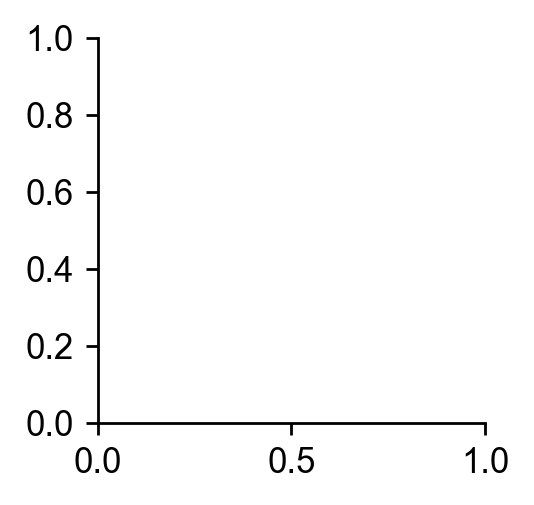

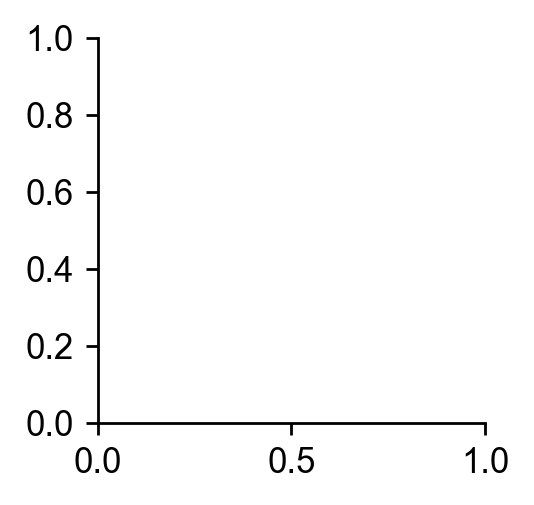

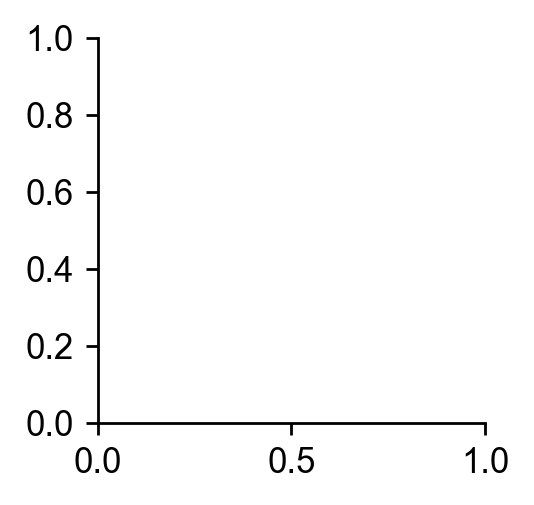

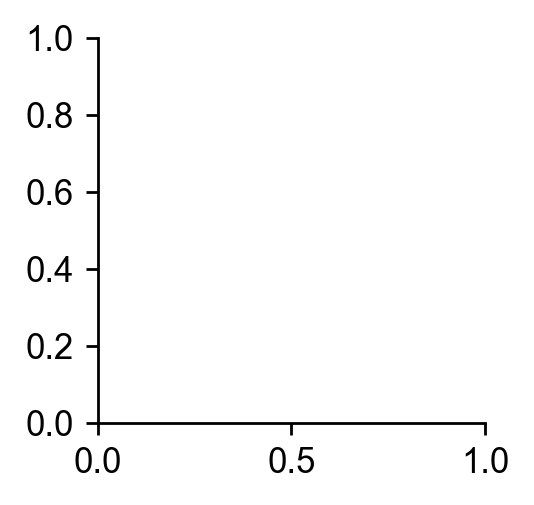

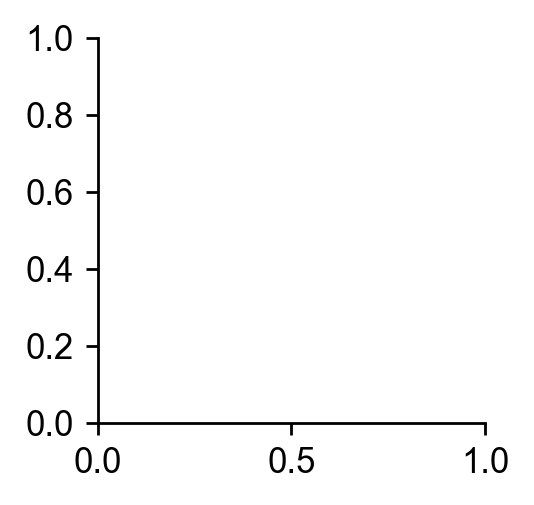

...

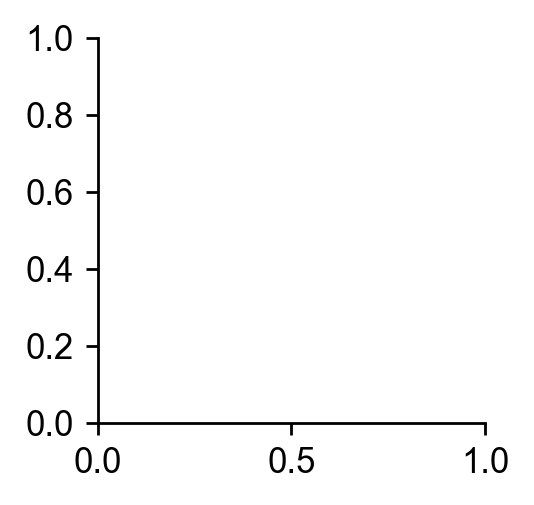

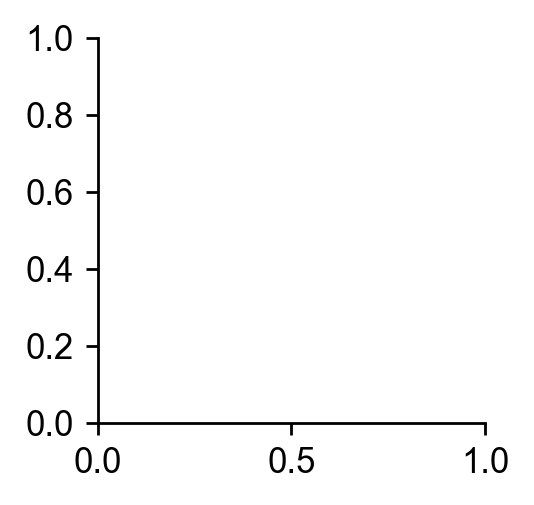

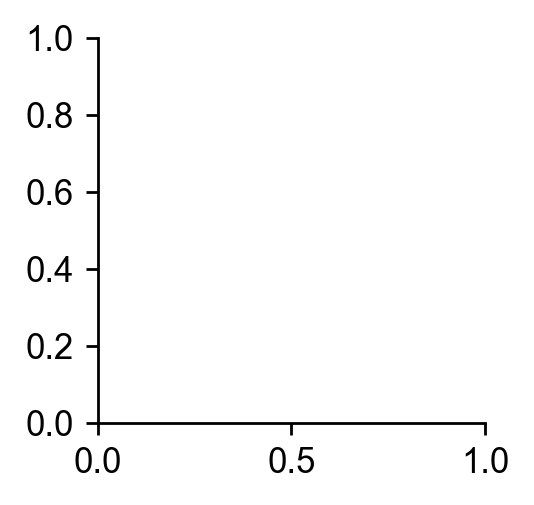

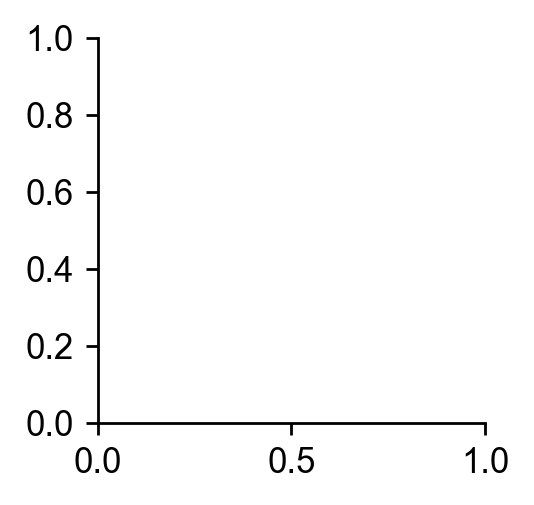

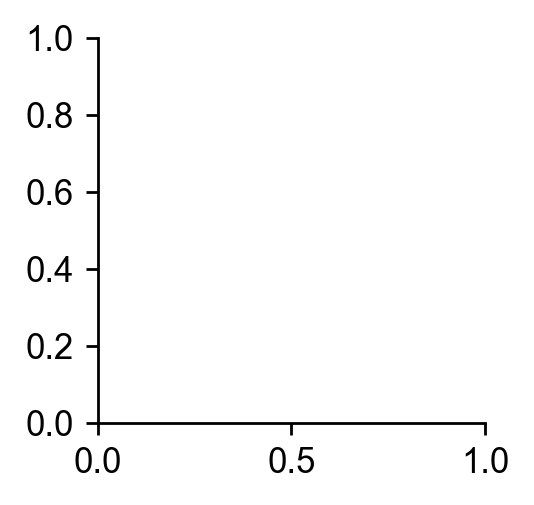

In [48]:
fit_func = ft.piecewise_linear
xvar = 'buds_after_death'
yvar = 'bud_frequency_per_hr'

buds_df.loc[:, 'dist_from_sen_abs'] = 0 - buds_df.dist_from_sen
subfits = fits_df.loc[fits_df.compartment_name.isin(compnames), :]
subbuds = buds_df.loc[buds_df.compartment_name.isin(compnames), :]
# get rid of way too fast cycle durations
subbuds = subbuds[subbuds.cycle_duration_hrs>(40/60)]

unique_ids = subbuds.compartment_bud_id.unique()

ncols = 5
nrows = int(np.round(len(unique_ids)/ncols*1.1))
axwidth = 3
axheight = 3
# fig = plotting.figure(figsize=(axwidth*ncols, axheight*nrows))
params_list = []
for i, buddex in enumerate(unique_ids):
    print(f'Fitting cell {i+1} of {len(unique_ids)}')
    fig, ax = plotting.figure_ax()
    buddf = subbuds.loc[subbuds.compartment_bud_id==buddex, :]
    # only fit cells where we witnessed 10 or more buds
    if len(buddf)>=8:
        pass
    else:
        print(f'Only {len(buddf)} buds for cell {buddex}')
        continue
    cols = [col for col in buddf.columns if buddf[col].dtype != 'O']
    buddf = buddf.loc[:, cols].pivot_table(index=xvar, aggfunc=np.median).reset_index()

    kwargs = {
        'x': xvar,
        'y': yvar,
        'data': buddf,
        'ax': ax
    }
    sns.scatterplot(**kwargs)

    ax.set_ylim(0, 2)
    ax.set_xlim(-20, 1)
    ax.set_title(f'Cell {i}')

    # Fit the data
    result, smoothdf, resultdf = fit_piecewise(df=buddf, xvar=xvar, yvar=yvar, fit_func=fit_func)
    params = [result.params[key].value for key in result.params.keys()]
    params_list.append(params)
    summed_resids_from_piecewise = np.sum(np.abs(result.residual))
    summed_resids_from_piecewise_post_5 = np.sum(np.abs(result.residual[-6:]))
    ax.plot(buddf[xvar], fit_func(buddf[xvar].values, *params), color='red')
    ax.plot(smoothdf.xsmooth, smoothdf.ypred, color='blue', linewidth=1)

    ax.axvline(np.round(result.params['x0'].value), linestyle='--')
    ax.axhline(result.params['y0'].value, linestyle='--')
    plotting.format_ticks(ax)
    # Fit data to a horizontal line so we can
    # compare if cell would have been fit just
    # as well assuming no change in cycle duration
    constant_model = Model(horizontal_line)
    x = buddf[xvar]
    y = buddf[yvar]
    constant_result = constant_model.fit(y, y0=0.9, x=x)
    summed_resids_from_horiz_line = np.sum(np.abs(constant_result.residual))
    summed_resids_from_horiz_line_post_5 = np.sum(np.abs(constant_result.residual[-6:]))

    # Add information to the master index
    for subdf in [subfits, subbuds]:
        # All params from the fit
        for col in resultdf.columns:
            subdf.loc[subdf.compartment_bud_id==buddex, col] = resultdf.loc[0, col]
        # The bud before death when cell cycle was found to start slowing
        # down based on piecewise fit
        SEP_dist_from_sen = np.round(np.abs(result.params['x0'].value))
        subdf.loc[subdf.compartment_bud_id==buddex, 'SEP_dist_from_sen'] = SEP_dist_from_sen
        # To detect whether this cell truly slowed down its cell cycle after
        # the SEP That was detected
        subdf.loc[subdf.compartment_bud_id==buddex, 'pred_final_cycle_duration'] = fit_func(0, *params)
        # Probably better way to find if cell really slowed down post SEP
        for col in ['cycle_duration_hrs', 'bud_frequency_per_hr']:
            pre_sep_median = buddf.loc[buddf.dist_from_sen>SEP_dist_from_sen, col].median()
            post_sep_median = buddf.loc[buddf.dist_from_sen<SEP_dist_from_sen, col].median()
            subdf.loc[subdf.compartment_bud_id==buddex, f'post_over_pre_sep_{col}_median'] = post_sep_median/pre_sep_median
            pre_sep_mean = buddf.loc[buddf.dist_from_sen>SEP_dist_from_sen, col].mean()
            post_sep_mean = buddf.loc[buddf.dist_from_sen<SEP_dist_from_sen, col].mean()
            subdf.loc[subdf.compartment_bud_id==buddex, f'post_over_pre_sep_{col}_mean'] = post_sep_mean/pre_sep_mean
            frequency_max = buddf.loc[buddf.dist_from_sen<=6, col].max()
            subdf.loc[subdf.compartment_bud_id==buddex, f'max_over_pre_sep_{col}_median'] = frequency_max/pre_sep_median
            # Record goodness of fit comparisons
            subdf.loc[subdf.compartment_bud_id==buddex, 'summed_resids_piecewise'] = summed_resids_from_piecewise
            subdf.loc[subdf.compartment_bud_id==buddex, 'summed_resids_horiz_line'] = summed_resids_from_horiz_line
            # Record goodness of fit comparisons for only post average SEP
            subdf.loc[subdf.compartment_bud_id==buddex, 'summed_resids_piecewise_post_5'] = summed_resids_from_piecewise_post_5
            subdf.loc[subdf.compartment_bud_id==buddex, 'summed_resids_horiz_line_post_5'] = summed_resids_from_horiz_line_post_5
            # Record slowest post-SEP cell cycle
            subdf.loc[subdf.compartment_bud_id==buddex, 'slowest_cycle_duration_post_5'] = buddf.loc[buddf.dist_from_sen<5, 'cycle_duration_hrs'].max()
    ax.annotate(f'Post/pre cycle = {np.round(post_sep_median/pre_sep_median, 2)}', xy=(0.1, 0.9), xycoords='axes fraction')
    slope = result.params['k1'].value
    stderr_on_slope = np.abs(np.round(resultdf.loc[0, 'k1_stderr_fraction'], 1)*100)
    ax.annotate(f'Slope = {np.round(slope, 2)} +/- {str(stderr_on_slope)[0:4]}%', xy=(0.1, 0.8), xycoords='axes fraction')
    x0_stderr = resultdf.loc[0, 'x0_stderr']
    if x0_stderr:
        x0_stderr = np.round(x0_stderr, 2)
    else:
        x0_stderr = np.nan

    ax.annotate(f'x0 stderr={str(x0_stderr)[0:4]}', xy=(0.1, 0.7), xycoords='axes fraction')

    for key in ['top', 'right']:
        ax.spines[key].set_visible(False)

    # fig.tight_layout(pad=0.5)

    plotting.save_figure(fig, kwargs, filename=f'Cell_{i}_SEP_fit.svg')
    plt.close()

### Histogram of calculated SEP (in buds before death)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=SEP_dist_from_sen.svg


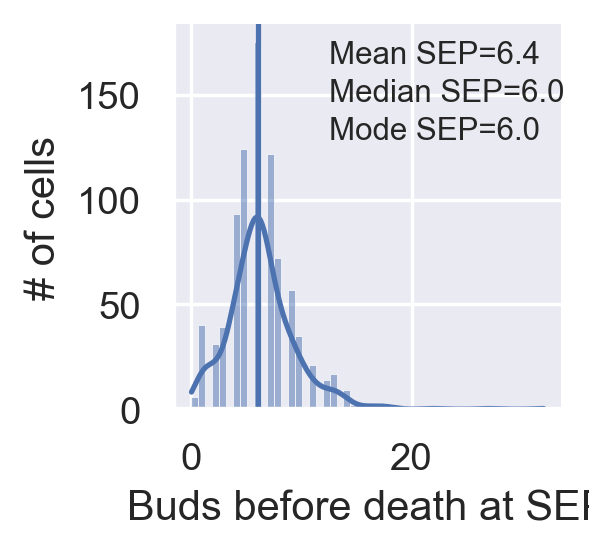

In [49]:
sns.set()
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'SEP_dist_from_sen',
    'ax': ax,
    'data': subfits
}
sns.histplot(**kwargs, kde=True)
ax.set_xlabel('Buds before death at SEP')
ax.set_ylabel('# of cells')
# ax.set_xticks([0, 5, 10, 15, 20, 25])
xvar = kwargs['x']
ax.annotate(f'Mean SEP={np.round(subfits[xvar].mean(), 1)}', xy=(0.4, 0.9), xycoords='axes fraction', fontsize=9)
ax.annotate(f'Median SEP={np.round(subfits[xvar].median(), 1)}', xy=(0.4, 0.8), xycoords='axes fraction', fontsize=9)
ax.annotate(f'Mode SEP={np.round(subfits[xvar].mode().values[0], 1)}', xy=(0.4, 0.7), xycoords='axes fraction', fontsize=9)
ax.axvline(6)
plotting.save_figure(fig, kwargs, ext='.svg')

### Do actual cycle duration traces track with calculated SEP?

ValueError: Could not interpret value `cell_index` for parameter `hue`

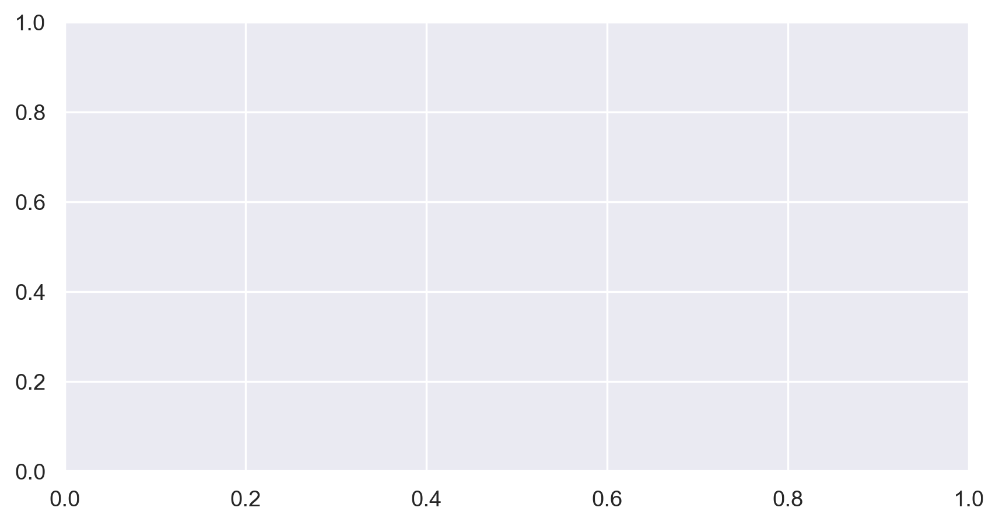

In [50]:
fig, ax = plotting.figure_ax(width_scale=4, height_scale=2)

kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'data': subbuds[subbuds.SEP_dist_from_sen==5],
    'hue': 'cell_index',
    'ax': ax
}

sns.lineplot(**kwargs)

ax.set_xlim(20, -1)
ax.set_ylim(0, 5)
ax.set_xticks([20, 15, 10, 5, 4, 3, 2, 1, 0])

### Histogram of slope, other parameters in piecewise SEP fit

(-1.0, 0.2)

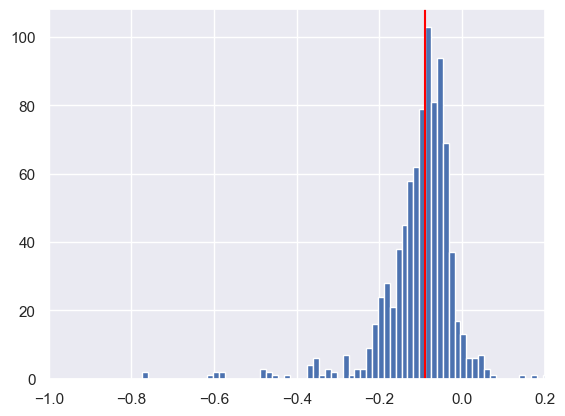

In [51]:
ax = plt.axes()
ax.hist(subfits.k1, bins=100)

# ax.axvline(1, linewidth=1, color='black')
ax.axvline(subfits.k1.median(), color='red')
# ax.set_xscale('log')
ax.set_xlim(-1, 0.2)

## Distinguishing cells that do vs. do not go through the SEP

### Histogram of cell cycle durations at before and after 5 buds before death

Median cycle duration < 5 buds before death = 2.1666666666666665


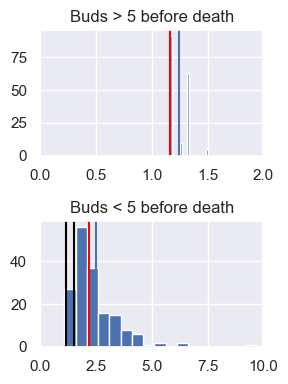

In [326]:
fig = plt.figure(figsize=(3, 4))

ax = fig.add_subplot(2, 1, 1)

kwargs = {
    'x': 'cycle_duration_hrs',
    'data': subbuds.loc[subbuds.dist_from_sen>5, ['cycle_duration_hrs', 'compartment_bud_id']].pivot_table(index=['compartment_bud_id'], aggfunc=np.median).reset_index(),
    'ax': ax,
    'kde': True
}

# sns.histplot(**kwargs)
ax.hist(kwargs['data'][kwargs['x']], bins=20)
ax.axvline(kwargs['data'][kwargs['x']].mean())
ax.axvline(kwargs['data'][kwargs['x']].median(), color='red')
ax.set_title('Buds > 5 before death')
ax.set_xlim(0, 2)

ax2 = fig.add_subplot(2, 1, 2)

kwargs = {
    'x': 'cycle_duration_hrs',
    'data': subbuds.loc[subbuds.dist_from_sen<5, ['cycle_duration_hrs', 'compartment_bud_id']].pivot_table(index=['compartment_bud_id'], aggfunc=np.median).reset_index(),
    'ax': ax2,
    'kde': True
}

# sns.histplot(**kwargs)
ax2.hist(kwargs['data'][kwargs['x']], bins=20)
ax2.axvline(kwargs['data'][kwargs['x']].mean())
ax2.axvline(kwargs['data'][kwargs['x']].median(), color='red')
median = kwargs['data'][kwargs['x']].median()
print(f'Median cycle duration < 5 buds before death = {median}')
ax2.set_title('Buds < 5 before death')
ax2.set_xlim(0, 10)
ax2.axvline(70/60, color='black')
ax2.axvline(1.5, color='black')

fig.tight_layout()

### Histogram of maximum cycle duration before and after 5 buds before death

Median slowest cycle post 5 buds = 3.5
Mean slowest cycle post 5 buds = 4.646825396825396
Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=slowest_cycle_duration_post_5.svg


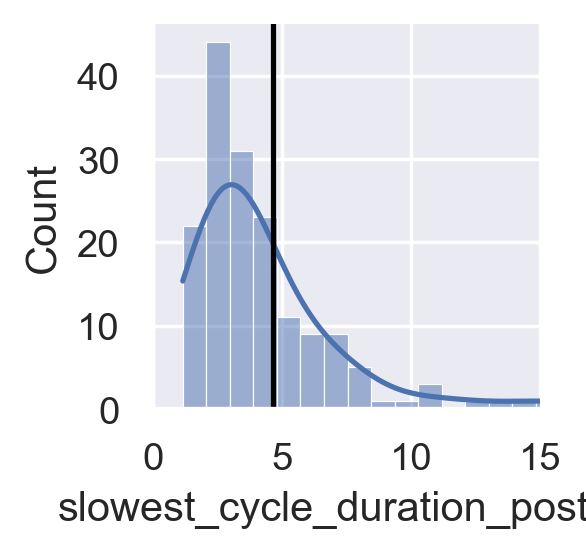

In [327]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'slowest_cycle_duration_post_5',
    'ax': ax,
    'data': subbuds.loc[:, ['cycle_duration_hrs', 'compartment_bud_id', 'slowest_cycle_duration_post_5']].pivot_table(index=['compartment_bud_id'], aggfunc=np.median).reset_index()
}

sns.histplot(**kwargs, kde=True)
ax.set_xlim(0, 15)

median = kwargs['data'][kwargs['x']].median()
print(f'Median slowest cycle post 5 buds = {median}')
mean = kwargs['data'][kwargs['x']].mean()
print(f'Mean slowest cycle post 5 buds = {mean}')
ax.axvline(mean, color='black')

plotting.save_figure(fig, kwargs, ext='.svg')

### Cycle duration vs. buds before death colored by slowest cycle duration post 5 buds before death

(30.0, -1.0)

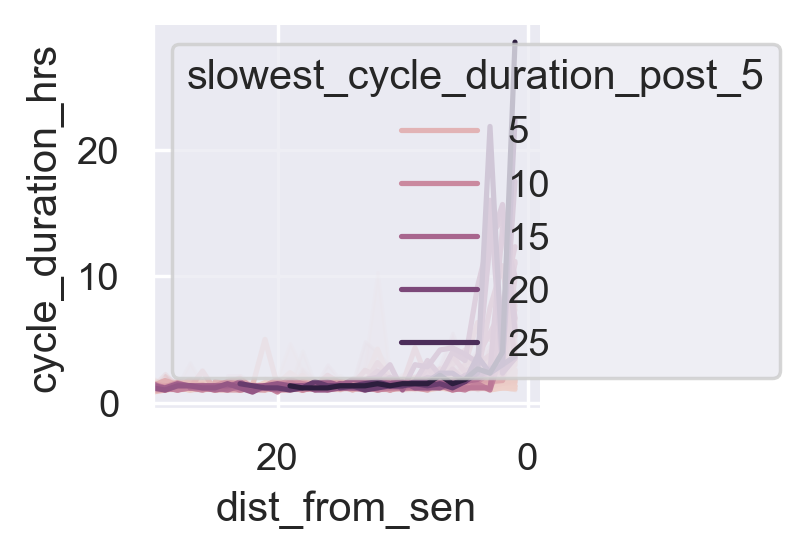

In [328]:
fig, ax = plotting.figure_ax()

cols = [col for col in subbuds.columns if subbuds[col].dtype != 'O']
index = ['compartment_bud_id', 'cycle_number']
cols = cols + [col for col in index if col not in cols]
kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'data': subbuds.loc[:, cols].pivot_table(index=index, aggfunc=np.median).reset_index(),
    'ax': ax,
    'hue': 'slowest_cycle_duration_post_5'
}

sns.lineplot(**kwargs)

ax.set_xlim(30, -1)

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=cycle_duration_hrs_hue=slowest_greater_than_1.333.svg


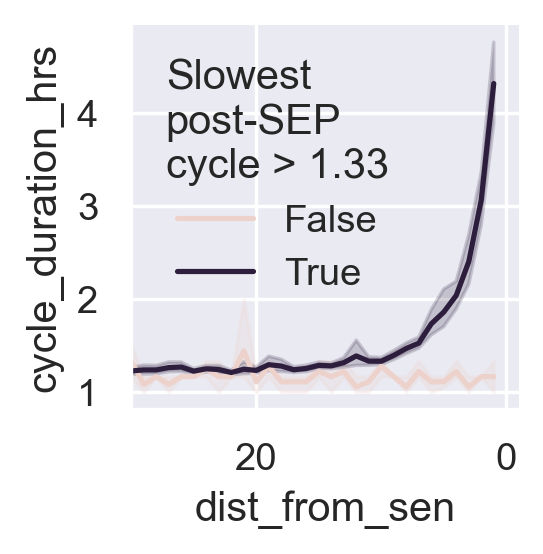

In [315]:
threshold = 80/60

fig, ax = plotting.figure_ax()

cols = [col for col in subbuds.columns if subbuds[col].dtype != 'O']
index = ['compartment_bud_id', 'cycle_number']
cols = cols + [col for col in index if col not in cols]
table = subbuds.loc[:, cols].pivot_table(index=index, aggfunc=np.median).reset_index()
colname = f'slowest_greater_than_{np.round(threshold, 3)}'
table.loc[:, colname] = np.nan
table.loc[table.slowest_cycle_duration_post_5>threshold, colname] = True
table.loc[table.slowest_cycle_duration_post_5<=threshold, colname] = False
kwargs = {
    'x': 'dist_from_sen',
    'y': 'cycle_duration_hrs',
    'data': table,
    'ax': ax,
    'hue': colname
}

sns.lineplot(**kwargs)
# sns.scatterplot(**kwargs)

ax.set_xlim(30, -1)
ax.legend(ax.get_legend_handles_labels()[0], [False, True], title=f'Slowest\npost-SEP\ncycle > {np.round(threshold, 2)}', frameon=False)
plotting.save_figure(fig, kwargs, ext='.svg')

In [316]:
len(table[table[colname]==False].compartment_bud_id.unique())
bud_ids = table[table[colname]==False].compartment_bud_id.unique()

C:\Users\johnp\AppData\Local\Temp\ipykernel_14516\3874644291.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subfits.loc[subfits.compartment_bud_id.isin(bud_ids), colname] = True


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=b_hue=slowest_greater_than_1.333.svg


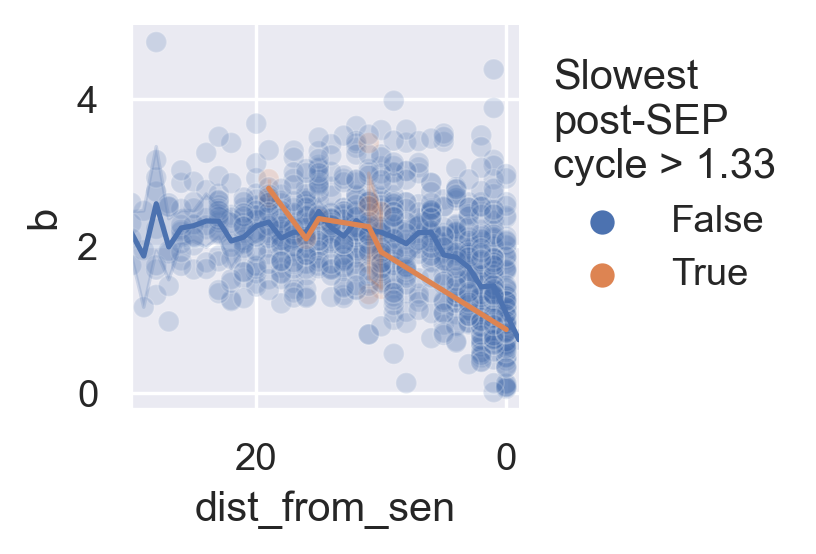

In [307]:
subfits.loc[subfits.compartment_bud_id.isin(bud_ids), colname] = True
subfits.loc[~subfits.compartment_bud_id.isin(bud_ids), colname] = False

fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'dist_from_sen',
    'y': 'b',
    'data': subfits,
    'hue': colname,
    'ax': ax
}

sns.scatterplot(**kwargs, alpha=0.2)
sns.lineplot(**kwargs)

ax.set_xlim(30, -1)

ax.legend(ax.get_legend_handles_labels()[0][0:2], [False, True], title=f'Slowest\npost-SEP\ncycle > {np.round(threshold, 2)}', frameon=False, bbox_to_anchor=(1, 1))

plotting.save_figure(fig, kwargs, ext='.svg')

### Summed absolute value of residuals in last 6 cell cycle durations from horizontal line fit vs. from piecewise fit

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=summed_resids_piecewise_post_5_y=summed_resids_horiz_line_post_5.svg


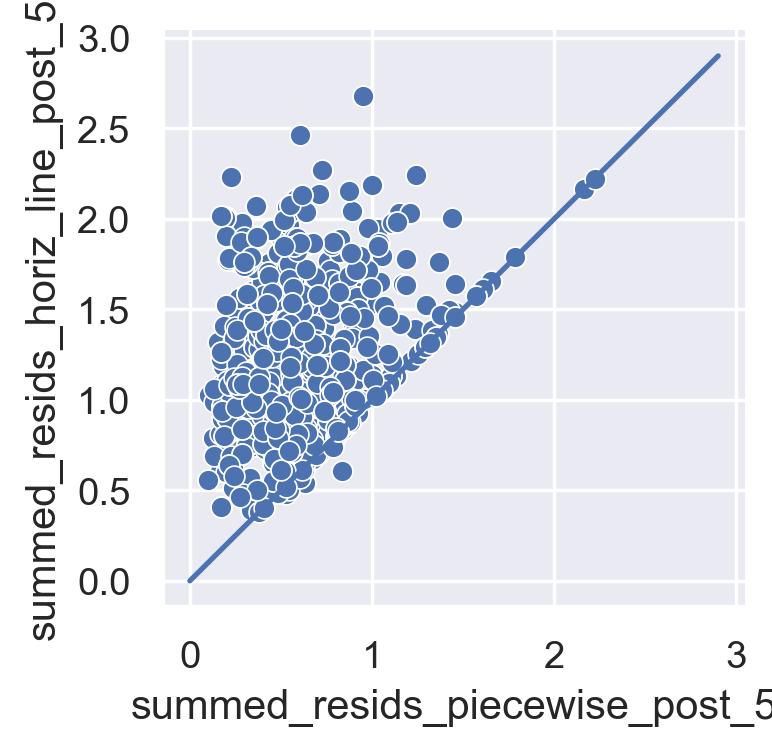

In [272]:
fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)

kwargs = {
    'x': 'summed_resids_piecewise_post_5',
    'y': 'summed_resids_horiz_line_post_5',
    'data': subfits,
    'ax': ax
}

x_smooth = np.arange(0, 3, 0.1)
y_straight_line = 1*x_smooth
sns.scatterplot(**kwargs)
ax.plot(x_smooth, y_straight_line)

plotting.save_figure(fig, kwargs, ext='.svg')

### Histogram of ratios of residuals from above to find outliers where horizontal line is almost as good

C:\Users\johnp\AppData\Local\Temp\ipykernel_14516\3478427078.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subfits.loc[:, 'resids_piecewise_over_horiz_line'] = subfits.summed_resids_piecewise_post_5/subfits.summed_resids_horiz_line_post_5


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=resids_piecewise_over_horiz_line.svg


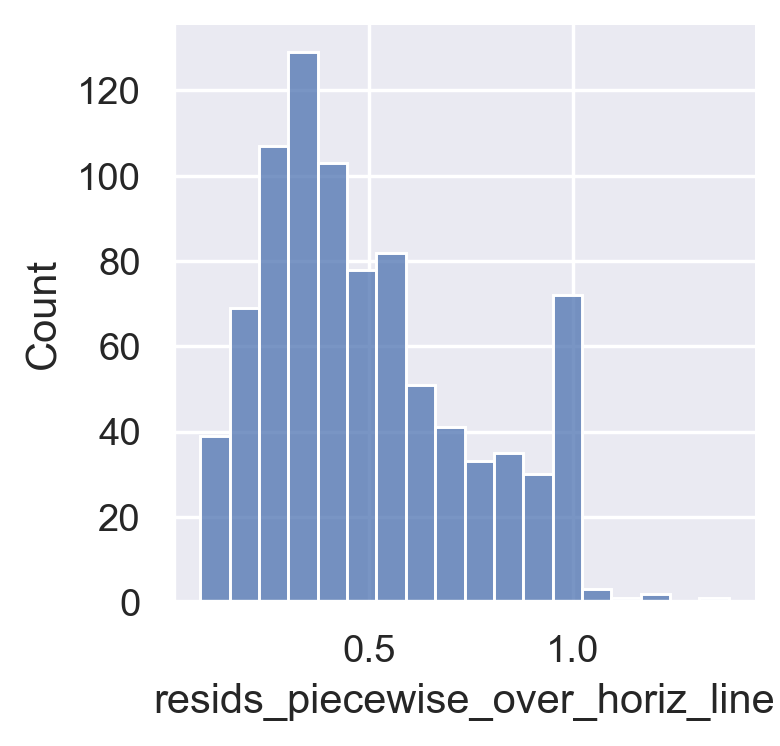

In [273]:
fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)

subfits.loc[:, 'resids_piecewise_over_horiz_line'] = subfits.summed_resids_piecewise_post_5/subfits.summed_resids_horiz_line_post_5
subbuds.loc[:, 'resids_piecewise_over_horiz_line'] = subbuds.summed_resids_piecewise_post_5/subbuds.summed_resids_horiz_line_post_5

kwargs = {
    'x': 'resids_piecewise_over_horiz_line',
    'data': subfits,
    'ax': ax
}

sns.histplot(**kwargs)

plotting.save_figure(fig ,kwargs, ext='.svg')

### Cycle duration vs. busd before death colored by ratio of piecwise/horizontal line fits

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_abs_y=cycle_duration_hrs_hue=resids_piecewise_over_horiz_line.svg


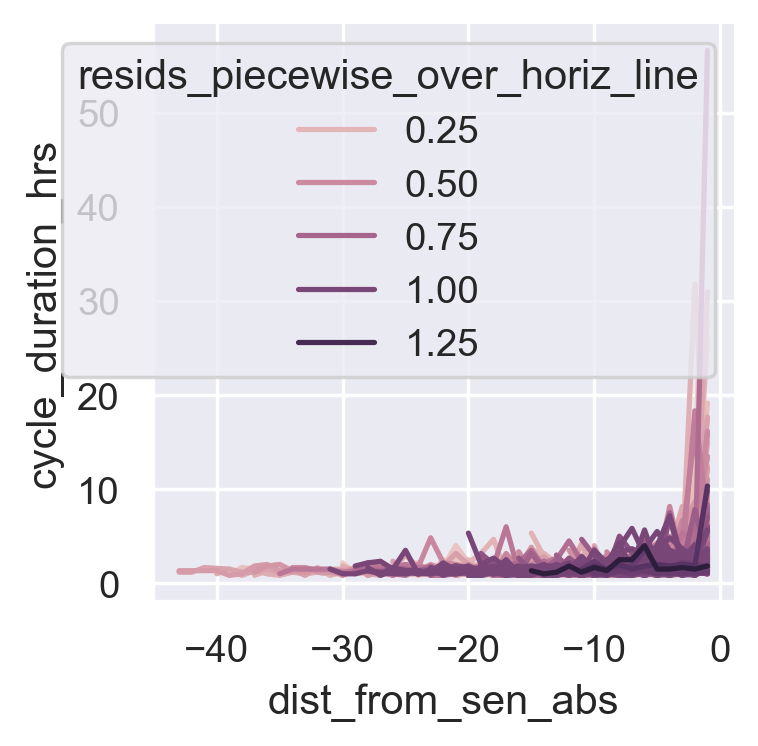

In [274]:
fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)
kwargs = {
    'x': 'dist_from_sen_abs',
    'y': 'cycle_duration_hrs',
    'hue': 'resids_piecewise_over_horiz_line',
    'data': subbuds,
    'ax': ax
}

sns.lineplot(**kwargs)

plotting.save_figure(fig, kwargs, ext='.svg')

### Cycle duration vs. buds before death colored by over or above cutoff on ratio of piecwise/horizontal line fits

C:\Users\johnp\AppData\Local\Temp\ipykernel_14516\2587591504.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subfits.loc[:, 'horizontal_better'] = np.nan


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_abs_y=cycle_duration_hrs_hue=horizontal_better.svg


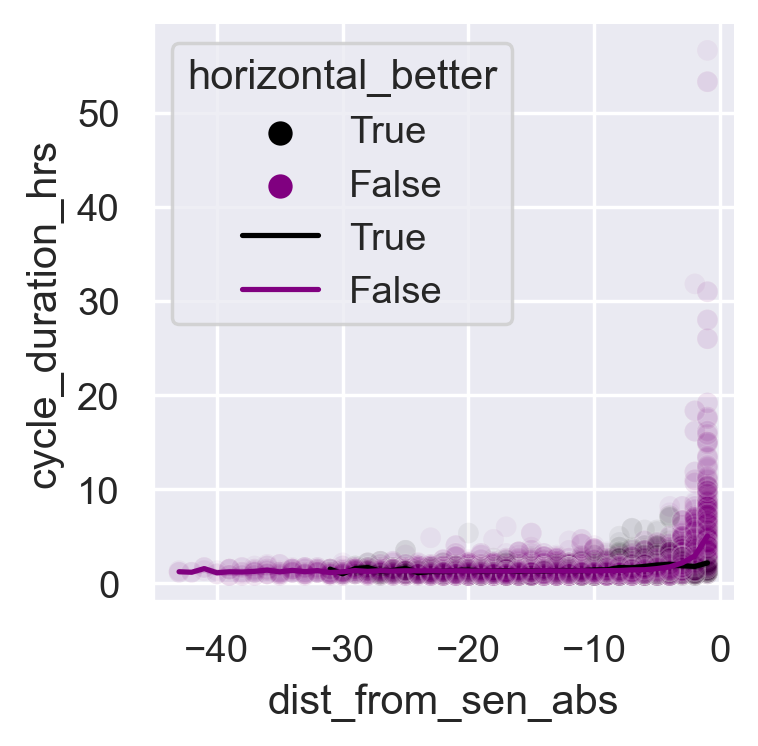

In [275]:
cutoff = 0.9
subbuds.loc[:, 'horizontal_better'] = np.nan
subbuds.loc[subbuds.resids_piecewise_over_horiz_line>cutoff, 'horizontal_better'] = True
subbuds.loc[subbuds.resids_piecewise_over_horiz_line<=cutoff, 'horizontal_better'] = False

subfits.loc[:, 'horizontal_better'] = np.nan
subfits.loc[subfits.resids_piecewise_over_horiz_line>cutoff, 'horizontal_better'] = True
subfits.loc[subfits.resids_piecewise_over_horiz_line<=cutoff, 'horizontal_better'] = False

fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)
kwargs = {
    'x': 'dist_from_sen_abs',
    'y': 'cycle_duration_hrs',
    'hue': 'horizontal_better',
    'hue_order': [True, False],
    'data': subbuds,
    'ax': ax,
    'palette': ['black', 'purple']
}

sns.scatterplot(**kwargs, alpha=0.05)
sns.lineplot(**kwargs)

plotting.save_figure(fig, kwargs, ext='.svg')

In [282]:
len(subfits.loc[subfits.horizontal_better==False, 'compartment_bud_id'].unique())

493

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=b_hue=horizontal_better.svg


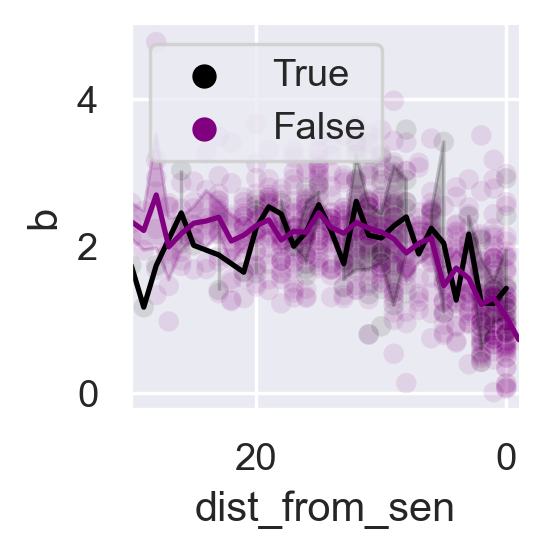

In [284]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'dist_from_sen',
    'y': 'b',
    'hue': 'horizontal_better',
    'ax': ax,
    'data': subfits,
    'palette': ['black', 'purple'],
    'hue_order': [True, False]
}

sns.scatterplot(**kwargs, alpha=0.1)
sns.lineplot(**kwargs)
ax.set_xlim(30, -1)
ax.legend(ax.get_legend_handles_labels()[0][0:2], ax.get_legend_handles_labels()[1][0:2])

plotting.save_figure(fig, kwargs, ext='.svg')

### Slope of SEP vs. x0 (buds after senescence entry point)

As we'd expect, slope of SEP increases as x0 approaches 0 because there is less and less time to get from 70 minute cell cycle to whatever the endpoint is (2-4 hours or so)

C:\Users\johnp\AppData\Local\Temp\ipykernel_3548\1239161030.py:13: MatplotlibDeprecationWarning: Passing the emit parameter of set_ylim() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  ax.set_ylim(-1, 1, 15)


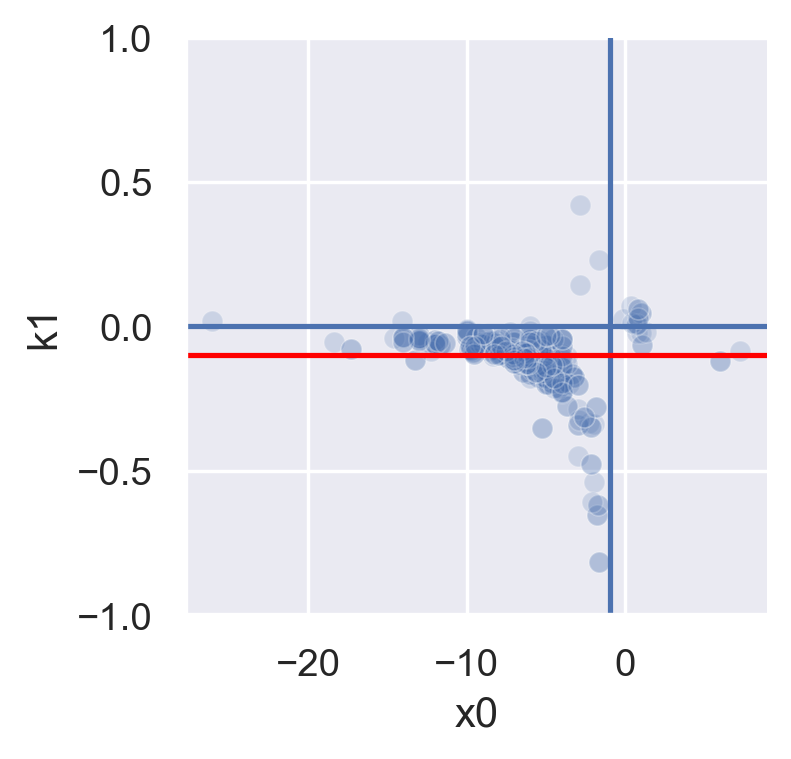

In [117]:
fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)
change_var = 'bud_frequency_max_over_pre_sep_cycle_duration_hrs_mean'
kwargs = {
    'x': 'x0',
    'y': 'k1',
    'data': subfits,
    'alpha': 0.2
}

sns.scatterplot(**kwargs)
ax.axhline(0)
ax.axvline(-1)
ax.set_ylim(-1, 1, 15)
ax.axhline(subfits.k1.median(), color='red')

### Rate vs. dist from SEP

In [52]:
subfits.loc[:, 'dist_from_SEP_at_chase'] = subfits.SEP_dist_from_sen - subfits.dist_from_sen

C:\Users\johnp\AppData\Local\Temp\ipykernel_17500\4074933671.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subfits.loc[:, 'dist_from_SEP_at_chase'] = subfits.SEP_dist_from_sen - subfits.dist_from_sen


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_SEP_at_chase_y=b_alpha=0.5.svg


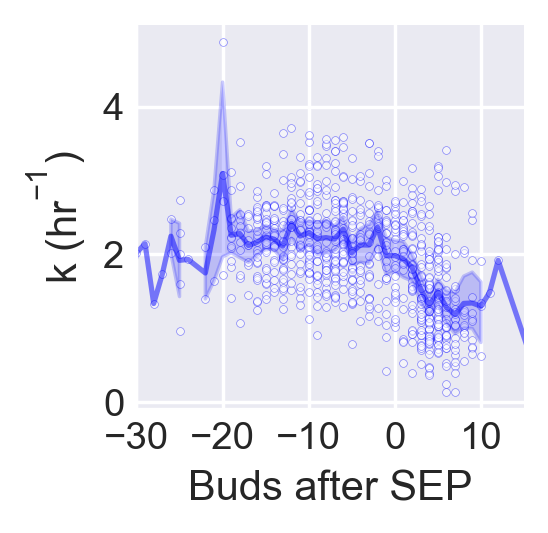

In [63]:
fig, ax = plotting.figure_ax()
booldex = (~subfits.dist_from_SEP_at_chase.isna())# & (subfits.k1<=-0.0)
kwargs = {
    'x': 'dist_from_SEP_at_chase',
    'y': 'b',
    'data': subfits[booldex],
    'ax': ax,
    'alpha': 0.5,
}

sns.scatterplot(**kwargs, facecolor='white', edgecolor='blue', s=5)
sns.lineplot(**kwargs, color='blue')
ax.set_xlim(-30, 15)
ax.set_xticks([-30, -20, -10, 0, 10])
plotting.format_ticks(ax)
ax.set_xlabel('Buds after SEP')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)

plotting.save_figure(fig, kwargs, ext='.svg')

### K vs. dist from SEP logistic fit

In [14]:
plotting.set_styles(matplotlib, plt)

sub_fits_df = subfits[booldex&subfits.compartment_name.isin(constants.compartments_dict['wt_rkk'])]
ratecolor = strains_color_dict[sub_fits_df.strain_name.unique()[0]]
# ratecolor = (255/255,20/255,147/255)
postsep_border = -5
fit_type = 'logistic'
xlim = (-30, 11)
ylim = (0, 5)
shade_stderr = False
fillalpha = 0.25
fillsep = False
daughter_shape='All'
fig, ax = plotting.figure_ax(width_scale=1)
fig.set_dpi(300)
yvar1 = 'b'
xvar = 'dist_from_SEP_at_chase'
alpha = 0.1
size = 15
fontsize=10
ylabel1 = 'Cycle duration (hrs)'
xlabel = 'Buds before SEP'
if fillsep:
    # Shade post-SEP area
    xfill = np.arange(postsep_border, 1.5, 0.5)
    ax.fill_between(
        xfill,
        np.full(len(xfill), np.max(ylim)),
        color=pre_post_SEP_palette[1],
        alpha=fillalpha,
        edgecolor=None)
    # Shade pre-SEP area
    xfill = np.arange(np.min(xlim) - 0.5, postsep_border - 0.5, 0.5)
    ax.fill_between(
        xfill,
        np.full(len(xfill), np.max(ylim)),
        color=pre_post_SEP_palette[0],
        alpha=fillalpha,
        edgecolor=None)

if fit_type=='logistic':
    # fit to logistic
        result, results_df = fitting_tools.fit_model_to_df(sub_fits_df, ~sub_fits_df.b.isna(),
                                                           fitting_tools.model_guesses.logistic[0],
                                                           fitting_tools.model_guesses.logistic[1])
        
        x = np.sort(sub_fits_df[xvar].unique())
        x = np.arange(-30, 15, 1)
        y_pred = result.model.eval(params=result.params, x=x)
        ax.plot(x, y_pred, color=ratecolor)
        
elif fit_type=='exponential':
    # fit to logistic
        result, results_df = fitting_tools.fit_model_to_df(sub_fits_df, ~sub_fits_df.b.isna(),
                                                           fitting_tools.model_guesses.exponential_turn_down[0],
                                                           fitting_tools.model_guesses.exponential_turn_down[1]
                                                          )
        x = np.sort(sub_fits_df[xvar].unique())
        y_pred = result.model.eval(params=result.params, x=x)
        ax.plot(x, y_pred, color=ratecolor)
        
elif fit_type=='piecewise':
    # fit to logistic
        result, results_df = fitting_tools.fit_model_to_df(sub_fits_df, ~sub_fits_df.b.isna(),
                                                           fitting_tools.model_guesses.piecewise_linear[0],
                                                           fitting_tools.model_guesses.piecewise_linear[1]
                                                          )
        x = np.sort(sub_fits_df[xvar].unique())
        y_pred = result.model.eval(params=result.params, x=x)
        ax.plot(x, y_pred, color=ratecolor)

elif fit_type=='line':
    # Fit to line
    fitsdf, smoothdf, result = fitting_tools.fit_line_to_fits_df(sub_fits_df, return_result=True)
    kernsize = 3
    trace_tools.mean_filter(
        smoothdf,
        'stderr',
        kernsize,
        name_with_kernel=True)  
    x = np.sort(sub_fits_df[xvar].unique())
    params = (fitsdf.m.iloc[0], fitsdf.b.iloc[0])
    y_pred = fitting_tools.line(x, *params)
    ax.plot(x, y_pred, color=ratecolor)

elif fit_type=='median':
     
    sns.lineplot(x=xvar, y=yvar1, data=sub_fits_df, ax=ax, color=ratecolor, estimator='median')
    # Get stats for 
    x = sub_fits_df.sort_values(by='dist_from_sen', ascending=True)[xvar].unique()
    y_pred = sub_fits_df.sort_values(by='dist_from_sen', ascending=True).loc[:, [xvar, yvar1]].pivot_table(index=[xvar], aggfunc='median').values
    y_pred = np.reshape(y_pred, len(y_pred))

else:
    print(f'No fit type <{fit_type}>. Please use either logistic or line')
# Derive statistics of fit
r_sq, ydata, ypred = fitting_tools.get_r_sq_with_multi_y_per_x(x, y_pred, sub_fits_df, return_new_y_ypreds=True, xvar=xvar)
n = len(sub_fits_df)
# Shade standard error of the mean for 
if shade_stderr:
    xvar_fill = 'x_input_smooth'
    yvar_fill = 'y_pred'
    errvar = f'stderr'
    # errvar = f'stderr'

    err_kwargs = {
        'x': smoothdf[xvar_fill],
        'y1': smoothdf[yvar_fill] + smoothdf[errvar],
        'y2': smoothdf[yvar_fill] - smoothdf[errvar]
    }

    kwargs = {
        'x': xvar_fill,
        'y': 'y_pred',
        'data': smoothdf,
        'err_kws': err_kwargs
    }
    ax.fill_between(
        err_kwargs['x'],
        err_kwargs['y1'],
        err_kwargs['y2'],
        color=ratecolor,
        alpha=0.2
        )
# Format axes
ax.set_xlim(xlim)
ax.set_xlabel(xlabel, fontsize=fontsize)
ax.set_xticks(np.arange(xlim[0], xlim[1], 10))
ax.set_ylim(ylim)
ax.set_yticks(np.arange(0, ylim[1]+0.1, 1))
# plot cycle durations
# Plot rate constants
kwargs = {
    'x': xvar,
    'y': yvar1,
    'alpha': alpha,
    'data': sub_fits_df,
    'ax': ax,
    'size': size,
    'color': ratecolor,
    'linewidth': 0,
    'edgecolor': ratecolor + (0,) #The (0, ) tuple adds alpha to the ratecolor tuple
}
sns.scatterplot(**kwargs)
ax.legend_.set_visible(False)
# Aesthetics
plotting.remove_spines(ax)
plotting.format_ticks(ax)
plotting.format_ticks(ax2)
ax2.spines['top'].set_visible(False)

ax2.set_ylabel(ylabel1, fontsize=fontsize)
ax.set_ylabel(ylabel2, color=ratecolor, fontsize=fontsize)

# Annotate stats
xy_n = (np.min(ax.get_xlim()) + 2, 4.5)
xy_rsq = (np.min(ax.get_xlim()) + 2, 4.0)
rsq_str = f'{plotting.annoying_strings().r_sq}={np.round(r_sq, 3)}'
n_str = f'N={np.round(n, 2)} measurements'
if fit_type == 'median':
    pass
    # ax.annotate(rsq_str, xy_rsq, fontsize=fontsize-1)
else:
    ax.annotate(rsq_str, xy_rsq, fontsize=fontsize-1)
ax.annotate(n_str, xy_n, fontsize=fontsize-1)
strains = sub_fits_df.strain_name.unique()                                     
kwargs = {
    'x': 'dist_from_SEP_at_chase',
    'y': 'k and cycle duration',
    'strains': '-'.join(strains)
}
# sns.lineplot(x=xvar, y=yvar1, data=sub_fits_df, ax=ax, color=ratecolor, estimator='median')
plotting.save_figure(fig, kwargs, ext='.svg')

NameError: name 'subfits' is not defined

In [67]:
table = subfits[booldex & (subfits.dist_from_sen>-1)].loc[:, ['b', 'dist_from_sen']].pivot_table(index='dist_from_sen', aggfunc=np.median)

In [73]:
model.param_names

['L', 'k', 'x_center', 'offset']

<Axes: title={'center': 'Model(power_law)'}, xlabel='x', ylabel='y'>

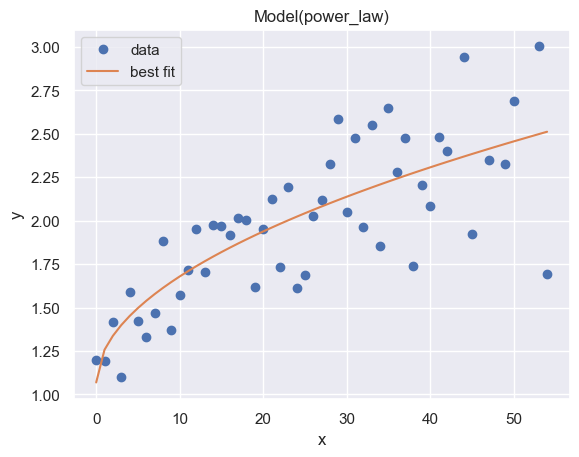

In [84]:
from lmfit import Parameters
def power_law(x, a, k, c):
    return a*np.power(x, k) + c

power_model = Model(power_law)
params = Parameters()
guesses_varies_dict = {
    'a': (1, True),
    'k': (1, True),
    'c': (0, True)
}
for key, val in guesses_varies_dict.items():
    params.add(key, value=val[0], vary=val[1])

X = table.index
Y = table.b
result = power_model.fit(Y, params, x=X)
# plt.scatter(X, Y)

result.plot_fit()

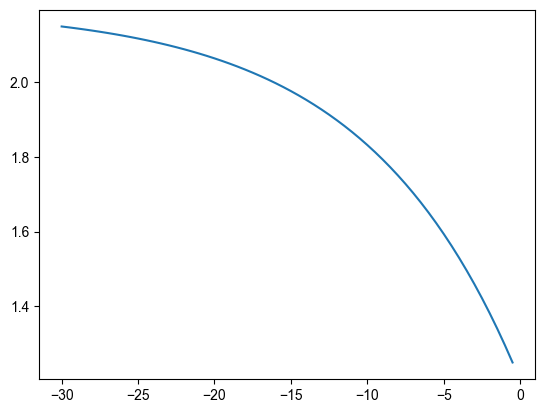

In [104]:
def exp_turn_down(x, a, k, c):
    return c - a*np.exp(x*k)

x = np.arange(-30, 0, 0.5)

y = exp_turn_down(x, 1, 0.1, 2.2)
plt.plot(x, y)

In [37]:
fits_df.loc[fits_df.strain_name=='JPC274', 'compartment_name'].unique()

array(['20230518_byc_JPC274_R-YFP-Su9_mub1d',
       '20230628_byc_JPC274_R-YFP-Su9_mub1d'], dtype=object)

## Generational rescaling to explain difference between mub1&Delta; and WT

In [73]:
fitsdict['JPC220']

[1.3498880415848538, 0.2973643149502499, 2.343986192851494]

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=rate_type=rescale.svg


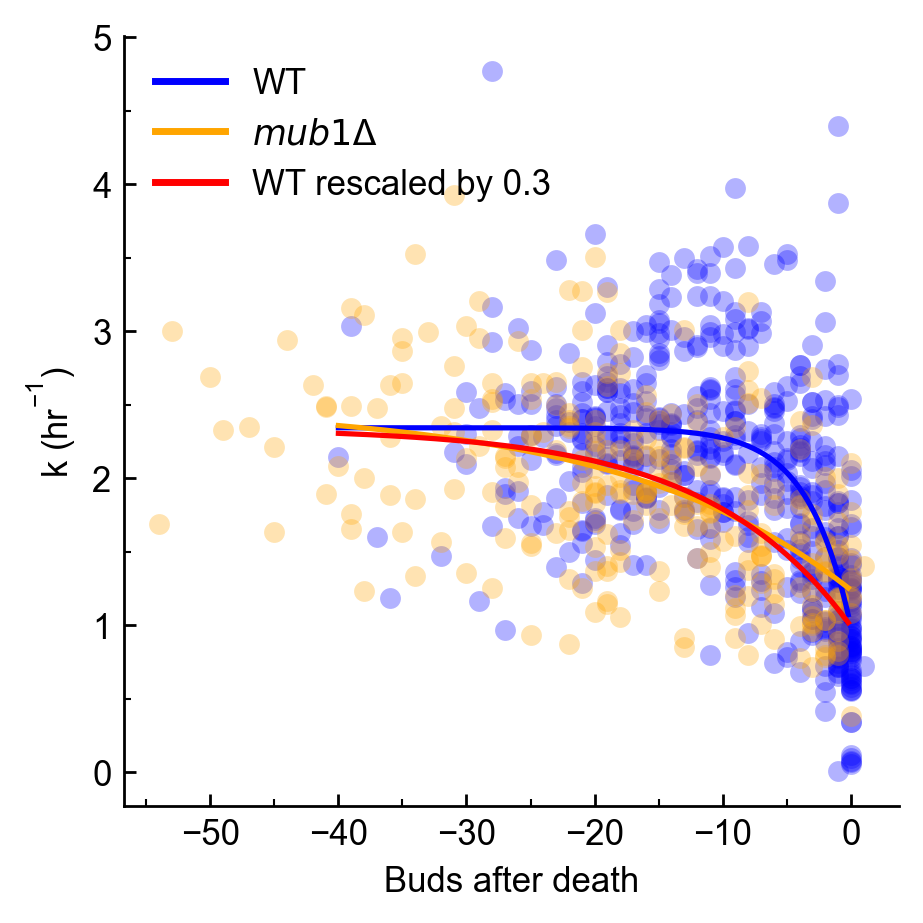

In [77]:
from lmfit import Model, Parameters

subfits = fits_df.loc[fits_df.strain_name.isin(['JPC274', 'JPC220'])]

skips = [
    '20230628_byc_JPC274_R-YFP-Su9_mub1d',
]

subfits = subfits.loc[~subfits.compartment_name.isin(skips), :]

def exp_turn_down(x, a, k, c):
    return c - a*np.exp(x*k)

fig, ax = plotting.figure_ax(width_scale=2, height_scale=2)
colors = ['blue', 'orange', 'red']
fitsdict = {}
for i, strain_name in enumerate(subfits.strain_name.unique()):
    straindex = subfits.strain_name==strain_name
    model = Model(exp_turn_down)
    params = Parameters()
    guesses_varies_dict = {
        'a': (2, True),
        'k': (1, True),
        'c': (1.4, True)
    }
    for key, val in guesses_varies_dict.items():
        params.add(key, value=val[0], vary=val[1])

    subfits.loc[:, 'dist_from_sen_abs'] = 0 - subfits.dist_from_sen
    X = subfits.loc[straindex, :].dist_from_sen_abs
    Y = subfits.loc[straindex, :].b
    result = model.fit(Y, params, x=X)
    fitparams = [result.params[key].value for key in guesses_varies_dict.keys()]
    fitsdict[strain_name] = fitparams

    ax.scatter(X, Y, color=colors[i], alpha=0.3, linewidth=0)
    xsmooth = np.arange(-40, 0, 0.2)
    ypred = exp_turn_down(xsmooth, *fitparams)
    ax.plot(xsmooth, ypred, color=colors[i])
    
# Rescale the x data so that each
# x position contributes more
fac = 0.3
ypred_rescaled = exp_turn_down(xsmooth*fac, *fitsdict['JPC220'])
# ypred3 =  fitsdict['JPC220'][2] - fitsdict['JPC220'][0]*np.exp(fitsdict['JPC220'][1]*(xsmooth*fac))
ax.plot(xsmooth, ypred_rescaled, color='red')
# ax.plot(xsmooth, ypred3, color='purple')
ax.set_xlabel('Buds after death')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
custom_lines = [Line2D([0], [0], color=colors[0], lw=2),
                Line2D([0], [0], color=colors[1], lw=2),
                Line2D([0], [0], color=colors[2], lw=2)]

ax.legend(custom_lines, ['WT', plotting.get_gene_deletion_string('mub1'), f'WT rescaled by {fac}'],
          title='', frameon=False)

plotting.remove_spines(ax)
plotting.format_ticks(ax)

plotting.save_figure(fig, {'x': 'dist_from_sen', 'y': 'rate', 'type': 'rescale'}, ext=".svg")

Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=hours_before_last_bud_y=b_alpha=0.5.svg


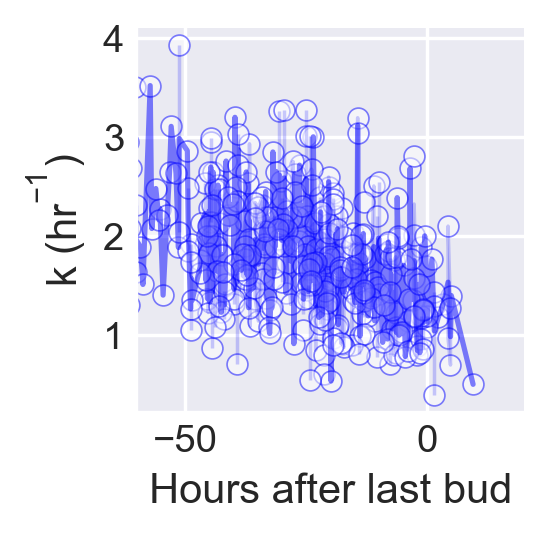

In [86]:
fig, ax = plotting.figure_ax()

kwargs = {
    'x': 'hours_before_last_bud',
    'y': 'b',
    'data': subfits[booldex],
    'ax': ax,
    'alpha': 0.5
}

sns.scatterplot(**kwargs, facecolor='white', edgecolor='blue')
sns.lineplot(**kwargs, color='blue')
ax.set_xlim(-60, 20)
# ax.set_xticks([-50, 40, 30, 20, 10, 0, 10])
plotting.format_ticks(ax)
ax.set_xlabel('Hours after last bud')
ax.set_ylabel(plotting.annoying_strings().k_inverse_hrs)
plotting.save_figure(fig, kwargs, ext='.svg')

C:\Users\johnp\AppData\Local\Temp\ipykernel_3548\2041617926.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subfits.loc[subfits.dist_from_SEP_at_chase<0, 'post_sep_auto'] = False


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=post_sep_y=b.svg


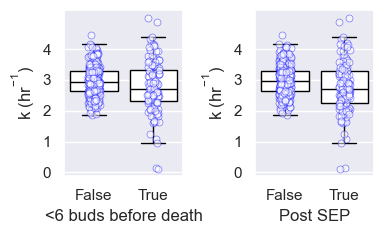

In [297]:
sns.set()
sep_border = 6
fig = plt.figure(figsize=(4, 2.5))

subfits.loc[subfits.dist_from_SEP_at_chase<0, 'post_sep_auto'] = False
subfits.loc[subfits.dist_from_SEP_at_chase>0, 'post_sep_auto'] = True
subfits.loc[:, 'post_sep'] = np.nan
subfits.loc[subfits.dist_from_sen<sep_border, 'post_sep'] = True
subfits.loc[subfits.dist_from_sen>sep_border, 'post_sep'] = False

ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)
kwargs1 = {
    'x': 'post_sep',
    'y': 'b',
    'order': [False, True],
    'ax': ax1,
    'data': subfits[booldex]
}

kwargs2 = {
    'x': 'post_sep_auto',
    'y': 'b',
    'order': [False, True],
    'ax': ax2,
    'data': kwargs1['data']
}

for kwargs in [kwargs1, kwargs2]:
    sns.stripplot(**kwargs, facecolor='white', edgecolor='blue', alpha=0.5, linewidth=0.5)
    sns.boxplot(**kwargs, **plotting.transparent_boxes_prop_dict, showfliers=False)
    kwargs['ax'].set_ylabel(plotting.annoying_strings().k_inverse_hrs)
    kwargs['ax'].set_yticks([0, 1, 2, 3, 4])

ax1.set_xlabel(f'<{sep_border} buds before death')
ax2.set_xlabel('Post SEP')

fig.tight_layout()

plotting.save_figure(fig, kwargs1, ext='.svg')

### Buds before SEP at chase vs. buds before death at chase colored by rate


Saved figure at
C:\Users\johnp\Dropbox\Projects\byc\data\meta\plots\x=dist_from_sen_y=dist_from_SEP_at_chase_hue=b_alpha=1_size=5_linewidth=0.svg


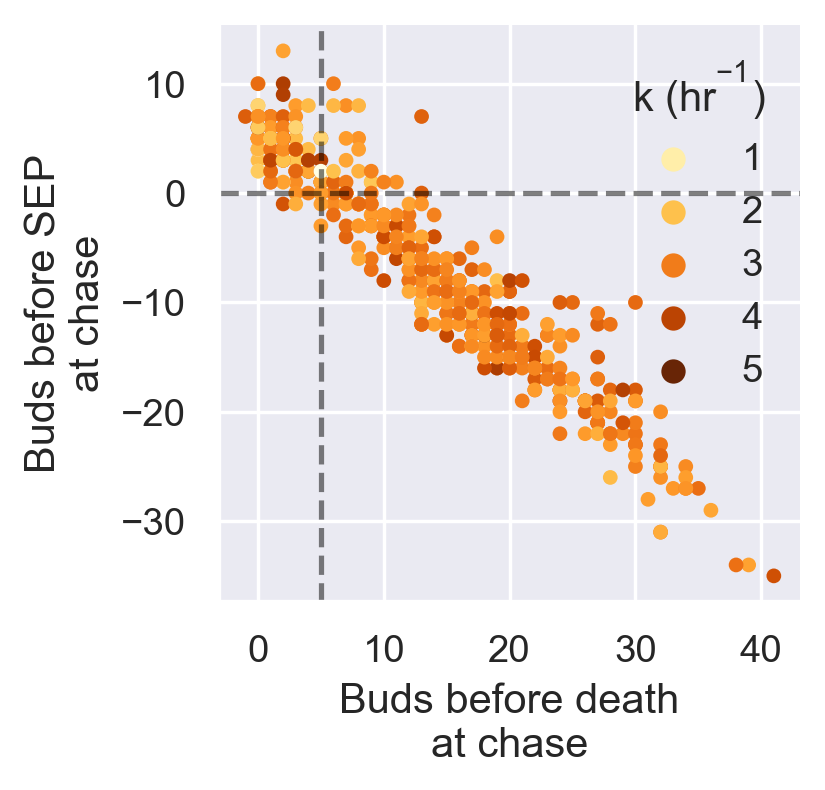

In [298]:
sns.set()

fig, ax = plotting.figure_ax(width_scale=1.5, height_scale=1.5)

ax.axvline(5, color='black', linestyle='--', alpha=0.5)
ax.axhline(0, color='black', linestyle='--', alpha=0.5)

kwargs = {
    'x': 'dist_from_sen',
    'y': 'dist_from_SEP_at_chase',
    'hue': 'b',
    'palette': 'YlOrBr',
    'ax': ax,
    'alpha': 1,
    'data': subfits[booldex],
    'size': 5,
    'linewidth': 0
}

sns.scatterplot(**kwargs)

ax.set_xlabel('Buds before death\nat chase')
ax.set_ylabel('Buds before SEP\nat chase')
ax.legend(ax.get_legend_handles_labels()[0][0:5], ax.get_legend_handles_labels()[1][0:5],
         title=plotting.annoying_strings().k_inverse_hrs, frameon=False)
plotting.save_figure(fig, kwargs, ext='.svg')